In [95]:
import pickle
import os
import pandas as pd
import torch

In [96]:
import numpy as np
import dynamic_portfolio as dp
from TARN_MAPPO.enviroment import EnvConfig, Stock_Env
from TARN_MAPPO.agent import MAPPO, EarlyStopping


In [322]:
with open("./data/train_daily_v3.pkl", "rb") as f:
    train_scaled = pickle.load(f)
print("현재 작업 디렉토리:", os.getcwd())

train_df = pd.read_csv("data/train_v3.csv", index_col=0)
train_df.set_index("date", inplace=True)
feature_dim = 14
train_scaled_tensor = torch.load("data/daily_data_v3.pt")

현재 작업 디렉토리: /workspace/base_line_model/Task_1_FinRL_DeepSeek_Stock


/tmp/ipykernel_4010139/3209765067.py:8: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  train_scaled_tensor = torch.load("data/daily_data_v3.pt")


In [323]:
from datasets import load_dataset
dataset = load_dataset("benstaf/nasdaq_2013_2023", data_files="train_data_deepseek_sentiment_2013_2018.csv")
train = pd.DataFrame(dataset['train'])

Repo card metadata block was not found. Setting CardData to empty.


In [324]:
train.drop("Unnamed: 0", axis=1, inplace=True)
train_df.rename(columns = {"low": "low_norm", "high": "high_norm", "open": "open_norm", "close": "close_norm"}, inplace=True)

In [325]:
imp = train[["date", "tic", "close", "high", "low", "open"]]

In [326]:
train_df = train_df.merge(imp, on=["date", "tic"], how="left").dropna()

In [327]:
train_df.set_index("date", inplace=True)

In [329]:

def get_hyperparameters(feature_dim):
    return {
        "dcc_dropout": 0.2,
        "sac_dropout": 0.01,
        "sac_heads": 2,
        "ddc_configs": [
            {"in_channels": feature_dim, "out_channels": 8, "kernel_size": 3, "stride": 1, "padding": (3-1)//2, "dilation": 1, "sac_scale": 4**0.5, "residual_out_channels" : 8, "residual_kernal": 1},
            {"in_channels": 8, "out_channels": 16, "kernel_size": 3, "stride": 1, "padding": 2, "dilation": 2, "sac_scale": 8**0.5, "residual_out_channels" : 16, "residual_kernal": 1 },
            {"in_channels": 16, "out_channels": 16, "kernel_size": 3, "stride": 1, "padding": 4, "dilation": 4, "sac_scale": 8**0.5}
        ],
        "final_conv_config": {"in_channels" : 16, "out_channels": 8, "kernel_size": 20, "stride": 1, "padding": 0}
    }

In [330]:
hyperparameters = get_hyperparameters(feature_dim)
config = EnvConfig(train_scaled_tensor, train_df, train_scaled, hyperparameters)

In [331]:
env = Stock_Env(config)
early_stopping_reward = EarlyStopping(patience=config.patience, min_delta=0.0001)

print("학습 환경 및 에이전트 생성 완료")
print("학습 시작")
# Initialize agents
agent = MAPPO(env)


학습 환경 및 에이전트 생성 완료
학습 시작


In [352]:
train_df

,tic,ret,low_norm,high_norm,close_norm,open_norm,return_1m,return_3m,return_6m,return_12m,...,SMA_252_norm,macd_norm,boll_ub_norm,boll_lb_norm,rsi_norm,cci_norm,close,high,low,open
date,,,,,,,,,,,,,,,,,,,,,
2013-01-02,AAPL,0.031681,2.804556,2.873786,2.842873,2.867676,-0.063393,-0.178588,-0.089286,0.367262,...,0.095581,0.478168,0.085729,0.090038,0.502742,0.660736,16.687340,19.821428,19.343929,19.779285
2013-01-02,ADBE,0.017516,0.909134,0.928554,0.919204,0.909134,0.104899,0.176074,0.259527,0.354292,...,0.000000,0.526898,0.001415,0.000000,0.702182,0.585698,38.340000,38.730000,37.919998,37.919998
2013-01-02,ADI,0.046125,1.639706,1.686062,1.685679,1.639706,0.096121,0.120787,0.236599,0.266099,...,0.000000,0.645817,0.000000,0.000000,0.691913,0.828250,33.714191,44.009998,42.799999,42.799999
2013-01-02,ADP,0.025645,1.559462,1.581065,1.576744,1.567833,0.042918,-0.000662,0.068723,0.106245,...,0.000000,0.519814,0.000000,0.000000,0.561295,0.594654,39.267780,51.404739,50.702370,50.974541
2013-01-02,ADSK,0.044979,0.747305,0.765962,0.765755,0.747305,0.119733,0.093546,0.205220,0.215132,...,0.000000,0.534526,0.007062,0.002233,0.679427,0.575033,36.939999,36.950001,36.049999,36.049999
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018-12-28,VRTX,-0.005851,6.927862,7.120518,6.972786,7.063499,-0.095078,-0.158964,-0.073151,0.065127,...,0.999519,0.294516,0.927739,0.826915,0.353613,0.256528,161.419998,164.839996,160.380005,163.520004
2018-12-28,WBA,-0.004534,2.256783,2.306533,2.272142,2.289171,-0.196007,-0.069023,0.080381,-0.043613,...,0.790017,0.140736,0.944995,0.572000,0.155345,0.461390,50.158054,69.080002,67.589996,68.559998
2018-12-28,WBD,-0.005650,1.926212,1.977525,1.945158,1.961737,-0.213031,-0.250152,-0.129329,0.068980,...,0.205624,0.084750,0.441750,0.293333,0.149163,0.350541,24.639999,25.049999,24.400000,24.850000


In [308]:
# 일자별 weight 계산
# 수익률을 계산함


In [ ]:
data_sent_2 = train_df[train_df["sentiment_weight_2"] > 1]
data_sent_5 = train_df[train_df["sentiment_weight_5"] > 1]
data_risk_2 = train_df[train_df["risk_weight_2"] < 3]
data_risk_5 = train_df[train_df["risk_weight_5"] < 3]

def make_weight_rebalance(data, dates, rebalance_freq=20):
    portfolio_returns = {}
    current_weights = {}
    current_tickers = []
    
    for i, day in enumerate(dates):
        if i % rebalance_freq == 0:
            # 리밸런싱 날짜
            if day not in data.index:
                portfolio_returns[day] = 0
                continue

            data_imp = data.loc[day]
            if isinstance(data_imp, pd.Series):
                data_imp = data_imp.to_frame().T
            elif isinstance(data_imp, pd.DataFrame):
                data_imp = data_imp.reset_index(drop=True)

            if data_imp.shape[0] > 10:
                data_imp = data_imp.sort_values(by="volume", ascending=False).head(10)

            current_tickers = list(data_imp["tic"])
            current_weights = {tic: 1 / len(current_tickers) for tic in current_tickers}

        # 리턴 계산 (리밸런싱이든 아니든)
        try:
            day_data = data.loc[day]
            if isinstance(day_data, pd.Series):
                day_data = day_data.to_frame().T
            elif isinstance(day_data, pd.DataFrame):
                day_data = day_data.reset_index(drop=True)

            returns = 0
            for tic in current_tickers:
                ret_series = day_data[day_data["tic"] == tic]["ret"]
                if not ret_series.empty:
                    returns += ret_series.values[0] * current_weights[tic]
            portfolio_returns[day] = returns
        except KeyError:
            portfolio_returns[day] = 0

    return portfolio_returns


def make_weight(data, day):
    data_imp = data.loc[day]
    data_imp = data_imp.sort_values(by="volume", ascending=False).head(10)
    weight = {ticker : 1/10 for ticker in data_imp["tic"]}
    returns = 0
    for ticker, wei in weight.items():

        returns += data_imp[data_imp["tic"]==ticker]["ret"] * wei
    print(day, returns)
    return returns.values[0]


def make_weight_risk(data, day):
    if day not in data.index:
        return 0
    else:
        # 특정 날짜에 해당하는 여러 종목 정보 추출
        data_imp = data.loc[day]

        # 만약 data가 time index + tic 멀티인덱스라면 reset
        if isinstance(data_imp, pd.Series):
            data_imp = data_imp.to_frame().T  # 단일 종목일 경우

        elif isinstance(data_imp, pd.DataFrame):
            data_imp = data_imp.reset_index(drop=True)

        # 종목 수가 10개 초과일 경우, 거래량 기준 상위 10개 선택
        if data_imp.shape[0] > 10:
            data_imp = data_imp.sort_values(by="volume", ascending=False).head(10)

        # 균등 가중치 계산
        weight = {ticker: 1/10 for ticker in data_imp["tic"]}

        # 수익률 계산
        returns = 0
        for ticker, wei in weight.items():
            ret_val = data_imp[data_imp["tic"] == ticker]["ret"].values[0]
            returns += ret_val * wei

        return returns


sent2_returns = {}
sent5_returns = {}
risk2_returns = {}
risk5_returns = {}

for day in data_sent_2.index.unique():
    sent2_returns[day] = make_weight(data_sent_2, day)
    sent5_returns[day] = make_weight(data_sent_5, day)
    risk2_returns[day] = make_weight_risk(data_risk_2, day)
    risk5_returns[day] = make_weight_risk(data_risk_5, day)

((30755, 62), (30735, 62), (19204, 62), (19177, 62))

In [395]:
def run_all_strategies_hold(train_df, rebalance_freq=20, top_n=10):
    dates = sorted(train_df.index.unique())
    strategy_config = {
        'sent2': {'col': 'sentiment_weight_2', 'op': 'gt', 'thresh': 1},
        'sent5': {'col': 'sentiment_weight_5', 'op': 'gt', 'thresh': 1},
        'risk2': {'col': 'risk_weight_2', 'op': 'lt', 'thresh': 3},
        'risk5': {'col': 'risk_weight_5', 'op': 'lt', 'thresh': 3},
    }

    # 전략별 상태 초기화
    strategy_returns = {name: {} for name in strategy_config}
    strategy_weights = {name: {} for name in strategy_config}
    strategy_tickers = {name: [] for name in strategy_config}

    for i, day in enumerate(dates):
        day_data = train_df[train_df.index == day]

        for name, cfg in strategy_config.items():
            # 리밸런싱 시점이면 자산 구성 새로 선정
            if i % rebalance_freq == 0:
                if cfg['op'] == 'gt':
                    filtered = day_data[day_data[cfg['col']] > cfg['thresh']]
                else:
                    filtered = day_data[day_data[cfg['col']] < cfg['thresh']]

                filtered = filtered.sort_values(by="volume", ascending=False).head(top_n)

                tickers = list(filtered["tic"])
                weights = {tic: 1 / 10 for tic in tickers} if tickers else {}
                strategy_tickers[name] = tickers
                strategy_weights[name] = weights

            # 일별 수익 계산 (보유 중인 자산에 대해 계산)
            daily_ret = 0
            for tic in strategy_tickers[name]:
                match = day_data[day_data["tic"] == tic]
                if not match.empty:
                    daily_ret += match["ret"].values[0] * strategy_weights[name][tic]
            strategy_returns[name][day] = daily_ret

    # DataFrame으로 정리
    result = pd.DataFrame(strategy_returns).sort_index()
    return result


In [396]:
returns_df = run_all_strategies_hold(train_df)


In [363]:
sent2_returns = {}
sent5_returns = {}
risk2_returns = {}
risk5_returns = {}

for day in data_sent_2.index.unique():
    sent2_returns[day] = make_weight(data_sent_2, day)
    sent5_returns[day] = make_weight(data_sent_5, day)
    risk2_returns[day] = make_weight_risk(data_risk_2, day)
    risk5_returns[day] = make_weight_risk(data_risk_5, day)

2013-01-02 date
2013-01-02    0.008848
Name: ret, dtype: float64
2013-01-02 date
2013-01-02    0.008848
Name: ret, dtype: float64
2013-01-02 없음
2013-01-02 없음
2013-01-03 date
2013-01-03    0.00987
Name: ret, dtype: float64
2013-01-03 date
2013-01-03    0.00987
Name: ret, dtype: float64
2013-01-03 없음
2013-01-03 없음
2013-01-04 date
2013-01-04    0.000925
Name: ret, dtype: float64
2013-01-04 date
2013-01-04    0.000925
Name: ret, dtype: float64
2013-01-07 date
2013-01-07    0.00375
Name: ret, dtype: float64
2013-01-07 date
2013-01-07    0.00375
Name: ret, dtype: float64
2013-01-08 date
2013-01-08    0.000399
Name: ret, dtype: float64
2013-01-08 date
2013-01-08    0.000399
Name: ret, dtype: float64
2013-01-09 date
2013-01-09    0.002933
Name: ret, dtype: float64
2013-01-09 date
2013-01-09    0.002933
Name: ret, dtype: float64
2013-01-10 date
2013-01-10    0.001717
Name: ret, dtype: float64
2013-01-10 date
2013-01-10    0.001717
Name: ret, dtype: float64
2013-01-11 date
2013-01-11   -0.000217

In [422]:
returns_df

,sent2,sent5,risk2,risk5
2013-01-02,0.008848,0.008848,0.000000,0.000000
2013-01-03,0.002973,0.002973,0.000000,0.000000
2013-01-04,0.000076,0.000076,0.000000,0.000000
2013-01-07,0.003944,0.003944,0.000000,0.000000
2013-01-08,0.002402,0.002402,0.000000,0.000000
...,...,...,...,...
2018-12-21,-0.028851,-0.028851,-0.022703,-0.022703
2018-12-24,-0.018065,-0.018065,-0.021131,-0.021131
2018-12-26,0.055422,0.055422,0.048111,0.048111
2018-12-27,0.004158,0.004158,0.006132,0.006132


In [423]:
cumdf = (returns_df+1).cumprod()-1

<Axes: >

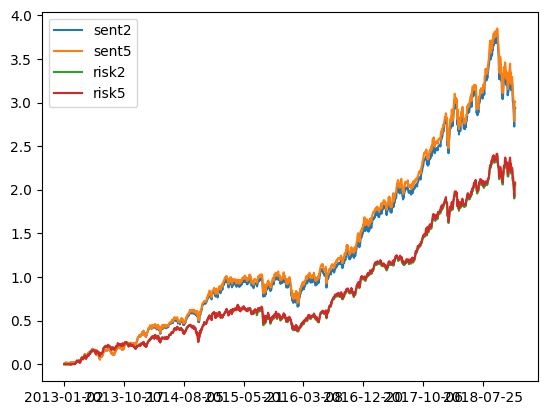

In [424]:
cumdf.plot()

In [425]:
cumdf

,sent2,sent5,risk2,risk5
2013-01-02,0.008848,0.008848,0.000000,0.000000
2013-01-03,0.011848,0.011848,0.000000,0.000000
2013-01-04,0.011925,0.011925,0.000000,0.000000
2013-01-07,0.015916,0.015916,0.000000,0.000000
2013-01-08,0.018357,0.018357,0.000000,0.000000
...,...,...,...,...
2018-12-21,2.793957,2.858897,1.963206,1.986034
2018-12-24,2.725418,2.789185,1.900590,1.922935
2018-12-26,2.931887,2.999189,2.040140,2.063561
2018-12-27,2.948234,3.015816,2.058783,2.082347


In [427]:
def eval_result(return_df):
    cal_eval = pd.DataFrame()
    for col in return_df.columns:
        save_eval = {}
        sharpe = backtest.calculate_sharpe_ratio(return_df[col], risk_free_rate=0.0, annual_factor=252)
        sortino = backtest.calculate_annualized_sortino_ratio(return_df[col], risk_free_rate=0.0, annual_factor=252)
        max_drawdown = backtest.calculate_max_drawdown(return_df[col])
        cagr = backtest.calculate_cagr(return_df[col], annual_factor=252)
        cumulative_return = backtest.calculate_cumulative_return(return_df[col])
        save_eval[col] = [cagr, cumulative_return, sharpe, max_drawdown, sortino]
        cal_eval = pd.concat([cal_eval, pd.DataFrame(save_eval)], axis=1)
    cal_eval = cal_eval.T
    cal_eval.columns = ["CAGR", "Cumulative Return",  "Sharpe Ratio", "Max Drawdown", "Sortino Ratio"]
    
    return cal_eval

In [428]:
eval_score = eval_result(returns_df)

In [429]:
eval_score

,CAGR,Cumulative Return,Sharpe Ratio,Max Drawdown,Sortino Ratio
sent2,0.257339,2.940319,1.326273,0.218715,1.728060
sent5,0.260908,3.007764,1.343366,0.218715,1.751462
risk2,0.205308,2.059302,1.262603,0.182177,1.707221
risk5,0.206853,2.082870,1.270046,0.175877,1.715404


In [ ]:

    
    # risk_2day_data = data_risk_2.loc[day]
    # risk2_returns[day] = make_weight(data_risk_2, day)
    
    # risk_5day_data = data_risk_5.loc[day]
    # risk5_returns[day] = make_weight(data_risk_5, day)


date
2013-01-02    0.046718
Name: ret, dtype: float64
date
2013-01-02    0.041766
Name: ret, dtype: float64
date
2013-01-02    0.046718
Name: ret, dtype: float64
date
2013-01-02    0.041766
Name: ret, dtype: float64
date
2013-01-03    0.07972
Name: ret, dtype: float64
date
2013-01-03   -0.015389
Name: ret, dtype: float64
date
2013-01-03    0.034364
Name: ret, dtype: float64
date
2013-01-03    0.07972
Name: ret, dtype: float64
date
2013-01-03   -0.015389
Name: ret, dtype: float64
date
2013-01-03    0.034364
Name: ret, dtype: float64
date
2013-01-04   -0.002195
Name: ret, dtype: float64
date
2013-01-04   -0.01412
Name: ret, dtype: float64
date
2013-01-04    0.010066
Name: ret, dtype: float64
date
2013-01-04    0.015504
Name: ret, dtype: float64
date
2013-01-04   -0.002195
Name: ret, dtype: float64
date
2013-01-04   -0.01412
Name: ret, dtype: float64
date
2013-01-04    0.010066
Name: ret, dtype: float64
date
2013-01-04    0.015504
Name: ret, dtype: float64
date
2013-01-07    0.013831
Name

In [217]:
sent2

,2013-01-02,2013-01-03,2013-01-04,2013-01-07,2013-01-08,2013-01-09,2013-01-10,2013-01-11,2013-01-14,2013-01-15
date,,,,,,,,,,
2013-01-02,0.008848,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2013-01-03,NaN,0.00987,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2013-01-04,NaN,NaN,0.000925,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2013-01-07,NaN,NaN,NaN,0.00375,NaN,NaN,NaN,NaN,NaN,NaN
2013-01-08,NaN,NaN,NaN,NaN,0.000399,NaN,NaN,NaN,NaN,NaN
2013-01-09,NaN,NaN,NaN,NaN,NaN,0.002933,NaN,NaN,NaN,NaN
2013-01-10,NaN,NaN,NaN,NaN,NaN,NaN,0.001717,NaN,NaN,NaN
2013-01-11,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.000217,NaN,NaN
2013-01-14,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.001394,NaN


In [147]:
## 동적 자산 전략입니다.
def cal_gtaa(data, before_asset_dict, portfolio_weight):
    """GTAA 코드입니다.
    day 기준 SMA 10달전 가격과 비교하여 양수인것들중 volume이 높은 자산 top 10개를 뽑습니다.
    만약 그 이하라면 남은 weight를 cash에 투자합니다.
    Args:
        data : day기준으로 slicing된 데이터입니다
        before_asset_dict : 자산별 weight를 저장한 Dictionary입니다.
        portfolio_weight : 전략의 weight입니다.
    Returns:
        before_asset_dict (dict): 자산별 weight를 저장한 Dictionary입니다.
    """
    data_imp = data.copy()
    data_imp = data_imp[data_imp["close"] > data_imp["SMA_220"]]
    data_imp = data_imp.sort_values(by="volume", ascending=False).head(10)
    weights = {ticker : 1/10 for ticker in data_imp["tic"]}
    
    for ticker in weights.keys():
        before_asset_dict[ticker] += weights[ticker]*portfolio_weight
    return before_asset_dict


def cal_sentiment(data, before_asset_dict, portfolio_weight):
    """GTAA 코드입니다.
    day 기준 긍정 뉴스인 주식에 투자하되 volume이 높은 자산 top 10개를 뽑습니다.
    만약 그 이하라면 남은 weight를 cash에 투자합니다.
    Args:
        data : day기준으로 slicing된 데이터입니다
        before_asset_dict : 자산별 weight를 저장한 Dictionary입니다.
        portfolio_weight : 전략의 weight입니다.
    Returns:
        before_asset_dict (dict): 자산별 weight를 저장한 Dictionary입니다.
    """
    data_imp = data.copy()
    data_imp = data_imp[data_imp["sentiment_weight_2"] > 1]
    data_imp = data_imp.sort_values(by="volume", ascending=False).head(10)
    weights = {ticker : 1/10 for ticker in data_imp["tic"]}
    
    for ticker in weights.keys():
        before_asset_dict[ticker] += weights[ticker]*portfolio_weight
    return before_asset_dict


def cal_risk(data, before_asset_dict, portfolio_weight):
    """GTAA 코드입니다.
    day 기준 긍정 뉴스인 주식에 투자하되 volume이 높은 자산 top 10개를 뽑습니다.
    만약 그 이하라면 남은 weight를 cash에 투자합니다.
    Args:
        data : day기준으로 slicing된 데이터입니다
        before_asset_dict : 자산별 weight를 저장한 Dictionary입니다.
        portfolio_weight : 전략의 weight입니다.
    Returns:
        before_asset_dict (dict): 자산별 weight를 저장한 Dictionary입니다.
    """
    data_imp = data.copy()
    data_imp = data_imp[data_imp["risk_weight_2"] < 3]
    data_imp = data_imp.sort_values(by="volume", ascending=False).head(10)
    weights = {ticker : 1/10 for ticker in data_imp["tic"]}
    
    for ticker in weights.keys():
        before_asset_dict[ticker] += weights[ticker]*portfolio_weight
    return before_asset_dict


def cal_dm(data, before_asset_dict, portfolio_weight):
    """듀얼 모멘텀 전략 코드입니다.
    day기준 12개월 누적 수익률이 무위험 수익률보다 높은 자산에 투자함
    수익률이 높은 자산 top 10개를 뽑습니다.
    만약 그 이하라면 현금을 보유합니다. 
    Args:
        data : day기준으로 slicing된 데이터입니다
        before_asset_dict : 자산별 weight를 저장한 Dictionary입니다.
        portfolio_weight : 전략의 weight입니다.
    Returns:
        before_asset_dict (dict): 자산별 weight를 저장한 Dictionary입니다.
        
    """
    data_imp = data.copy()
    data_imp = data_imp[data_imp["momentum_product"] > 1]
    data_imp = data_imp.sort_values(by="momentum_product", ascending=False).head(10)
    weights = {ticker : 1/10 for ticker in data_imp["tic"]}
    for ticker in weights.keys():
        before_asset_dict[ticker] += weights[ticker]*portfolio_weight
    return before_asset_dict


def cal_daa(data, before_asset_dict, portfolio_weight):
    """daa 전략 코드입니다.
    day 기준 모멘텀 스코어가 높은 자산에 투자함 수익률이 높은 자산 top 10개를 뽑습니다.
    만약 그 이하라면 현금을 보유합니다. 
    Args:
        data : day기준으로 slicing된 데이터입니다
        before_asset_dict : 자산별 weight를 저장한 Dictionary입니다.
        portfolio_weight : 전략의 weight입니다.
    Returns:
        before_asset_dict (dict): 자산별 weight를 저장한 Dictionary입니다.
        
    """
    data_imp = data.copy()
    data_imp = data_imp[data_imp["mom_score"] > 0]
    data_imp = data_imp.sort_values(by="mom_score", ascending=False).head(10)
    weights = {ticker : 1/10 for ticker in data_imp["tic"]}
    for ticker in weights.keys():
        before_asset_dict[ticker] += weights[ticker]*portfolio_weight
    return before_asset_dict


def cal_paa(data, before_asset_dict, portfolio_weight):
    """paa 전략 코드입니다.
    day 기준 paa_score가 높은 자산에 투자함 수익률이 높은 자산 top 10개를 뽑습니다.
    만약 그 이하라면 현금을 보유합니다. 
    Args:
        data : day기준으로 slicing된 데이터입니다
        before_asset_dict : 자산별 weight를 저장한 Dictionary입니다.
        portfolio_weight : 전략의 weight입니다.
    Returns:
        before_asset_dict (dict): 자산별 weight를 저장한 Dictionary입니다.
        
    """
    data_imp = data.copy()
    data_imp = data_imp[data_imp["paa_score"] > 0]
    data_imp = data_imp.sort_values(by="paa_score", ascending=False).head(10)
    weights = {ticker : 1/10 for ticker in data_imp["tic"]}
    for ticker in weights.keys():
        before_asset_dict[ticker] += weights[ticker]*portfolio_weight
    return before_asset_dict


def cal_return(data, future_data, save_return_dict, weights):
    """"
    미래 수익률을 구하는 코드입니다.
    """
    for ticker in weights.keys():
        now_price = data[data["tic"]==ticker]["close"][0]
        future_price = future_data[future_data["tic"]==ticker]["close"][0]
        future_return = future_price/now_price - 1
        weighted_future_return = future_return * weights[ticker]
        save_return_dict[ticker] = weighted_future_return
    return save_return_dict
    

def cal_asset_weight(ticker_weights, asset_dict, portfolio_weight):
    """
    자산별 weight를 뽑는 코드입니다.
    Args:
        ticker_weights (dict): 전략에서 나온 ticker 별 weight입니다.
        asset_dict (dict): asset별 weight를 저장할 Dictionary입니다.
        portfolio_weight (float): portfolio별 weight입니다.
    """
    for ticker, weight in ticker_weights.items():
        asset_dict[ticker] += weight*portfolio_weight
    return asset_dict


def calculate_buy_sell_dict(before_asset_dict, after_asset_dict):
    """
    매수 및 매도 비중을 구하기 위한 코드입니다.
    Args:
    - before_asset_dict (dict): 전 리밸런싱 거래 비중
    - after_asset_dict (dict): 현재 리밸런싱 거래 비중
    
    Returns:
    - buy_ticker_dict (dict): 매수 비중
    - sell_ticker_dict (dict): 매도 비중
    """
    buy_ticker_dict = {}
    sell_ticker_dict = {}

    for ticker in before_asset_dict.keys():
        before_weight = before_asset_dict.get(ticker, 0)
        after_weight = after_asset_dict.get(ticker, 0)

        if after_weight > before_weight:  # 매수
            buy_ticker_dict[ticker] = after_weight - before_weight
        elif after_weight < before_weight:  # 매도
            sell_ticker_dict[ticker] = before_weight - after_weight

    return buy_ticker_dict, sell_ticker_dict


def calculate_total_transaction_fee(today_data, buy_ticker_dict, sell_ticker_dict, invest_money):
    """
    매수 및 매도에 따른 거래 비용을 계산하는 코드입니다.
    Args:
    - today_data (pd.DataFrame): 현재 날짜의 데이터
    - buy_ticker_dict (dict): 매수 비중
    - sell_ticker_dict (dict): 매도 비중
    - invest_money (float): 총 투자 금액
    
    Returns:
    - total_transaction_fee (float): 총 거래 비용
    """
    transaction_fee_rate = 0.001  # 거래 수수료 비율
    # transaction_fee_rate = 0.0  # 거래 수수료 비율
    # print("transaction_fee_rate", transaction_fee_rate)
    total_transaction_fee = 0.0

    # 매수 거래 비용 계산
    for ticker, weight in buy_ticker_dict.items():
        # print(ticker, weight)
        price = today_data[today_data["tic"] == ticker]["close"].values[0]
        investment = invest_money * weight
        invest_count = int(investment / price)  # 정수 단위로 매수 가능한 수량
        actual_investment = invest_count * price  # 실제 투자 금액
        total_transaction_fee += actual_investment * transaction_fee_rate

    # 매도 거래 비용 계산
    for ticker, weight in sell_ticker_dict.items():
        # print(today_data[today_data["tic"] == ticker])
        price = today_data[today_data["tic"] == ticker]["close"].values[0]
        investment = invest_money * weight
        invest_count = int(investment / price)  # 정수 단위로 매도 가능한 수량
        actual_investment = invest_count * price  # 실제 매도 금액
        total_transaction_fee += actual_investment * transaction_fee_rate

    return total_transaction_fee


def calculate_rebalancing_investment(today_data, future_data, before_asset_dict, after_asset_dict, invest_money):
    """
    리밸런싱 후 투자 결과를 계산하는 코드입니다.
    Args:
    - today_data (pd.DataFrame): 현재 날짜의 데이터
    - future_data (pd.DataFrame): 미래 날짜의 데이터
    - before_asset_dict (dict): 전 리밸런싱 거래 비중
    - after_asset_dict (dict): 현재 리밸런싱 거래 비중
    - invest_money (float): 총 투자 금액
    
    Returns:
    - asset_invest_dict (dict): 자산별 최종 투자 금액
    - remain_money (float): 남은 잔여 투자 금액
    """
    # 매수 및 매도 비중 계산
    # print("before_asset_dict", before_asset_dict)
    buy_ticker_dict, sell_ticker_dict = calculate_buy_sell_dict(before_asset_dict, after_asset_dict)
    # print("buy_ticker_dict", before_asset_dict)
    # print("sell_ticker_dict", after_asset_dict)
    # print(today_data)
    # print(sell_ticker_dict)
    # 거래 비용 계산
    total_transaction_fee = calculate_total_transaction_fee(today_data, buy_ticker_dict, sell_ticker_dict, invest_money)

    # 거래 비용을 차감한 투자 가능 금액
    asset_invest_dict = {}
    remain_money = 0.0  # 잔여 투자 금액

    remain_invest_money = invest_money * (1-sum(after_asset_dict.values())) # 기존 투자금
    
    for ticker, weight in after_asset_dict.items():
        if weight == 0:
            # asset_invest_dict[ticker] = 0
            continue
        now_price = today_data[today_data["tic"] == ticker]["close"].values[0]
        future_price = future_data[future_data["tic"] == ticker]["close"].values[0]
        # future_return = future_price / now_price  # 미래 수익률

        # 티커별 투자 가능 금액 및 실제 투자 금액 계산
        ticker_investment = invest_money * weight
        invest_count = int(ticker_investment / now_price)  # 정수 단위로 매수 가능 수량
        actual_investment = invest_count * now_price  # 실제 투자 금액
        remain_money += ticker_investment - actual_investment  # 남은 잔여 금액
        
        future_investment = invest_count * future_price  # 미래 가치
        # 자산별 최종 금액 저장
        asset_invest_dict[ticker] = future_investment
    
    total_investment = sum(asset_invest_dict.values())
    backtesting_investment = total_investment - total_transaction_fee + remain_money + remain_invest_money

    return backtesting_investment, total_transaction_fee


In [148]:
import copy
def calculate_n_weight_action_return(n_weight, day, next_day, daily_nweight_money, before_asset_dict):
    """
    n_weight 동적 자산배분 return을 구하는 코드입니다.
    """
        
    real_data_day = env.real_data.loc[day]
    future_data = env.real_data.loc[next_day]
    # print(future_data)

    # before_asset_dict = copy.deepcopy(n_weight)
    after_asset_dict = {tick : 0 for tick in env.real_data.tic.unique()}
    for strategy, portfolio_weight in n_weight.items():
        after_asset_dict = env.dynamic_dict[strategy](real_data_day, after_asset_dict, portfolio_weight)
    # print(real_data_day)
    # print(future_data)
    backtesting_investment, total_transaction_fee = calculate_rebalancing_investment(real_data_day, future_data, 
                                                                    before_asset_dict, after_asset_dict, daily_nweight_money)
    
    
    return backtesting_investment, total_transaction_fee, after_asset_dict

In [149]:
def calculate_all_weight_action_return(all_weight, day, next_day, daily_all_weight_money, before_asset_dict, dynamic_dict):
    """
    all weight 동적 자산배분 return을 구하는 코드입니다.
    """
    # before_asset_dict = copy.deepcopy(n_weight)
    # print("before_asset_dict", before_asset_dict)
    real_data_day = env.real_data.loc[day]
    future_data = env.real_data.loc[next_day] 
    transaction_fees_dict = {}
    # 변화하는 자산을 구하기위한 빈 dict
    after_asset_dict =  {dm : {tick : 0 for tick in env.real_data.tic.unique()} for dm in list(dynamic_dict.keys())}
    # 전략별 Weihgt를 돌면서
    for strategy, portfolio_weight in all_weight.items():
        # 전략별 자산 이전 자산 비중 가져옴
        before_asset_dict_dm = copy.deepcopy(before_asset_dict[strategy])
        # 전략별 자산 비중을 구하기 위한 빈 dict
        after_asset_dict_dm = {tick : 0 for tick in env.real_data.tic.unique()}
        # 전략별 자산 비중 구함
        after_asset_dict_dm = dynamic_dict[strategy](real_data_day, after_asset_dict_dm, portfolio_weight)
        # 전략별 자산 비중 결과 도출
        backtesting_investment, total_transaction_fee = calculate_rebalancing_investment(real_data_day, future_data, before_asset_dict_dm, after_asset_dict_dm, daily_all_weight_money[strategy])
        # 투자금
        daily_all_weight_money[strategy] = backtesting_investment
        transaction_fees_dict[strategy] = total_transaction_fee
        after_asset_dict[strategy] = after_asset_dict_dm
        # print("after_asset_dict", after_asset_dict)

    return daily_all_weight_money, transaction_fees_dict, after_asset_dict

In [ ]:
def make_daily_invest_data(empty_df, asset_weight, invest_money, daily_data, total_transaction_fee,  day, next_day):
    cash_weight = 1- sum(asset_weight.values())
    invest_weight = sum(asset_weight.values())
    # print("invest_weight", invest_weight)
    invest_money = invest_money - total_transaction_fee
    cash_money = invest_money * cash_weight
    # invest_money_remain = invest_money * invest_weight
    
    daily_data_inx = env.real_data.loc[day:next_day]
    # next_day = daily_data_inx.index.unique()[-2]
    # daily_data_inx = self.real_data.loc[day:next_day]

    
    save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)
    # print("after invest_money : ", invest_money_remain)
    # print("cash_money : ", cash_money)
    # print("total_invest_money : ", cash_money + invest_money_remain)
    # print(daily_data.TICKER.nunique())
    # print(len(asset_weight.keys()))
    # print(asset_weight)

    for tic, weight in asset_weight.items():
        imp = daily_data[daily_data["tic"] == tic]
        daily_return = imp["close"].pct_change().fillna(0)
        daily_return = daily_return.loc[day:next_day]
        
        # print("daily_return", daily_return)
        test = weight * (1+daily_return).cumprod() * invest_money
        save_data["invest"] += test.values
    save_data["invest"] += cash_money
    # print(save_data)
    empty_df = pd.concat([empty_df, save_data], axis=0)
    return empty_df, imp, save_data


In [151]:
dynamic_dict = {
            "GTAA": cal_gtaa, 
            "DM": cal_dm,  
            "PAA": cal_paa, 
            "DAA": cal_daa,
            "Sentiment": cal_sentiment,
            "risk": cal_risk}

In [152]:
# all weight
idx = 0
window_size = 20

all_weight_invest_dict = {dm : 10000000 for dm in dynamic_dict.keys()}
all_weight_invest_rewards = {dm : [10000000] for dm in dynamic_dict.keys()}


before_weight_tick = {dm : {tick : 0 for tick in env.real_data.tic.unique()} for dm in list(dynamic_dict.keys())}
all_weight_df = pd.DataFrame()
all_weight = env.all_weight()

for day in env.days[::window_size]:
    if idx + window_size <= len(env.days):
        next_day = env.days[idx+window_size-1]
        
    else:
        next_day = env.real_data.index.unique()[-1]
    idx += window_size
    print("day", day)

    total_inveset_money, total_transaction_fee_dict, after_asset_dict = calculate_all_weight_action_return(all_weight, day, next_day, all_weight_invest_dict, before_weight_tick, dynamic_dict)

    before_weight_tick = copy.deepcopy(after_asset_dict)

    dm_df = pd.DataFrame()
    # 자산 비중을 돈다
    for dm, all_weight_asset in all_weight.items():
        imp_df = pd.DataFrame()
        # 비중을 가져옴
        # 거래비용 가져옴
        dm_fee = total_transaction_fee_dict[dm]
        # 자산 비중을 구하기 위한 빈 dict
        # 전략별 티커 투자 비중
        before_asset_dict_dm = after_asset_dict[dm]
        dm_invest_money = total_inveset_money[dm]

        imp_df, tmp, save_data =  make_daily_invest_data(imp_df,  before_asset_dict_dm, dm_invest_money, env.real_data, dm_fee, day, next_day)
        imp_df.columns = [f"{dm}"]

        # n_weight_df = make_daily_invest_data(n_weight_df,  before_asset_dict, daily_nweight_money, env.real_data, n_total_transaction_fee, day, next_day)

        dm_df = pd.concat([dm_df, imp_df], axis=1)
    all_weight_df = pd.concat([all_weight_df, dm_df])
    
    all_weight_invest_dict = all_weight_df.iloc[-1].to_dict()
    
    for dm, all_weight_dict in all_weight_invest_dict.items():
        all_weight_invest_rewards[dm].append(all_weight_dict)

        
        # n_weight_df = make_daily_invest_data(n_weight_df,  before_asset_dict, daily_nweight_money, env.real_data, n_total_transaction_fee, day, next_day)

        # print("daily_nweight_money", daily_nweight_money)

    # backtesting_investment, total_transaction_fee, after_asset_dict = calculate_all_weight_action_return(all_weight, day, next_day, all_weight_invest_dict, before_weight_tick)
    # print("backtesting_investment", backtesting_investment)
    # dm_df = pd.DataFrame()
    # for dm, all_weight_asset in all_weight_dict.items():
    #     imp_df = pd.DataFrame()
    # daily_nweight_money = n_rewards[-1]


day 2013-01-02
daily_return date
2013-01-02    0.000000
2013-01-03   -0.012622
2013-01-04   -0.027855
2013-01-07   -0.005883
2013-01-08    0.002691
2013-01-09   -0.015629
2013-01-10    0.012396
2013-01-11   -0.006132
2013-01-14   -0.035652
2013-01-15   -0.031550
2013-01-16    0.041509
2013-01-17   -0.006738
2013-01-18   -0.005331
2013-01-22    0.009540
2013-01-23    0.018305
2013-01-24   -0.123558
2013-01-25   -0.023574
2013-01-28    0.022620
2013-01-29    0.018762
2013-01-30   -0.003142
Name: close, dtype: float64
daily_return date
2013-01-02    0.000000
2013-01-03   -0.015389
2013-01-04    0.010066
2013-01-07   -0.004983
2013-01-08    0.005272
2013-01-09    0.013634
2013-01-10   -0.001035
2013-01-11   -0.013723
2013-01-14    0.001838
2013-01-15   -0.000262
2013-01-16   -0.007077
2013-01-17   -0.003960
2013-01-18    0.006626
2013-01-22   -0.000790
2013-01-23    0.007905
2013-01-24   -0.003660
2013-01-25    0.005510
2013-01-28   -0.002088
2013-01-29    0.007322
2013-01-30   -0.015057
N

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-01-02    0.000000
2013-01-03   -0.003997
2013-01-04    0.010463
2013-01-07   -0.000142
2013-01-08    0.008370
2013-01-09    0.014772
2013-01-10    0.001802
2013-01-11    0.007888
2013-01-14    0.001785
2013-01-15    0.001371
2013-01-16   -0.005749
2013-01-17    0.012665
2013-01-18   -0.006525
2013-01-22   -0.005063
2013-01-23   -0.001238
2013-01-24    0.001652
2013-01-25    0.010723
2013-01-28    0.005713
2013-01-29    0.002434
2013-01-30   -0.005262
Name: close, dtype: float64
daily_return date
2013-01-02    0.000000
2013-01-03   -0.020964
2013-01-04   -0.010248
2013-01-07   -0.016226
2013-01-08   -0.008168
2013-01-09    0.005702
2013-01-10    0.018425
2013-01-11    0.011597
2013-01-14   -0.015592
2013-01-15   -0.020497
2013-01-16    0.011731
2013-01-17    0.070981
2013-01-18    0.011997
2013-01-22    0.010843
2013-01-23   -0.009726
2013-01-24    0.028163
2013-01-25    0.040034
2013-01-28    0.019314
2013-01-29   -0.002650
2013-01-30   -0.000664
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-01-02    0.000000
2013-01-03   -0.011163
2013-01-04   -0.000525
2013-01-07   -0.004465
2013-01-08    0.006860
2013-01-09    0.006814
2013-01-10    0.002082
2013-01-11   -0.001039
2013-01-14    0.011960
2013-01-15    0.007194
2013-01-16   -0.000510
2013-01-17    0.019653
2013-01-18    0.008010
2013-01-22   -0.011423
2013-01-23    0.004773
2013-01-24   -0.010500
2013-01-25    0.004548
2013-01-28   -0.004779
2013-01-29   -0.011625
2013-01-30   -0.002045
Name: close, dtype: float64
daily_return date
2013-01-02    0.000000
2013-01-03    0.010251
2013-01-04   -0.003220
2013-01-07   -0.007733
2013-01-08   -0.001874
2013-01-09    0.000493
2013-01-10   -0.004840
2013-01-11   -0.004566
2013-01-14    0.000897
2013-01-15    0.007771
2013-01-16    0.003757
2013-01-17   -0.005614
2013-01-18    0.002377
2013-01-22    0.009388
2013-01-23   -0.000294
2013-01-24    0.007540
2013-01-25   -0.005151
2013-01-28    0.001270
2013-01-29    0.008488
2013-01-30   -0.008030
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-01-02    0.000000
2013-01-03    0.027113
2013-01-04    0.004799
2013-01-07   -0.012624
2013-01-08   -0.023842
2013-01-09   -0.033628
2013-01-10   -0.015018
2013-01-11   -0.037932
2013-01-14    0.029764
2013-01-15   -0.011261
2013-01-16   -0.012908
2013-01-17    0.018462
2013-01-18    0.006042
2013-01-22    0.029279
2013-01-23   -0.012035
2013-01-24    0.026947
2013-01-25    0.027678
2013-01-28   -0.000350
2013-01-29    0.006648
2013-01-30    0.017379
Name: close, dtype: float64
daily_return date
2013-01-02    0.000000
2013-01-03   -0.002534
2013-01-04    0.000000
2013-01-07   -0.011854
2013-01-08   -0.013711
2013-01-09    0.014770
2013-01-10   -0.003425
2013-01-11    0.006014
2013-01-14    0.003416
2013-01-15    0.001702
2013-01-16    0.013594
2013-01-17    0.039396
2013-01-18    0.020161
2013-01-22    0.004743
2013-01-23   -0.000787
2013-01-24   -0.007874
2013-01-25    0.018254
2013-01-28    0.010132
2013-01-29   -0.012346
2013-01-30    0.004687
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-01-02    0.000000
2013-01-03   -0.014267
2013-01-04   -0.013053
2013-01-07    0.003358
2013-01-08   -0.013864
2013-01-09   -0.002147
2013-01-10   -0.001180
2013-01-11   -0.000834
2013-01-14    0.000626
2013-01-15   -0.006047
2013-01-16   -0.001328
2013-01-17    0.006302
2013-01-18    0.003896
2013-01-22    0.004020
2013-01-23   -0.009043
2013-01-24    0.019923
2013-01-25   -0.001434
2013-01-28    0.025923
2013-01-29    0.026202
2013-01-30    0.007536
Name: close, dtype: float64
daily_return date
2013-01-02    0.000000
2013-01-03    0.016181
2013-01-04   -0.000493
2013-01-07    0.013834
2013-01-08    0.000061
2013-01-09   -0.008868
2013-01-10    0.003115
2013-01-11    0.002861
2013-01-14    0.011335
2013-01-15    0.000649
2013-01-16    0.006769
2013-01-17    0.003070
2013-01-18    0.004225
2013-01-22   -0.002155
2013-01-23    0.001475
2013-01-24    0.010844
2013-01-25    0.057788
2013-01-28   -0.019254
2013-01-29   -0.006653
2013-01-30   -0.007425
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-01-02    0.000000
2013-01-03   -0.012622
2013-01-04   -0.027855
2013-01-07   -0.005883
2013-01-08    0.002691
2013-01-09   -0.015629
2013-01-10    0.012396
2013-01-11   -0.006132
2013-01-14   -0.035652
2013-01-15   -0.031550
2013-01-16    0.041509
2013-01-17   -0.006738
2013-01-18   -0.005331
2013-01-22    0.009540
2013-01-23    0.018305
2013-01-24   -0.123558
2013-01-25   -0.023574
2013-01-28    0.022620
2013-01-29    0.018762
2013-01-30   -0.003142
Name: close, dtype: float64
daily_return date
2013-01-02    0.000000
2013-01-03   -0.015389
2013-01-04    0.010066
2013-01-07   -0.004983
2013-01-08    0.005272
2013-01-09    0.013634
2013-01-10   -0.001035
2013-01-11   -0.013723
2013-01-14    0.001838
2013-01-15   -0.000262
2013-01-16   -0.007077
2013-01-17   -0.003960
2013-01-18    0.006626
2013-01-22   -0.000790
2013-01-23    0.007905
2013-01-24   -0.003660
2013-01-25    0.005510
2013-01-28   -0.002088
2013-01-29    0.007322
2013-01-30   -0.015057
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-01-02    0.000000
2013-01-03   -0.003997
2013-01-04    0.010463
2013-01-07   -0.000142
2013-01-08    0.008370
2013-01-09    0.014772
2013-01-10    0.001802
2013-01-11    0.007888
2013-01-14    0.001785
2013-01-15    0.001371
2013-01-16   -0.005749
2013-01-17    0.012665
2013-01-18   -0.006525
2013-01-22   -0.005063
2013-01-23   -0.001238
2013-01-24    0.001652
2013-01-25    0.010723
2013-01-28    0.005713
2013-01-29    0.002434
2013-01-30   -0.005262
Name: close, dtype: float64
daily_return date
2013-01-02    0.000000
2013-01-03   -0.020964
2013-01-04   -0.010248
2013-01-07   -0.016226
2013-01-08   -0.008168
2013-01-09    0.005702
2013-01-10    0.018425
2013-01-11    0.011597
2013-01-14   -0.015592
2013-01-15   -0.020497
2013-01-16    0.011731
2013-01-17    0.070981
2013-01-18    0.011997
2013-01-22    0.010843
2013-01-23   -0.009726
2013-01-24    0.028163
2013-01-25    0.040034
2013-01-28    0.019314
2013-01-29   -0.002650
2013-01-30   -0.000664
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-01-31    0.000937
2013-02-01    0.009829
2013-02-04   -0.006489
2013-02-05    0.009214
2013-02-06    0.000693
2013-02-07   -0.015822
2013-02-08    0.018188
2013-02-11   -0.015991
2013-02-12   -0.004475
2013-02-13    0.004732
2013-02-14   -0.002590
2013-02-15   -0.013102
2013-02-19    0.006219
2013-02-20    0.006181
2013-02-21    0.005671
2013-02-22    0.019852
2013-02-25    0.031445
2013-02-26   -0.000894
2013-02-27    0.017436
2013-02-28    0.005713
Name: close, dtype: float64
daily_return date
2013-01-31   -0.026617
2013-02-01   -0.001883
2013-02-04   -0.018943
2013-02-05    0.026579
2013-02-06   -0.017498
2013-02-07   -0.007589
2013-02-08    0.006609
2013-02-11   -0.018095
2013-02-12    0.005793
2013-02-13    0.041631
2013-02-14   -0.000854
2013-02-15   -0.015414
2013-02-19    0.017579
2013-02-20   -0.012382
2013-02-21   -0.001764
2013-02-22   -0.001955
2013-02-25   -0.020910
2013-02-26   -0.001962
2013-02-27    0.014998
2013-02-28    0.003875
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-01-31   -0.001786
2013-02-01    0.006932
2013-02-04   -0.014657
2013-02-05    0.016227
2013-02-06    0.002883
2013-02-07   -0.008404
2013-02-08    0.018065
2013-02-11   -0.005477
2013-02-12    0.009251
2013-02-13    0.006766
2013-02-14    0.024495
2013-02-15   -0.014389
2013-02-19    0.001503
2013-02-20   -0.012219
2013-02-21   -0.011285
2013-02-22    0.005268
2013-02-25   -0.033843
2013-02-26    0.004746
2013-02-27    0.017094
2013-02-28   -0.008846
Name: close, dtype: float64
daily_return date
2013-01-31   -0.000717
2013-02-01    0.015793
2013-02-04   -0.027562
2013-02-05    0.004360
2013-02-06    0.016643
2013-02-07   -0.009964
2013-02-08    0.017973
2013-02-11    0.004237
2013-02-12    0.009845
2013-02-13   -0.007660
2013-02-14   -0.003509
2013-02-15    0.004930
2013-02-19   -0.001402
2013-02-20   -0.008421
2013-02-21    0.007077
2013-02-22    0.009136
2013-02-25   -0.011838
2013-02-26   -0.012685
2013-02-27    0.013562
2013-02-28   -0.002817
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-01-31   -0.011999
2013-02-01    0.023603
2013-02-04   -0.013880
2013-02-05    0.014302
2013-02-06    0.001343
2013-02-07   -0.007823
2013-02-08    0.029511
2013-02-11    0.008315
2013-02-12    0.004124
2013-02-13   -0.000216
2013-02-14    0.006053
2013-02-15   -0.007735
2013-02-19    0.017973
2013-02-20   -0.025952
2013-02-21   -0.014632
2013-02-22    0.008865
2013-02-25   -0.016476
2013-02-26    0.005137
2013-02-27    0.016122
2013-02-28   -0.003526
Name: close, dtype: float64
daily_return date
2013-01-31   -0.003027
2013-02-01    0.022938
2013-02-04   -0.018137
2013-02-05    0.028212
2013-02-06   -0.007512
2013-02-07   -0.004443
2013-02-08    0.007107
2013-02-11   -0.009683
2013-02-12    0.000332
2013-02-13    0.001491
2013-02-14    0.004797
2013-02-15    0.007903
2013-02-19    0.003921
2013-02-20   -0.004068
2013-02-21   -0.015357
2013-02-22    0.012278
2013-02-25   -0.003934
2013-02-26    0.005101
2013-02-27    0.008349
2013-02-28   -0.003734
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-01-31   -0.001728
2013-02-01    0.041551
2013-02-04   -0.022760
2013-02-05    0.000916
2013-02-06   -0.006667
2013-02-07   -0.009212
2013-02-08   -0.006774
2013-02-11    0.001739
2013-02-12    0.000667
2013-02-13   -0.009338
2013-02-14    0.007945
2013-02-15   -0.029526
2013-02-19    0.018172
2013-02-20   -0.024473
2013-02-21   -0.021206
2013-02-22    0.014585
2013-02-25   -0.026797
2013-02-26    0.026101
2013-02-27    0.003354
2013-02-28   -0.011283
Name: close, dtype: float64
daily_return date
2013-01-31    0.020542
2013-02-01    0.013699
2013-02-04   -0.029785
2013-02-05    0.006538
2013-02-06    0.006496
2013-02-07   -0.019080
2013-02-08    0.010298
2013-02-11    0.002265
2013-02-12   -0.007344
2013-02-13    0.000854
2013-02-14    0.013364
2013-02-15   -0.014029
2013-02-19    0.011383
2013-02-20   -0.024479
2013-02-21   -0.028843
2013-02-22    0.012474
2013-02-25   -0.033441
2013-02-26    0.005463
2013-02-27    0.016903
2013-02-28    0.015731
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-01-31   -0.001853
2013-02-01    0.017686
2013-02-04   -0.016035
2013-02-05    0.008099
2013-02-06   -0.012957
2013-02-07    0.001475
2013-02-08    0.009229
2013-02-11   -0.007783
2013-02-12   -0.002255
2013-02-13   -0.001278
2013-02-14    0.003837
2013-02-15    0.001470
2013-02-19   -0.002642
2013-02-20   -0.008047
2013-02-21   -0.003858
2013-02-22    0.004668
2013-02-25   -0.010577
2013-02-26   -0.006394
2013-02-27    0.012871
2013-02-28    0.005560
Name: close, dtype: float64
daily_return date
2013-01-31    0.061484
2013-02-01   -0.003063
2013-02-04   -0.006425
2013-02-05    0.025583
2013-02-06    0.002741
2013-02-07   -0.015856
2013-02-08    0.000000
2013-02-11   -0.004444
2013-02-12   -0.005859
2013-02-13    0.003087
2013-02-14    0.005596
2013-02-15    0.010573
2013-02-19   -0.011839
2013-02-20   -0.026191
2013-02-21   -0.010587
2013-02-22   -0.004627
2013-02-25   -0.003196
2013-02-26    0.006995
2013-02-27    0.018524
2013-02-28   -0.029838
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-01-31    0.071404
2013-02-01    0.017219
2013-02-04    0.006897
2013-02-05    0.005915
2013-02-06   -0.001857
2013-02-07   -0.000310
2013-02-08    0.015198
2013-02-11    0.009166
2013-02-12   -0.000303
2013-02-13   -0.008177
2013-02-14   -0.005801
2013-02-15    0.005221
2013-02-19   -0.003972
2013-02-20   -0.026687
2013-02-21   -0.010085
2013-02-22    0.014963
2013-02-25   -0.021330
2013-02-26   -0.004808
2013-02-27    0.013527
2013-02-28   -0.000953
Name: close, dtype: float64
daily_return date
2013-01-31    0.003888
2013-02-01    0.020140
2013-02-04   -0.012908
2013-02-05    0.032308
2013-02-06   -0.001490
2013-02-07   -0.007463
2013-02-08    0.023308
2013-02-11    0.003674
2013-02-12    0.000000
2013-02-13    0.008053
2013-02-14    0.008715
2013-02-15   -0.004348
2013-02-19    0.010917
2013-02-20   -0.021598
2013-02-21   -0.025018
2013-02-22    0.024151
2013-02-25   -0.025056
2013-02-26    0.030235
2013-02-27    0.008070
2013-02-28   -0.002183
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-03-01    0.004726
2013-03-04    0.003082
2013-03-05    0.013260
2013-03-06    0.001205
2013-03-07    0.016693
2013-03-08    0.000158
2013-03-11    0.008208
2013-03-12    0.001565
2013-03-13    0.003283
2013-03-14    0.013088
2013-03-15   -0.008305
2013-03-18   -0.004032
2013-03-19    0.001401
2013-03-20    0.001866
2013-03-21   -0.010865
2013-03-22    0.005492
2013-03-25   -0.002341
2013-03-26    0.013453
2013-03-27   -0.002007
2013-03-28    0.005722
Name: close, dtype: float64
daily_return date
2013-03-01    0.017429
2013-03-04    0.034529
2013-03-05    0.017852
2013-03-06    0.015252
2013-03-07    0.001753
2013-03-08    0.003999
2013-03-11    0.004730
2013-03-12   -0.001487
2013-03-13    0.003970
2013-03-14    0.005685
2013-03-15   -0.013517
2013-03-18   -0.002740
2013-03-19   -0.008993
2013-03-20    0.037560
2013-03-21   -0.003158
2013-03-22    0.008774
2013-03-25   -0.024402
2013-03-26    0.005448
2013-03-27    0.007882
2013-03-28    0.008065
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-03-01    0.000220
2013-03-04    0.005281
2013-03-05    0.007222
2013-03-06   -0.006085
2013-03-07    0.001312
2013-03-08   -0.003275
2013-03-11   -0.002409
2013-03-12    0.007905
2013-03-13   -0.001089
2013-03-14    0.014613
2013-03-15   -0.001290
2013-03-18   -0.006027
2013-03-19    0.003898
2013-03-20   -0.003883
2013-03-21    0.038328
2013-03-22    0.025026
2013-03-25    0.009562
2013-03-26   -0.004232
2013-03-27   -0.003846
2013-03-28    0.015441
Name: close, dtype: float64
daily_return date
2013-03-01    0.014188
2013-03-04    0.007469
2013-03-05    0.007943
2013-03-06    0.006655
2013-03-07   -0.005683
2013-03-08    0.005307
2013-03-11    0.010210
2013-03-12    0.010968
2013-03-13    0.000568
2013-03-14    0.003577
2013-03-15    0.000000
2013-03-18   -0.007127
2013-03-19    0.000513
2013-03-20    0.014179
2013-03-21   -0.008703
2013-03-22    0.008213
2013-03-25   -0.010000
2013-03-26    0.004937
2013-03-27    0.031566
2013-03-28    0.054412
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-03-01   -0.024762
2013-03-04   -0.024206
2013-03-05    0.026402
2013-03-06   -0.012710
2013-03-07    0.011558
2013-03-08    0.002647
2013-03-11    0.014245
2013-03-12   -0.021559
2013-03-13   -0.000187
2013-03-14    0.009688
2013-03-15    0.025804
2013-03-18    0.027183
2013-03-19   -0.002699
2013-03-20   -0.005303
2013-03-21    0.001437
2013-03-22    0.020277
2013-03-25    0.003615
2013-03-26   -0.005263
2013-03-27   -0.019647
2013-03-28   -0.020837
Name: close, dtype: float64
daily_return date
2013-03-01    0.013228
2013-03-04    0.015817
2013-03-05    0.024716
2013-03-06   -0.004100
2013-03-07    0.005086
2013-03-08    0.000000
2013-03-11   -0.000482
2013-03-12   -0.001929
2013-03-13    0.004589
2013-03-14    0.000721
2013-03-15   -0.005766
2013-03-18   -0.007733
2013-03-19   -0.007550
2013-03-20    0.041963
2013-03-21   -0.006594
2013-03-22    0.018729
2013-03-25   -0.011171
2013-03-26    0.006119
2013-03-27   -0.002105
2013-03-28    0.020159
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-03-01    0.011250
2013-03-04    0.001620
2013-03-05    0.007657
2013-03-06   -0.001819
2013-03-07   -0.003431
2013-03-08    0.000537
2013-03-11   -0.016774
2013-03-12    0.003390
2013-03-13   -0.002289
2013-03-14    0.006991
2013-03-15   -0.004014
2013-03-18   -0.015467
2013-03-19    0.022237
2013-03-20    0.017857
2013-03-21    0.002764
2013-03-22    0.023858
2013-03-25    0.002589
2013-03-26    0.019109
2013-03-27    0.015102
2013-03-28    0.023565
Name: close, dtype: float64
daily_return date
2013-03-01    0.005562
2013-03-04    0.027734
2013-03-05    0.009081
2013-03-06   -0.006531
2013-03-07    0.000329
2013-03-08    0.001132
2013-03-11   -0.010759
2013-03-12    0.010655
2013-03-13    0.003538
2013-03-14   -0.034024
2013-03-15   -0.014751
2013-03-18   -0.015010
2013-03-19   -0.005739
2013-03-20    0.003393
2013-03-21   -0.015120
2013-03-22    0.017207
2013-03-25   -0.006712
2013-03-26    0.016757
2013-03-27    0.019169
2013-03-28    0.004485
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-03-01   -0.015537
2013-03-04    0.026542
2013-03-05    0.023061
2013-03-06    0.004098
2013-03-07   -0.009524
2013-03-08   -0.005495
2013-03-11    0.006906
2013-03-12   -0.036351
2013-03-13    0.003559
2013-03-14    0.000000
2013-03-15   -0.012766
2013-03-18   -0.022988
2013-03-19   -0.016912
2013-03-20    0.001496
2013-03-21   -0.002241
2013-03-22   -0.002994
2013-03-25    0.024024
2013-03-26    0.007331
2013-03-27    0.005095
2013-03-28    0.008689
Name: close, dtype: float64
daily_return date
2013-03-01    0.001158
2013-03-04    0.005781
2013-03-05    0.007127
2013-03-06    0.027052
2013-03-07   -0.002000
2013-03-08   -0.008241
2013-03-11   -0.001235
2013-03-12    0.006183
2013-03-13    0.004246
2013-03-14    0.002559
2013-03-15   -0.000222
2013-03-18    0.088245
2013-03-19    0.023868
2013-03-20    0.053696
2013-03-21   -0.032240
2013-03-22    0.008988
2013-03-25   -0.008133
2013-03-26    0.005369
2013-03-27    0.012623
2013-03-28   -0.001055
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-03-01    0.004726
2013-03-04    0.003082
2013-03-05    0.013260
2013-03-06    0.001205
2013-03-07    0.016693
2013-03-08    0.000158
2013-03-11    0.008208
2013-03-12    0.001565
2013-03-13    0.003283
2013-03-14    0.013088
2013-03-15   -0.008305
2013-03-18   -0.004032
2013-03-19    0.001401
2013-03-20    0.001866
2013-03-21   -0.010865
2013-03-22    0.005492
2013-03-25   -0.002341
2013-03-26    0.013453
2013-03-27   -0.002007
2013-03-28    0.005722
Name: close, dtype: float64
daily_return date
2013-03-01    0.017429
2013-03-04    0.034529
2013-03-05    0.017852
2013-03-06    0.015252
2013-03-07    0.001753
2013-03-08    0.003999
2013-03-11    0.004730
2013-03-12   -0.001487
2013-03-13    0.003970
2013-03-14    0.005685
2013-03-15   -0.013517
2013-03-18   -0.002740
2013-03-19   -0.008993
2013-03-20    0.037560
2013-03-21   -0.003158
2013-03-22    0.008774
2013-03-25   -0.024402
2013-03-26    0.005448
2013-03-27    0.007882
2013-03-28    0.008065
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-04-01   -0.003217
2013-04-02    0.010834
2013-04-03   -0.003421
2013-04-04    0.011670
2013-04-05   -0.018774
2013-04-08    0.009451
2013-04-09    0.008678
2013-04-10    0.011999
2013-04-11    0.011409
2013-04-12   -0.003981
2013-04-15   -0.009549
2013-04-16    0.015247
2013-04-17   -0.008392
2013-04-18   -0.009800
2013-04-19    0.006298
2013-04-22   -0.004694
2013-04-23    0.007635
2013-04-24   -0.004457
2013-04-25    0.008507
2013-04-26   -0.003108
Name: close, dtype: float64
daily_return date
2013-04-01   -0.023231
2013-04-02   -0.004625
2013-04-03   -0.025221
2013-04-04   -0.007263
2013-04-05   -0.002972
2013-04-08    0.008943
2013-04-09    0.001590
2013-04-10    0.023372
2013-04-11   -0.004435
2013-04-12   -0.006904
2013-04-15   -0.016820
2013-04-16    0.020529
2013-04-17   -0.042244
2013-04-18   -0.011902
2013-04-19    0.000472
2013-04-22    0.007082
2013-04-23    0.018050
2013-04-24    0.000691
2013-04-25    0.004372
2013-04-26   -0.008018
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-04-01   -0.018312
2013-04-02    0.006537
2013-04-03   -0.016292
2013-04-04    0.000193
2013-04-05   -0.013895
2013-04-08    0.013582
2013-04-09    0.008457
2013-04-10    0.013901
2013-04-11    0.019187
2013-04-12    0.011191
2013-04-15   -0.018874
2013-04-16    0.017257
2013-04-17   -0.018139
2013-04-18   -0.029843
2013-04-19    0.003469
2013-04-22    0.012408
2013-04-23    0.020300
2013-04-24   -0.000446
2013-04-25    0.022025
2013-04-26   -0.072406
Name: close, dtype: float64
daily_return date
2013-04-01   -0.023581
2013-04-02   -0.001509
2013-04-03   -0.019652
2013-04-04   -0.006297
2013-04-05   -0.010992
2013-04-08    0.000915
2013-04-09   -0.000523
2013-04-10    0.036466
2013-04-11   -0.016520
2013-04-12    0.004103
2013-04-15   -0.023241
2013-04-16    0.020133
2013-04-17   -0.014225
2013-04-18   -0.024051
2013-04-19   -0.002531
2013-04-22    0.001870
2013-04-23    0.022794
2013-04-24    0.011078
2013-04-25    0.009281
2013-04-26   -0.003704
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-04-01   -0.022254
2013-04-02   -0.004405
2013-04-03   -0.023599
2013-04-04    0.013595
2013-04-05   -0.011177
2013-04-08    0.003014
2013-04-09    0.000751
2013-04-10    0.014264
2013-04-11   -0.013323
2013-04-12    0.002251
2013-04-15   -0.019461
2013-04-16   -0.009160
2013-04-17   -0.024653
2013-04-18   -0.009479
2013-04-19   -0.011164
2013-04-22    0.012903
2013-04-23    0.008758
2013-04-24    0.003946
2013-04-25    0.078616
2013-04-26   -0.005102
Name: close, dtype: float64
daily_return date
2013-04-01   -0.003840
2013-04-02    0.000193
2013-04-03   -0.014644
2013-04-04    0.022194
2013-04-05    0.008991
2013-04-08   -0.007015
2013-04-09   -0.011169
2013-04-10    0.000869
2013-04-11    0.011286
2013-04-12    0.002098
2013-04-15   -0.018846
2013-04-16    0.017753
2013-04-17   -0.008388
2013-04-18   -0.012496
2013-04-19    0.003018
2013-04-22    0.007861
2013-04-23    0.005392
2013-04-24   -0.013026
2013-04-25   -0.018826
2013-04-26    0.005242
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-04-01   -0.005382
2013-04-02    0.009276
2013-04-03   -0.008119
2013-04-04   -0.000463
2013-04-05   -0.014679
2013-04-08    0.007684
2013-04-09    0.003112
2013-04-10    0.018617
2013-04-11    0.006853
2013-04-12   -0.003025
2013-04-15   -0.022000
2013-04-16    0.014738
2013-04-17   -0.000917
2013-04-18   -0.011018
2013-04-19    0.009284
2013-04-22    0.004140
2013-04-23    0.013130
2013-04-24    0.004671
2013-04-25    0.001500
2013-04-26   -0.002696
Name: close, dtype: float64
daily_return date
2013-04-01   -0.032000
2013-04-02   -0.009016
2013-04-03   -0.026030
2013-04-04   -0.001557
2013-04-05   -0.003378
2013-04-08    0.000000
2013-04-09    0.002868
2013-04-10    0.030941
2013-04-11   -0.016141
2013-04-12   -0.016662
2013-04-15   -0.043014
2013-04-16    0.026696
2013-04-17   -0.023083
2013-04-18   -0.024172
2013-04-19    0.005288
2013-04-22    0.003322
2013-04-23    0.028146
2013-04-24    0.008052
2013-04-25    0.008253
2013-04-26   -0.014787
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-04-01   -0.023581
2013-04-02   -0.001509
2013-04-03   -0.019652
2013-04-04   -0.006297
2013-04-05   -0.010992
2013-04-08    0.000915
2013-04-09   -0.000523
2013-04-10    0.036466
2013-04-11   -0.016520
2013-04-12    0.004103
2013-04-15   -0.023241
2013-04-16    0.020133
2013-04-17   -0.014225
2013-04-18   -0.024051
2013-04-19   -0.002531
2013-04-22    0.001870
2013-04-23    0.022794
2013-04-24    0.011078
2013-04-25    0.009281
2013-04-26   -0.003704
Name: close, dtype: float64
daily_return date
2013-04-01   -0.013384
2013-04-02   -0.003578
2013-04-03   -0.008977
2013-04-04   -0.002415
2013-04-05    0.009534
2013-04-08    0.005097
2013-04-09    0.000596
2013-04-10    0.023402
2013-04-11    0.009613
2013-04-12   -0.003030
2013-04-15   -0.038200
2013-04-16    0.019708
2013-04-17    0.025081
2013-04-18    0.027778
2013-04-19    0.008122
2013-04-22   -0.010418
2013-04-23    0.017406
2013-04-24    0.014625
2013-04-25    0.016997
2013-04-26   -0.004913
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-04-01   -0.009692
2013-04-02    0.022233
2013-04-03   -0.011348
2013-04-04    0.007174
2013-04-05   -0.013295
2013-04-08    0.001684
2013-04-09   -0.008407
2013-04-10    0.008236
2013-04-11    0.004565
2013-04-12    0.004545
2013-04-15   -0.020238
2013-04-16    0.006318
2013-04-17   -0.019078
2013-04-18   -0.015509
2013-04-19    0.014253
2013-04-22   -0.002219
2013-04-23    0.010624
2013-04-24   -0.005623
2013-04-25    0.001967
2013-04-26    0.015215
Name: close, dtype: float64
daily_return date
2013-04-01   -0.002828
2013-04-02    0.017673
2013-04-03   -0.012258
2013-04-04    0.000000
2013-04-05   -0.005265
2013-04-08    0.011720
2013-04-09   -0.011678
2013-04-10   -0.000378
2013-04-11    0.002458
2013-04-12    0.001132
2013-04-15   -0.018091
2013-04-16    0.012859
2013-04-17   -0.007390
2013-04-18   -0.011072
2013-04-19    0.008108
2013-04-22    0.006798
2013-04-23    0.019874
2013-04-24    0.005408
2013-04-25    0.012056
2013-04-26    0.001283
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-04-29    0.030968
2013-04-30    0.029434
2013-05-01   -0.007882
2013-05-02    0.014182
2013-05-03    0.010011
2013-05-06    0.023846
2013-05-07   -0.004450
2013-05-08    0.011294
2013-05-09   -0.008724
2013-05-10   -0.008319
2013-05-13    0.003907
2013-05-14   -0.023926
2013-05-15   -0.033817
2013-05-16    0.013361
2013-05-17   -0.003038
2013-05-20    0.022319
2013-05-21   -0.007382
2013-05-22    0.003844
2013-05-23    0.001790
2013-05-24    0.006808
Name: close, dtype: float64
daily_return date
2013-04-29    0.003340
2013-04-30    0.000444
2013-05-01   -0.008208
2013-05-02    0.021919
2013-05-03    0.028890
2013-05-06   -0.011061
2013-05-07   -0.019144
2013-05-08   -0.006140
2013-05-09   -0.029788
2013-05-10    0.001137
2013-05-13   -0.009314
2013-05-14    0.009860
2013-05-15    0.023388
2013-05-16   -0.011316
2013-05-17    0.001122
2013-05-20   -0.007173
2013-05-21   -0.006096
2013-05-22   -0.019309
2013-05-23   -0.009266
2013-05-24   -0.007950
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-04-29   -0.015778
2013-04-30   -0.023061
2013-05-01    0.003167
2013-05-02    0.010044
2013-05-03    0.008429
2013-05-06   -0.015496
2013-05-07   -0.003530
2013-05-08    0.005839
2013-05-09   -0.004853
2013-05-10    0.020658
2013-05-13    0.001593
2013-05-14    0.014283
2013-05-15   -0.004818
2013-05-16   -0.022807
2013-05-17    0.006287
2013-05-20   -0.032661
2013-05-21    0.020161
2013-05-22    0.002782
2013-05-23    0.010427
2013-05-24    0.002746
Name: close, dtype: float64
daily_return date
2013-04-29   -0.019897
2013-04-30    0.016297
2013-05-01   -0.021985
2013-05-02    0.017403
2013-05-03    0.021778
2013-05-06   -0.009029
2013-05-07    0.007860
2013-05-08    0.003686
2013-05-09    0.005721
2013-05-10    0.013338
2013-05-13    0.003338
2013-05-14    0.014442
2013-05-15   -0.006596
2013-05-16   -0.009154
2013-05-17    0.021884
2013-05-20   -0.008410
2013-05-21    0.004596
2013-05-22   -0.021945
2013-05-23   -0.004411
2013-05-24   -0.000229
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-04-29    0.016995
2013-04-30    0.011363
2013-05-01   -0.019828
2013-05-02    0.018944
2013-05-03    0.030987
2013-05-06    0.007299
2013-05-07    0.000000
2013-05-08    0.005116
2013-05-09   -0.004877
2013-05-10   -0.001918
2013-05-13   -0.004270
2013-05-14   -0.001287
2013-05-15   -0.012236
2013-05-16    0.005216
2013-05-17    0.027676
2013-05-20    0.014517
2013-05-21   -0.006843
2013-05-22   -0.010232
2013-05-23   -0.006962
2013-05-24    0.002124
Name: close, dtype: float64
daily_return date
2013-04-29    0.013919
2013-04-30   -0.002890
2013-05-01   -0.005797
2013-05-02    0.007289
2013-05-03    0.005065
2013-05-06   -0.003600
2013-05-07    0.003613
2013-05-08    0.000720
2013-05-09   -0.007194
2013-05-10    0.010145
2013-05-13    0.003587
2013-05-14    0.007148
2013-05-15    0.004258
2013-05-16    0.014841
2013-05-17    0.012535
2013-05-20    0.004127
2013-05-21    0.008219
2013-05-22   -0.005435
2013-05-23    0.004781
2013-05-24   -0.001360
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-04-29    0.008314
2013-04-30    0.007558
2013-05-01   -0.002500
2013-05-02    0.007520
2013-05-03    0.017869
2013-05-06    0.018223
2013-05-07   -0.000873
2013-05-08    0.006554
2013-05-09    0.006511
2013-05-10    0.008840
2013-05-13   -0.011541
2013-05-14    0.001946
2013-05-15    0.007553
2013-05-16   -0.004070
2013-05-17    0.011183
2013-05-20   -0.003190
2013-05-21   -0.006614
2013-05-22   -0.021693
2013-05-23   -0.001317
2013-05-24   -0.002638
Name: close, dtype: float64
daily_return date
2013-04-29    0.008260
2013-04-30    0.002979
2013-05-01   -0.007722
2013-05-02    0.008531
2013-05-03    0.027304
2013-05-06   -0.007945
2013-05-07   -0.000437
2013-05-08   -0.001311
2013-05-09    0.021003
2013-05-10    0.000428
2013-05-13    0.000714
2013-05-14    0.010417
2013-05-15    0.013134
2013-05-16   -0.010594
2013-05-17    0.014230
2013-05-20   -0.013057
2013-05-21   -0.000281
2013-05-22   -0.010840
2013-05-23   -0.004697
2013-05-24   -0.001144
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-04-29    0.011024
2013-04-30    0.025231
2013-05-01   -0.011254
2013-05-02   -0.075297
2013-05-03    0.008927
2013-05-06   -0.002949
2013-05-07    0.006051
2013-05-08    0.008554
2013-05-09   -0.004771
2013-05-10    0.010519
2013-05-13   -0.009619
2013-05-14    0.015966
2013-05-15   -0.005893
2013-05-16    0.002108
2013-05-17    0.004864
2013-05-20   -0.009288
2013-05-21   -0.005018
2013-05-22   -0.036762
2013-05-23    0.011849
2013-05-24    0.005583
Name: close, dtype: float64
daily_return date
2013-04-29    0.011395
2013-04-30   -0.002549
2013-05-01   -0.004706
2013-05-02    0.025399
2013-05-03    0.021081
2013-05-06   -0.016516
2013-05-07    0.010627
2013-05-08   -0.005322
2013-05-09   -0.002611
2013-05-10    0.024732
2013-05-13   -0.009705
2013-05-14    0.001031
2013-05-15    0.011593
2013-05-16   -0.010442
2013-05-17    0.016214
2013-05-20    0.012916
2013-05-21    0.008501
2013-05-22   -0.007314
2013-05-23   -0.000250
2013-05-24    0.015488
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-04-29    0.013919
2013-04-30   -0.002890
2013-05-01   -0.005797
2013-05-02    0.007289
2013-05-03    0.005065
2013-05-06   -0.003600
2013-05-07    0.003613
2013-05-08    0.000720
2013-05-09   -0.007194
2013-05-10    0.010145
2013-05-13    0.003587
2013-05-14    0.007148
2013-05-15    0.004258
2013-05-16    0.014841
2013-05-17    0.012535
2013-05-20    0.004127
2013-05-21    0.008219
2013-05-22   -0.005435
2013-05-23    0.004781
2013-05-24   -0.001360
Name: close, dtype: float64
daily_return date
2013-04-29   -0.000197
2013-04-30   -0.008660
2013-05-01    0.004268
2013-05-02    0.019373
2013-05-03    0.014351
2013-05-06    0.004015
2013-05-07    0.044368
2013-05-08    0.003191
2013-05-09    0.000818
2013-05-10   -0.000636
2013-05-13    0.014447
2013-05-14    0.019077
2013-05-15    0.006592
2013-05-16   -0.008033
2013-05-17   -0.012939
2013-05-20   -0.006510
2013-05-21    0.023247
2013-05-22   -0.009298
2013-05-23    0.005313
2013-05-24   -0.006077
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-05-28   -0.008334
2013-05-29    0.007951
2013-05-30    0.014901
2013-05-31   -0.004097
2013-06-03    0.002201
2013-06-04   -0.003128
2013-06-05   -0.009348
2013-06-06   -0.014940
2013-06-07    0.007640
2013-06-10   -0.006610
2013-06-11   -0.002939
2013-06-12   -0.012363
2013-06-13    0.008723
2013-06-14   -0.013557
2013-06-17    0.004534
2013-06-18   -0.000532
2013-06-19   -0.020312
2013-06-20   -0.014563
2013-06-21   -0.008013
2013-06-24   -0.026506
Name: close, dtype: float64
daily_return date
2013-05-28    0.011313
2013-05-29   -0.007224
2013-05-30    0.013850
2013-05-31   -0.006483
2013-06-03    0.012818
2013-06-04    0.021399
2013-06-05   -0.012390
2013-06-06   -0.006159
2013-06-07    0.012623
2013-06-10   -0.000680
2013-06-11   -0.022000
2013-06-12   -0.009276
2013-06-13    0.013577
2013-06-14   -0.010624
2013-06-17    0.012838
2013-06-18   -0.000691
2013-06-19    0.055812
2013-06-20   -0.019222
2013-06-21   -0.002895
2013-06-24   -0.026134
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-05-28    0.025517
2013-05-29   -0.004707
2013-05-30    0.030405
2013-05-31   -0.003279
2013-06-03    0.015132
2013-06-04    0.007129
2013-06-05   -0.025097
2013-06-06   -0.013201
2013-06-07    0.036120
2013-06-10   -0.001937
2013-06-11   -0.017465
2013-06-12    0.003950
2013-06-13    0.022951
2013-06-14   -0.012180
2013-06-17    0.024011
2013-06-18    0.012040
2013-06-19   -0.016907
2013-06-20   -0.040127
2013-06-21    0.000663
2013-06-24   -0.006631
Name: close, dtype: float64
daily_return date
2013-05-28    0.000000
2013-05-29   -0.017284
2013-05-30    0.015075
2013-05-31   -0.009901
2013-06-03   -0.010000
2013-06-04    0.012626
2013-06-05   -0.024938
2013-06-06    0.007673
2013-06-07   -0.007614
2013-06-10    0.038363
2013-06-11   -0.024631
2013-06-12   -0.015152
2013-06-13    0.012821
2013-06-14   -0.002532
2013-06-17    0.027919
2013-06-18    0.009877
2013-06-19   -0.004890
2013-06-20   -0.049140
2013-06-21    0.033592
2013-06-24    0.012500
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-05-28    0.016101
2013-05-29   -0.013771
2013-05-30   -0.002295
2013-05-31   -0.017446
2013-06-03    0.004683
2013-06-04   -0.004661
2013-06-05   -0.008781
2013-06-06    0.013583
2013-06-07   -0.000777
2013-06-10   -0.000972
2013-06-11   -0.008950
2013-06-12    0.000785
2013-06-13    0.001765
2013-06-14   -0.005287
2013-06-17    0.003347
2013-06-18    0.000196
2013-06-19   -0.015496
2013-06-20   -0.038055
2013-06-21   -0.002693
2013-06-24   -0.019315
Name: close, dtype: float64
daily_return date
2013-05-28    0.023890
2013-05-29   -0.007764
2013-05-30   -0.000418
2013-05-31   -0.005860
2013-06-03   -0.042528
2013-06-04   -0.033643
2013-06-05   -0.025667
2013-06-06    0.033115
2013-06-07    0.017315
2013-06-10   -0.012577
2013-06-11    0.003781
2013-06-12   -0.073891
2013-06-13    0.014670
2013-06-14    0.011499
2013-06-17   -0.020001
2013-06-18    0.014681
2013-06-19   -0.033207
2013-06-20   -0.020707
2013-06-21   -0.002555
2013-06-24    0.006982
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-05-28    0.013019
2013-05-29   -0.012048
2013-05-30   -0.004878
2013-05-31   -0.063453
2013-06-03    0.038674
2013-06-04   -0.006999
2013-06-05   -0.021427
2013-06-06   -0.008355
2013-06-07   -0.062173
2013-06-10   -0.002478
2013-06-11   -0.023292
2013-06-12   -0.022894
2013-06-13    0.016596
2013-06-14   -0.004802
2013-06-17    0.015439
2013-06-18    0.010453
2013-06-19   -0.009718
2013-06-20   -0.015195
2013-06-21   -0.006750
2013-06-24   -0.024595
Name: close, dtype: float64
daily_return date
2013-05-28    0.015299
2013-05-29    0.009628
2013-05-30    0.010365
2013-05-31   -0.010258
2013-06-03    0.010779
2013-06-04   -0.000821
2013-06-05   -0.001642
2013-06-06    0.009457
2013-06-07   -0.002444
2013-06-10   -0.005308
2013-06-11   -0.011905
2013-06-12   -0.003323
2013-06-13    0.015006
2013-06-14   -0.010677
2013-06-17    0.025322
2013-06-18    0.004858
2013-06-19   -0.005641
2013-06-20   -0.009724
2013-06-21    0.001636
2013-06-24   -0.017157
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-05-28    0.025517
2013-05-29   -0.004707
2013-05-30    0.030405
2013-05-31   -0.003279
2013-06-03    0.015132
2013-06-04    0.007129
2013-06-05   -0.025097
2013-06-06   -0.013201
2013-06-07    0.036120
2013-06-10   -0.001937
2013-06-11   -0.017465
2013-06-12    0.003950
2013-06-13    0.022951
2013-06-14   -0.012180
2013-06-17    0.024011
2013-06-18    0.012040
2013-06-19   -0.016907
2013-06-20   -0.040127
2013-06-21    0.000663
2013-06-24   -0.006631
Name: close, dtype: float64
daily_return date
2013-05-28    0.000000
2013-05-29   -0.017284
2013-05-30    0.015075
2013-05-31   -0.009901
2013-06-03   -0.010000
2013-06-04    0.012626
2013-06-05   -0.024938
2013-06-06    0.007673
2013-06-07   -0.007614
2013-06-10    0.038363
2013-06-11   -0.024631
2013-06-12   -0.015152
2013-06-13    0.012821
2013-06-14   -0.002532
2013-06-17    0.027919
2013-06-18    0.009877
2013-06-19   -0.004890
2013-06-20   -0.049140
2013-06-21    0.033592
2013-06-24    0.012500
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-05-28    0.023890
2013-05-29   -0.007764
2013-05-30   -0.000418
2013-05-31   -0.005860
2013-06-03   -0.042528
2013-06-04   -0.033643
2013-06-05   -0.025667
2013-06-06    0.033115
2013-06-07    0.017315
2013-06-10   -0.012577
2013-06-11    0.003781
2013-06-12   -0.073891
2013-06-13    0.014670
2013-06-14    0.011499
2013-06-17   -0.020001
2013-06-18    0.014681
2013-06-19   -0.033207
2013-06-20   -0.020707
2013-06-21   -0.002555
2013-06-24    0.006982
Name: close, dtype: float64
daily_return date
2013-05-28    0.004007
2013-05-29   -0.014994
2013-05-30    0.019274
2013-05-31   -0.004470
2013-06-03   -0.001629
2013-06-04   -0.004897
2013-06-05   -0.003994
2013-06-06    0.013074
2013-06-07    0.013091
2013-06-10    0.008574
2013-06-11   -0.012180
2013-06-12   -0.006786
2013-06-13    0.008565
2013-06-14    0.001141
2013-06-17    0.012001
2013-06-18    0.011241
2013-06-19   -0.007511
2013-06-20   -0.015521
2013-06-21   -0.003236
2013-06-24   -0.009889
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-06-25    0.000224
2013-06-26   -0.011326
2013-06-27   -0.010777
2013-06-28    0.006984
2013-07-01    0.032003
2013-07-02    0.022653
2013-07-03    0.005520
2013-07-05   -0.008032
2013-07-08   -0.005678
2013-07-09    0.017588
2013-07-10   -0.003836
2013-07-11    0.015592
2013-07-12   -0.001825
2013-07-15    0.002180
2013-07-16    0.006457
2013-07-17    0.000255
2013-07-18    0.003370
2013-07-19   -0.015773
2013-07-22    0.003200
2013-07-23   -0.017171
Name: close, dtype: float64
daily_return date
2013-06-25    0.017661
2013-06-26    0.029524
2013-06-27    0.005473
2013-06-28   -0.008056
2013-07-01    0.014925
2013-07-02   -0.004542
2013-07-03    0.008473
2013-07-05    0.012495
2013-07-08   -0.007872
2013-07-09    0.013511
2013-07-10   -0.000212
2013-07-11    0.015661
2013-07-12    0.008335
2013-07-15   -0.005580
2013-07-16   -0.013092
2013-07-17    0.011581
2013-07-18    0.003122
2013-07-19   -0.002490
2013-07-22    0.004369
2013-07-23   -0.004350
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-06-25    0.005469
2013-06-26    0.020140
2013-06-27   -0.000072
2013-06-28    0.000504
2013-07-01    0.015881
2013-07-02    0.005778
2013-07-03    0.001057
2013-07-05    0.006513
2013-07-08    0.016475
2013-07-09    0.003235
2013-07-10    0.002744
2013-07-11    0.025074
2013-07-12    0.026330
2013-07-15   -0.003186
2013-07-16    0.000979
2013-07-17    0.005931
2013-07-18   -0.014837
2013-07-19    0.003683
2013-07-22   -0.005733
2013-07-23   -0.007974
Name: close, dtype: float64
daily_return date
2013-06-25    0.007166
2013-06-26    0.006417
2013-06-27    0.026338
2013-06-28   -0.012696
2013-07-01    0.007798
2013-07-02   -0.015067
2013-07-03    0.005513
2013-07-05    0.021107
2013-07-08    0.006040
2013-07-09    0.013609
2013-07-10    0.008819
2013-07-11    0.022312
2013-07-12    0.006509
2013-07-15    0.003424
2013-07-16   -0.001137
2013-07-17    0.000886
2013-07-18    0.000379
2013-07-19   -0.000505
2013-07-22    0.005689
2013-07-23    0.000377
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-06-25    0.002813
2013-06-26    0.010519
2013-06-27    0.013185
2013-06-28   -0.008219
2013-07-01    0.008978
2013-07-02   -0.002738
2013-07-03    0.001373
2013-07-05    0.035641
2013-07-08   -0.003309
2013-07-09    0.007304
2013-07-10    0.006592
2013-07-11    0.013752
2013-07-12    0.009044
2013-07-15    0.008323
2013-07-16   -0.001905
2013-07-17   -0.001272
2013-07-18    0.003185
2013-07-19    0.001270
2013-07-22   -0.007609
2013-07-23   -0.004473
Name: close, dtype: float64
daily_return date
2013-06-25   -0.005657
2013-06-26    0.010444
2013-06-27    0.040420
2013-06-28    0.000323
2013-07-01   -0.013161
2013-07-02    0.023891
2013-07-03    0.019978
2013-07-05   -0.002037
2013-07-08    0.003611
2013-07-09   -0.016974
2013-07-10   -0.002546
2013-07-11   -0.001197
2013-07-12   -0.004233
2013-07-15   -0.000722
2013-07-16   -0.006101
2013-07-17    0.002665
2013-07-18    0.003383
2013-07-19    0.030023
2013-07-22   -0.000935
2013-07-23   -0.003276
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-06-25    0.011129
2013-06-26    0.012354
2013-06-27    0.006656
2013-06-28   -0.006833
2013-07-01    0.006880
2013-07-02   -0.001322
2013-07-03    0.008166
2013-07-05    0.011603
2013-07-08   -0.009738
2013-07-09    0.010927
2013-07-10    0.010160
2013-07-11    0.027178
2013-07-12    0.007291
2013-07-15    0.001034
2013-07-16    0.002480
2013-07-17    0.002885
2013-07-18   -0.006576
2013-07-19   -0.007447
2013-07-22   -0.000834
2013-07-23    0.009178
Name: close, dtype: float64
daily_return date
2013-06-25    0.006727
2013-06-26    0.007409
2013-06-27    0.000288
2013-06-28   -0.007352
2013-07-01    0.008568
2013-07-02    0.009071
2013-07-03    0.002283
2013-07-05    0.007261
2013-07-08    0.003110
2013-07-09    0.000987
2013-07-10    0.009994
2013-07-11    0.001393
2013-07-12    0.021712
2013-07-15   -0.014303
2013-07-16   -0.000829
2013-07-17    0.000277
2013-07-18    0.006914
2013-07-19    0.000824
2013-07-22    0.003841
2013-07-23   -0.009158
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-06-25    0.005469
2013-06-26    0.020140
2013-06-27   -0.000072
2013-06-28    0.000504
2013-07-01    0.015881
2013-07-02    0.005778
2013-07-03    0.001057
2013-07-05    0.006513
2013-07-08    0.016475
2013-07-09    0.003235
2013-07-10    0.002744
2013-07-11    0.025074
2013-07-12    0.026330
2013-07-15   -0.003186
2013-07-16    0.000979
2013-07-17    0.005931
2013-07-18   -0.014837
2013-07-19    0.003683
2013-07-22   -0.005733
2013-07-23   -0.007974
Name: close, dtype: float64
daily_return date
2013-06-25    0.007166
2013-06-26    0.006417
2013-06-27    0.026338
2013-06-28   -0.012696
2013-07-01    0.007798
2013-07-02   -0.015067
2013-07-03    0.005513
2013-07-05    0.021107
2013-07-08    0.006040
2013-07-09    0.013609
2013-07-10    0.008819
2013-07-11    0.022312
2013-07-12    0.006509
2013-07-15    0.003424
2013-07-16   -0.001137
2013-07-17    0.000886
2013-07-18    0.000379
2013-07-19   -0.000505
2013-07-22    0.005689
2013-07-23    0.000377
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-06-25   -0.005657
2013-06-26    0.010444
2013-06-27    0.040420
2013-06-28    0.000323
2013-07-01   -0.013161
2013-07-02    0.023891
2013-07-03    0.019978
2013-07-05   -0.002037
2013-07-08    0.003611
2013-07-09   -0.016974
2013-07-10   -0.002546
2013-07-11   -0.001197
2013-07-12   -0.004233
2013-07-15   -0.000722
2013-07-16   -0.006101
2013-07-17    0.002665
2013-07-18    0.003383
2013-07-19    0.030023
2013-07-22   -0.000935
2013-07-23   -0.003276
Name: close, dtype: float64
daily_return date
2013-06-25    0.009804
2013-06-26    0.000497
2013-06-27    0.002737
2013-06-28    0.035980
2013-07-01   -0.021538
2013-07-02    0.002213
2013-07-03    0.009816
2013-07-05    0.013366
2013-07-08    0.017026
2013-07-09    0.006131
2013-07-10    0.005625
2013-07-11    0.036122
2013-07-12    0.004948
2013-07-15   -0.011862
2013-07-16   -0.003624
2013-07-17   -0.002728
2013-07-18    0.010713
2013-07-19    0.005187
2013-07-22    0.008077
2013-07-23    0.004674
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-07-24    0.051361
2013-07-25   -0.004562
2013-07-26    0.005678
2013-07-29    0.015420
2013-07-30    0.012349
2013-07-31   -0.001743
2013-08-01    0.009171
2013-08-02    0.012832
2013-08-05    0.014939
2013-08-06   -0.008947
2013-08-07   -0.000580
2013-08-08   -0.001992
2013-08-09   -0.014230
2013-08-12    0.028408
2013-08-13    0.047522
2013-08-14    0.018240
2013-08-15   -0.001184
2013-08-16    0.008877
2013-08-19    0.010770
2013-08-20   -0.013137
Name: close, dtype: float64
daily_return date
2013-07-24   -0.005617
2013-07-25   -0.000209
2013-07-26   -0.003139
2013-07-29   -0.009866
2013-07-30    0.004028
2013-07-31   -0.001689
2013-08-01    0.008883
2013-08-02   -0.005241
2013-08-05    0.003793
2013-08-06   -0.005039
2013-08-07   -0.006119
2013-08-08    0.008705
2013-08-09   -0.006946
2013-08-12    0.000424
2013-08-13   -0.001271
2013-08-14   -0.006364
2013-08-15   -0.020709
2013-08-16   -0.010246
2013-08-19   -0.011234
2013-08-20    0.004010
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-07-24   -0.007042
2013-07-25    0.014919
2013-07-26    0.028378
2013-07-29   -0.018942
2013-07-30   -0.012055
2013-07-31   -0.003935
2013-08-01    0.014441
2013-08-02   -0.004451
2013-08-05   -0.010585
2013-08-06   -0.000797
2013-08-07   -0.012768
2013-08-08   -0.003941
2013-08-09    0.005140
2013-08-12   -0.001917
2013-08-13   -0.009168
2013-08-14   -0.008946
2013-08-15   -0.016716
2013-08-16   -0.005760
2013-08-19    0.002633
2013-08-20    0.005323
Name: close, dtype: float64
daily_return date
2013-07-24    0.004901
2013-07-25   -0.009379
2013-07-26   -0.013759
2013-07-29   -0.003456
2013-07-30   -0.000771
2013-07-31    0.026221
2013-08-01    0.113853
2013-08-02    0.005173
2013-08-05    0.001790
2013-08-06   -0.021776
2013-08-07   -0.006507
2013-08-08    0.011031
2013-08-09    0.002955
2013-08-12    0.001133
2013-08-13    0.002377
2013-08-14   -0.002371
2013-08-15   -0.020600
2013-08-16   -0.003929
2013-08-19   -0.008470
2013-08-20    0.001872
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-07-24   -0.011553
2013-07-25   -0.033766
2013-07-26   -0.026882
2013-07-29   -0.009668
2013-07-30    0.006973
2013-07-31    0.009695
2013-08-01    0.026063
2013-08-02   -0.001337
2013-08-05   -0.010709
2013-08-06   -0.018945
2013-08-07   -0.006897
2013-08-08    0.001389
2013-08-09   -0.013176
2013-08-12    0.002108
2013-08-13   -0.003506
2013-08-14    0.014778
2013-08-15    0.000000
2013-08-16   -0.003467
2013-08-19   -0.004871
2013-08-20    0.000000
Name: close, dtype: float64
daily_return date
2013-07-24    0.003522
2013-07-25   -0.003666
2013-07-26   -0.008924
2013-07-29   -0.007266
2013-07-30   -0.015196
2013-07-31    0.015835
2013-08-01    0.017655
2013-08-02    0.047202
2013-08-05   -0.028731
2013-08-06   -0.023819
2013-08-07    0.020307
2013-08-08   -0.012111
2013-08-09    0.001640
2013-08-12   -0.013331
2013-08-13   -0.003635
2013-08-14   -0.013006
2013-08-15   -0.010766
2013-08-16   -0.004224
2013-08-19    0.005302
2013-08-20    0.013306
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-07-24   -0.003725
2013-07-25   -0.000693
2013-07-26    0.004296
2013-07-29   -0.005243
2013-07-30    0.000555
2013-07-31   -0.000693
2013-08-01   -0.003329
2013-08-02   -0.003758
2013-08-05    0.000279
2013-08-06    0.008939
2013-08-07   -0.003461
2013-08-08    0.004862
2013-08-09    0.001659
2013-08-12    0.004693
2013-08-13    0.002610
2013-08-14   -0.004247
2013-08-15   -0.014722
2013-08-16    0.003910
2013-08-19    0.000139
2013-08-20    0.006120
Name: close, dtype: float64
daily_return date
2013-07-24    0.010417
2013-07-25   -0.003527
2013-07-26   -0.005990
2013-07-29   -0.009586
2013-07-30    0.011615
2013-07-31   -0.032532
2013-08-01   -0.031647
2013-08-02    0.022177
2013-08-05    0.006566
2013-08-06   -0.010210
2013-08-07   -0.000287
2013-08-08    0.020350
2013-08-09    0.007022
2013-08-12    0.002789
2013-08-13    0.020306
2013-08-14    0.001636
2013-08-15   -0.019053
2013-08-16   -0.002775
2013-08-19   -0.014747
2013-08-20    0.007907
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-07-24   -0.019144
2013-07-25    0.000271
2013-07-26   -0.003252
2013-07-29   -0.005166
2013-07-30    0.007106
2013-07-31   -0.004613
2013-08-01    0.019629
2013-08-02    0.002407
2013-08-05   -0.012537
2013-08-06   -0.004322
2013-08-07    0.011666
2013-08-08    0.000805
2013-08-09   -0.013130
2013-08-12    0.023622
2013-08-13    0.008488
2013-08-14   -0.021041
2013-08-15   -0.032241
2013-08-16    0.006385
2013-08-19    0.000000
2013-08-20    0.014897
Name: close, dtype: float64
daily_return date
2013-07-24   -0.006095
2013-07-25    0.003759
2013-07-26   -0.003745
2013-07-29    0.000000
2013-07-30   -0.003956
2013-07-31    0.007349
2013-08-01    0.001774
2013-08-02    0.007479
2013-08-05   -0.011526
2013-08-06   -0.001581
2013-08-07   -0.008116
2013-08-08    0.007184
2013-08-09    0.005548
2013-08-12    0.004926
2013-08-13    0.008039
2013-08-14   -0.005543
2013-08-15   -0.010353
2013-08-16    0.005633
2013-08-19   -0.003000
2013-08-20    0.009631
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-07-24   -0.004922
2013-07-25    0.000927
2013-07-26    0.000000
2013-07-29   -0.005559
2013-07-30    0.010248
2013-07-31   -0.000615
2013-08-01    0.021224
2013-08-02    0.000301
2013-08-05   -0.000602
2013-08-06   -0.011751
2013-08-07   -0.009146
2013-08-08    0.008923
2013-08-09    0.006404
2013-08-12    0.005455
2013-08-13    0.003315
2013-08-14   -0.005107
2013-08-15   -0.016908
2013-08-16   -0.003378
2013-08-19   -0.000616
2013-08-20    0.008942
Name: close, dtype: float64
daily_return date
2013-07-24    0.001173
2013-07-25   -0.003517
2013-07-26    0.000000
2013-07-29   -0.006667
2013-07-30    0.013423
2013-07-31   -0.003116
2013-08-01    0.011723
2013-08-02    0.011588
2013-08-05    0.004582
2013-08-06   -0.003801
2013-08-07   -0.003434
2013-08-08    0.005360
2013-08-09   -0.007997
2013-08-12    0.011132
2013-08-13   -0.000759
2013-08-14    0.002280
2013-08-15   -0.072025
2013-08-16   -0.008578
2013-08-19    0.000000
2013-08-20    0.002060
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-08-21    0.002575
2013-08-22    0.001194
2013-08-23   -0.003857
2013-08-26    0.003892
2013-08-27   -0.028590
2013-08-28    0.004728
2013-08-29    0.001630
2013-08-30   -0.009111
2013-09-03    0.002792
2013-09-04    0.020692
2013-09-05   -0.006858
2013-09-06    0.005957
2013-09-09    0.015957
2013-09-10   -0.022779
2013-09-11   -0.054444
2013-09-12    0.010648
2013-09-13   -0.016480
2013-09-16   -0.031792
2013-09-17    0.011553
2013-09-18    0.020557
Name: close, dtype: float64
daily_return date
2013-08-21    0.001553
2013-08-22    0.011963
2013-08-23    0.001970
2013-08-26    0.006336
2013-08-27   -0.012158
2013-08-28    0.000659
2013-08-29    0.008785
2013-08-30   -0.003919
2013-09-03    0.002842
2013-09-04    0.022886
2013-09-05   -0.004262
2013-09-06    0.002996
2013-09-09    0.008108
2013-09-10    0.016296
2013-09-11    0.003748
2013-09-12   -0.011618
2013-09-13    0.002519
2013-09-16    0.007956
2013-09-17    0.000000
2013-09-18    0.092231
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-08-21   -0.008778
2013-08-22    0.018133
2013-08-23    0.000966
2013-08-26   -0.013103
2013-08-27   -0.018448
2013-08-28    0.002314
2013-08-29    0.008523
2013-08-30   -0.010564
2013-09-03    0.027831
2013-09-04    0.016759
2013-09-05    0.001567
2013-09-06    0.005984
2013-09-09    0.013013
2013-09-10    0.002169
2013-09-11   -0.002397
2013-09-12   -0.002603
2013-09-13   -0.003145
2013-09-16   -0.006243
2013-09-17    0.027393
2013-09-18    0.025841
Name: close, dtype: float64
daily_return date
2013-08-21   -0.006657
2013-08-22    0.014815
2013-08-23   -0.003012
2013-08-26    0.002789
2013-08-27   -0.030247
2013-08-28    0.006453
2013-08-29    0.001900
2013-08-30   -0.004740
2013-09-03   -0.008573
2013-09-04    0.011530
2013-09-05    0.010449
2013-09-06   -0.000705
2013-09-09    0.010113
2013-09-10    0.021769
2013-09-11    0.003988
2013-09-12    0.002156
2013-09-13   -0.008040
2013-09-16    0.004909
2013-09-17   -0.002158
2013-09-18   -0.005578
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-08-21   -0.013292
2013-08-22    0.005843
2013-08-23   -0.010085
2013-08-26   -0.004319
2013-08-27   -0.009495
2013-08-28   -0.008346
2013-08-29    0.007500
2013-08-30    0.004301
2013-09-03    0.013425
2013-09-04    0.012271
2013-09-05    0.000803
2013-09-06    0.002888
2013-09-09    0.013438
2013-09-10    0.005841
2013-09-11    0.013104
2013-09-12   -0.006429
2013-09-13    0.003664
2013-09-16    0.003340
2013-09-17    0.008360
2013-09-18    0.016352
Name: close, dtype: float64
daily_return date
2013-08-21   -0.020145
2013-08-22    0.004542
2013-08-23   -0.003808
2013-08-26   -0.010034
2013-08-27    0.008687
2013-08-28    0.002871
2013-08-29    0.012405
2013-08-30   -0.008246
2013-09-03    0.015443
2013-09-04    0.007487
2013-09-05   -0.012076
2013-09-06   -0.001410
2013-09-09   -0.004237
2013-09-10    0.012766
2013-09-11    0.022409
2013-09-12   -0.007078
2013-09-13    0.011037
2013-09-16    0.010234
2013-09-17    0.000676
2013-09-18   -0.004049
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-08-21   -0.010509
2013-08-22    0.007553
2013-08-23    0.011009
2013-08-26   -0.011816
2013-08-27    0.002814
2013-08-28    0.005611
2013-08-29   -0.007440
2013-08-30    0.002577
2013-09-03   -0.014954
2013-09-04    0.001186
2013-09-05   -0.001658
2013-09-06    0.009967
2013-09-09    0.002584
2013-09-10    0.005156
2013-09-11   -0.015855
2013-09-12   -0.006871
2013-09-13    0.016699
2013-09-16    0.004693
2013-09-17    0.008874
2013-09-18    0.037268
Name: close, dtype: float64
daily_return date
2013-08-21   -0.001376
2013-08-22    0.018599
2013-08-23    0.003381
2013-08-26   -0.001348
2013-08-27   -0.018673
2013-08-28   -0.011233
2013-08-29    0.015303
2013-08-30   -0.005481
2013-09-03    0.018829
2013-09-04    0.007888
2013-09-05    0.002460
2013-09-06    0.000446
2013-09-09    0.041472
2013-09-10    0.006851
2013-09-11    0.010206
2013-09-12   -0.008209
2013-09-13   -0.006579
2013-09-16   -0.011963
2013-09-17    0.036973
2013-09-18    0.006047
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-08-21   -0.007552
2013-08-22    0.010012
2013-08-23    0.004560
2013-08-26   -0.003947
2013-08-27   -0.005349
2013-08-28   -0.000996
2013-08-29   -0.010169
2013-08-30   -0.008663
2013-09-03   -0.005080
2013-09-04    0.010212
2013-09-05   -0.006672
2013-09-06   -0.005088
2013-09-09    0.006342
2013-09-10    0.007725
2013-09-11    0.018963
2013-09-12    0.001188
2013-09-13    0.001582
2013-09-16    0.013031
2013-09-17   -0.000780
2013-09-18    0.015799
Name: close, dtype: float64
daily_return date
2013-08-21    0.007407
2013-08-22    0.016340
2013-08-23   -0.000473
2013-08-26    0.004542
2013-08-27   -0.022087
2013-08-28    0.009921
2013-08-29    0.021077
2013-08-30   -0.005184
2013-09-03    0.041170
2013-09-04    0.039677
2013-09-05   -0.012533
2013-09-06   -0.011067
2013-09-09    0.016343
2013-09-10   -0.000743
2013-09-11    0.033145
2013-09-12   -0.009142
2013-09-13    0.002563
2013-09-16    0.020706
2013-09-17    0.002004
2013-09-18    0.026245
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-08-21   -0.005501
2013-08-22    0.013215
2013-08-23   -0.007886
2013-08-26    0.001223
2013-08-27   -0.018321
2013-08-28    0.000622
2013-08-29    0.000933
2013-08-30   -0.013354
2013-09-03    0.001889
2013-09-04    0.008168
2013-09-05   -0.004051
2013-09-06    0.011577
2013-09-09    0.018559
2013-09-10    0.014880
2013-09-11   -0.003890
2013-09-12    0.002704
2013-09-13   -0.000300
2013-09-16   -0.002697
2013-09-17    0.011118
2013-09-18   -0.004755
Name: close, dtype: float64
daily_return date
2013-08-21   -0.010280
2013-08-22   -0.002492
2013-08-23   -0.006248
2013-08-26   -0.001257
2013-08-27   -0.014688
2013-08-28   -0.001277
2013-08-29    0.000000
2013-08-30   -0.005970
2013-09-03    0.007293
2013-09-04    0.012351
2013-09-05   -0.003366
2013-09-06   -0.005909
2013-09-09    0.015711
2013-09-10    0.010034
2013-09-11    0.009106
2013-09-12   -0.003692
2013-09-13    0.001235
2013-09-16    0.002467
2013-09-17   -0.000410
2013-09-18    0.017645
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-09-19    0.016399
2013-09-20   -0.010354
2013-09-23    0.049700
2013-09-24   -0.003139
2013-09-25   -0.015478
2013-09-26    0.009740
2013-09-27   -0.007136
2013-09-30   -0.012429
2013-10-01    0.023513
2013-10-02    0.003279
2013-10-03   -0.012562
2013-10-04   -0.000786
2013-10-07    0.009772
2013-10-08   -0.013962
2013-10-09    0.011748
2013-10-10    0.006268
2013-10-11    0.006474
2013-10-14    0.006555
2013-10-15    0.005322
2013-10-16    0.004873
Name: close, dtype: float64
daily_return date
2013-09-19   -0.013503
2013-09-20    0.008483
2013-09-23   -0.009750
2013-09-24   -0.007336
2013-09-25    0.008751
2013-09-26    0.004434
2013-09-27   -0.001344
2013-09-30   -0.001730
2013-10-01    0.009434
2013-10-02   -0.017356
2013-10-03   -0.012422
2013-10-04    0.013561
2013-10-07   -0.014543
2013-10-08   -0.024400
2013-10-09   -0.002622
2013-10-10    0.034783
2013-10-11    0.019934
2013-10-14    0.008431
2013-10-15   -0.013300
2013-10-16   -0.000385
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-09-19   -0.002893
2013-09-20   -0.002816
2013-09-23   -0.015404
2013-09-24   -0.002347
2013-09-25   -0.020039
2013-09-26    0.003289
2013-09-27    0.003013
2013-09-30   -0.011220
2013-10-01    0.023767
2013-10-02   -0.013266
2013-10-03   -0.017159
2013-10-04    0.016108
2013-10-07   -0.023824
2013-10-08   -0.022319
2013-10-09   -0.013734
2013-10-10    0.034249
2013-10-11    0.008825
2013-10-14    0.006223
2013-10-15   -0.001255
2013-10-16    0.025485
Name: close, dtype: float64
daily_return date
2013-09-19    0.000096
2013-09-20    0.013715
2013-09-23   -0.015332
2013-09-24    0.008475
2013-09-25   -0.004711
2013-09-26    0.017496
2013-09-27   -0.006633
2013-09-30   -0.010664
2013-10-01    0.026580
2013-10-02   -0.001371
2013-10-03   -0.017940
2013-10-04    0.013598
2013-10-07   -0.028241
2013-10-08   -0.021933
2013-10-09   -0.016489
2013-10-10    0.023271
2013-10-11    0.018744
2013-10-14   -0.000611
2013-10-15   -0.013840
2013-10-16    0.013349
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-09-19   -0.002978
2013-09-20   -0.007764
2013-09-23   -0.012038
2013-09-24    0.000406
2013-09-25    0.003248
2013-09-26    0.001012
2013-09-27    0.001213
2013-09-30   -0.008681
2013-10-01    0.011405
2013-10-02   -0.000605
2013-10-03   -0.016925
2013-10-04    0.013527
2013-10-07   -0.008898
2013-10-08   -0.001632
2013-10-09   -0.005927
2013-10-10    0.020559
2013-10-11    0.011886
2013-10-14    0.003783
2013-10-15   -0.005951
2013-10-16    0.017159
Name: close, dtype: float64
daily_return date
2013-09-19   -0.013504
2013-09-20   -0.019452
2013-09-23   -0.004408
2013-09-24    0.003690
2013-09-25   -0.002206
2013-09-26   -0.002211
2013-09-27    0.000739
2013-09-30   -0.002952
2013-10-01    0.006662
2013-10-02   -0.017647
2013-10-03   -0.008234
2013-10-04    0.011321
2013-10-07   -0.015672
2013-10-08   -0.012130
2013-10-09    0.023024
2013-10-10    0.026257
2013-10-11    0.027047
2013-10-14    0.017082
2013-10-15   -0.013296
2013-10-16    0.010638
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-09-19   -0.000803
2013-09-20   -0.003347
2013-09-23   -0.017466
2013-09-24   -0.002461
2013-09-25   -0.005895
2013-09-26    0.005516
2013-09-27   -0.004937
2013-09-30   -0.002481
2013-10-01   -0.003039
2013-10-02   -0.001940
2013-10-03   -0.012774
2013-10-04    0.005907
2013-10-07   -0.006991
2013-10-08   -0.010983
2013-10-09    0.000569
2013-10-10    0.021770
2013-10-11    0.009748
2013-10-14    0.004827
2013-10-15   -0.007411
2013-10-16    0.019358
Name: close, dtype: float64
daily_return date
2013-09-19    0.007878
2013-09-20    0.001466
2013-09-23   -0.005854
2013-09-24    0.001472
2013-09-25   -0.003675
2013-09-26    0.031227
2013-09-27   -0.003576
2013-09-30   -0.014836
2013-10-01   -0.016517
2013-10-02    0.050877
2013-10-03   -0.009401
2013-10-04    0.008066
2013-10-07   -0.018828
2013-10-08   -0.031183
2013-10-09   -0.010646
2013-10-10    0.016266
2013-10-11    0.010835
2013-10-14   -0.001218
2013-10-15   -0.002683
2013-10-16   -0.002690
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-09-19   -0.008014
2013-09-20   -0.006809
2013-09-23   -0.001394
2013-09-24    0.000698
2013-09-25    0.008139
2013-09-26    0.011765
2013-09-27   -0.014022
2013-09-30    0.000347
2013-10-01    0.014332
2013-10-02   -0.006951
2013-10-03   -0.022031
2013-10-04    0.008330
2013-10-07   -0.015010
2013-10-08   -0.012286
2013-10-09   -0.000837
2013-10-10    0.025018
2013-10-11    0.006189
2013-10-14   -0.002902
2013-10-15   -0.017460
2013-10-16    0.011255
Name: close, dtype: float64
daily_return date
2013-09-19    0.009393
2013-09-20    0.019134
2013-09-23   -0.016313
2013-09-24    0.016271
2013-09-25    0.003797
2013-09-26   -0.001431
2013-09-27    0.007986
2013-09-30    0.003149
2013-10-01    0.021770
2013-10-02   -0.002477
2013-10-03   -0.001093
2013-10-04    0.004077
2013-10-07   -0.014857
2013-10-08   -0.020410
2013-10-09   -0.013754
2013-10-10    0.016859
2013-10-11    0.001740
2013-10-14   -0.008276
2013-10-15   -0.019779
2013-10-16   -0.001787
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-09-19    0.006345
2013-09-20    0.004579
2013-09-23   -0.002989
2013-09-24   -0.017161
2013-09-25    0.021807
2013-09-26    0.014775
2013-09-27   -0.017795
2013-09-30    0.008909
2013-10-01    0.005269
2013-10-02   -0.012401
2013-10-03   -0.016743
2013-10-04    0.008286
2013-10-07   -0.001131
2013-10-08   -0.006642
2013-10-09   -0.000836
2013-10-10    0.034905
2013-10-11    0.001029
2013-10-14    0.007047
2013-10-15    0.001822
2013-10-16    0.011423
Name: close, dtype: float64
daily_return date
2013-09-19    0.003162
2013-09-20   -0.000225
2013-09-23   -0.010360
2013-09-24   -0.005690
2013-09-25   -0.010071
2013-09-26    0.019653
2013-09-27    0.014512
2013-09-30    0.012909
2013-10-01    0.010860
2013-10-02   -0.003508
2013-10-03   -0.009681
2013-10-04    0.013997
2013-10-07   -0.011832
2013-10-08   -0.010643
2013-10-09   -0.006499
2013-10-10    0.023009
2013-10-11    0.015656
2013-10-14    0.008684
2013-10-15   -0.001507
2013-10-16    0.012718
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-10-17    0.006765
2013-10-18    0.008702
2013-10-21    0.024504
2013-10-22   -0.002858
2013-10-23    0.009791
2013-10-24    0.013239
2013-10-25   -0.011186
2013-10-28    0.007453
2013-10-29   -0.024911
2013-10-30    0.015910
2013-10-31   -0.004192
2013-11-01   -0.005108
2013-11-04    0.012922
2013-11-05   -0.002468
2013-11-06   -0.002833
2013-11-07   -0.016183
2013-11-08    0.015747
2013-11-11   -0.002901
2013-11-12    0.001849
2013-11-13    0.001192
Name: close, dtype: float64
daily_return date
2013-10-17    0.003082
2013-10-18    0.010755
2013-10-21    0.008550
2013-10-22    0.001695
2013-10-23   -0.002069
2013-10-24    0.021674
2013-10-25   -0.007379
2013-10-28    0.002230
2013-10-29    0.017245
2013-10-30   -0.013853
2013-10-31    0.002218
2013-11-01    0.007193
2013-11-04    0.014283
2013-11-05   -0.010832
2013-11-06    0.001643
2013-11-07   -0.031159
2013-11-08    0.031409
2013-11-11    0.024435
2013-11-12    0.001068
2013-11-13    0.023293
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-10-17    0.000000
2013-10-18   -0.136919
2013-10-21   -0.045326
2013-10-22   -0.056380
2013-10-23   -0.012579
2013-10-24    0.028662
2013-10-25    0.034056
2013-10-28   -0.005988
2013-10-29    0.003012
2013-10-30   -0.009009
2013-10-31    0.012121
2013-11-01   -0.008982
2013-11-04    0.003021
2013-11-05    0.003012
2013-11-06   -0.003003
2013-11-07   -0.012048
2013-11-08   -0.003049
2013-11-11    0.021407
2013-11-12    0.029940
2013-11-13    0.029070
Name: close, dtype: float64
daily_return date
2013-10-17    0.013738
2013-10-18   -0.008027
2013-10-21   -0.011138
2013-10-22    0.022616
2013-10-23   -0.004647
2013-10-24    0.004582
2013-10-25    0.001033
2013-10-28    0.017280
2013-10-29   -0.000507
2013-10-30   -0.011753
2013-10-31   -0.006332
2013-11-01    0.021957
2013-11-04   -0.011880
2013-11-05   -0.018247
2013-11-06   -0.015720
2013-11-07   -0.020295
2013-11-08    0.019634
2013-11-11   -0.000353
2013-11-12    0.000089
2013-11-13    0.007275
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-10-17    0.024546
2013-10-18   -0.008903
2013-10-21   -0.007472
2013-10-22    0.030979
2013-10-23    0.002075
2013-10-24   -0.007566
2013-10-25    0.012198
2013-10-28    0.008602
2013-10-29   -0.000157
2013-10-30   -0.021384
2013-10-31   -0.019120
2013-11-01   -0.004464
2013-11-04   -0.012464
2013-11-05    0.016620
2013-11-06   -0.022863
2013-11-07   -0.030569
2013-11-08    0.023790
2013-11-11   -0.008027
2013-11-12    0.003535
2013-11-13    0.002037
Name: close, dtype: float64
daily_return date
2013-10-17   -0.002946
2013-10-18    0.015599
2013-10-21    0.037052
2013-10-22   -0.010542
2013-10-23   -0.008981
2013-10-24    0.013537
2013-10-25   -0.008840
2013-10-28   -0.009992
2013-10-29    0.008838
2013-10-30   -0.000907
2013-10-31   -0.013776
2013-11-01   -0.001262
2013-11-04    0.017169
2013-11-05    0.010891
2013-11-06   -0.022352
2013-11-07   -0.033222
2013-11-08    0.049184
2013-11-11    0.021711
2013-11-12    0.002727
2013-11-13    0.022474
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-10-17    0.006765
2013-10-18    0.008702
2013-10-21    0.024504
2013-10-22   -0.002858
2013-10-23    0.009791
2013-10-24    0.013239
2013-10-25   -0.011186
2013-10-28    0.007453
2013-10-29   -0.024911
2013-10-30    0.015910
2013-10-31   -0.004192
2013-11-01   -0.005108
2013-11-04    0.012922
2013-11-05   -0.002468
2013-11-06   -0.002833
2013-11-07   -0.016183
2013-11-08    0.015747
2013-11-11   -0.002901
2013-11-12    0.001849
2013-11-13    0.001192
Name: close, dtype: float64
daily_return date
2013-10-17    0.003082
2013-10-18    0.010755
2013-10-21    0.008550
2013-10-22    0.001695
2013-10-23   -0.002069
2013-10-24    0.021674
2013-10-25   -0.007379
2013-10-28    0.002230
2013-10-29    0.017245
2013-10-30   -0.013853
2013-10-31    0.002218
2013-11-01    0.007193
2013-11-04    0.014283
2013-11-05   -0.010832
2013-11-06    0.001643
2013-11-07   -0.031159
2013-11-08    0.031409
2013-11-11    0.024435
2013-11-12    0.001068
2013-11-13    0.023293
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-10-17    0.013738
2013-10-18   -0.008027
2013-10-21   -0.011138
2013-10-22    0.022616
2013-10-23   -0.004647
2013-10-24    0.004582
2013-10-25    0.001033
2013-10-28    0.017280
2013-10-29   -0.000507
2013-10-30   -0.011753
2013-10-31   -0.006332
2013-11-01    0.021957
2013-11-04   -0.011880
2013-11-05   -0.018247
2013-11-06   -0.015720
2013-11-07   -0.020295
2013-11-08    0.019634
2013-11-11   -0.000353
2013-11-12    0.000089
2013-11-13    0.007275
Name: close, dtype: float64
daily_return date
2013-10-17    0.000902
2013-10-18    0.058436
2013-10-21   -0.007570
2013-10-22    0.018686
2013-10-23   -0.017381
2013-10-24    0.016679
2013-10-25    0.093856
2013-10-28   -0.014392
2013-10-29    0.012676
2013-10-30   -0.004466
2013-10-31    0.008170
2013-11-01   -0.013817
2013-11-04   -0.000724
2013-11-05    0.000418
2013-11-06   -0.007551
2013-11-07   -0.035432
2013-11-08    0.019647
2013-11-11    0.011618
2013-11-12   -0.013686
2013-11-13    0.019140
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-10-17   -0.002946
2013-10-18    0.015599
2013-10-21    0.037052
2013-10-22   -0.010542
2013-10-23   -0.008981
2013-10-24    0.013537
2013-10-25   -0.008840
2013-10-28   -0.009992
2013-10-29    0.008838
2013-10-30   -0.000907
2013-10-31   -0.013776
2013-11-01   -0.001262
2013-11-04    0.017169
2013-11-05    0.010891
2013-11-06   -0.022352
2013-11-07   -0.033222
2013-11-08    0.049184
2013-11-11    0.021711
2013-11-12    0.002727
2013-11-13    0.022474
Name: close, dtype: float64
daily_return date
2013-10-17    0.015693
2013-10-18    0.072808
2013-10-21    0.008101
2013-10-22    0.020536
2013-10-23   -0.016623
2013-10-24    0.015481
2013-10-25    0.020326
2013-10-28   -0.003091
2013-10-29    0.010508
2013-10-30   -0.004944
2013-10-31   -0.002233
2013-11-01    0.003443
2013-11-04    0.002058
2013-11-05   -0.009074
2013-11-06    0.001382
2013-11-07   -0.034334
2013-11-08    0.034840
2013-11-11    0.007424
2013-11-12   -0.020909
2013-11-13    0.007351
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-11-14    0.014463
2013-11-15   -0.006002
2013-11-18   -0.012114
2013-11-19    0.001773
2013-11-20   -0.008757
2013-11-21    0.011922
2013-11-22   -0.002571
2013-11-25    0.007580
2013-11-26    0.018444
2013-11-27    0.023547
2013-11-29    0.018518
2013-12-02   -0.008703
2013-12-03    0.027375
2013-12-04   -0.002331
2013-12-05    0.005132
2013-12-06   -0.013876
2013-12-09    0.011446
2013-12-10   -0.001553
2013-12-11   -0.007409
2013-12-12   -0.001461
Name: close, dtype: float64
daily_return date
2013-11-14   -0.006603
2013-11-15    0.003149
2013-11-18   -0.013078
2013-11-19   -0.014664
2013-11-20    0.003048
2013-11-21    0.005184
2013-11-22    0.003201
2013-11-25    0.009573
2013-11-26   -0.004390
2013-11-27    0.003704
2013-11-29   -0.002284
2013-12-02   -0.000352
2013-12-03   -0.006342
2013-12-04   -0.006206
2013-12-05   -0.018020
2013-12-06    0.010174
2013-12-09   -0.002878
2013-12-10   -0.002164
2013-12-11   -0.012292
2013-12-12   -0.011896
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-11-14   -0.005650
2013-11-15   -0.005682
2013-11-18   -0.008571
2013-11-19   -0.014409
2013-11-20    0.000000
2013-11-21   -0.014620
2013-11-22   -0.008902
2013-11-25    0.014970
2013-11-26    0.017699
2013-11-27    0.031884
2013-11-29    0.022472
2013-12-02    0.005495
2013-12-03   -0.010929
2013-12-04   -0.013812
2013-12-05    0.019608
2013-12-06    0.005495
2013-12-09   -0.008197
2013-12-10    0.024793
2013-12-11   -0.010753
2013-12-12    0.002717
Name: close, dtype: float64
daily_return date
2013-11-14    0.016560
2013-11-15   -0.003726
2013-11-18    0.009132
2013-11-19   -0.004913
2013-11-20    0.000866
2013-11-21   -0.028643
2013-11-22    0.006949
2013-11-25    0.008228
2013-11-26   -0.002545
2013-11-27    0.001320
2013-11-29    0.002284
2013-12-02    0.003418
2013-12-03   -0.008911
2013-12-04   -0.003349
2013-12-05    0.002476
2013-12-06    0.006793
2013-12-09   -0.001227
2013-12-10    0.001053
2013-12-11   -0.009203
2013-12-12   -0.004246
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-11-14    0.012685
2013-11-15   -0.000171
2013-11-18   -0.016132
2013-11-19   -0.002965
2013-11-20   -0.004374
2013-11-21    0.017220
2013-11-22    0.000345
2013-11-25   -0.015195
2013-11-26   -0.001929
2013-11-27   -0.003338
2013-11-29    0.004054
2013-12-02   -0.012465
2013-12-03    0.007111
2013-12-04   -0.034422
2013-12-05   -0.012797
2013-12-06   -0.003148
2013-12-09   -0.001672
2013-12-10   -0.008374
2013-12-11   -0.015951
2013-12-12    0.011251
Name: close, dtype: float64
daily_return date
2013-11-14   -0.001558
2013-11-15   -0.011700
2013-11-18    0.011050
2013-11-19   -0.017174
2013-11-20    0.021446
2013-11-21    0.010886
2013-11-22    0.000000
2013-11-25   -0.013077
2013-11-26    0.028839
2013-11-27    0.007576
2013-11-29   -0.003759
2013-12-02    0.004528
2013-12-03    0.005259
2013-12-04    0.017190
2013-12-05   -0.016899
2013-12-06   -0.001495
2013-12-09    0.004491
2013-12-10    0.017884
2013-12-11   -0.008053
2013-12-12   -0.009594
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-11-14    0.000198
2013-11-15    0.006553
2013-11-18   -0.011442
2013-11-19   -0.013171
2013-11-20   -0.007482
2013-11-21    0.014059
2013-11-22   -0.000201
2013-11-25   -0.002010
2013-11-26    0.005236
2013-11-27   -0.027644
2013-11-29   -0.006593
2013-12-02    0.003733
2013-12-03    0.023967
2013-12-04   -0.009143
2013-12-05    0.001025
2013-12-06    0.009218
2013-12-09   -0.005277
2013-12-10   -0.002041
2013-12-11   -0.004907
2013-12-12   -0.011506
Name: close, dtype: float64
daily_return date
2013-11-14    0.006802
2013-11-15    0.004677
2013-11-18    0.000387
2013-11-19    0.030378
2013-11-20   -0.008280
2013-11-21    0.009234
2013-11-22    0.002883
2013-11-25    0.001375
2013-11-26    0.002372
2013-11-27    0.000249
2013-11-29   -0.003859
2013-12-02   -0.005623
2013-12-03    0.009677
2013-12-04   -0.012572
2013-12-05   -0.010084
2013-12-06    0.014390
2013-12-09   -0.008160
2013-12-10   -0.006328
2013-12-11   -0.007689
2013-12-12   -0.003616
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-11-14    0.031385
2013-11-15    0.004818
2013-11-18   -0.008099
2013-11-19   -0.003386
2013-11-20   -0.006494
2013-11-21    0.017514
2013-11-22    0.009189
2013-11-25    0.011630
2013-11-26    0.012558
2013-11-27    0.014002
2013-11-29    0.017869
2013-12-02   -0.003353
2013-12-03   -0.019475
2013-12-04    0.003380
2013-12-05   -0.003809
2013-12-06    0.006398
2013-12-09   -0.005324
2013-12-10    0.007509
2013-12-11   -0.014415
2013-12-12   -0.002460
Name: close, dtype: float64
daily_return date
2013-11-14   -0.005202
2013-11-15    0.004160
2013-11-18    0.000473
2013-11-19   -0.011120
2013-11-20   -0.001914
2013-11-21    0.019418
2013-11-22    0.009171
2013-11-25   -0.003262
2013-11-26    0.005845
2013-11-27    0.006043
2013-11-29   -0.010396
2013-12-02    0.003035
2013-12-03   -0.004073
2013-12-04    0.004440
2013-12-05   -0.008725
2013-12-06    0.011501
2013-12-09   -0.003017
2013-12-10    0.004655
2013-12-11   -0.029190
2013-12-12   -0.007994
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-11-14   -0.001558
2013-11-15   -0.011700
2013-11-18    0.011050
2013-11-19   -0.017174
2013-11-20    0.021446
2013-11-21    0.010886
2013-11-22    0.000000
2013-11-25   -0.013077
2013-11-26    0.028839
2013-11-27    0.007576
2013-11-29   -0.003759
2013-12-02    0.004528
2013-12-03    0.005259
2013-12-04    0.017190
2013-12-05   -0.016899
2013-12-06   -0.001495
2013-12-09    0.004491
2013-12-10    0.017884
2013-12-11   -0.008053
2013-12-12   -0.009594
Name: close, dtype: float64
daily_return date
2013-11-14   -0.005359
2013-11-15    0.004841
2013-11-18    0.006605
2013-11-19   -0.003628
2013-11-20   -0.016348
2013-11-21    0.000000
2013-11-22    0.060649
2013-11-25   -0.002748
2013-11-26    0.013627
2013-11-27   -0.008375
2013-11-29    0.000889
2013-12-02   -0.017617
2013-12-03   -0.025693
2013-12-04    0.000928
2013-12-05   -0.016689
2013-12-06    0.003772
2013-12-09    0.003209
2013-12-10    0.028012
2013-12-11   -0.007059
2013-12-12    0.008944
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-12-13   -0.010900
2013-12-16    0.005538
2013-12-17   -0.004502
2013-12-18   -0.007604
2013-12-19   -0.011456
2013-12-20    0.008375
2013-12-23    0.038378
2013-12-24   -0.004245
2013-12-26   -0.006641
2013-12-27   -0.006757
2013-12-30   -0.009945
2013-12-31    0.011722
2014-01-02   -0.014063
2014-01-03   -0.021966
2014-01-06    0.005454
2014-01-07   -0.007152
2014-01-08    0.006333
2014-01-09   -0.012770
2014-01-10   -0.006672
2014-01-13    0.005235
Name: close, dtype: float64
daily_return date
2013-12-13    0.127801
2013-12-16   -0.039251
2013-12-17   -0.014188
2013-12-18    0.023756
2013-12-19   -0.015413
2013-12-20    0.019439
2013-12-23    0.003544
2013-12-24    0.001009
2013-12-26    0.000840
2013-12-27   -0.001175
2013-12-30    0.000672
2013-12-31    0.005542
2014-01-02   -0.009853
2014-01-03   -0.002193
2014-01-06   -0.017579
2014-01-07    0.014625
2014-01-08   -0.001187
2014-01-09    0.003226
2014-01-10    0.007446
2014-01-13   -0.015622
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-12-13   -0.003642
2013-12-16   -0.000357
2013-12-17   -0.009989
2013-12-18    0.015585
2013-12-19   -0.001153
2013-12-20    0.012700
2013-12-23   -0.007279
2013-12-24   -0.008392
2013-12-26    0.018797
2013-12-27    0.006645
2013-12-30    0.003214
2013-12-31   -0.012209
2014-01-02    0.015077
2014-01-03   -0.011485
2014-01-06   -0.008649
2014-01-07    0.025996
2014-01-08   -0.004724
2014-01-09    0.025975
2014-01-10   -0.007570
2014-01-13   -0.013476
Name: close, dtype: float64
daily_return date
2013-12-13    0.007843
2013-12-16    0.012310
2013-12-17   -0.003394
2013-12-18    0.021437
2013-12-19   -0.001945
2013-12-20    0.017738
2013-12-23    0.001790
2013-12-24   -0.009233
2013-12-26    0.013001
2013-12-27   -0.015604
2013-12-30   -0.011832
2013-12-31    0.013778
2014-01-02   -0.002056
2014-01-03   -0.003845
2014-01-06   -0.007088
2014-01-07    0.011178
2014-01-08    0.009773
2014-01-09   -0.002264
2014-01-10   -0.008354
2014-01-13   -0.016798
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-12-13   -0.006034
2013-12-16    0.009865
2013-12-17   -0.010708
2013-12-18    0.018989
2013-12-19   -0.008758
2013-12-20    0.011656
2013-12-23   -0.003159
2013-12-24    0.006711
2013-12-26    0.010741
2013-12-27    0.003481
2013-12-30   -0.005843
2013-12-31    0.014876
2014-01-02   -0.021534
2014-01-03   -0.008878
2014-01-06   -0.003545
2014-01-07   -0.011423
2014-01-08   -0.010987
2014-01-09   -0.007470
2014-01-10    0.023929
2014-01-13   -0.009612
Name: close, dtype: float64
daily_return date
2013-12-13    0.009687
2013-12-16    0.011070
2013-12-17    0.008029
2013-12-18   -0.008689
2013-12-19   -0.010957
2013-12-20    0.001477
2013-12-23    0.011799
2013-12-24    0.006560
2013-12-26   -0.002896
2013-12-27    0.011619
2013-12-30    0.004307
2013-12-31    0.002144
2014-01-02   -0.000713
2014-01-03    0.011420
2014-01-06    0.007057
2014-01-07    0.004905
2014-01-08    0.005579
2014-01-09   -0.006935
2014-01-10    0.011872
2014-01-13   -0.015183
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-12-13    0.006236
2013-12-16    0.006817
2013-12-17    0.004103
2013-12-18    0.017164
2013-12-19   -0.002410
2013-12-20    0.007048
2013-12-23    0.012197
2013-12-24    0.000197
2013-12-26    0.002173
2013-12-27   -0.000788
2013-12-30    0.002958
2013-12-31    0.001573
2014-01-02   -0.032398
2014-01-03    0.006696
2014-01-06   -0.005644
2014-01-07    0.005271
2014-01-08    0.002420
2014-01-09   -0.003822
2014-01-10    0.000202
2014-01-13   -0.013325
Name: close, dtype: float64
daily_return date
2013-12-13   -0.001685
2013-12-16    0.006492
2013-12-17   -0.003483
2013-12-18    0.023819
2013-12-19    0.004299
2013-12-20    0.006798
2013-12-23   -0.000375
2013-12-24    0.003503
2013-12-26    0.006607
2013-12-27   -0.000371
2013-12-30    0.004460
2013-12-31   -0.003453
2014-01-02   -0.011634
2014-01-03    0.010894
2014-01-06   -0.011395
2014-01-07    0.012154
2014-01-08   -0.005323
2014-01-09    0.003485
2014-01-10   -0.003473
2014-01-13   -0.016179
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-12-13   -0.003642
2013-12-16   -0.000357
2013-12-17   -0.009989
2013-12-18    0.015585
2013-12-19   -0.001153
2013-12-20    0.012700
2013-12-23   -0.007279
2013-12-24   -0.008392
2013-12-26    0.018797
2013-12-27    0.006645
2013-12-30    0.003214
2013-12-31   -0.012209
2014-01-02    0.015077
2014-01-03   -0.011485
2014-01-06   -0.008649
2014-01-07    0.025996
2014-01-08   -0.004724
2014-01-09    0.025975
2014-01-10   -0.007570
2014-01-13   -0.013476
Name: close, dtype: float64
daily_return date
2013-12-13    0.007843
2013-12-16    0.012310
2013-12-17   -0.003394
2013-12-18    0.021437
2013-12-19   -0.001945
2013-12-20    0.017738
2013-12-23    0.001790
2013-12-24   -0.009233
2013-12-26    0.013001
2013-12-27   -0.015604
2013-12-30   -0.011832
2013-12-31    0.013778
2014-01-02   -0.002056
2014-01-03   -0.003845
2014-01-06   -0.007088
2014-01-07    0.011178
2014-01-08    0.009773
2014-01-09   -0.002264
2014-01-10   -0.008354
2014-01-13   -0.016798
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2013-12-13   -0.006034
2013-12-16    0.009865
2013-12-17   -0.010708
2013-12-18    0.018989
2013-12-19   -0.008758
2013-12-20    0.011656
2013-12-23   -0.003159
2013-12-24    0.006711
2013-12-26    0.010741
2013-12-27    0.003481
2013-12-30   -0.005843
2013-12-31    0.014876
2014-01-02   -0.021534
2014-01-03   -0.008878
2014-01-06   -0.003545
2014-01-07   -0.011423
2014-01-08   -0.010987
2014-01-09   -0.007470
2014-01-10    0.023929
2014-01-13   -0.009612
Name: close, dtype: float64
daily_return date
2013-12-13    0.009687
2013-12-16    0.011070
2013-12-17    0.008029
2013-12-18   -0.008689
2013-12-19   -0.010957
2013-12-20    0.001477
2013-12-23    0.011799
2013-12-24    0.006560
2013-12-26   -0.002896
2013-12-27    0.011619
2013-12-30    0.004307
2013-12-31    0.002144
2014-01-02   -0.000713
2014-01-03    0.011420
2014-01-06    0.007057
2014-01-07    0.004905
2014-01-08    0.005579
2014-01-09   -0.006935
2014-01-10    0.011872
2014-01-13   -0.015183
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-01-14    0.019898
2014-01-15    0.020077
2014-01-16   -0.005580
2014-01-17   -0.024502
2014-01-21    0.015537
2014-01-22    0.004444
2014-01-23    0.008467
2014-01-24   -0.018177
2014-01-27    0.008112
2014-01-28   -0.079927
2014-01-29   -0.011352
2014-01-30   -0.001937
2014-01-31    0.001641
2014-02-03    0.001858
2014-02-04    0.014476
2014-02-05    0.007469
2014-02-06    0.005829
2014-02-07    0.013990
2014-02-10    0.017915
2014-02-11    0.013176
Name: close, dtype: float64
daily_return date
2014-01-14    0.030205
2014-01-15    0.021700
2014-01-16   -0.000811
2014-01-17   -0.004219
2014-01-21   -0.008473
2014-01-22    0.015119
2014-01-23   -0.014408
2014-01-24   -0.029402
2014-01-27   -0.012354
2014-01-28    0.012851
2014-01-29   -0.010996
2014-01-30    0.015908
2014-01-31   -0.003368
2014-02-03   -0.018584
2014-02-04    0.028060
2014-02-05    0.021433
2014-02-06    0.005574
2014-02-07    0.025106
2014-02-10    0.014313
2014-02-11    0.002979
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-01-14    0.011340
2014-01-15    0.006710
2014-01-16    0.004388
2014-01-17    0.001008
2014-01-21    0.000839
2014-01-22    0.042935
2014-01-23   -0.006191
2014-01-24   -0.034870
2014-01-27   -0.006455
2014-01-28    0.018394
2014-01-29   -0.012676
2014-01-30    0.014433
2014-01-31   -0.016048
2014-02-03   -0.018495
2014-02-04   -0.008308
2014-02-05   -0.006132
2014-02-06    0.008690
2014-02-07    0.024382
2014-02-10    0.011774
2014-02-11    0.012950
Name: close, dtype: float64
daily_return date
2014-01-14    0.016778
2014-01-15   -0.004201
2014-01-16   -0.000177
2014-01-17    0.009626
2014-01-21    0.018618
2014-01-22   -0.006166
2014-01-23   -0.011544
2014-01-24   -0.030685
2014-01-27   -0.003406
2014-01-28    0.021099
2014-01-29   -0.025936
2014-01-30    0.048959
2014-01-31   -0.109972
2014-02-03   -0.034960
2014-02-04    0.005200
2014-02-05   -0.004311
2014-02-06    0.023495
2014-02-07    0.018303
2014-02-10   -0.000582
2014-02-11    0.002549
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-01-14    0.017101
2014-01-15    0.011775
2014-01-16    0.010052
2014-01-17   -0.005580
2014-01-21    0.023692
2014-01-22    0.006087
2014-01-23   -0.003651
2014-01-24   -0.023932
2014-01-27   -0.031095
2014-01-28    0.016873
2014-01-29   -0.024722
2014-01-30    0.023117
2014-01-31   -0.013026
2014-02-03   -0.027426
2014-02-04    0.011343
2014-02-05   -0.001874
2014-02-06    0.012749
2014-02-07    0.050117
2014-02-10    0.010398
2014-02-11    0.005059
Name: close, dtype: float64
daily_return date
2014-01-14    0.009325
2014-01-15    0.008673
2014-01-16    0.004299
2014-01-17    0.007631
2014-01-21    0.047839
2014-01-22    0.000881
2014-01-23    0.002818
2014-01-24   -0.008957
2014-01-27   -0.003190
2014-01-28   -0.000178
2014-01-29   -0.007646
2014-01-30    0.024075
2014-01-31   -0.006316
2014-02-03   -0.007768
2014-02-04    0.015124
2014-02-05   -0.000701
2014-02-06    0.020172
2014-02-07    0.023212
2014-02-10   -0.007394
2014-02-11    0.024039
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-01-14    0.019898
2014-01-15    0.020077
2014-01-16   -0.005580
2014-01-17   -0.024502
2014-01-21    0.015537
2014-01-22    0.004444
2014-01-23    0.008467
2014-01-24   -0.018177
2014-01-27    0.008112
2014-01-28   -0.079927
2014-01-29   -0.011352
2014-01-30   -0.001937
2014-01-31    0.001641
2014-02-03    0.001858
2014-02-04    0.014476
2014-02-05    0.007469
2014-02-06    0.005829
2014-02-07    0.013990
2014-02-10    0.017915
2014-02-11    0.013176
Name: close, dtype: float64
daily_return date
2014-01-14    0.030205
2014-01-15    0.021700
2014-01-16   -0.000811
2014-01-17   -0.004219
2014-01-21   -0.008473
2014-01-22    0.015119
2014-01-23   -0.014408
2014-01-24   -0.029402
2014-01-27   -0.012354
2014-01-28    0.012851
2014-01-29   -0.010996
2014-01-30    0.015908
2014-01-31   -0.003368
2014-02-03   -0.018584
2014-02-04    0.028060
2014-02-05    0.021433
2014-02-06    0.005574
2014-02-07    0.025106
2014-02-10    0.014313
2014-02-11    0.002979
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-01-14    0.017898
2014-01-15    0.017017
2014-01-16   -0.016732
2014-01-17   -0.004538
2014-01-21    0.003419
2014-01-22    0.002839
2014-01-23   -0.007361
2014-01-24   -0.020536
2014-01-27   -0.026209
2014-01-28    0.001794
2014-01-29   -0.001194
2014-01-30    0.002989
2014-01-31    0.002384
2014-02-03   -0.003567
2014-02-04    0.001193
2014-02-05    0.006555
2014-02-06    0.009473
2014-02-07    0.007625
2014-02-10    0.004074
2014-02-11    0.030725
Name: close, dtype: float64
daily_return date
2014-01-14    0.041162
2014-01-15    0.039535
2014-01-16   -0.020134
2014-01-17   -0.045662
2014-01-21   -0.002392
2014-01-22   -0.119904
2014-01-23   -0.013624
2014-01-24   -0.041436
2014-01-27   -0.017291
2014-01-28    0.038123
2014-01-29   -0.016949
2014-01-30    0.000000
2014-01-31   -0.014368
2014-02-03   -0.029155
2014-02-04    0.012012
2014-02-05   -0.017804
2014-02-06    0.030212
2014-02-07    0.017595
2014-02-10    0.046110
2014-02-11    0.019284
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-01-14    0.049962
2014-01-15    0.030758
2014-01-16   -0.027032
2014-01-17    0.012809
2014-01-21   -0.000535
2014-01-22    0.018535
2014-01-23   -0.019247
2014-01-24   -0.027832
2014-01-27   -0.000734
2014-01-28    0.004959
2014-01-29   -0.011879
2014-01-30    0.018125
2014-01-31   -0.007448
2014-02-03   -0.025256
2014-02-04    0.014082
2014-02-05   -0.000556
2014-02-06    0.022601
2014-02-07    0.024819
2014-02-10   -0.004596
2014-02-11    0.031256
Name: close, dtype: float64
daily_return date
2014-01-14    0.042771
2014-01-15    0.012546
2014-01-16    0.010167
2014-01-17    0.002202
2014-01-21    0.019928
2014-01-22    0.006000
2014-01-23    0.006576
2014-01-24   -0.024461
2014-01-27   -0.008254
2014-01-28    0.006438
2014-01-29   -0.009830
2014-01-30    0.009139
2014-01-31   -0.008432
2014-02-03   -0.011968
2014-02-04    0.003825
2014-02-05    0.008257
2014-02-06   -0.014173
2014-02-07    0.018530
2014-02-10    0.010195
2014-02-11    0.016301
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-02-12    0.008001
2014-02-13    0.015874
2014-02-14   -0.002497
2014-02-18    0.008883
2014-02-19   -0.012726
2014-02-20    0.001135
2014-02-21    0.002916
2014-02-24    0.015664
2014-02-25   -0.011368
2014-02-26   -0.020103
2014-02-27    0.010012
2014-02-28    0.007637
2014-03-03   -0.002660
2014-03-04    0.018675
2014-03-05    0.001508
2014-03-06   -0.015849
2014-03-07   -0.015541
2014-03-10    0.025683
2014-03-11   -0.009011
2014-03-12    0.013761
Name: close, dtype: float64
daily_return date
2014-02-12   -0.034661
2014-02-13    0.022763
2014-02-14    0.000420
2014-02-18   -0.010354
2014-02-19   -0.017729
2014-02-20    0.006966
2014-02-21   -0.008691
2014-02-24    0.014477
2014-02-25    0.018591
2014-02-26    0.004130
2014-02-27    0.000917
2014-02-28    0.005470
2014-03-03   -0.006407
2014-03-04    0.011451
2014-03-05    0.023276
2014-03-06   -0.000564
2014-03-07   -0.000269
2014-03-10   -0.004112
2014-03-11   -0.004615
2014-03-12    0.004935
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-02-12    0.010068
2014-02-13    0.017273
2014-02-14   -0.001004
2014-02-18    0.020378
2014-02-19   -0.019494
2014-02-20    0.020277
2014-02-21    0.035809
2014-02-24   -0.004264
2014-02-25    0.001938
2014-02-26   -0.008923
2014-02-27    0.001894
2014-02-28   -0.009248
2014-03-03   -0.006751
2014-03-04    0.014097
2014-03-05   -0.012094
2014-03-06    0.004985
2014-03-07   -0.035047
2014-03-10    0.028137
2014-03-11   -0.005947
2014-03-12    0.010596
Name: close, dtype: float64
daily_return date
2014-02-12    0.026946
2014-02-13    0.023607
2014-02-14    0.003064
2014-02-18    0.016922
2014-02-19   -0.021419
2014-02-20    0.007254
2014-02-21    0.025448
2014-02-24   -0.001505
2014-02-25    0.030312
2014-02-26    0.002549
2014-02-27    0.000627
2014-02-28   -0.006592
2014-03-03   -0.007859
2014-03-04    0.022477
2014-03-05    0.001542
2014-03-06   -0.004400
2014-03-07   -0.004661
2014-03-10   -0.010751
2014-03-11   -0.012758
2014-03-12    0.004735
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-02-12    0.012832
2014-02-13    0.018552
2014-02-14   -0.001925
2014-02-18    0.011127
2014-02-19   -0.007094
2014-02-20    0.012770
2014-02-21   -0.000150
2014-02-24    0.021618
2014-02-25   -0.003821
2014-02-26    0.000148
2014-02-27    0.008554
2014-02-28   -0.009067
2014-03-03   -0.012692
2014-03-04    0.016293
2014-03-05   -0.008089
2014-03-06   -0.008897
2014-03-07    0.001496
2014-03-10   -0.004482
2014-03-11    0.001050
2014-03-12   -0.000600
Name: close, dtype: float64
daily_return date
2014-02-12    0.010068
2014-02-13    0.017273
2014-02-14   -0.001004
2014-02-18    0.020378
2014-02-19   -0.019494
2014-02-20    0.020277
2014-02-21    0.035809
2014-02-24   -0.004264
2014-02-25    0.001938
2014-02-26   -0.008923
2014-02-27    0.001894
2014-02-28   -0.009248
2014-03-03   -0.006751
2014-03-04    0.014097
2014-03-05   -0.012094
2014-03-06    0.004985
2014-03-07   -0.035047
2014-03-10    0.028137
2014-03-11   -0.005947
2014-03-12    0.010596
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-02-12    0.012832
2014-02-13    0.018552
2014-02-14   -0.001925
2014-02-18    0.011127
2014-02-19   -0.007094
2014-02-20    0.012770
2014-02-21   -0.000150
2014-02-24    0.021618
2014-02-25   -0.003821
2014-02-26    0.000148
2014-02-27    0.008554
2014-02-28   -0.009067
2014-03-03   -0.012692
2014-03-04    0.016293
2014-03-05   -0.008089
2014-03-06   -0.008897
2014-03-07    0.001496
2014-03-10   -0.004482
2014-03-11    0.001050
2014-03-12   -0.000600
Name: close, dtype: float64
daily_return date
2014-02-12    0.010068
2014-02-13    0.017273
2014-02-14   -0.001004
2014-02-18    0.020378
2014-02-19   -0.019494
2014-02-20    0.020277
2014-02-21    0.035809
2014-02-24   -0.004264
2014-02-25    0.001938
2014-02-26   -0.008923
2014-02-27    0.001894
2014-02-28   -0.009248
2014-03-03   -0.006751
2014-03-04    0.014097
2014-03-05   -0.012094
2014-03-06    0.004985
2014-03-07   -0.035047
2014-03-10    0.028137
2014-03-11   -0.005947
2014-03-12    0.010596
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-02-12    0.026946
2014-02-13    0.023607
2014-02-14    0.003064
2014-02-18    0.016922
2014-02-19   -0.021419
2014-02-20    0.007254
2014-02-21    0.025448
2014-02-24   -0.001505
2014-02-25    0.030312
2014-02-26    0.002549
2014-02-27    0.000627
2014-02-28   -0.006592
2014-03-03   -0.007859
2014-03-04    0.022477
2014-03-05    0.001542
2014-03-06   -0.004400
2014-03-07   -0.004661
2014-03-10   -0.010751
2014-03-11   -0.012758
2014-03-12    0.004735
Name: close, dtype: float64
daily_return date
2014-02-12   -0.013225
2014-02-13    0.001341
2014-02-14   -0.001506
2014-02-18    0.024966
2014-02-19   -0.007683
2014-02-20    0.008731
2014-02-21   -0.003429
2014-02-24    0.033759
2014-02-25   -0.012365
2014-02-26   -0.004013
2014-02-27    0.004996
2014-02-28    0.014753
2014-03-03   -0.001106
2014-03-04    0.012024
2014-03-05   -0.014538
2014-03-06    0.006980
2014-03-07   -0.002836
2014-03-10    0.000474
2014-03-11   -0.015474
2014-03-12   -0.010746
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-02-12   -0.000075
2014-02-13    0.015879
2014-02-14   -0.000808
2014-02-18    0.003676
2014-02-19   -0.015788
2014-02-20   -0.011575
2014-02-21   -0.011108
2014-02-24    0.004379
2014-02-25   -0.010406
2014-02-26   -0.009022
2014-02-27    0.019948
2014-02-28   -0.002710
2014-03-03    0.002888
2014-03-04    0.006594
2014-03-05    0.002108
2014-03-06   -0.003025
2014-03-07   -0.000583
2014-03-10    0.000905
2014-03-11    0.009737
2014-03-12    0.000970
Name: close, dtype: float64
daily_return date
2014-02-12    0.018290
2014-02-13    0.029168
2014-02-14    0.019391
2014-02-18    0.004683
2014-02-19   -0.009758
2014-02-20    0.007207
2014-02-21   -0.003797
2014-02-24    0.008062
2014-02-25   -0.011051
2014-02-26   -0.002794
2014-02-27    0.030964
2014-02-28   -0.018450
2014-03-03   -0.011220
2014-03-04    0.010905
2014-03-05    0.004373
2014-03-06    0.000290
2014-03-07   -0.005804
2014-03-10   -0.007005
2014-03-11   -0.008377
2014-03-12    0.008745
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-03-13   -0.011106
2014-03-14   -0.011231
2014-03-17    0.003906
2014-03-18    0.008847
2014-03-19   -0.000263
2014-03-20   -0.004819
2014-03-21    0.007888
2014-03-24    0.011860
2014-03-25    0.010757
2014-03-26   -0.009560
2014-03-27   -0.004298
2014-03-28   -0.001116
2014-03-31   -0.000223
2014-04-01    0.009148
2014-04-02    0.001662
2014-04-03   -0.006930
2014-04-04   -0.012936
2014-04-07   -0.015701
2014-04-08   -0.000058
2014-04-09    0.013145
Name: close, dtype: float64
daily_return date
2014-03-13   -0.014399
2014-03-14    0.001640
2014-03-17    0.014585
2014-03-18    0.005134
2014-03-19   -0.012989
2014-03-20    0.012716
2014-03-21   -0.019711
2014-03-24   -0.028299
2014-03-25    0.008737
2014-03-26   -0.029023
2014-03-27    0.009859
2014-03-28    0.005424
2014-03-31    0.013255
2014-04-01    0.002890
2014-04-02   -0.006825
2014-04-03   -0.046274
2014-04-04   -0.018094
2014-04-07   -0.013862
2014-04-08    0.022325
2014-04-09    0.026529
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-03-13   -0.014399
2014-03-14    0.001640
2014-03-17    0.014585
2014-03-18    0.005134
2014-03-19   -0.012989
2014-03-20    0.012716
2014-03-21   -0.019711
2014-03-24   -0.028299
2014-03-25    0.008737
2014-03-26   -0.029023
2014-03-27    0.009859
2014-03-28    0.005424
2014-03-31    0.013255
2014-04-01    0.002890
2014-04-02   -0.006825
2014-04-03   -0.046274
2014-04-04   -0.018094
2014-04-07   -0.013862
2014-04-08    0.022325
2014-04-09    0.026529
Name: close, dtype: float64
daily_return date
2014-03-13   -0.024744
2014-03-14   -0.007136
2014-03-17    0.011779
2014-03-18    0.014996
2014-03-19    0.003110
2014-03-20    0.031589
2014-03-21    0.000188
2014-03-24    0.006950
2014-03-25   -0.005969
2014-03-26   -0.010133
2014-03-27   -0.003223
2014-03-28    0.004945
2014-03-31    0.005678
2014-04-01    0.017689
2014-04-02   -0.000370
2014-04-03   -0.001480
2014-04-04   -0.019637
2014-04-07    0.003779
2014-04-08    0.015813
2014-04-09    0.006301
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-03-13   -0.024744
2014-03-14   -0.007136
2014-03-17    0.011779
2014-03-18    0.014996
2014-03-19    0.003110
2014-03-20    0.031589
2014-03-21    0.000188
2014-03-24    0.006950
2014-03-25   -0.005969
2014-03-26   -0.010133
2014-03-27   -0.003223
2014-03-28    0.004945
2014-03-31    0.005678
2014-04-01    0.017689
2014-04-02   -0.000370
2014-04-03   -0.001480
2014-04-04   -0.019637
2014-04-07    0.003779
2014-04-08    0.015813
2014-04-09    0.006301
Name: close, dtype: float64
daily_return date
2014-03-13   -0.009010
2014-03-14    0.007274
2014-03-17    0.012122
2014-03-18    0.006370
2014-03-19   -0.008862
2014-03-20    0.000639
2014-03-21   -0.007531
2014-03-24   -0.016720
2014-03-25    0.003009
2014-03-26   -0.006260
2014-03-27    0.006168
2014-03-28    0.003652
2014-03-31    0.004028
2014-04-01    0.003106
2014-04-02    0.002194
2014-04-03   -0.003863
2014-04-04   -0.020034
2014-04-07   -0.007254
2014-04-08    0.003853
2014-04-09    0.004235
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-03-13   -0.024744
2014-03-14   -0.007136
2014-03-17    0.011779
2014-03-18    0.014996
2014-03-19    0.003110
2014-03-20    0.031589
2014-03-21    0.000188
2014-03-24    0.006950
2014-03-25   -0.005969
2014-03-26   -0.010133
2014-03-27   -0.003223
2014-03-28    0.004945
2014-03-31    0.005678
2014-04-01    0.017689
2014-04-02   -0.000370
2014-04-03   -0.001480
2014-04-04   -0.019637
2014-04-07    0.003779
2014-04-08    0.015813
2014-04-09    0.006301
Name: close, dtype: float64
daily_return date
2014-03-13   -0.009010
2014-03-14    0.007274
2014-03-17    0.012122
2014-03-18    0.006370
2014-03-19   -0.008862
2014-03-20    0.000639
2014-03-21   -0.007531
2014-03-24   -0.016720
2014-03-25    0.003009
2014-03-26   -0.006260
2014-03-27    0.006168
2014-03-28    0.003652
2014-03-31    0.004028
2014-04-01    0.003106
2014-04-02    0.002194
2014-04-03   -0.003863
2014-04-04   -0.020034
2014-04-07   -0.007254
2014-04-08    0.003853
2014-04-09    0.004235
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-03-13   -0.022088
2014-03-14    0.001325
2014-03-17    0.039430
2014-03-18    0.018345
2014-03-19   -0.005484
2014-03-20   -0.008485
2014-03-21   -0.082152
2014-03-24   -0.018617
2014-03-25   -0.002623
2014-03-26   -0.018763
2014-03-27    0.012519
2014-03-28   -0.050491
2014-03-31    0.039950
2014-04-01    0.012816
2014-04-02   -0.000291
2014-04-03   -0.025315
2014-04-04   -0.045021
2014-04-07    0.020536
2014-04-08   -0.028111
2014-04-09    0.051623
Name: close, dtype: float64
daily_return date
2014-03-13   -0.024652
2014-03-14   -0.024467
2014-03-17    0.015797
2014-03-18    0.012788
2014-03-19   -0.013186
2014-03-20    0.004009
2014-03-21   -0.018222
2014-03-24   -0.032242
2014-03-25   -0.003445
2014-03-26   -0.028545
2014-03-27   -0.005485
2014-03-28    0.008255
2014-03-31   -0.000101
2014-04-01    0.049904
2014-04-02    0.012219
2014-04-03   -0.023061
2014-04-04   -0.047978
2014-04-07   -0.007088
2014-04-08    0.015226
2014-04-09    0.039653
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-03-13   -0.020999
2014-03-14    0.000460
2014-03-17    0.009188
2014-03-18    0.004097
2014-03-19   -0.006347
2014-03-20   -0.013688
2014-03-21   -0.010948
2014-03-24   -0.003586
2014-03-25    0.012048
2014-03-26   -0.004638
2014-03-27    0.009164
2014-03-28    0.003540
2014-03-31   -0.004908
2014-04-01    0.007706
2014-04-02    0.004742
2014-04-03   -0.009895
2014-04-04   -0.009532
2014-04-07   -0.005744
2014-04-08   -0.008587
2014-04-09    0.015118
Name: close, dtype: float64
daily_return date
2014-03-13   -0.022088
2014-03-14    0.001325
2014-03-17    0.039430
2014-03-18    0.018345
2014-03-19   -0.005484
2014-03-20   -0.008485
2014-03-21   -0.082152
2014-03-24   -0.018617
2014-03-25   -0.002623
2014-03-26   -0.018763
2014-03-27    0.012519
2014-03-28   -0.050491
2014-03-31    0.039950
2014-04-01    0.012816
2014-04-02   -0.000291
2014-04-03   -0.025315
2014-04-04   -0.045021
2014-04-07    0.020536
2014-04-08   -0.028111
2014-04-09    0.051623
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-04-10   -0.031043
2014-04-11   -0.016100
2014-04-14    0.014711
2014-04-15    0.011728
2014-04-16    0.014973
2014-04-17    0.015863
2014-04-21    0.004060
2014-04-22    0.002799
2014-04-23   -0.001396
2014-04-24   -0.018170
2014-04-25   -0.025467
2014-04-28   -0.019640
2014-04-29    0.008444
2014-04-30    0.012806
2014-05-01    0.014589
2014-05-02   -0.016456
2014-05-05   -0.001949
2014-05-06   -0.032552
2014-05-07   -0.013627
2014-05-08    0.007675
Name: close, dtype: float64
daily_return date
2014-04-10   -0.033333
2014-04-11   -0.007620
2014-04-14    0.007103
2014-04-15    0.013725
2014-04-16   -0.019368
2014-04-17    0.013422
2014-04-21    0.000946
2014-04-22    0.007561
2014-04-23   -0.000188
2014-04-24    0.007694
2014-04-25   -0.042458
2014-04-28   -0.008363
2014-04-29    0.003922
2014-04-30    0.001954
2014-05-01   -0.009164
2014-05-02    0.011610
2014-05-05   -0.004474
2014-05-06   -0.008597
2014-05-07    0.001183
2014-05-08    0.010039
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-04-10   -0.051969
2014-04-11   -0.016968
2014-04-14    0.014162
2014-04-15    0.021602
2014-04-16    0.015592
2014-04-17    0.019769
2014-04-21   -0.001856
2014-04-22    0.012603
2014-04-23   -0.015915
2014-04-24   -0.010574
2014-04-25   -0.015088
2014-04-28   -0.008085
2014-04-29    0.020378
2014-04-30    0.009460
2014-05-01    0.008330
2014-05-02   -0.015283
2014-05-05   -0.003356
2014-05-06   -0.010311
2014-05-07   -0.005741
2014-05-08    0.001283
Name: close, dtype: float64
daily_return date
2014-04-10   -0.010671
2014-04-11   -0.001765
2014-04-14    0.007466
2014-04-15    0.020281
2014-04-16    0.003440
2014-04-17   -0.014667
2014-04-21   -0.001546
2014-04-22    0.000387
2014-04-23    0.004452
2014-04-24    0.008285
2014-04-25    0.020066
2014-04-28    0.019858
2014-04-29   -0.010287
2014-04-30   -0.001299
2014-05-01    0.001115
2014-05-02   -0.019306
2014-05-05    0.010032
2014-05-06   -0.009558
2014-05-07    0.021967
2014-05-08   -0.008224
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-04-10   -0.041780
2014-04-11   -0.022218
2014-04-14    0.004954
2014-04-15    0.002040
2014-04-16    0.006278
2014-04-17    0.026639
2014-04-21    0.016423
2014-04-22    0.025044
2014-04-23    0.018285
2014-04-24    0.012074
2014-04-25   -0.046497
2014-04-28   -0.025024
2014-04-29    0.002303
2014-04-30    0.042350
2014-05-01   -0.000157
2014-05-02    0.012285
2014-05-05   -0.000311
2014-05-06    0.048093
2014-05-07   -0.007870
2014-05-08    0.017063
Name: close, dtype: float64
daily_return date
2014-04-10   -0.012721
2014-04-11   -0.016342
2014-04-14   -0.002396
2014-04-15    0.001121
2014-04-16    0.016155
2014-04-17   -0.000629
2014-04-21    0.088360
2014-04-22   -0.032417
2014-04-23    0.013760
2014-04-24    0.018147
2014-04-25   -0.005072
2014-04-28    0.121614
2014-04-29    0.001299
2014-04-30    0.025159
2014-05-01    0.025806
2014-05-02   -0.000863
2014-05-05   -0.014194
2014-05-06   -0.009390
2014-05-07   -0.010111
2014-05-08    0.005363
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-04-10   -0.008580
2014-04-11    0.000000
2014-04-14    0.004283
2014-04-15   -0.004442
2014-04-16    0.012761
2014-04-17    0.000088
2014-04-21    0.005286
2014-04-22   -0.004733
2014-04-23    0.010831
2014-04-24    0.002091
2014-04-25   -0.000174
2014-04-28    0.005043
2014-04-29   -0.001644
2014-04-30    0.002426
2014-05-01   -0.001037
2014-05-02   -0.003548
2014-05-05   -0.005732
2014-05-06   -0.014499
2014-05-07   -0.007534
2014-05-08    0.024558
Name: close, dtype: float64
daily_return date
2014-04-10   -0.010764
2014-04-11   -0.034820
2014-04-14   -0.001127
2014-04-15    0.001693
2014-04-16    0.016338
2014-04-17    0.011364
2014-04-21   -0.002192
2014-04-22    0.000824
2014-04-23   -0.015093
2014-04-24   -0.000836
2014-04-25   -0.006972
2014-04-28    0.005616
2014-04-29    0.002513
2014-04-30    0.010306
2014-05-01    0.001654
2014-05-02    0.012111
2014-05-05   -0.000816
2014-05-06   -0.014698
2014-05-07   -0.000276
2014-05-08   -0.002211
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-04-10   -0.051969
2014-04-11   -0.016968
2014-04-14    0.014162
2014-04-15    0.021602
2014-04-16    0.015592
2014-04-17    0.019769
2014-04-21   -0.001856
2014-04-22    0.012603
2014-04-23   -0.015915
2014-04-24   -0.010574
2014-04-25   -0.015088
2014-04-28   -0.008085
2014-04-29    0.020378
2014-04-30    0.009460
2014-05-01    0.008330
2014-05-02   -0.015283
2014-05-05   -0.003356
2014-05-06   -0.010311
2014-05-07   -0.005741
2014-05-08    0.001283
Name: close, dtype: float64
daily_return date
2014-04-10   -0.010671
2014-04-11   -0.001765
2014-04-14    0.007466
2014-04-15    0.020281
2014-04-16    0.003440
2014-04-17   -0.014667
2014-04-21   -0.001546
2014-04-22    0.000387
2014-04-23    0.004452
2014-04-24    0.008285
2014-04-25    0.020066
2014-04-28    0.019858
2014-04-29   -0.010287
2014-04-30   -0.001299
2014-05-01    0.001115
2014-05-02   -0.019306
2014-05-05    0.010032
2014-05-06   -0.009558
2014-05-07    0.021967
2014-05-08   -0.008224
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-04-10   -0.027165
2014-04-11   -0.028479
2014-04-14   -0.008702
2014-04-15   -0.016518
2014-04-16   -0.034179
2014-04-17   -0.007053
2014-04-21    0.000000
2014-04-22    0.000367
2014-04-23    0.003918
2014-04-24    0.026463
2014-04-25   -0.019859
2014-04-28    0.008080
2014-04-29   -0.002672
2014-04-30   -0.008890
2014-05-01   -0.000491
2014-05-02   -0.005777
2014-05-05   -0.007790
2014-05-06   -0.004361
2014-05-07    0.007009
2014-05-08    0.005468
Name: close, dtype: float64
daily_return date
2014-04-10   -0.041780
2014-04-11   -0.022218
2014-04-14    0.004954
2014-04-15    0.002040
2014-04-16    0.006278
2014-04-17    0.026639
2014-04-21    0.016423
2014-04-22    0.025044
2014-04-23    0.018285
2014-04-24    0.012074
2014-04-25   -0.046497
2014-04-28   -0.025024
2014-04-29    0.002303
2014-04-30    0.042350
2014-05-01   -0.000157
2014-05-02    0.012285
2014-05-05   -0.000311
2014-05-06    0.048093
2014-05-07   -0.007870
2014-05-08    0.017063
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-05-09   -0.013947
2014-05-12   -0.010704
2014-05-13    0.009080
2014-05-14    0.002489
2014-05-15   -0.006494
2014-05-16    0.013072
2014-05-19   -0.031878
2014-05-20   -0.001176
2014-05-21    0.002944
2014-05-22    0.007435
2014-05-23   -0.001554
2014-05-27    0.025092
2014-05-28    0.004554
2014-05-29   -0.002834
2014-05-30    0.010609
2014-06-02    0.002437
2014-06-03    0.008601
2014-06-04    0.000927
2014-06-05    0.003334
2014-06-06   -0.001846
Name: close, dtype: float64
daily_return date
2014-05-09    0.029351
2014-05-12    0.037411
2014-05-13   -0.005653
2014-05-14   -0.018036
2014-05-15   -0.007986
2014-05-16    0.013282
2014-05-19    0.008739
2014-05-20   -0.014767
2014-05-21    0.053357
2014-05-22    0.000190
2014-05-23    0.026745
2014-05-27   -0.008129
2014-05-28   -0.009499
2014-05-29    0.036480
2014-05-30   -0.009253
2014-06-02    0.007325
2014-06-03   -0.020360
2014-06-04   -0.009649
2014-06-05    0.003560
2014-06-06   -0.003547
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-05-09    0.013041
2014-05-12    0.048456
2014-05-13   -0.015605
2014-05-14    0.002197
2014-05-15   -0.023508
2014-05-16    0.006182
2014-05-19   -0.001957
2014-05-20   -0.003302
2014-05-21    0.019221
2014-05-22    0.014660
2014-05-23    0.000067
2014-05-27    0.033566
2014-05-28   -0.003099
2014-05-29    0.035750
2014-05-30   -0.001501
2014-06-02   -0.003601
2014-06-03   -0.004274
2014-06-04    0.007322
2014-06-05    0.002976
2014-06-06   -0.008059
Name: close, dtype: float64
daily_return date
2014-05-09    0.025190
2014-05-12    0.024130
2014-05-13   -0.002931
2014-05-14   -0.012156
2014-05-15   -0.008344
2014-05-16    0.000801
2014-05-19    0.019021
2014-05-20   -0.007344
2014-05-21    0.023612
2014-05-22    0.000527
2014-05-23    0.016179
2014-05-27    0.051783
2014-05-28    0.008665
2014-05-29    0.017094
2014-05-30   -0.010141
2014-06-02    0.000133
2014-06-03   -0.010393
2014-06-04   -0.015441
2014-06-05    0.001597
2014-06-06   -0.007917
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-05-09   -0.004167
2014-05-12    0.012450
2014-05-13    0.001568
2014-05-14    0.000185
2014-05-15   -0.008504
2014-05-16    0.014758
2014-05-19    0.011849
2014-05-20    0.000199
2014-05-21    0.002646
2014-05-22    0.001583
2014-05-23    0.011296
2014-05-27    0.018725
2014-05-28   -0.002589
2014-05-29    0.018221
2014-05-30   -0.003746
2014-06-02   -0.006872
2014-06-03    0.014141
2014-06-04    0.011419
2014-06-05    0.003924
2014-06-06   -0.002750
Name: close, dtype: float64
daily_return date
2014-05-09    0.008632
2014-05-12    0.018627
2014-05-13    0.001812
2014-05-14    0.001151
2014-05-15   -0.011170
2014-05-16    0.023920
2014-05-19    0.009085
2014-05-20   -0.007878
2014-05-21    0.012316
2014-05-22    0.010885
2014-05-23    0.018211
2014-05-27    0.014774
2014-05-28   -0.006284
2014-05-29    0.009408
2014-05-30   -0.013904
2014-06-02    0.001549
2014-06-03   -0.008509
2014-06-04    0.001248
2014-06-05    0.020259
2014-06-06    0.021995
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-05-09    0.006319
2014-05-12    0.002242
2014-05-13   -0.002790
2014-05-14    0.011371
2014-05-15   -0.015883
2014-05-16    0.014961
2014-05-19    0.001251
2014-05-20    0.001249
2014-05-21    0.011317
2014-05-22    0.012071
2014-05-23   -0.004614
2014-05-27    0.013645
2014-05-28   -0.001899
2014-05-29    0.002853
2014-05-30   -0.000086
2014-06-02    0.003966
2014-06-03    0.005754
2014-06-04    0.017333
2014-06-05   -0.011834
2014-06-06    0.000680
Name: close, dtype: float64
daily_return date
2014-05-09    0.013596
2014-05-12    0.036340
2014-05-13    0.005877
2014-05-14   -0.023044
2014-05-15   -0.008165
2014-05-16    0.008503
2014-05-19   -0.003158
2014-05-20    0.014928
2014-05-21    0.012683
2014-05-22   -0.000328
2014-05-23    0.024040
2014-05-27   -0.004548
2014-05-28   -0.002123
2014-05-29    0.011671
2014-05-30   -0.003920
2014-06-02   -0.011870
2014-06-03   -0.005343
2014-06-04   -0.001335
2014-06-05    0.054730
2014-06-06    0.018852
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-05-09    0.025190
2014-05-12    0.024130
2014-05-13   -0.002931
2014-05-14   -0.012156
2014-05-15   -0.008344
2014-05-16    0.000801
2014-05-19    0.019021
2014-05-20   -0.007344
2014-05-21    0.023612
2014-05-22    0.000527
2014-05-23    0.016179
2014-05-27    0.051783
2014-05-28    0.008665
2014-05-29    0.017094
2014-05-30   -0.010141
2014-06-02    0.000133
2014-06-03   -0.010393
2014-06-04   -0.015441
2014-06-05    0.001597
2014-06-06   -0.007917
Name: close, dtype: float64
daily_return date
2014-05-09   -0.017544
2014-05-12    0.017712
2014-05-13   -0.001426
2014-05-14    0.002571
2014-05-15   -0.017954
2014-05-16   -0.001451
2014-05-19    0.013078
2014-05-20   -0.007316
2014-05-21    0.006069
2014-05-22    0.001005
2014-05-23    0.004160
2014-05-27   -0.001000
2014-05-28    0.001001
2014-05-29    0.009859
2014-05-30   -0.002263
2014-06-02    0.001134
2014-06-03   -0.001275
2014-06-04   -0.003262
2014-06-05    0.008822
2014-06-06    0.015515
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-05-09   -0.001957
2014-05-12   -0.006862
2014-05-13   -0.010661
2014-05-14   -0.005588
2014-05-15    0.009632
2014-05-16   -0.002385
2014-05-19    0.014146
2014-05-20   -0.004912
2014-05-21    0.013820
2014-05-22    0.006816
2014-05-23    0.005222
2014-05-27    0.001732
2014-05-28   -0.004034
2014-05-29    0.004243
2014-05-30    0.002497
2014-06-02    0.006896
2014-06-03   -0.004566
2014-06-04   -0.000574
2014-06-05    0.008032
2014-06-06    0.003794
Name: close, dtype: float64
daily_return date
2014-05-09    0.005753
2014-05-12    0.009706
2014-05-13   -0.001888
2014-05-14   -0.006944
2014-05-15   -0.006775
2014-05-16    0.011019
2014-05-19    0.006574
2014-05-20   -0.010655
2014-05-21   -0.005298
2014-05-22    0.001834
2014-05-23    0.001830
2014-05-27   -0.009309
2014-05-28    0.003249
2014-05-29   -0.000875
2014-05-30    0.016471
2014-06-02   -0.002931
2014-06-03   -0.001470
2014-06-04    0.006926
2014-06-05    0.012381
2014-06-06    0.004076
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-06-09    0.016001
2014-06-10    0.005870
2014-06-11   -0.004138
2014-06-12   -0.016727
2014-06-13   -0.010944
2014-06-16    0.010079
2014-06-17   -0.001302
2014-06-18    0.001086
2014-06-19   -0.003471
2014-06-20   -0.010342
2014-06-23   -0.000880
2014-06-24   -0.006056
2014-06-25    0.000887
2014-06-26    0.005976
2014-06-27    0.011881
2014-06-30    0.010328
2014-07-01    0.006349
2014-07-02   -0.000427
2014-07-03    0.005883
2014-07-07    0.020632
Name: close, dtype: float64
daily_return date
2014-06-09    0.000299
2014-06-10    0.000448
2014-06-11    0.007467
2014-06-12   -0.013341
2014-06-13    0.003906
2014-06-16    0.011973
2014-06-17   -0.001183
2014-06-18    0.082025
2014-06-19   -0.001779
2014-06-20   -0.004661
2014-06-23    0.003856
2014-06-24   -0.006997
2014-06-25    0.000829
2014-06-26    0.005660
2014-06-27   -0.011668
2014-06-30    0.005000
2014-07-01    0.008983
2014-07-02   -0.003424
2014-07-03    0.011132
2014-07-07   -0.012097
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-06-09   -0.006561
2014-06-10   -0.007888
2014-06-11    0.000185
2014-06-12   -0.004437
2014-06-13    0.007428
2014-06-16    0.006083
2014-06-17    0.000916
2014-06-18    0.042651
2014-06-19   -0.011411
2014-06-20   -0.002131
2014-06-23   -0.000356
2014-06-24   -0.006587
2014-06-25   -0.003226
2014-06-26    0.011327
2014-06-27    0.002667
2014-06-30   -0.000355
2014-07-01    0.013303
2014-07-02   -0.005251
2014-07-03    0.000880
2014-07-07   -0.016702
Name: close, dtype: float64
daily_return date
2014-06-09   -0.010727
2014-06-10   -0.000561
2014-06-11   -0.017396
2014-06-12    0.001142
2014-06-13    0.003613
2014-06-16    0.005873
2014-06-17   -0.005274
2014-06-18    0.024806
2014-06-19    0.014412
2014-06-20   -0.007650
2014-06-23   -0.000551
2014-06-24    0.003673
2014-06-25    0.008600
2014-06-26   -0.002177
2014-06-27    0.006000
2014-06-30    0.007952
2014-07-01   -0.010042
2014-07-02   -0.018837
2014-07-03   -0.007569
2014-07-07    0.000186
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-06-09   -0.006582
2014-06-10    0.014992
2014-06-11    0.008393
2014-06-12   -0.027715
2014-06-13    0.001105
2014-06-16    0.004138
2014-06-17   -0.006105
2014-06-18    0.026903
2014-06-19   -0.022071
2014-06-20   -0.008563
2014-06-23    0.009377
2014-06-24   -0.009412
2014-06-25    0.010118
2014-06-26   -0.005344
2014-06-27   -0.003439
2014-06-30    0.000647
2014-07-01    0.023431
2014-07-02    0.001384
2014-07-03    0.013940
2014-07-07   -0.011674
Name: close, dtype: float64
daily_return date
2014-06-09    0.008967
2014-06-10   -0.007189
2014-06-11   -0.005661
2014-06-12    0.000927
2014-06-13    0.000794
2014-06-16   -0.005155
2014-06-17    0.002126
2014-06-18    0.006629
2014-06-19   -0.010931
2014-06-20   -0.006791
2014-06-23   -0.002413
2014-06-24    0.000537
2014-06-25   -0.010074
2014-06-26    0.004749
2014-06-27    0.017015
2014-06-30    0.006772
2014-07-01    0.018069
2014-07-02   -0.007903
2014-07-03    0.015278
2014-07-07   -0.014019
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-06-09   -0.000586
2014-06-10    0.000000
2014-06-11   -0.000586
2014-06-12   -0.018193
2014-06-13    0.008966
2014-06-16   -0.004147
2014-06-17    0.007139
2014-06-18   -0.001772
2014-06-19   -0.000592
2014-06-20    0.013618
2014-06-23    0.015187
2014-06-24   -0.014384
2014-06-25    0.016346
2014-06-26   -0.001149
2014-06-27   -0.002875
2014-06-30    0.008650
2014-07-01    0.004002
2014-07-02   -0.007403
2014-07-03    0.007458
2014-07-07   -0.004556
Name: close, dtype: float64
daily_return date
2014-06-09   -0.000940
2014-06-10    0.001076
2014-06-11    0.002082
2014-06-12   -0.009450
2014-06-13    0.002842
2014-06-16    0.001957
2014-06-17   -0.003367
2014-06-18    0.004392
2014-06-19   -0.002691
2014-06-20    0.015244
2014-06-23    0.007441
2014-06-24   -0.003759
2014-06-25    0.006223
2014-06-26    0.000000
2014-06-27    0.018684
2014-06-30    0.022862
2014-07-01    0.012754
2014-07-02    0.009975
2014-07-03    0.002593
2014-07-07   -0.010713
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-06-09   -0.003806
2014-06-10   -0.005773
2014-06-11   -0.007344
2014-06-12   -0.006882
2014-06-13   -0.001212
2014-06-16    0.001127
2014-06-17    0.000174
2014-06-18    0.007102
2014-06-19   -0.000086
2014-06-20   -0.007741
2014-06-23   -0.001214
2014-06-24    0.009460
2014-06-25   -0.000344
2014-06-26   -0.005418
2014-06-27   -0.001297
2014-06-30   -0.002857
2014-07-01    0.002431
2014-07-02    0.002685
2014-07-03    0.005183
2014-07-07   -0.000258
Name: close, dtype: float64
daily_return date
2014-06-09    0.001651
2014-06-10   -0.006320
2014-06-11   -0.011062
2014-06-12   -0.005872
2014-06-13   -0.000844
2014-06-16    0.003097
2014-06-17    0.010665
2014-06-18    0.001389
2014-06-19   -0.006933
2014-06-20   -0.020385
2014-06-23   -0.003421
2014-06-24    0.002288
2014-06-25    0.005422
2014-06-26   -0.000852
2014-06-27    0.004261
2014-06-30    0.017256
2014-07-01    0.008343
2014-07-02   -0.010204
2014-07-03    0.004737
2014-07-07   -0.005824
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-06-09   -0.006561
2014-06-10   -0.007888
2014-06-11    0.000185
2014-06-12   -0.004437
2014-06-13    0.007428
2014-06-16    0.006083
2014-06-17    0.000916
2014-06-18    0.042651
2014-06-19   -0.011411
2014-06-20   -0.002131
2014-06-23   -0.000356
2014-06-24   -0.006587
2014-06-25   -0.003226
2014-06-26    0.011327
2014-06-27    0.002667
2014-06-30   -0.000355
2014-07-01    0.013303
2014-07-02   -0.005251
2014-07-03    0.000880
2014-07-07   -0.016702
Name: close, dtype: float64
daily_return date
2014-06-09   -0.010727
2014-06-10   -0.000561
2014-06-11   -0.017396
2014-06-12    0.001142
2014-06-13    0.003613
2014-06-16    0.005873
2014-06-17   -0.005274
2014-06-18    0.024806
2014-06-19    0.014412
2014-06-20   -0.007650
2014-06-23   -0.000551
2014-06-24    0.003673
2014-06-25    0.008600
2014-06-26   -0.002177
2014-06-27    0.006000
2014-06-30    0.007952
2014-07-01   -0.010042
2014-07-02   -0.018837
2014-07-03   -0.007569
2014-07-07    0.000186
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-07-08   -0.021189
2014-07-09    0.006044
2014-07-10    0.001816
2014-07-11    0.007810
2014-07-14    0.008580
2014-07-15   -0.008095
2014-07-16    0.001245
2014-07-17   -0.013678
2014-07-18    0.016249
2014-07-21   -0.008132
2014-07-22    0.004169
2014-07-23   -0.003045
2014-07-24    0.010550
2014-07-25   -0.002473
2014-07-28    0.001102
2014-07-29   -0.005915
2014-07-30   -0.005258
2014-07-31   -0.036723
2014-08-01   -0.004476
2014-08-04   -0.002466
Name: close, dtype: float64
daily_return date
2014-07-08   -0.003842
2014-07-09    0.005326
2014-07-10   -0.006211
2014-07-11   -0.002022
2014-07-14   -0.008105
2014-07-15   -0.002228
2014-07-16   -0.001117
2014-07-17   -0.013601
2014-07-18    0.010200
2014-07-21   -0.000374
2014-07-22    0.005425
2014-07-23   -0.045953
2014-07-24    0.000390
2014-07-25   -0.022223
2014-07-28    0.007775
2014-07-29   -0.000593
2014-07-30    0.006730
2014-07-31   -0.024184
2014-08-01    0.007656
2014-08-04   -0.006399
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-07-08   -0.001664
2014-07-09   -0.003251
2014-07-10   -0.005185
2014-07-11    0.006894
2014-07-14   -0.006596
2014-07-15   -0.017818
2014-07-16    0.007273
2014-07-17   -0.019709
2014-07-18    0.025218
2014-07-21    0.006171
2014-07-22    0.017474
2014-07-23    0.007431
2014-07-24    0.002049
2014-07-25    0.004744
2014-07-28   -0.001546
2014-07-29    0.005381
2014-07-30    0.054335
2014-07-31   -0.020152
2014-08-01   -0.014444
2014-08-04    0.024691
Name: close, dtype: float64
daily_return date
2014-07-08   -0.029201
2014-07-09    0.019024
2014-07-10   -0.006213
2014-07-11    0.055745
2014-07-14    0.026343
2014-07-15   -0.002477
2014-07-16    0.004119
2014-07-17   -0.009694
2014-07-18    0.017620
2014-07-21    0.003067
2014-07-22    0.003002
2014-07-23   -0.007483
2014-07-24    0.001312
2014-07-25   -0.096484
2014-07-28   -0.011111
2014-07-29   -0.001280
2014-07-30    0.007844
2014-07-31   -0.029518
2014-08-01   -0.018946
2014-08-04    0.021462
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-07-08   -0.014874
2014-07-09   -0.006388
2014-07-10   -0.001753
2014-07-11   -0.000585
2014-07-14    0.013474
2014-07-15    0.003468
2014-07-16    0.006912
2014-07-17   -0.010298
2014-07-18   -0.003468
2014-07-21    0.015081
2014-07-22   -0.026857
2014-07-23   -0.005872
2014-07-24    0.008269
2014-07-25   -0.011131
2014-07-28    0.002962
2014-07-29   -0.006497
2014-07-30    0.013674
2014-07-31   -0.012903
2014-08-01    0.014854
2014-08-04    0.009953
Name: close, dtype: float64
daily_return date
2014-07-08   -0.012820
2014-07-09    0.022254
2014-07-10    0.004502
2014-07-11   -0.003745
2014-07-14    0.008812
2014-07-15   -0.003421
2014-07-16    0.005149
2014-07-17   -0.005976
2014-07-18    0.007055
2014-07-21   -0.007006
2014-07-22   -0.001902
2014-07-23    0.002705
2014-07-24    0.004475
2014-07-25   -0.009215
2014-07-28   -0.005359
2014-07-29    0.003592
2014-07-30   -0.001789
2014-07-31   -0.044817
2014-08-01   -0.014626
2014-08-04    0.031788
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-07-08   -0.003842
2014-07-09    0.005326
2014-07-10   -0.006211
2014-07-11   -0.002022
2014-07-14   -0.008105
2014-07-15   -0.002228
2014-07-16   -0.001117
2014-07-17   -0.013601
2014-07-18    0.010200
2014-07-21   -0.000374
2014-07-22    0.005425
2014-07-23   -0.045953
2014-07-24    0.000390
2014-07-25   -0.022223
2014-07-28    0.007775
2014-07-29   -0.000593
2014-07-30    0.006730
2014-07-31   -0.024184
2014-08-01    0.007656
2014-08-04   -0.006399
Name: close, dtype: float64
daily_return date
2014-07-08    0.000373
2014-07-09    0.000000
2014-07-10   -0.003977
2014-07-11   -0.000250
2014-07-14    0.002621
2014-07-15    0.000000
2014-07-16    0.001992
2014-07-17   -0.006708
2014-07-18    0.013382
2014-07-21   -0.000617
2014-07-22    0.008644
2014-07-23    0.001836
2014-07-24    0.007332
2014-07-25    0.002184
2014-07-28   -0.001453
2014-07-29   -0.007516
2014-07-30    0.003420
2014-07-31   -0.010226
2014-08-01    0.002829
2014-08-04   -0.004047
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-07-08   -0.017997
2014-07-09   -0.000907
2014-07-10   -0.010897
2014-07-11   -0.006794
2014-07-14    0.004067
2014-07-15   -0.007365
2014-07-16    0.000185
2014-07-17   -0.030786
2014-07-18    0.005932
2014-07-21   -0.018071
2014-07-22    0.019372
2014-07-23    0.009502
2014-07-24    0.002071
2014-07-25    0.058801
2014-07-28   -0.029099
2014-07-29    0.000000
2014-07-30    0.014985
2014-07-31   -0.023947
2014-08-01   -0.014573
2014-08-04    0.010109
Name: close, dtype: float64
daily_return date
2014-07-08   -0.009582
2014-07-09    0.023307
2014-07-10   -0.017190
2014-07-11   -0.000875
2014-07-14    0.009191
2014-07-15   -0.007372
2014-07-16   -0.001748
2014-07-17   -0.003501
2014-07-18    0.010101
2014-07-21   -0.003913
2014-07-22   -0.017024
2014-07-23   -0.027531
2014-07-24   -0.006393
2014-07-25   -0.024357
2014-07-28    0.006124
2014-07-29   -0.007959
2014-07-30    0.004247
2014-07-31   -0.015038
2014-08-01    0.006203
2014-08-04    0.001896
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-07-08   -0.015687
2014-07-09    0.004955
2014-07-10   -0.004264
2014-07-11   -0.002811
2014-07-14    0.004697
2014-07-15    0.002004
2014-07-16   -0.006532
2014-07-17   -0.021202
2014-07-18    0.021662
2014-07-21    0.006575
2014-07-22    0.001867
2014-07-23   -0.002794
2014-07-24   -0.005605
2014-07-25   -0.000537
2014-07-28   -0.007922
2014-07-29   -0.010556
2014-07-30    0.001094
2014-07-31   -0.005465
2014-08-01   -0.002748
2014-08-04    0.015154
Name: close, dtype: float64
daily_return date
2014-07-08   -0.024840
2014-07-09    0.008029
2014-07-10   -0.003186
2014-07-11    0.009714
2014-07-14   -0.007666
2014-07-15   -0.024238
2014-07-16   -0.026474
2014-07-17   -0.014651
2014-07-18    0.016071
2014-07-21   -0.005261
2014-07-22    0.003868
2014-07-23    0.111733
2014-07-24   -0.002399
2014-07-25   -0.003979
2014-07-28    0.002802
2014-07-29    0.015874
2014-07-30    0.008164
2014-07-31   -0.029403
2014-08-01   -0.013637
2014-08-04   -0.009945
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-08-05   -0.004240
2014-08-06    0.005027
2014-08-07   -0.007773
2014-08-08    0.017178
2014-08-11    0.004830
2014-08-12    0.003110
2014-08-13    0.021796
2014-08-14    0.021239
2014-08-15    0.001260
2014-08-18    0.002698
2014-08-19    0.001794
2014-08-20    0.001940
2014-08-21   -0.008547
2014-08-22   -0.003965
2014-08-25    0.007328
2014-08-26    0.023382
2014-08-27    0.003949
2014-08-28   -0.009208
2014-08-29   -0.002882
2014-09-02    0.009851
Name: close, dtype: float64
daily_return date
2014-08-05    0.017887
2014-08-06    0.008979
2014-08-07    0.002415
2014-08-08    0.006595
2014-08-11   -0.003528
2014-08-12    0.000379
2014-08-13    0.004929
2014-08-14    0.003396
2014-08-15    0.000125
2014-08-18    0.016669
2014-08-19    0.000986
2014-08-20    0.007882
2014-08-21    0.010631
2014-08-22   -0.008705
2014-08-25   -0.013050
2014-08-26    0.006303
2014-08-27    0.002333
2014-08-28   -0.012129
2014-08-29    0.008310
2014-09-02    0.007380
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-08-05   -0.014393
2014-08-06   -0.000500
2014-08-07    0.003545
2014-08-08   -0.002762
2014-08-11    0.021630
2014-08-12   -0.011396
2014-08-13   -0.000471
2014-08-14   -0.006910
2014-08-15   -0.011434
2014-08-18    0.004771
2014-08-19   -0.003448
2014-08-20    0.001250
2014-08-21   -0.006534
2014-08-22    0.009842
2014-08-25   -0.000384
2014-08-26    0.000399
2014-08-27   -0.013111
2014-08-28   -0.007979
2014-08-29   -0.005117
2014-09-02    0.008511
Name: close, dtype: float64
daily_return date
2014-08-05   -0.014793
2014-08-06    0.003533
2014-08-07   -0.008508
2014-08-08    0.010948
2014-08-11    0.004097
2014-08-12   -0.001749
2014-08-13    0.005986
2014-08-14   -0.030189
2014-08-15    0.012571
2014-08-18    0.003252
2014-08-19    0.013848
2014-08-20    0.006394
2014-08-21   -0.008230
2014-08-22   -0.008881
2014-08-25    0.011604
2014-08-26    0.011181
2014-08-27   -0.002728
2014-08-28   -0.003456
2014-08-29   -0.001012
2014-09-02   -0.011860
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-08-05   -0.004917
2014-08-06   -0.001682
2014-08-07   -0.000106
2014-08-08    0.002752
2014-08-11    0.013194
2014-08-12   -0.000209
2014-08-13    0.013233
2014-08-14    0.002674
2014-08-15    0.004923
2014-08-18    0.012043
2014-08-19    0.013816
2014-08-20    0.000398
2014-08-21    0.000100
2014-08-22    0.007357
2014-08-25    0.002172
2014-08-26   -0.006402
2014-08-27    0.012291
2014-08-28    0.001175
2014-08-29    0.002445
2014-09-02    0.007805
Name: close, dtype: float64
daily_return date
2014-08-05    0.002908
2014-08-06   -0.010729
2014-08-07   -0.005863
2014-08-08    0.008256
2014-08-11    0.008481
2014-08-12   -0.002610
2014-08-13    0.014537
2014-08-14    0.003725
2014-08-15    0.000285
2014-08-18    0.014129
2014-08-19    0.013932
2014-08-20   -0.014296
2014-08-21    0.009997
2014-08-22    0.004322
2014-08-25   -0.003054
2014-08-26   -0.004038
2014-08-27    0.000280
2014-08-28   -0.002516
2014-08-29    0.007426
2014-09-02    0.002782
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-08-05   -0.005985
2014-08-06   -0.006178
2014-08-07   -0.010544
2014-08-08    0.009543
2014-08-11    0.002915
2014-08-12   -0.003078
2014-08-13    0.008075
2014-08-14    0.035495
2014-08-15    0.007129
2014-08-18    0.003163
2014-08-19   -0.001501
2014-08-20   -0.002556
2014-08-21   -0.001131
2014-08-22    0.002188
2014-08-25    0.014832
2014-08-26    0.018399
2014-08-27    0.004079
2014-08-28    0.006240
2014-08-29    0.004975
2014-09-02   -0.010188
Name: close, dtype: float64
daily_return date
2014-08-05   -0.004240
2014-08-06    0.005027
2014-08-07   -0.007773
2014-08-08    0.017178
2014-08-11    0.004830
2014-08-12    0.003110
2014-08-13    0.021796
2014-08-14    0.021239
2014-08-15    0.001260
2014-08-18    0.002698
2014-08-19    0.001794
2014-08-20    0.001940
2014-08-21   -0.008547
2014-08-22   -0.003965
2014-08-25    0.007328
2014-08-26    0.023382
2014-08-27    0.003949
2014-08-28   -0.009208
2014-08-29   -0.002882
2014-09-02    0.009851
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-08-05   -0.004042
2014-08-06   -0.000092
2014-08-07   -0.014145
2014-08-08    0.010761
2014-08-11   -0.011449
2014-08-12    0.014422
2014-08-13    0.029788
2014-08-14    0.007082
2014-08-15    0.016201
2014-08-18    0.006220
2014-08-19    0.003598
2014-08-20   -0.009426
2014-08-21   -0.011472
2014-08-22    0.003898
2014-08-25    0.008030
2014-08-26    0.000846
2014-08-27    0.001079
2014-08-28   -0.006174
2014-08-29    0.005275
2014-09-02   -0.001049
Name: close, dtype: float64
daily_return date
2014-08-05   -0.014393
2014-08-06   -0.000500
2014-08-07    0.003545
2014-08-08   -0.002762
2014-08-11    0.021630
2014-08-12   -0.011396
2014-08-13   -0.000471
2014-08-14   -0.006910
2014-08-15   -0.011434
2014-08-18    0.004771
2014-08-19   -0.003448
2014-08-20    0.001250
2014-08-21   -0.006534
2014-08-22    0.009842
2014-08-25   -0.000384
2014-08-26    0.000399
2014-08-27   -0.013111
2014-08-28   -0.007979
2014-08-29   -0.005117
2014-09-02    0.008511
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-08-05   -0.004917
2014-08-06   -0.001682
2014-08-07   -0.000106
2014-08-08    0.002752
2014-08-11    0.013194
2014-08-12   -0.000209
2014-08-13    0.013233
2014-08-14    0.002674
2014-08-15    0.004923
2014-08-18    0.012043
2014-08-19    0.013816
2014-08-20    0.000398
2014-08-21    0.000100
2014-08-22    0.007357
2014-08-25    0.002172
2014-08-26   -0.006402
2014-08-27    0.012291
2014-08-28    0.001175
2014-08-29    0.002445
2014-09-02    0.007805
Name: close, dtype: float64
daily_return date
2014-08-05    0.002908
2014-08-06   -0.010729
2014-08-07   -0.005863
2014-08-08    0.008256
2014-08-11    0.008481
2014-08-12   -0.002610
2014-08-13    0.014537
2014-08-14    0.003725
2014-08-15    0.000285
2014-08-18    0.014129
2014-08-19    0.013932
2014-08-20   -0.014296
2014-08-21    0.009997
2014-08-22    0.004322
2014-08-25   -0.003054
2014-08-26   -0.004038
2014-08-27    0.000280
2014-08-28   -0.002516
2014-08-29    0.007426
2014-09-02    0.002782
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-09-03   -0.042207
2014-09-04   -0.008288
2014-09-05    0.008663
2014-09-08   -0.006164
2014-09-09   -0.003762
2014-09-10    0.030718
2014-09-11    0.004257
2014-09-12    0.002268
2014-09-15   -0.000295
2014-09-16   -0.007577
2014-09-17    0.007138
2014-09-18    0.002068
2014-09-19   -0.008154
2014-09-22    0.000991
2014-09-23    0.015634
2014-09-24   -0.008671
2014-09-25   -0.038132
2014-09-26    0.029427
2014-09-29   -0.006352
2014-09-30    0.006393
Name: close, dtype: float64
daily_return date
2014-09-03    0.004577
2014-09-04    0.000414
2014-09-05    0.009246
2014-09-08    0.003555
2014-09-09   -0.013217
2014-09-10   -0.001243
2014-09-11    0.001244
2014-09-12   -0.019884
2014-09-15   -0.010003
2014-09-16    0.006546
2014-09-17   -0.048494
2014-09-18    0.009064
2014-09-19   -0.014284
2014-09-22    0.003884
2014-09-23    0.008780
2014-09-24    0.018292
2014-09-25   -0.019122
2014-09-26    0.009600
2014-09-29    0.012580
2014-09-30   -0.000433
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-09-03   -0.001308
2014-09-04   -0.015720
2014-09-05    0.009760
2014-09-08   -0.003954
2014-09-09   -0.009263
2014-09-10   -0.004007
2014-09-11    0.025034
2014-09-12   -0.027475
2014-09-15   -0.011211
2014-09-16    0.014512
2014-09-17    0.003576
2014-09-18    0.006682
2014-09-19   -0.002212
2014-09-22   -0.027051
2014-09-23   -0.014130
2014-09-24    0.015257
2014-09-25   -0.020492
2014-09-26    0.010693
2014-09-29    0.000460
2014-09-30   -0.006437
Name: close, dtype: float64
daily_return date
2014-09-03    0.007212
2014-09-04   -0.009547
2014-09-05    0.000000
2014-09-08   -0.004819
2014-09-09   -0.012107
2014-09-10    0.000000
2014-09-11    0.000000
2014-09-12   -0.029412
2014-09-15   -0.012626
2014-09-16   -0.025575
2014-09-17    0.002625
2014-09-18    0.015707
2014-09-19   -0.018041
2014-09-22   -0.013123
2014-09-23   -0.018617
2014-09-24    0.002710
2014-09-25   -0.018919
2014-09-26   -0.008265
2014-09-29   -0.013889
2014-09-30   -0.039437
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-09-03    0.004202
2014-09-04   -0.026996
2014-09-05   -0.012992
2014-09-08    0.002511
2014-09-09   -0.013522
2014-09-10    0.016063
2014-09-11   -0.014966
2014-09-12   -0.011372
2014-09-15   -0.010112
2014-09-16    0.021117
2014-09-17    0.002141
2014-09-18    0.007357
2014-09-19   -0.002273
2014-09-22    0.001579
2014-09-23    0.007521
2014-09-24    0.042319
2014-09-25   -0.037251
2014-09-26    0.000420
2014-09-29   -0.010134
2014-09-30    0.001969
Name: close, dtype: float64
daily_return date
2014-09-03   -0.016336
2014-09-04   -0.011050
2014-09-05   -0.021085
2014-09-08    0.003213
2014-09-09   -0.018167
2014-09-10    0.009821
2014-09-11   -0.009919
2014-09-12   -0.010970
2014-09-15   -0.008892
2014-09-16    0.016757
2014-09-17    0.000750
2014-09-18    0.019935
2014-09-19   -0.009255
2014-09-22   -0.017140
2014-09-23    0.000480
2014-09-24    0.013435
2014-09-25   -0.015220
2014-09-26    0.008943
2014-09-29   -0.011401
2014-09-30   -0.002128
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-09-03   -0.042207
2014-09-04   -0.008288
2014-09-05    0.008663
2014-09-08   -0.006164
2014-09-09   -0.003762
2014-09-10    0.030718
2014-09-11    0.004257
2014-09-12    0.002268
2014-09-15   -0.000295
2014-09-16   -0.007577
2014-09-17    0.007138
2014-09-18    0.002068
2014-09-19   -0.008154
2014-09-22    0.000991
2014-09-23    0.015634
2014-09-24   -0.008671
2014-09-25   -0.038132
2014-09-26    0.029427
2014-09-29   -0.006352
2014-09-30    0.006393
Name: close, dtype: float64
daily_return date
2014-09-03    0.004577
2014-09-04    0.000414
2014-09-05    0.009246
2014-09-08    0.003555
2014-09-09   -0.013217
2014-09-10   -0.001243
2014-09-11    0.001244
2014-09-12   -0.019884
2014-09-15   -0.010003
2014-09-16    0.006546
2014-09-17   -0.048494
2014-09-18    0.009064
2014-09-19   -0.014284
2014-09-22    0.003884
2014-09-23    0.008780
2014-09-24    0.018292
2014-09-25   -0.019122
2014-09-26    0.009600
2014-09-29    0.012580
2014-09-30   -0.000433
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-09-03   -0.001308
2014-09-04   -0.015720
2014-09-05    0.009760
2014-09-08   -0.003954
2014-09-09   -0.009263
2014-09-10   -0.004007
2014-09-11    0.025034
2014-09-12   -0.027475
2014-09-15   -0.011211
2014-09-16    0.014512
2014-09-17    0.003576
2014-09-18    0.006682
2014-09-19   -0.002212
2014-09-22   -0.027051
2014-09-23   -0.014130
2014-09-24    0.015257
2014-09-25   -0.020492
2014-09-26    0.010693
2014-09-29    0.000460
2014-09-30   -0.006437
Name: close, dtype: float64
daily_return date
2014-09-03    0.007212
2014-09-04   -0.009547
2014-09-05    0.000000
2014-09-08   -0.004819
2014-09-09   -0.012107
2014-09-10    0.000000
2014-09-11    0.000000
2014-09-12   -0.029412
2014-09-15   -0.012626
2014-09-16   -0.025575
2014-09-17    0.002625
2014-09-18    0.015707
2014-09-19   -0.018041
2014-09-22   -0.013123
2014-09-23   -0.018617
2014-09-24    0.002710
2014-09-25   -0.018919
2014-09-26   -0.008265
2014-09-29   -0.013889
2014-09-30   -0.039437
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-09-03    0.004202
2014-09-04   -0.026996
2014-09-05   -0.012992
2014-09-08    0.002511
2014-09-09   -0.013522
2014-09-10    0.016063
2014-09-11   -0.014966
2014-09-12   -0.011372
2014-09-15   -0.010112
2014-09-16    0.021117
2014-09-17    0.002141
2014-09-18    0.007357
2014-09-19   -0.002273
2014-09-22    0.001579
2014-09-23    0.007521
2014-09-24    0.042319
2014-09-25   -0.037251
2014-09-26    0.000420
2014-09-29   -0.010134
2014-09-30    0.001969
Name: close, dtype: float64
daily_return date
2014-09-03   -0.016336
2014-09-04   -0.011050
2014-09-05   -0.021085
2014-09-08    0.003213
2014-09-09   -0.018167
2014-09-10    0.009821
2014-09-11   -0.009919
2014-09-12   -0.010970
2014-09-15   -0.008892
2014-09-16    0.016757
2014-09-17    0.000750
2014-09-18    0.019935
2014-09-19   -0.009255
2014-09-22   -0.017140
2014-09-23    0.000480
2014-09-24    0.013435
2014-09-25   -0.015220
2014-09-26    0.008943
2014-09-29   -0.011401
2014-09-30   -0.002128
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-10-01   -0.015583
2014-10-02    0.007259
2014-10-03   -0.002803
2014-10-06    0.000000
2014-10-07   -0.008733
2014-10-08    0.020760
2014-10-09    0.002183
2014-10-10   -0.002871
2014-10-13   -0.009133
2014-10-14   -0.010620
2014-10-15   -0.012253
2014-10-16   -0.013123
2014-10-17    0.014648
2014-10-20    0.021398
2014-10-21    0.027165
2014-10-22    0.005075
2014-10-23    0.017865
2014-10-24    0.003720
2014-10-27   -0.001045
2014-10-28    0.015508
Name: close, dtype: float64
daily_return date
2014-10-01   -0.023847
2014-10-02   -0.007107
2014-10-03    0.019982
2014-10-06   -0.010673
2014-10-07   -0.025270
2014-10-08    0.030776
2014-10-09   -0.034270
2014-10-10   -0.036095
2014-10-13   -0.025438
2014-10-14   -0.012970
2014-10-15    0.021518
2014-10-16    0.010773
2014-10-17    0.026408
2014-10-20    0.002480
2014-10-21    0.027056
2014-10-22   -0.020924
2014-10-23    0.013530
2014-10-24    0.016535
2014-10-27    0.000298
2014-10-28    0.019991
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-10-01   -0.031153
2014-10-02   -0.025364
2014-10-03   -0.006352
2014-10-06   -0.012992
2014-10-07   -0.017342
2014-10-08    0.016160
2014-10-09   -0.024273
2014-10-10   -0.030238
2014-10-13   -0.005750
2014-10-14   -0.013123
2014-10-15    0.004282
2014-10-16    0.013465
2014-10-17    0.004872
2014-10-20    0.048700
2014-10-21    0.025425
2014-10-22   -0.016803
2014-10-23    0.022093
2014-10-24    0.050163
2014-10-27   -0.003495
2014-10-28    0.017342
Name: close, dtype: float64
daily_return date
2014-10-01   -0.030079
2014-10-02   -0.020515
2014-10-03    0.010229
2014-10-06   -0.006750
2014-10-07   -0.011165
2014-10-08    0.038291
2014-10-09   -0.013239
2014-10-10   -0.049832
2014-10-13   -0.045890
2014-10-14    0.022199
2014-10-15    0.004653
2014-10-16    0.022646
2014-10-17    0.000503
2014-10-20    0.009558
2014-10-21    0.035377
2014-10-22   -0.013956
2014-10-23    0.020010
2014-10-24    0.004306
2014-10-27    0.002382
2014-10-28    0.009981
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-10-01   -0.022097
2014-10-02   -0.011314
2014-10-03    0.022668
2014-10-06   -0.006176
2014-10-07   -0.028148
2014-10-08    0.027444
2014-10-09   -0.016636
2014-10-10   -0.012688
2014-10-13   -0.042521
2014-10-14   -0.000530
2014-10-15    0.013628
2014-10-16   -0.009650
2014-10-17    0.013114
2014-10-20    0.015324
2014-10-21    0.049324
2014-10-22   -0.054166
2014-10-23    0.022616
2014-10-24    0.017750
2014-10-27   -0.005254
2014-10-28   -0.006094
Name: close, dtype: float64
daily_return date
2014-10-01   -0.018056
2014-10-02    0.001978
2014-10-03    0.001360
2014-10-06   -0.018958
2014-10-07   -0.009528
2014-10-08    0.016021
2014-10-09   -0.021945
2014-10-10   -0.034958
2014-10-13   -0.021586
2014-10-14    0.009369
2014-10-15    0.007901
2014-10-16    0.013639
2014-10-17    0.003802
2014-10-20    0.023949
2014-10-21    0.027106
2014-10-22   -0.016347
2014-10-23    0.014833
2014-10-24    0.006587
2014-10-27   -0.003663
2014-10-28    0.019713
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-10-01   -0.015583
2014-10-02    0.007259
2014-10-03   -0.002803
2014-10-06    0.000000
2014-10-07   -0.008733
2014-10-08    0.020760
2014-10-09    0.002183
2014-10-10   -0.002871
2014-10-13   -0.009133
2014-10-14   -0.010620
2014-10-15   -0.012253
2014-10-16   -0.013123
2014-10-17    0.014648
2014-10-20    0.021398
2014-10-21    0.027165
2014-10-22    0.005075
2014-10-23    0.017865
2014-10-24    0.003720
2014-10-27   -0.001045
2014-10-28    0.015508
Name: close, dtype: float64
daily_return date
2014-10-01   -0.023847
2014-10-02   -0.007107
2014-10-03    0.019982
2014-10-06   -0.010673
2014-10-07   -0.025270
2014-10-08    0.030776
2014-10-09   -0.034270
2014-10-10   -0.036095
2014-10-13   -0.025438
2014-10-14   -0.012970
2014-10-15    0.021518
2014-10-16    0.010773
2014-10-17    0.026408
2014-10-20    0.002480
2014-10-21    0.027056
2014-10-22   -0.020924
2014-10-23    0.013530
2014-10-24    0.016535
2014-10-27    0.000298
2014-10-28    0.019991
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-10-01   -0.030079
2014-10-02   -0.020515
2014-10-03    0.010229
2014-10-06   -0.006750
2014-10-07   -0.011165
2014-10-08    0.038291
2014-10-09   -0.013239
2014-10-10   -0.049832
2014-10-13   -0.045890
2014-10-14    0.022199
2014-10-15    0.004653
2014-10-16    0.022646
2014-10-17    0.000503
2014-10-20    0.009558
2014-10-21    0.035377
2014-10-22   -0.013956
2014-10-23    0.020010
2014-10-24    0.004306
2014-10-27    0.002382
2014-10-28    0.009981
Name: close, dtype: float64
daily_return date
2014-10-01   -0.017595
2014-10-02    0.011940
2014-10-03    0.002950
2014-10-06   -0.011765
2014-10-07   -0.023810
2014-10-08    0.000000
2014-10-09   -0.100610
2014-10-10   -0.077966
2014-10-13    0.007353
2014-10-14   -0.043796
2014-10-15   -0.003817
2014-10-16    0.011494
2014-10-17    0.030303
2014-10-20   -0.018382
2014-10-21    0.037453
2014-10-22   -0.046931
2014-10-23    0.018939
2014-10-24   -0.003717
2014-10-27   -0.007463
2014-10-28    0.022556
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-10-01   -0.012738
2014-10-02   -0.017723
2014-10-03    0.008083
2014-10-06    0.002005
2014-10-07   -0.013575
2014-10-08    0.005650
2014-10-09   -0.032700
2014-10-10    0.018764
2014-10-13    0.015056
2014-10-14    0.005328
2014-10-15   -0.020055
2014-10-16   -0.012425
2014-10-17    0.003700
2014-10-20    0.002065
2014-10-21    0.015453
2014-10-22   -0.003188
2014-10-23    0.008287
2014-10-24    0.011103
2014-10-27    0.009127
2014-10-28    0.009468
Name: close, dtype: float64
daily_return date
2014-10-01   -0.022097
2014-10-02   -0.011314
2014-10-03    0.022668
2014-10-06   -0.006176
2014-10-07   -0.028148
2014-10-08    0.027444
2014-10-09   -0.016636
2014-10-10   -0.012688
2014-10-13   -0.042521
2014-10-14   -0.000530
2014-10-15    0.013628
2014-10-16   -0.009650
2014-10-17    0.013114
2014-10-20    0.015324
2014-10-21    0.049324
2014-10-22   -0.054166
2014-10-23    0.022616
2014-10-24    0.017750
2014-10-27   -0.005254
2014-10-28   -0.006094
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-10-29    0.010751
2014-10-30    0.016994
2014-10-31    0.003713
2014-11-03   -0.003823
2014-11-04   -0.007118
2014-11-05   -0.009164
2014-11-06    0.008872
2014-11-07   -0.000624
2014-11-10    0.021611
2014-11-11   -0.004109
2014-11-12   -0.003017
2014-11-13   -0.006669
2014-11-14   -0.019708
2014-11-17    0.009259
2014-11-18    0.019480
2014-11-19    0.002465
2014-11-20    0.000246
2014-11-21    0.000799
2014-11-24    0.008415
2014-11-25   -0.011816
Name: close, dtype: float64
daily_return date
2014-10-29   -0.004973
2014-10-30    0.016830
2014-10-31    0.021366
2014-11-03    0.000851
2014-11-04   -0.009519
2014-11-05   -0.020772
2014-11-06    0.000405
2014-11-07    0.010855
2014-11-10    0.017508
2014-11-11    0.022615
2014-11-12   -0.001603
2014-11-13    0.015955
2014-11-14    0.035832
2014-11-17   -0.014551
2014-11-18    0.005820
2014-11-19    0.004955
2014-11-20    0.012250
2014-11-21    0.006323
2014-11-24    0.009049
2014-11-25   -0.001788
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-10-29    0.010941
2014-10-30   -0.008381
2014-10-31    0.017288
2014-11-03   -0.020015
2014-11-04   -0.036224
2014-11-05    0.026589
2014-11-06    0.002727
2014-11-07    0.015731
2014-11-10   -0.012619
2014-11-11   -0.003098
2014-11-12   -0.009713
2014-11-13    0.152413
2014-11-14    0.019404
2014-11-17    0.089163
2014-11-18   -0.025755
2014-11-19   -0.000629
2014-11-20    0.014171
2014-11-21    0.022046
2014-11-24   -0.016862
2014-11-25   -0.023486
Name: close, dtype: float64
daily_return date
2014-10-29   -0.001142
2014-10-30    0.004574
2014-10-31    0.021628
2014-11-03    0.012256
2014-11-04   -0.004403
2014-11-05   -0.006081
2014-11-06    0.013904
2014-11-07    0.015908
2014-11-10    0.008639
2014-11-11   -0.005353
2014-11-12   -0.001076
2014-11-13   -0.008621
2014-11-14    0.004891
2014-11-17   -0.021633
2014-11-18    0.013820
2014-11-19   -0.009815
2014-11-20    0.008811
2014-11-21    0.006550
2014-11-24    0.009761
2014-11-25    0.010741
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-10-29   -0.006436
2014-10-30    0.009421
2014-10-31    0.022605
2014-11-03   -0.002995
2014-11-04    0.016593
2014-11-05    0.004221
2014-11-06    0.010228
2014-11-07   -0.006935
2014-11-10    0.001397
2014-11-11    0.000000
2014-11-12   -0.004045
2014-11-13    0.004341
2014-11-14   -0.004183
2014-11-17   -0.020302
2014-11-18    0.012291
2014-11-19   -0.000141
2014-11-20   -0.005366
2014-11-21    0.012493
2014-11-24   -0.001402
2014-11-25    0.010952
Name: close, dtype: float64
daily_return date
2014-10-29    0.006810
2014-10-30   -0.006552
2014-10-31    0.055745
2014-11-03    0.002015
2014-11-04   -0.005430
2014-11-05    0.011729
2014-11-06    0.003798
2014-11-07    0.000398
2014-11-10    0.003583
2014-11-11   -0.005554
2014-11-12    0.002393
2014-11-13   -0.000995
2014-11-14    0.008166
2014-11-17   -0.005334
2014-11-18    0.018073
2014-11-19   -0.009949
2014-11-20    0.008276
2014-11-21    0.009381
2014-11-24    0.002904
2014-11-25   -0.001737
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-10-29    0.010751
2014-10-30    0.016994
2014-10-31    0.003713
2014-11-03   -0.003823
2014-11-04   -0.007118
2014-11-05   -0.009164
2014-11-06    0.008872
2014-11-07   -0.000624
2014-11-10    0.021611
2014-11-11   -0.004109
2014-11-12   -0.003017
2014-11-13   -0.006669
2014-11-14   -0.019708
2014-11-17    0.009259
2014-11-18    0.019480
2014-11-19    0.002465
2014-11-20    0.000246
2014-11-21    0.000799
2014-11-24    0.008415
2014-11-25   -0.011816
Name: close, dtype: float64
daily_return date
2014-10-29   -0.004973
2014-10-30    0.016830
2014-10-31    0.021366
2014-11-03    0.000851
2014-11-04   -0.009519
2014-11-05   -0.020772
2014-11-06    0.000405
2014-11-07    0.010855
2014-11-10    0.017508
2014-11-11    0.022615
2014-11-12   -0.001603
2014-11-13    0.015955
2014-11-14    0.035832
2014-11-17   -0.014551
2014-11-18    0.005820
2014-11-19    0.004955
2014-11-20    0.012250
2014-11-21    0.006323
2014-11-24    0.009049
2014-11-25   -0.001788
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-10-29   -0.009339
2014-10-30    0.018854
2014-10-31    0.000249
2014-11-03    0.000530
2014-11-04    0.002521
2014-11-05   -0.007794
2014-11-06    0.012267
2014-11-07   -0.008409
2014-11-10    0.022198
2014-11-11   -0.010004
2014-11-12   -0.010999
2014-11-13   -0.009470
2014-11-14   -0.039468
2014-11-17   -0.009855
2014-11-18    0.010383
2014-11-19   -0.006382
2014-11-20   -0.014855
2014-11-21    0.014878
2014-11-24    0.010509
2014-11-25   -0.004369
Name: close, dtype: float64
daily_return date
2014-10-29   -0.010721
2014-10-30    0.002071
2014-10-31    0.051998
2014-11-03   -0.006375
2014-11-04   -0.084121
2014-11-05   -0.002150
2014-11-06    0.002200
2014-11-07   -0.002860
2014-11-10    0.023214
2014-11-11    0.042267
2014-11-12   -0.005448
2014-11-13    0.006038
2014-11-14    0.004238
2014-11-17   -0.005584
2014-11-18    0.000360
2014-11-19   -0.008724
2014-11-20   -0.002395
2014-11-21   -0.002097
2014-11-24    0.007538
2014-11-25    0.016403
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-10-29   -0.005127
2014-10-30    0.015156
2014-10-31   -0.001493
2014-11-03   -0.001196
2014-11-04   -0.004491
2014-11-05    0.009323
2014-11-06    0.013409
2014-11-07    0.004999
2014-11-10   -0.004096
2014-11-11    0.010282
2014-11-12   -0.002326
2014-11-13   -0.003498
2014-11-14   -0.000292
2014-11-17   -0.002048
2014-11-18    0.005277
2014-11-19   -0.005249
2014-11-20    0.004104
2014-11-21    0.002920
2014-11-24    0.005822
2014-11-25    0.049493
Name: close, dtype: float64
daily_return date
2014-10-29    0.001246
2014-10-30   -0.000830
2014-10-31    0.016196
2014-11-03    0.004496
2014-11-04    0.012205
2014-11-05    0.010852
2014-11-06    0.004374
2014-11-07    0.002771
2014-11-10   -0.007106
2014-11-11    0.000000
2014-11-12   -0.001590
2014-11-13    0.022700
2014-11-14    0.024922
2014-11-17    0.005699
2014-11-18    0.004911
2014-11-19   -0.000376
2014-11-20    0.008273
2014-11-21    0.002611
2014-11-24    0.005580
2014-11-25    0.009249
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-11-26    0.011905
2014-11-28   -0.000588
2014-12-01   -0.032456
2014-12-02   -0.003823
2014-12-03    0.011341
2014-12-04   -0.003795
2014-12-05   -0.004243
2014-12-08   -0.022609
2014-12-09    0.015302
2014-12-10   -0.019015
2014-12-11   -0.002948
2014-12-12   -0.016932
2014-12-15   -0.013670
2014-12-16   -0.013674
2014-12-17    0.024918
2014-12-18    0.029613
2014-12-19   -0.007723
2014-12-22    0.010378
2014-12-23   -0.003542
2014-12-24   -0.004710
Name: close, dtype: float64
daily_return date
2014-11-26    0.013611
2014-11-28    0.009592
2014-12-01    0.000950
2014-12-02   -0.003797
2014-12-03   -0.003947
2014-12-04   -0.002050
2014-12-05   -0.008627
2014-12-08   -0.004834
2014-12-09   -0.006662
2014-12-10   -0.024032
2014-12-11   -0.001575
2014-12-12    0.090049
2014-12-15   -0.039200
2014-12-16   -0.009858
2014-12-17    0.023230
2014-12-18    0.012027
2014-12-19   -0.005875
2014-12-22    0.000672
2014-12-23   -0.001611
2014-12-24    0.004840
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-11-26    0.027551
2014-11-28    0.007540
2014-12-01   -0.012890
2014-12-02    0.005476
2014-12-03    0.030163
2014-12-04   -0.007727
2014-12-05    0.026230
2014-12-08   -0.031949
2014-12-09    0.007425
2014-12-10   -0.026208
2014-12-11    0.000421
2014-12-12   -0.005465
2014-12-15   -0.011412
2014-12-16    0.019667
2014-12-17    0.025576
2014-12-18    0.022486
2014-12-19   -0.004798
2014-12-22    0.020490
2014-12-23    0.000000
2014-12-24   -0.005905
Name: close, dtype: float64
daily_return date
2014-11-26    0.003534
2014-11-28   -0.017606
2014-12-01   -0.043011
2014-12-02    0.003745
2014-12-03    0.022388
2014-12-04   -0.018248
2014-12-05   -0.011152
2014-12-08   -0.030075
2014-12-09    0.003876
2014-12-10   -0.042471
2014-12-11    0.004032
2014-12-12    0.012048
2014-12-15   -0.019841
2014-12-16    0.012146
2014-12-17    0.020000
2014-12-18    0.000000
2014-12-19    0.007843
2014-12-22    0.035020
2014-12-23    0.003759
2014-12-24   -0.007491
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-11-26   -0.001572
2014-11-28    0.009084
2014-12-01    0.002438
2014-12-02    0.064291
2014-12-03    0.058092
2014-12-04   -0.017735
2014-12-05   -0.000909
2014-12-08    0.009329
2014-12-09    0.010347
2014-12-10   -0.011565
2014-12-11   -0.003667
2014-12-12    0.006310
2014-12-15   -0.025226
2014-12-16   -0.031775
2014-12-17    0.023867
2014-12-18    0.062513
2014-12-19    0.019706
2014-12-22   -0.023235
2014-12-23   -0.046922
2014-12-24    0.015279
Name: close, dtype: float64
daily_return date
2014-11-26   -0.010465
2014-11-28   -0.005691
2014-12-01   -0.006025
2014-12-02   -0.012001
2014-12-03   -0.008066
2014-12-04    0.008795
2014-12-05   -0.003631
2014-12-08   -0.000255
2014-12-09   -0.000440
2014-12-10   -0.017319
2014-12-11   -0.001120
2014-12-12   -0.009226
2014-12-15   -0.022962
2014-12-16   -0.030409
2014-12-17    0.028207
2014-12-18    0.027191
2014-12-19    0.004409
2014-12-22    0.035991
2014-12-23   -0.001540
2014-12-24    0.001891
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-11-26    0.005516
2014-11-28   -0.003291
2014-12-01   -0.000826
2014-12-02   -0.001928
2014-12-03    0.005795
2014-12-04    0.020576
2014-12-05    0.015054
2014-12-08   -0.004237
2014-12-09    0.000798
2014-12-10   -0.017539
2014-12-11   -0.005680
2014-12-12   -0.008161
2014-12-15   -0.010148
2014-12-16   -0.004711
2014-12-17    0.015033
2014-12-18    0.007405
2014-12-19    0.000272
2014-12-22   -0.002178
2014-12-23    0.003546
2014-12-24    0.001631
Name: close, dtype: float64
daily_return date
2014-11-26    0.005499
2014-11-28    0.007656
2014-12-01   -0.001809
2014-12-02    0.008336
2014-12-03    0.004673
2014-12-04   -0.006440
2014-12-05   -0.009723
2014-12-08   -0.009818
2014-12-09    0.006978
2014-12-10   -0.020058
2014-12-11    0.004466
2014-12-12   -0.004817
2014-12-15   -0.006701
2014-12-16   -0.003373
2014-12-17    0.008273
2014-12-18    0.031332
2014-12-19    0.004340
2014-12-22    0.016204
2014-12-23    0.001063
2014-12-24    0.001770
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-11-26    0.027551
2014-11-28    0.007540
2014-12-01   -0.012890
2014-12-02    0.005476
2014-12-03    0.030163
2014-12-04   -0.007727
2014-12-05    0.026230
2014-12-08   -0.031949
2014-12-09    0.007425
2014-12-10   -0.026208
2014-12-11    0.000421
2014-12-12   -0.005465
2014-12-15   -0.011412
2014-12-16    0.019667
2014-12-17    0.025576
2014-12-18    0.022486
2014-12-19   -0.004798
2014-12-22    0.020490
2014-12-23    0.000000
2014-12-24   -0.005905
Name: close, dtype: float64
daily_return date
2014-11-26    0.003534
2014-11-28   -0.017606
2014-12-01   -0.043011
2014-12-02    0.003745
2014-12-03    0.022388
2014-12-04   -0.018248
2014-12-05   -0.011152
2014-12-08   -0.030075
2014-12-09    0.003876
2014-12-10   -0.042471
2014-12-11    0.004032
2014-12-12    0.012048
2014-12-15   -0.019841
2014-12-16    0.012146
2014-12-17    0.020000
2014-12-18    0.000000
2014-12-19    0.007843
2014-12-22    0.035020
2014-12-23    0.003759
2014-12-24   -0.007491
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-11-26    0.003394
2014-11-28    0.003518
2014-12-01   -0.003236
2014-12-02   -0.017855
2014-12-03    0.016664
2014-12-04    0.001626
2014-12-05   -0.002975
2014-12-08   -0.008139
2014-12-09   -0.014907
2014-12-10    0.022213
2014-12-11   -0.000407
2014-12-12   -0.024456
2014-12-15   -0.028691
2014-12-16   -0.002581
2014-12-17    0.009057
2014-12-18    0.027354
2014-12-19   -0.005824
2014-12-22    0.005580
2014-12-23   -0.026495
2014-12-24    0.003705
Name: close, dtype: float64
daily_return date
2014-11-26   -0.001572
2014-11-28    0.009084
2014-12-01    0.002438
2014-12-02    0.064291
2014-12-03    0.058092
2014-12-04   -0.017735
2014-12-05   -0.000909
2014-12-08    0.009329
2014-12-09    0.010347
2014-12-10   -0.011565
2014-12-11   -0.003667
2014-12-12    0.006310
2014-12-15   -0.025226
2014-12-16   -0.031775
2014-12-17    0.023867
2014-12-18    0.062513
2014-12-19    0.019706
2014-12-22   -0.023235
2014-12-23   -0.046922
2014-12-24    0.015279
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-12-26    0.000000
2014-12-29    0.003774
2014-12-30   -0.011278
2014-12-31    0.015209
2015-01-02    0.000000
2015-01-05   -0.003745
2015-01-06   -0.011278
2015-01-07   -0.019011
2015-01-08    0.011628
2015-01-09    0.007663
2015-01-12    0.000000
2015-01-13    0.011407
2015-01-14   -0.011278
2015-01-15   -0.041825
2015-01-16   -0.051587
2015-01-20   -0.062762
2015-01-21    0.093750
2015-01-22    0.008163
2015-01-23   -0.008097
2015-01-26    0.065306
Name: close, dtype: float64
daily_return date
2014-12-26    0.017365
2014-12-29   -0.003732
2014-12-30   -0.013632
2014-12-31   -0.008343
2015-01-02    0.003767
2015-01-05   -0.011883
2015-01-06   -0.032217
2015-01-07    0.034925
2015-01-08   -0.003603
2015-01-09   -0.012304
2015-01-12    0.003147
2015-01-13   -0.006914
2015-01-14    0.000129
2015-01-15   -0.020882
2015-01-16    0.042852
2015-01-20   -0.005239
2015-01-21   -0.001396
2015-01-22    0.013916
2015-01-23    0.001504
2015-01-26   -0.000500
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-12-26    0.004430
2014-12-29    0.003008
2014-12-30   -0.003611
2014-12-31   -0.008007
2015-01-02    0.007542
2015-01-05   -0.015409
2015-01-06   -0.006207
2015-01-07    0.055551
2015-01-08   -0.008464
2015-01-09   -0.022584
2015-01-12    0.016066
2015-01-13    0.014087
2015-01-14   -0.011311
2015-01-15   -0.025434
2015-01-16    0.037866
2015-01-20    0.029851
2015-01-21   -0.003991
2015-01-22   -0.022607
2015-01-23    0.010971
2015-01-26    0.013733
Name: close, dtype: float64
daily_return date
2014-12-26    0.005601
2014-12-29    0.003304
2014-12-30   -0.009818
2014-12-31   -0.007348
2015-01-02    0.001623
2015-01-05   -0.038947
2015-01-06   -0.016053
2015-01-07   -0.009621
2015-01-08    0.012416
2015-01-09   -0.028527
2015-01-12   -0.011388
2015-01-13   -0.002077
2015-01-14   -0.002072
2015-01-15   -0.036131
2015-01-16    0.009987
2015-01-20    0.016594
2015-01-21    0.020079
2015-01-22    0.003969
2015-01-23   -0.011137
2015-01-26    0.003728
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-12-26    0.017677
2014-12-29   -0.000702
2014-12-30   -0.012203
2014-12-31   -0.019019
2015-01-02   -0.009513
2015-01-05   -0.028172
2015-01-06    0.000094
2015-01-07    0.014023
2015-01-08    0.038422
2015-01-09    0.001073
2015-01-12   -0.024641
2015-01-13    0.008879
2015-01-14   -0.003810
2015-01-15   -0.027141
2015-01-16   -0.007770
2015-01-20    0.025758
2015-01-21    0.007634
2015-01-22    0.026016
2015-01-23    0.005160
2015-01-26    0.001062
Name: close, dtype: float64
daily_return date
2014-12-26   -0.000937
2014-12-29   -0.007232
2014-12-30   -0.014164
2014-12-31   -0.005200
2015-01-02   -0.004952
2015-01-05   -0.004976
2015-01-06   -0.020145
2015-01-07    0.008223
2015-01-08    0.025453
2015-01-09   -0.014811
2015-01-12   -0.010022
2015-01-13   -0.007452
2015-01-14   -0.008500
2015-01-15    0.004286
2015-01-16    0.020487
2015-01-20   -0.003346
2015-01-21    0.000699
2015-01-22    0.027118
2015-01-23    0.007893
2015-01-26   -0.017823
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-12-26   -0.002377
2014-12-29    0.004764
2014-12-30   -0.003556
2014-12-31   -0.011895
2015-01-02    0.001605
2015-01-05   -0.032051
2015-01-06   -0.037666
2015-01-07    0.009462
2015-01-08    0.031956
2015-01-09    0.000826
2015-01-12   -0.023928
2015-01-13   -0.013948
2015-01-14   -0.013288
2015-01-15    0.013466
2015-01-16    0.006001
2015-01-20    0.006817
2015-01-21    0.029200
2015-01-22    0.012336
2015-01-23   -0.020715
2015-01-26    0.005392
Name: close, dtype: float64
daily_return date
2014-12-26    0.000000
2014-12-29    0.003774
2014-12-30   -0.011278
2014-12-31    0.015209
2015-01-02    0.000000
2015-01-05   -0.003745
2015-01-06   -0.011278
2015-01-07   -0.019011
2015-01-08    0.011628
2015-01-09    0.007663
2015-01-12    0.000000
2015-01-13    0.011407
2015-01-14   -0.011278
2015-01-15   -0.041825
2015-01-16   -0.051587
2015-01-20   -0.062762
2015-01-21    0.093750
2015-01-22    0.008163
2015-01-23   -0.008097
2015-01-26    0.065306
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-12-26    0.004430
2014-12-29    0.003008
2014-12-30   -0.003611
2014-12-31   -0.008007
2015-01-02    0.007542
2015-01-05   -0.015409
2015-01-06   -0.006207
2015-01-07    0.055551
2015-01-08   -0.008464
2015-01-09   -0.022584
2015-01-12    0.016066
2015-01-13    0.014087
2015-01-14   -0.011311
2015-01-15   -0.025434
2015-01-16    0.037866
2015-01-20    0.029851
2015-01-21   -0.003991
2015-01-22   -0.022607
2015-01-23    0.010971
2015-01-26    0.013733
Name: close, dtype: float64
daily_return date
2014-12-26    0.005601
2014-12-29    0.003304
2014-12-30   -0.009818
2014-12-31   -0.007348
2015-01-02    0.001623
2015-01-05   -0.038947
2015-01-06   -0.016053
2015-01-07   -0.009621
2015-01-08    0.012416
2015-01-09   -0.028527
2015-01-12   -0.011388
2015-01-13   -0.002077
2015-01-14   -0.002072
2015-01-15   -0.036131
2015-01-16    0.009987
2015-01-20    0.016594
2015-01-21    0.020079
2015-01-22    0.003969
2015-01-23   -0.011137
2015-01-26    0.003728
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2014-12-26    0.005511
2014-12-29    0.008392
2014-12-30   -0.000170
2014-12-31   -0.014608
2015-01-02   -0.011378
2015-01-05   -0.020394
2015-01-06   -0.013045
2015-01-07   -0.000905
2015-01-08    0.021747
2015-01-09   -0.001596
2015-01-12   -0.002132
2015-01-13    0.011928
2015-01-14   -0.017945
2015-01-15    0.003225
2015-01-16    0.013750
2015-01-20   -0.016911
2015-01-21   -0.000716
2015-01-22    0.014345
2015-01-23   -0.004596
2015-01-26    0.006748
Name: close, dtype: float64
daily_return date
2014-12-26   -0.001462
2014-12-29   -0.000697
2014-12-30    0.001046
2014-12-31   -0.012126
2015-01-02   -0.000988
2015-01-05   -0.011369
2015-01-06    0.013214
2015-01-07    0.017413
2015-01-08    0.008592
2015-01-09   -0.015389
2015-01-12   -0.005582
2015-01-13   -0.010034
2015-01-14   -0.012616
2015-01-15    0.000000
2015-01-16    0.002943
2015-01-20   -0.002434
2015-01-21   -0.001722
2015-01-22    0.015308
2015-01-23    0.005521
2015-01-26    0.006055
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-01-27   -0.035013
2015-01-28    0.056533
2015-01-29    0.031133
2015-01-30   -0.014634
2015-02-02    0.012547
2015-02-03    0.000169
2015-02-04    0.007669
2015-02-05    0.007138
2015-02-06   -0.008421
2015-02-09    0.006643
2015-02-10    0.019211
2015-02-11    0.023439
2015-02-12    0.012652
2015-02-13    0.004903
2015-02-17    0.005902
2015-02-18    0.006962
2015-02-19   -0.002097
2015-02-20    0.008174
2015-02-23    0.027027
2015-02-24   -0.006241
Name: close, dtype: float64
daily_return date
2015-01-27   -0.017597
2015-01-28   -0.016933
2015-01-29    0.019786
2015-01-30   -0.021078
2015-02-02    0.013974
2015-02-03    0.011391
2015-02-04    0.005006
2015-02-05    0.011345
2015-02-06   -0.007661
2015-02-09   -0.002895
2015-02-10    0.005945
2015-02-11    0.003436
2015-02-12    0.021641
2015-02-13    0.025741
2015-02-17    0.008103
2015-02-18    0.007779
2015-02-19    0.000000
2015-02-20    0.010549
2015-02-23   -0.005729
2015-02-24   -0.005378
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-01-27    0.034483
2015-01-28   -0.025926
2015-01-29   -0.007605
2015-01-30   -0.015326
2015-02-02    0.038911
2015-02-03    0.033708
2015-02-04    0.032609
2015-02-05    0.161404
2015-02-06   -0.084592
2015-02-09    0.003300
2015-02-10    0.000000
2015-02-11    0.009868
2015-02-12    0.016287
2015-02-13    0.009615
2015-02-17   -0.012698
2015-02-18   -0.009646
2015-02-19   -0.006494
2015-02-20    0.000000
2015-02-23    0.000000
2015-02-24    0.016340
Name: close, dtype: float64
daily_return date
2015-01-27   -0.005259
2015-01-28   -0.026748
2015-01-29    0.011187
2015-01-30   -0.026284
2015-02-02    0.001577
2015-02-03   -0.001771
2015-02-04   -0.005124
2015-02-05    0.012611
2015-02-06   -0.012780
2015-02-09   -0.009181
2015-02-10    0.022450
2015-02-11    0.003539
2015-02-12    0.000457
2015-02-13    0.001959
2015-02-17    0.004951
2015-02-18    0.009985
2015-02-19    0.001733
2015-02-20    0.010317
2015-02-23    0.004821
2015-02-24   -0.006628
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-01-27    0.018705
2015-01-28   -0.012241
2015-01-29    0.012392
2015-01-30   -0.011823
2015-02-02   -0.006053
2015-02-03    0.007081
2015-02-04   -0.000703
2015-02-05   -0.025471
2015-02-06   -0.022527
2015-02-09    0.000443
2015-02-10    0.007826
2015-02-11    0.002784
2015-02-12    0.019287
2015-02-13    0.002867
2015-02-17   -0.005003
2015-02-18   -0.002215
2015-02-19    0.005625
2015-02-20    0.009420
2015-02-23    0.010498
2015-02-24    0.000289
Name: close, dtype: float64
daily_return date
2015-01-27   -0.012554
2015-01-28   -0.018749
2015-01-29    0.005894
2015-01-30    0.101656
2015-02-02    0.002158
2015-02-03    0.009974
2015-02-04   -0.007032
2015-02-05    0.027281
2015-02-06    0.000523
2015-02-09   -0.012736
2015-02-10   -0.004409
2015-02-11   -0.012983
2015-02-12    0.005410
2015-02-13   -0.001148
2015-02-17    0.015958
2015-02-18    0.008067
2015-02-19    0.013986
2015-02-20    0.003245
2015-02-23    0.001299
2015-02-24   -0.009031
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-01-27   -0.010747
2015-01-28   -0.003802
2015-01-29    0.006543
2015-01-30   -0.008667
2015-02-02    0.014208
2015-02-03    0.018319
2015-02-04   -0.016138
2015-02-05    0.008067
2015-02-06    0.004801
2015-02-09    0.000266
2015-02-10    0.004512
2015-02-11   -0.000528
2015-02-12    0.002908
2015-02-13    0.006062
2015-02-17   -0.005240
2015-02-18    0.001844
2015-02-19   -0.002892
2015-02-20    0.001845
2015-02-23   -0.012632
2015-02-24    0.002132
Name: close, dtype: float64
daily_return date
2015-01-27   -0.038255
2015-01-28   -0.003346
2015-01-29    0.015293
2015-01-30   -0.031227
2015-02-02    0.017444
2015-02-03    0.010808
2015-02-04   -0.015855
2015-02-05    0.021356
2015-02-06   -0.000734
2015-02-09   -0.004405
2015-02-10    0.013643
2015-02-11   -0.020371
2015-02-12    0.093947
2015-02-13   -0.001018
2015-02-17   -0.004078
2015-02-18    0.006141
2015-02-19   -0.006104
2015-02-20    0.010235
2015-02-23    0.000675
2015-02-24    0.000000
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-01-27    0.009450
2015-01-28   -0.003064
2015-01-29    0.001707
2015-01-30   -0.095790
2015-02-02    0.040151
2015-02-03   -0.009061
2015-02-04   -0.006950
2015-02-05    0.012891
2015-02-06   -0.006727
2015-02-09    0.007139
2015-02-10    0.013086
2015-02-11    0.001076
2015-02-12    0.025806
2015-02-13   -0.005940
2015-02-17    0.012830
2015-02-18   -0.018914
2015-02-19    0.004775
2015-02-20    0.000000
2015-02-23   -0.004753
2015-02-24    0.000354
Name: close, dtype: float64
daily_return date
2015-01-27   -0.027641
2015-01-28   -0.008061
2015-01-29    0.010265
2015-01-30   -0.033023
2015-02-02    0.000876
2015-02-03    0.025809
2015-02-04    0.007250
2015-02-05    0.014394
2015-02-06    0.011686
2015-02-09   -0.030116
2015-02-10    0.032752
2015-02-11   -0.000823
2015-02-12   -0.004946
2015-02-13    0.003328
2015-02-17    0.000414
2015-02-18   -0.001243
2015-02-19    0.034440
2015-02-20    0.008023
2015-02-23   -0.008755
2015-02-24    0.018065
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-01-27   -0.009225
2015-01-28   -0.015894
2015-01-29    0.014335
2015-01-30   -0.020727
2015-02-02   -0.008563
2015-02-03    0.008152
2015-02-04   -0.019733
2015-02-05    0.012372
2015-02-06   -0.022405
2015-02-09   -0.021232
2015-02-10    0.034972
2015-02-11    0.012929
2015-02-12    0.005995
2015-02-13    0.004229
2015-02-17   -0.014453
2015-02-18    0.007186
2015-02-19    0.008582
2015-02-20    0.002390
2015-02-23    0.002575
2015-02-24    0.053558
Name: close, dtype: float64
daily_return date
2015-01-27   -0.018176
2015-01-28    0.002004
2015-01-29    0.014571
2015-01-30   -0.034263
2015-02-02   -0.004471
2015-02-03    0.007615
2015-02-04    0.015504
2015-02-05    0.013359
2015-02-06   -0.013748
2015-02-09   -0.023869
2015-02-10    0.046948
2015-02-11    0.008409
2015-02-12    0.016305
2015-02-13    0.004102
2015-02-17    0.006537
2015-02-18   -0.007847
2015-02-19    0.008182
2015-02-20    0.010460
2015-02-23    0.007050
2015-02-24    0.002924
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-02-25   -0.010253
2015-02-26   -0.007570
2015-02-27    0.005620
2015-03-02    0.023154
2015-03-03   -0.044479
2015-03-04   -0.008983
2015-03-05   -0.003708
2015-03-06   -0.011166
2015-03-09    0.007528
2015-03-10   -0.024076
2015-03-11   -0.002127
2015-03-12    0.013214
2015-03-13    0.019773
2015-03-16    0.013614
2015-03-17   -0.014652
2015-03-18    0.006609
2015-03-19   -0.011900
2015-03-20    0.001661
2015-03-23   -0.006219
2015-03-24   -0.002920
Name: close, dtype: float64
daily_return date
2015-02-25   -0.003215
2015-02-26   -0.006452
2015-02-27    0.009740
2015-03-02    0.032154
2015-03-03   -0.021807
2015-03-04   -0.028662
2015-03-05   -0.022951
2015-03-06   -0.020134
2015-03-09    0.003425
2015-03-10   -0.003413
2015-03-11   -0.027397
2015-03-12   -0.028169
2015-03-13   -0.003623
2015-03-16    0.003636
2015-03-17    0.003623
2015-03-18   -0.007220
2015-03-19   -0.003636
2015-03-20    0.021898
2015-03-23    0.014286
2015-03-24   -0.017606
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-02-25    0.005049
2015-02-26   -0.009473
2015-02-27   -0.001594
2015-03-02   -0.002467
2015-03-03   -0.006547
2015-03-04   -0.007176
2015-03-05    0.005753
2015-03-06   -0.028014
2015-03-09   -0.001509
2015-03-10   -0.024180
2015-03-11   -0.002013
2015-03-12    0.037399
2015-03-13    0.007479
2015-03-16    0.020342
2015-03-17    0.000146
2015-03-18    0.031136
2015-03-19    0.000423
2015-03-20    0.025388
2015-03-23   -0.006602
2015-03-24   -0.010662
Name: close, dtype: float64
daily_return date
2015-02-25    0.010003
2015-02-26    0.002837
2015-02-27   -0.001244
2015-03-02    0.015137
2015-03-03   -0.007215
2015-03-04    0.003246
2015-03-05    0.027721
2015-03-06   -0.018750
2015-03-09   -0.005076
2015-03-10   -0.003153
2015-03-11   -0.014703
2015-03-12   -0.001152
2015-03-13    0.014007
2015-03-16    0.019281
2015-03-17    0.011393
2015-03-18    0.004248
2015-03-19    0.013367
2015-03-20    0.097613
2015-03-23   -0.025736
2015-03-24   -0.023764
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-02-25    0.007605
2015-02-26   -0.007884
2015-02-27    0.003888
2015-03-02    0.008252
2015-03-03    0.001503
2015-03-04    0.007839
2015-03-05   -0.001655
2015-03-06    0.000663
2015-03-09    0.003313
2015-03-10   -0.030873
2015-03-11   -0.010903
2015-03-12    0.021874
2015-03-13   -0.004719
2015-03-16    0.011854
2015-03-17   -0.010376
2015-03-18   -0.002368
2015-03-19   -0.004068
2015-03-20    0.011915
2015-03-23   -0.005551
2015-03-24   -0.026218
Name: close, dtype: float64
daily_return date
2015-02-25   -0.004926
2015-02-26   -0.005628
2015-02-27    0.002114
2015-03-02    0.006669
2015-03-03   -0.003853
2015-03-04   -0.001357
2015-03-05    0.027179
2015-03-06   -0.010783
2015-03-09    0.007624
2015-03-10   -0.016724
2015-03-11   -0.005130
2015-03-12    0.013840
2015-03-13   -0.001070
2015-03-16    0.004756
2015-03-17    0.000267
2015-03-18    0.005999
2015-03-19    0.002518
2015-03-20    0.008459
2015-03-23    0.002228
2015-03-24    0.001374
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-02-25   -0.003716
2015-02-26   -0.001865
2015-02-27   -0.005775
2015-03-02    0.021182
2015-03-03   -0.017397
2015-03-04   -0.005788
2015-03-05    0.000856
2015-03-06   -0.008896
2015-03-09    0.009149
2015-03-10   -0.021553
2015-03-11    0.001573
2015-03-12    0.003840
2015-03-13    0.000348
2015-03-16    0.022075
2015-03-17   -0.000680
2015-03-18    0.015487
2015-03-19    0.005530
2015-03-20    0.017833
2015-03-23   -0.010971
2015-03-24   -0.000662
Name: close, dtype: float64
daily_return date
2015-02-25   -0.002129
2015-02-26   -0.002582
2015-02-27    0.000000
2015-03-02    0.015083
2015-03-03   -0.016411
2015-03-04   -0.023901
2015-03-05    0.001963
2015-03-06   -0.008646
2015-03-09    0.009767
2015-03-10   -0.019460
2015-03-11    0.003898
2015-03-12    0.016473
2015-03-13   -0.005904
2015-03-16    0.017117
2015-03-17   -0.008129
2015-03-18    0.008195
2015-03-19    0.000229
2015-03-20    0.004578
2015-03-23   -0.005241
2015-03-24   -0.003894
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-02-25    0.004512
2015-02-26    0.005630
2015-02-27   -0.007863
2015-03-02    0.012110
2015-03-03   -0.006704
2015-03-04    0.003974
2015-03-05    0.002575
2015-03-06   -0.029574
2015-03-09    0.000839
2015-03-10   -0.009225
2015-03-11   -0.005730
2015-03-12    0.010150
2015-03-13    0.000065
2015-03-16    0.056852
2015-03-17    0.000246
2015-03-18    0.021279
2015-03-19    0.015431
2015-03-20    0.005854
2015-03-23   -0.020928
2015-03-24   -0.003183
Name: close, dtype: float64
daily_return date
2015-02-25    0.017908
2015-02-26   -0.001479
2015-02-27   -0.012058
2015-03-02    0.014468
2015-03-03   -0.002723
2015-03-04   -0.004914
2015-03-05    0.013352
2015-03-06   -0.019957
2015-03-09   -0.004025
2015-03-10   -0.023906
2015-03-11   -0.008498
2015-03-12    0.021481
2015-03-13   -0.009780
2015-03-16    0.007475
2015-03-17   -0.003830
2015-03-18    0.008658
2015-03-19   -0.005065
2015-03-20    0.014066
2015-03-23   -0.008930
2015-03-24   -0.002719
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-02-25    0.005049
2015-02-26   -0.009473
2015-02-27   -0.001594
2015-03-02   -0.002467
2015-03-03   -0.006547
2015-03-04   -0.007176
2015-03-05    0.005753
2015-03-06   -0.028014
2015-03-09   -0.001509
2015-03-10   -0.024180
2015-03-11   -0.002013
2015-03-12    0.037399
2015-03-13    0.007479
2015-03-16    0.020342
2015-03-17    0.000146
2015-03-18    0.031136
2015-03-19    0.000423
2015-03-20    0.025388
2015-03-23   -0.006602
2015-03-24   -0.010662
Name: close, dtype: float64
daily_return date
2015-02-25    0.010003
2015-02-26    0.002837
2015-02-27   -0.001244
2015-03-02    0.015137
2015-03-03   -0.007215
2015-03-04    0.003246
2015-03-05    0.027721
2015-03-06   -0.018750
2015-03-09   -0.005076
2015-03-10   -0.003153
2015-03-11   -0.014703
2015-03-12   -0.001152
2015-03-13    0.014007
2015-03-16    0.019281
2015-03-17    0.011393
2015-03-18    0.004248
2015-03-19    0.013367
2015-03-20    0.097613
2015-03-23   -0.025736
2015-03-24   -0.023764
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-03-25   -0.008367
2015-03-26   -0.009732
2015-03-27    0.008738
2015-03-30    0.010875
2015-03-31   -0.006647
2015-04-01   -0.004945
2015-04-02    0.005375
2015-04-06    0.012868
2015-04-07   -0.006975
2015-04-08    0.018135
2015-04-09    0.006139
2015-04-10   -0.002321
2015-04-13   -0.000758
2015-04-14    0.007192
2015-04-15   -0.004310
2015-04-16    0.006754
2015-04-17   -0.027147
2015-04-20    0.037145
2015-04-21    0.004287
2015-04-22   -0.003528
Name: close, dtype: float64
daily_return date
2015-03-25   -0.016166
2015-03-26    0.003587
2015-03-27    0.000692
2015-03-30    0.015324
2015-03-31    0.000794
2015-04-01   -0.000680
2015-04-02   -0.012935
2015-04-06    0.026555
2015-04-07   -0.004703
2015-04-08   -0.002475
2015-04-09   -0.004286
2015-04-10    0.003172
2015-04-13   -0.011631
2015-04-14   -0.006626
2015-04-15    0.005175
2015-04-16    0.004348
2015-04-17   -0.016519
2015-04-20    0.002085
2015-04-21    0.001965
2015-04-22    0.003922
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-03-25    0.016052
2015-03-26   -0.007267
2015-03-27   -0.000796
2015-03-30    0.010989
2015-03-31    0.001575
2015-04-01    0.003932
2015-04-02   -0.001097
2015-04-06    0.029799
2015-04-07   -0.020256
2015-04-08   -0.001710
2015-04-09    0.025849
2015-04-10    0.010018
2015-04-13   -0.014127
2015-04-14    0.015701
2015-04-15    0.034369
2015-04-16   -0.010011
2015-04-17   -0.018321
2015-04-20    0.020305
2015-04-21   -0.014486
2015-04-22   -0.004157
Name: close, dtype: float64
daily_return date
2015-03-25   -0.027042
2015-03-26    0.000556
2015-03-27    0.004444
2015-03-30    0.019912
2015-03-31    0.000000
2015-04-01   -0.002712
2015-04-02    0.005982
2015-04-06   -0.002162
2015-04-07    0.010293
2015-04-08    0.022520
2015-04-09   -0.002622
2015-04-10    0.002103
2015-04-13    0.000525
2015-04-14   -0.022024
2015-04-15    0.004290
2015-04-16   -0.006941
2015-04-17   -0.009140
2015-04-20    0.011394
2015-04-21    0.010193
2015-04-22    0.024960
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-03-25   -0.046388
2015-03-26   -0.002433
2015-03-27    0.024731
2015-03-30    0.101461
2015-03-31   -0.027928
2015-04-01   -0.006826
2015-04-02   -0.005274
2015-04-06    0.008676
2015-04-07    0.007327
2015-04-08    0.006799
2015-04-09    0.005654
2015-04-10    0.003279
2015-04-13   -0.007627
2015-04-14   -0.018510
2015-04-15    0.021736
2015-04-16    0.002815
2015-04-17   -0.010763
2015-04-20    0.004730
2015-04-21    0.010201
2015-04-22    0.001864
Name: close, dtype: float64
daily_return date
2015-03-25   -0.025641
2015-03-26   -0.003894
2015-03-27    0.002606
2015-03-30    0.014888
2015-03-31   -0.002911
2015-04-01   -0.004437
2015-04-02    0.007741
2015-04-06    0.003841
2015-04-07   -0.004522
2015-04-08    0.008269
2015-04-09    0.000347
2015-04-10   -0.003002
2015-04-13   -0.004864
2015-04-14   -0.003492
2015-04-15    0.001635
2015-04-16   -0.004431
2015-04-17   -0.021668
2015-04-20    0.015204
2015-04-21    0.003538
2015-04-22    0.002467
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-03-25   -0.008367
2015-03-26   -0.009732
2015-03-27    0.008738
2015-03-30    0.010875
2015-03-31   -0.006647
2015-04-01   -0.004945
2015-04-02    0.005375
2015-04-06    0.012868
2015-04-07   -0.006975
2015-04-08    0.018135
2015-04-09    0.006139
2015-04-10   -0.002321
2015-04-13   -0.000758
2015-04-14    0.007192
2015-04-15   -0.004310
2015-04-16    0.006754
2015-04-17   -0.027147
2015-04-20    0.037145
2015-04-21    0.004287
2015-04-22   -0.003528
Name: close, dtype: float64
daily_return date
2015-03-25   -0.016166
2015-03-26    0.003587
2015-03-27    0.000692
2015-03-30    0.015324
2015-03-31    0.000794
2015-04-01   -0.000680
2015-04-02   -0.012935
2015-04-06    0.026555
2015-04-07   -0.004703
2015-04-08   -0.002475
2015-04-09   -0.004286
2015-04-10    0.003172
2015-04-13   -0.011631
2015-04-14   -0.006626
2015-04-15    0.005175
2015-04-16    0.004348
2015-04-17   -0.016519
2015-04-20    0.002085
2015-04-21    0.001965
2015-04-22    0.003922
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-03-25   -0.014550
2015-03-26   -0.010705
2015-03-27   -0.004534
2015-03-30    0.012897
2015-03-31    0.012454
2015-04-01   -0.012498
2015-04-02    0.009429
2015-04-06    0.021173
2015-04-07   -0.000025
2015-04-08    0.006135
2015-04-09   -0.005242
2015-04-10    0.002951
2015-04-13    0.008617
2015-04-14    0.004134
2015-04-15   -0.003121
2015-04-16    0.004280
2015-04-17   -0.015388
2015-04-20    0.003276
2015-04-21    0.002384
2015-04-22    0.015608
Name: close, dtype: float64
daily_return date
2015-03-25    0.016052
2015-03-26   -0.007267
2015-03-27   -0.000796
2015-03-30    0.010989
2015-03-31    0.001575
2015-04-01    0.003932
2015-04-02   -0.001097
2015-04-06    0.029799
2015-04-07   -0.020256
2015-04-08   -0.001710
2015-04-09    0.025849
2015-04-10    0.010018
2015-04-13   -0.014127
2015-04-14    0.015701
2015-04-15    0.034369
2015-04-16   -0.010011
2015-04-17   -0.018321
2015-04-20    0.020305
2015-04-21   -0.014486
2015-04-22   -0.004157
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-03-25   -0.013387
2015-03-26   -0.006817
2015-03-27    0.002732
2015-03-30    0.012627
2015-03-31   -0.005710
2015-04-01   -0.008317
2015-04-02    0.009252
2015-04-06    0.005738
2015-04-07   -0.004722
2015-04-08    0.001450
2015-04-09   -0.020987
2015-04-10    0.005577
2015-04-13   -0.004143
2015-04-14    0.003355
2015-04-15   -0.003010
2015-04-16   -0.013148
2015-04-17   -0.017266
2015-04-20    0.012035
2015-04-21    0.007040
2015-04-22   -0.002444
Name: close, dtype: float64
daily_return date
2015-03-25   -0.022691
2015-03-26    0.003824
2015-03-27    0.011973
2015-03-30    0.008336
2015-03-31    0.001867
2015-04-01   -0.000532
2015-04-02    0.003462
2015-04-06    0.011677
2015-04-07   -0.007870
2015-04-08    0.006875
2015-04-09   -0.005515
2015-04-10   -0.000264
2015-04-13   -0.004754
2015-04-14   -0.002123
2015-04-15    0.005585
2015-04-16   -0.006083
2015-04-17   -0.015434
2015-04-20    0.011081
2015-04-21   -0.001604
2015-04-22   -0.004284
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-04-23    0.008164
2015-04-24    0.004704
2015-04-27    0.018192
2015-04-28   -0.015756
2015-04-29   -0.014706
2015-04-30   -0.027130
2015-05-01    0.030363
2015-05-04   -0.001938
2015-05-05   -0.022533
2015-05-06   -0.006280
2015-05-07    0.006185
2015-05-08    0.018841
2015-05-11   -0.010187
2015-05-12   -0.003562
2015-05-13    0.001112
2015-05-14    0.023331
2015-05-15   -0.001396
2015-05-18    0.011027
2015-05-19   -0.000922
2015-05-20   -0.000077
Name: close, dtype: float64
daily_return date
2015-04-23    0.013510
2015-04-24    0.000261
2015-04-27    0.000131
2015-04-28   -0.006924
2015-04-29    0.008287
2015-04-30   -0.007697
2015-05-01    0.004865
2015-05-04   -0.007589
2015-05-05   -0.011206
2015-05-06   -0.006933
2015-05-07    0.003357
2015-05-08    0.021143
2015-05-11    0.006290
2015-05-12   -0.002865
2015-05-13    0.006661
2015-05-14    0.030488
2015-05-15   -0.006421
2015-05-18    0.006209
2015-05-19    0.002644
2015-05-20   -0.000126
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-04-23    0.013538
2015-04-24    0.017223
2015-04-27   -0.002937
2015-04-28    0.006411
2015-04-29   -0.004993
2015-04-30   -0.015920
2015-05-01    0.002813
2015-05-04    0.005786
2015-05-05   -0.025453
2015-05-06   -0.007405
2015-05-07    0.005458
2015-05-08    0.009772
2015-05-11   -0.006631
2015-05-12   -0.008659
2015-05-13   -0.012193
2015-05-14    0.015107
2015-05-15    0.009074
2015-05-18    0.005036
2015-05-19   -0.001431
2015-05-20    0.002150
Name: close, dtype: float64
daily_return date
2015-04-23    0.001251
2015-04-24    0.056597
2015-04-27   -0.009970
2015-04-28    0.014678
2015-04-29    0.012279
2015-04-30   -0.022267
2015-05-01    0.005778
2015-05-04    0.019770
2015-05-05   -0.013919
2015-05-06   -0.010082
2015-05-07   -0.000679
2015-05-08    0.014269
2015-05-11   -0.006029
2015-05-12   -0.011963
2015-05-13    0.001876
2015-05-14    0.009532
2015-05-15   -0.000506
2015-05-18    0.009784
2015-05-19   -0.010357
2015-05-20   -0.000338
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-04-23    0.021930
2015-04-24   -0.012876
2015-04-27    0.017391
2015-04-28   -0.012821
2015-04-29   -0.012987
2015-04-30   -0.008772
2015-05-01    0.022124
2015-05-04    0.000000
2015-05-05   -0.012987
2015-05-06    0.004386
2015-05-07    0.013100
2015-05-08   -0.004310
2015-05-11    0.004329
2015-05-12    0.012931
2015-05-13    0.008511
2015-05-14   -0.016878
2015-05-15   -0.004292
2015-05-18    0.012931
2015-05-19   -0.029787
2015-05-20    0.017544
Name: close, dtype: float64
daily_return date
2015-04-23    0.000414
2015-04-24   -0.007448
2015-04-27   -0.032934
2015-04-28    0.000677
2015-04-29   -0.009293
2015-04-30   -0.019071
2015-05-01    0.015515
2015-05-04    0.010913
2015-05-05   -0.016470
2015-05-06   -0.003073
2015-05-07   -0.006605
2015-05-08    0.028119
2015-05-11   -0.007946
2015-05-12   -0.012604
2015-05-13    0.000947
2015-05-14    0.022666
2015-05-15    0.002346
2015-05-18    0.006652
2015-05-19    0.000734
2015-05-20    0.002568
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-04-23    0.006761
2015-04-24    0.009819
2015-04-27    0.016309
2015-04-28   -0.008841
2015-04-29    0.005144
2015-04-30   -0.008570
2015-05-01    0.018274
2015-05-04    0.005577
2015-05-05   -0.003266
2015-05-06    0.000657
2015-05-07   -0.040074
2015-05-08   -0.007194
2015-05-11   -0.015256
2015-05-12   -0.002453
2015-05-13   -0.004833
2015-05-14    0.010478
2015-05-15    0.007319
2015-05-18    0.015048
2015-05-19   -0.002613
2015-05-20   -0.004515
Name: close, dtype: float64
daily_return date
2015-04-23    0.019383
2015-04-24   -0.004096
2015-04-27    0.004553
2015-04-28    0.000438
2015-04-29    0.004676
2015-04-30   -0.004218
2015-05-01    0.008180
2015-05-04    0.001594
2015-05-05   -0.021264
2015-05-06   -0.006356
2015-05-07   -0.016808
2015-05-08    0.024206
2015-05-11   -0.018907
2015-05-12    0.008582
2015-05-13   -0.007315
2015-05-14   -0.015038
2015-05-15    0.005344
2015-05-18    0.002582
2015-05-19   -0.023781
2015-05-20   -0.002948
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-04-23    0.004033
2015-04-24   -0.004553
2015-04-27   -0.013990
2015-04-28   -0.001091
2015-04-29   -0.009287
2015-04-30   -0.019300
2015-05-01    0.005623
2015-05-04    0.005591
2015-05-05   -0.022519
2015-05-06   -0.003129
2015-05-07    0.001712
2015-05-08    0.000570
2015-05-11   -0.000285
2015-05-12    0.003132
2015-05-13   -0.005677
2015-05-14    0.011133
2015-05-15   -0.003105
2015-05-18    0.010195
2015-05-19   -0.000561
2015-05-20   -0.001964
Name: close, dtype: float64
daily_return date
2015-04-23    0.002096
2015-04-24    0.004881
2015-04-27    0.002429
2015-04-28    0.014884
2015-04-29   -0.009209
2015-04-30   -0.007573
2015-05-01    0.010406
2015-05-04    0.001373
2015-05-05   -0.009599
2015-05-06    0.002769
2015-05-07   -0.005523
2015-05-08    0.014579
2015-05-11   -0.000684
2015-05-12    0.000685
2015-05-13    0.004105
2015-05-14   -0.010221
2015-05-15    0.017212
2015-05-18    0.007107
2015-05-19   -0.000672
2015-05-20   -0.004035
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-04-23    0.013538
2015-04-24    0.017223
2015-04-27   -0.002937
2015-04-28    0.006411
2015-04-29   -0.004993
2015-04-30   -0.015920
2015-05-01    0.002813
2015-05-04    0.005786
2015-05-05   -0.025453
2015-05-06   -0.007405
2015-05-07    0.005458
2015-05-08    0.009772
2015-05-11   -0.006631
2015-05-12   -0.008659
2015-05-13   -0.012193
2015-05-14    0.015107
2015-05-15    0.009074
2015-05-18    0.005036
2015-05-19   -0.001431
2015-05-20    0.002150
Name: close, dtype: float64
daily_return date
2015-04-23    0.001251
2015-04-24    0.056597
2015-04-27   -0.009970
2015-04-28    0.014678
2015-04-29    0.012279
2015-04-30   -0.022267
2015-05-01    0.005778
2015-05-04    0.019770
2015-05-05   -0.013919
2015-05-06   -0.010082
2015-05-07   -0.000679
2015-05-08    0.014269
2015-05-11   -0.006029
2015-05-12   -0.011963
2015-05-13    0.001876
2015-05-14    0.009532
2015-05-15   -0.000506
2015-05-18    0.009784
2015-05-19   -0.010357
2015-05-20   -0.000338
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-05-21    0.011933
2015-05-22   -0.006455
2015-05-26   -0.008496
2015-05-27    0.010081
2015-05-28   -0.001747
2015-05-29   -0.011622
2015-06-01    0.009862
2015-06-02   -0.000626
2015-06-03    0.003884
2015-06-04   -0.017222
2015-06-05    0.001397
2015-06-08   -0.008876
2015-06-09   -0.003327
2015-06-10    0.021309
2015-06-11    0.001131
2015-06-12    0.002637
2015-06-15   -0.012021
2015-06-16    0.013181
2015-06-17   -0.025394
2015-06-18    0.018996
Name: close, dtype: float64
daily_return date
2015-05-21   -0.010426
2015-05-22    0.024584
2015-05-26   -0.003726
2015-05-27    0.027690
2015-05-28    0.000293
2015-05-29   -0.005123
2015-06-01    0.011624
2015-06-02   -0.015128
2015-06-03   -0.006203
2015-06-04   -0.005202
2015-06-05    0.006424
2015-06-08   -0.021078
2015-06-09   -0.003942
2015-06-10    0.030903
2015-06-11   -0.007383
2015-06-12   -0.014282
2015-06-15    0.006641
2015-06-16   -0.001050
2015-06-17    0.009005
2015-06-18    0.015915
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-05-21   -0.017241
2015-05-22    0.000000
2015-05-26   -0.026316
2015-05-27    0.027027
2015-05-28   -0.004386
2015-05-29    0.004405
2015-06-01   -0.013158
2015-06-02    0.022222
2015-06-03   -0.008696
2015-06-04    0.021930
2015-06-05    0.000000
2015-06-08   -0.008584
2015-06-09   -0.008658
2015-06-10    0.013100
2015-06-11    0.000000
2015-06-12   -0.004310
2015-06-15    0.004329
2015-06-16    0.012931
2015-06-17    0.051064
2015-06-18    0.020243
Name: close, dtype: float64
daily_return date
2015-05-21   -0.000853
2015-05-22   -0.001587
2015-05-26   -0.027938
2015-05-27    0.008994
2015-05-28   -0.019260
2015-05-29   -0.006927
2015-06-01    0.004928
2015-06-02   -0.003757
2015-06-03    0.004411
2015-06-04    0.006109
2015-06-05   -0.005313
2015-06-08   -0.004960
2015-06-09   -0.010673
2015-06-10    0.004845
2015-06-11    0.015493
2015-06-12   -0.011648
2015-06-15   -0.000128
2015-06-16    0.000832
2015-06-17   -0.003712
2015-06-18    0.028718
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-05-21    0.000374
2015-05-22   -0.006157
2015-05-26   -0.014548
2015-05-27    0.025555
2015-05-28   -0.006999
2015-05-29   -0.007773
2015-06-01   -0.009169
2015-06-02   -0.014567
2015-06-03   -0.000361
2015-06-04   -0.008104
2015-06-05    0.009159
2015-06-08   -0.003842
2015-06-09   -0.011310
2015-06-10    0.017016
2015-06-11    0.012973
2015-06-12   -0.012121
2015-06-15   -0.001260
2015-06-16    0.000000
2015-06-17    0.006645
2015-06-18    0.027350
Name: close, dtype: float64
daily_return date
2015-05-21    0.003683
2015-05-22   -0.003406
2015-05-26   -0.010526
2015-05-27    0.001656
2015-05-28   -0.006020
2015-05-29   -0.015547
2015-06-01   -0.004590
2015-06-02    0.025166
2015-06-03   -0.001932
2015-06-04   -0.006677
2015-06-05   -0.006392
2015-06-08   -0.011976
2015-06-09   -0.000670
2015-06-10    0.014330
2015-06-11    0.001687
2015-06-12   -0.006566
2015-06-15    0.001014
2015-06-16    0.000714
2015-06-17   -0.010738
2015-06-18    0.008929
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-05-21    0.003136
2015-05-22   -0.001806
2015-05-26   -0.002993
2015-05-27    0.015148
2015-05-28   -0.007977
2015-05-29   -0.011576
2015-06-01   -0.001402
2015-06-02   -0.006953
2015-06-03    0.005163
2015-06-04   -0.010413
2015-06-05   -0.013296
2015-06-08   -0.005260
2015-06-09   -0.000073
2015-06-10    0.010069
2015-06-11   -0.000788
2015-06-12   -0.003876
2015-06-15   -0.011169
2015-06-16    0.005466
2015-06-17    0.006522
2015-06-18    0.011665
Name: close, dtype: float64
daily_return date
2015-05-21   -0.002530
2015-05-22    0.002818
2015-05-26   -0.008148
2015-05-27    0.007649
2015-05-28   -0.032049
2015-05-29    0.004938
2015-06-01   -0.011561
2015-06-02    0.004094
2015-06-03    0.006115
2015-06-04    0.029233
2015-06-05    0.005343
2015-06-08   -0.006713
2015-06-09    0.002535
2015-06-10    0.002809
2015-06-11    0.005042
2015-06-12   -0.003066
2015-06-15   -0.001957
2015-06-16    0.008403
2015-06-17   -0.008889
2015-06-18    0.007567
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-05-21   -0.001216
2015-05-22   -0.019475
2015-05-26   -0.023054
2015-05-27    0.007261
2015-05-28   -0.016940
2015-05-29   -0.007333
2015-06-01    0.004432
2015-06-02   -0.000735
2015-06-03    0.010856
2015-06-04   -0.022024
2015-06-05    0.016378
2015-06-08   -0.006775
2015-06-09   -0.005900
2015-06-10    0.019473
2015-06-11   -0.008914
2015-06-12   -0.007709
2015-06-15   -0.009249
2015-06-16   -0.002241
2015-06-17    0.002620
2015-06-18    0.011012
Name: close, dtype: float64
daily_return date
2015-05-21   -0.001967
2015-05-22   -0.002866
2015-05-26   -0.005750
2015-05-27    0.013193
2015-05-28    0.000714
2015-05-29    0.003387
2015-06-01   -0.004974
2015-06-02   -0.014997
2015-06-03   -0.014320
2015-06-04   -0.001655
2015-06-05   -0.015657
2015-06-08    0.000374
2015-06-09    0.000000
2015-06-10    0.008043
2015-06-11    0.007794
2015-06-12   -0.006997
2015-06-15   -0.005192
2015-06-16    0.001491
2015-06-17    0.006142
2015-06-18    0.014244
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-05-21   -0.000853
2015-05-22   -0.001587
2015-05-26   -0.027938
2015-05-27    0.008994
2015-05-28   -0.019260
2015-05-29   -0.006927
2015-06-01    0.004928
2015-06-02   -0.003757
2015-06-03    0.004411
2015-06-04    0.006109
2015-06-05   -0.005313
2015-06-08   -0.004960
2015-06-09   -0.010673
2015-06-10    0.004845
2015-06-11    0.015493
2015-06-12   -0.011648
2015-06-15   -0.000128
2015-06-16    0.000832
2015-06-17   -0.003712
2015-06-18    0.028718
Name: close, dtype: float64
daily_return date
2015-05-21    0.018331
2015-05-22   -0.009267
2015-05-26   -0.005051
2015-05-27    0.013984
2015-05-28   -0.011242
2015-05-29    0.006236
2015-06-01    0.003937
2015-06-02    0.000162
2015-06-03    0.012993
2015-06-04   -0.013308
2015-06-05   -0.008891
2015-06-08   -0.008081
2015-06-09    0.004675
2015-06-10    0.012433
2015-06-11    0.005107
2015-06-12   -0.007044
2015-06-15   -0.014538
2015-06-16    0.008474
2015-06-17    0.001287
2015-06-18    0.027068
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-06-19   -0.011076
2015-06-22    0.018294
2015-06-23   -0.008433
2015-06-24   -0.003328
2015-06-25   -0.011315
2015-06-26   -0.020638
2015-06-29   -0.034291
2015-06-30   -0.006546
2015-07-01    0.006190
2015-07-02    0.008732
2015-07-06    0.002361
2015-07-07    0.045927
2015-07-08   -0.015200
2015-07-09   -0.000381
2015-07-10    0.000953
2015-07-13    0.006285
2015-07-14    0.008706
2015-07-15   -0.013508
2015-07-16   -0.001522
2015-07-17   -0.005905
Name: close, dtype: float64
daily_return date
2015-06-19   -0.006566
2015-06-22   -0.004223
2015-06-23   -0.016593
2015-06-24   -0.007124
2015-06-25   -0.006420
2015-06-26    0.005511
2015-06-29   -0.002079
2015-06-30    0.003220
2015-07-01    0.006041
2015-07-02    0.017640
2015-07-06    0.005532
2015-07-07    0.028425
2015-07-08   -0.000891
2015-07-09   -0.009102
2015-07-10    0.000721
2015-07-13   -0.003960
2015-07-14   -0.002710
2015-07-15    0.008879
2015-07-16    0.012213
2015-07-17   -0.011356
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-06-19    0.002205
2015-06-22    0.009679
2015-06-23    0.001634
2015-06-24   -0.009353
2015-06-25    0.008563
2015-06-26    0.003483
2015-06-29   -0.012908
2015-06-30    0.002637
2015-07-01    0.002959
2015-07-02   -0.001093
2015-07-06   -0.005907
2015-07-07    0.007043
2015-07-08   -0.008633
2015-07-09    0.007496
2015-07-10    0.011269
2015-07-13    0.006708
2015-07-14   -0.002579
2015-07-15   -0.001077
2015-07-16    0.010894
2015-07-17   -0.008109
Name: close, dtype: float64
daily_return date
2015-06-19   -0.001102
2015-06-22    0.028490
2015-06-23   -0.008042
2015-06-24   -0.009369
2015-06-25    0.002637
2015-06-26   -0.013423
2015-06-29   -0.038794
2015-06-30   -0.004113
2015-07-01    0.014597
2015-07-02   -0.009938
2015-07-06   -0.025621
2015-07-07   -0.017268
2015-07-08   -0.030152
2015-07-09    0.025530
2015-07-10    0.030917
2015-07-13    0.005842
2015-07-14   -0.002226
2015-07-15    0.035025
2015-07-16   -0.059243
2015-07-17    0.001893
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-06-19   -0.006099
2015-06-22    0.007751
2015-06-23    0.007691
2015-06-24   -0.003975
2015-06-25   -0.009259
2015-06-26   -0.002578
2015-06-29   -0.012763
2015-06-30    0.009655
2015-07-01   -0.027391
2015-07-02    0.005666
2015-07-06   -0.017399
2015-07-07    0.023272
2015-07-08   -0.015491
2015-07-09    0.006863
2015-07-10   -0.007316
2015-07-13    0.009881
2015-07-14    0.013765
2015-07-15   -0.026664
2015-07-16   -0.010588
2015-07-17   -0.009343
Name: close, dtype: float64
daily_return date
2015-06-19   -0.004464
2015-06-22    0.003986
2015-06-23   -0.004963
2015-06-24   -0.000997
2015-06-25    0.005492
2015-06-26   -0.004965
2015-06-29   -0.027445
2015-06-30    0.008722
2015-07-01   -0.008647
2015-07-02   -0.006670
2015-07-06    0.001033
2015-07-07   -0.005676
2015-07-08   -0.002595
2015-07-09    0.011967
2015-07-10    0.006684
2015-07-13    0.010725
2015-07-14   -0.005053
2015-07-15    0.000000
2015-07-16   -0.006602
2015-07-17   -0.001022
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-06-19   -0.010009
2015-06-22    0.007978
2015-06-23   -0.004545
2015-06-24    0.008502
2015-06-25   -0.004762
2015-06-26   -0.005882
2015-06-29   -0.017515
2015-06-30    0.007227
2015-07-01    0.009328
2015-07-02   -0.001264
2015-07-06   -0.003480
2015-07-07   -0.002460
2015-07-08   -0.024823
2015-07-09   -0.020397
2015-07-10    0.026735
2015-07-13    0.019306
2015-07-14   -0.000398
2015-07-15    0.009633
2015-07-16    0.013326
2015-07-17    0.008637
Name: close, dtype: float64
daily_return date
2015-06-19    0.003905
2015-06-22    0.032371
2015-06-23    0.015435
2015-06-24   -0.001795
2015-06-25    0.006475
2015-06-26   -0.014296
2015-06-29   -0.017646
2015-06-30   -0.003322
2015-07-01   -0.000864
2015-07-02   -0.002347
2015-07-06   -0.003096
2015-07-07    0.001118
2015-07-08   -0.007445
2015-07-09    0.006001
2015-07-10    0.001491
2015-07-13    0.010547
2015-07-14    0.005526
2015-07-15    0.002809
2015-07-16    0.004871
2015-07-17   -0.005090
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-06-19    0.003747
2015-06-22    0.009333
2015-06-23   -0.003267
2015-06-24   -0.011132
2015-06-25   -0.007068
2015-06-26   -0.004661
2015-06-29   -0.040628
2015-06-30    0.012665
2015-07-01    0.009575
2015-07-02   -0.011162
2015-07-06    0.008091
2015-07-07    0.005760
2015-07-08   -0.019822
2015-07-09   -0.006565
2015-07-10    0.018439
2015-07-13    0.010772
2015-07-14    0.022856
2015-07-15    0.007093
2015-07-16    0.016142
2015-07-17    0.001411
Name: close, dtype: float64
daily_return date
2015-06-19   -0.010173
2015-06-22    0.003150
2015-06-23    0.022233
2015-06-24   -0.011547
2015-06-25   -0.001679
2015-06-26   -0.004544
2015-06-29   -0.018809
2015-06-30    0.009840
2015-07-01    0.007602
2015-07-02    0.000732
2015-07-06   -0.003815
2015-07-07    0.001560
2015-07-08   -0.016074
2015-07-09    0.010915
2015-07-10    0.020995
2015-07-13    0.027192
2015-07-14    0.021951
2015-07-15   -0.009408
2015-07-16    0.030985
2015-07-17    0.015837
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-06-19   -0.002393
2015-06-22    0.007496
2015-06-23    0.005803
2015-06-24   -0.015683
2015-06-25   -0.010071
2015-06-26    0.007136
2015-06-29   -0.030001
2015-06-30   -0.009792
2015-07-01    0.014597
2015-07-02    0.011912
2015-07-06   -0.004434
2015-07-07    0.007525
2015-07-08   -0.019509
2015-07-09    0.003420
2015-07-10    0.029435
2015-07-13    0.010986
2015-07-14    0.009824
2015-07-15    0.000737
2015-07-16   -0.004566
2015-07-17   -0.000888
Name: close, dtype: float64
daily_return date
2015-06-19    0.023658
2015-06-22    0.015862
2015-06-23   -0.003137
2015-06-24   -0.013477
2015-06-25    0.001559
2015-06-26   -0.006224
2015-06-29   -0.030632
2015-06-30    0.019510
2015-07-01    0.003639
2015-07-02   -0.002787
2015-07-06    0.000866
2015-07-07    0.008477
2015-07-08   -0.025437
2015-07-09    0.004049
2015-07-10   -0.027699
2015-07-13    0.007727
2015-07-14    0.022928
2015-07-15    0.000875
2015-07-16    0.007939
2015-07-17    0.002304
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-07-20    0.006553
2015-07-21   -0.003894
2015-07-22    0.003360
2015-07-23   -0.000913
2015-07-24   -0.033577
2015-07-27    0.043824
2015-07-28    0.043494
2015-07-29   -0.007352
2015-07-30    0.001283
2015-07-31    0.028540
2015-08-03   -0.005663
2015-08-04   -0.004499
2015-08-05    0.009382
2015-08-06   -0.038427
2015-08-07    0.015619
2015-08-10   -0.009924
2015-08-11   -0.011958
2015-08-12    0.012221
2015-08-13   -0.007360
2015-08-14   -0.005102
Name: close, dtype: float64
daily_return date
2015-07-20    0.010538
2015-07-21   -0.000205
2015-07-22    0.000553
2015-07-23   -0.012473
2015-07-24    0.097972
2015-07-27    0.003759
2015-07-28   -0.010124
2015-07-29    0.005646
2015-07-30    0.014669
2015-07-31   -0.001136
2015-08-03   -0.002089
2015-08-04   -0.005850
2015-08-05    0.009607
2015-08-06   -0.014059
2015-08-07   -0.012919
2015-08-10    0.002641
2015-08-11    0.006603
2015-08-12   -0.002939
2015-08-13    0.007130
2015-08-14    0.003512
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-07-20    0.010552
2015-07-21    0.001394
2015-07-22   -0.043370
2015-07-23   -0.017078
2015-07-24   -0.220802
2015-07-27    0.031330
2015-07-28    0.033933
2015-07-29   -0.020598
2015-07-30    0.011681
2015-07-31    0.005615
2015-08-03    0.017567
2015-08-04    0.018497
2015-08-05    0.015225
2015-08-06   -0.056081
2015-08-07   -0.024005
2015-08-10    0.019223
2015-08-11   -0.000286
2015-08-12    0.005971
2015-08-13   -0.008904
2015-08-14   -0.004141
Name: close, dtype: float64
daily_return date
2015-07-20    0.026242
2015-07-21   -0.010185
2015-07-22   -0.000996
2015-07-23   -0.004060
2015-07-24   -0.025664
2015-07-27   -0.009470
2015-07-28    0.018557
2015-07-29    0.009387
2015-07-30    0.002157
2015-07-31    0.017601
2015-08-03   -0.002485
2015-08-04    0.035075
2015-08-05    0.052353
2015-08-06    0.000437
2015-08-07   -0.025485
2015-08-10    0.004858
2015-08-11   -0.011996
2015-08-12   -0.010062
2015-08-13   -0.007137
2015-08-14   -0.001299
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-07-20    0.002488
2015-07-21   -0.000689
2015-07-22    0.009935
2015-07-23   -0.005329
2015-07-24   -0.004190
2015-07-27   -0.005104
2015-07-28    0.002080
2015-07-29    0.005741
2015-07-30   -0.000550
2015-07-31    0.000000
2015-08-03    0.001514
2015-08-04   -0.004673
2015-08-05    0.014154
2015-08-06   -0.003064
2015-08-07   -0.008058
2015-08-10    0.006816
2015-08-11   -0.002462
2015-08-12    0.006873
2015-08-13   -0.008327
2015-08-14    0.005644
Name: close, dtype: float64
daily_return date
2015-07-20   -0.000273
2015-07-21   -0.019120
2015-07-22    0.004734
2015-07-23   -0.004989
2015-07-24   -0.013371
2015-07-27   -0.004799
2015-07-28    0.013333
2015-07-29    0.007839
2015-07-30   -0.003611
2015-07-31    0.004461
2015-08-03    0.002776
2015-08-04    0.001384
2015-08-05    0.004699
2015-08-06   -0.010179
2015-08-07    0.005281
2015-08-10    0.009400
2015-08-11   -0.007669
2015-08-12   -0.005796
2015-08-13    0.000555
2015-08-14    0.009434
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-07-20    0.017095
2015-07-21   -0.013325
2015-07-22    0.001074
2015-07-23    0.005519
2015-07-24   -0.079128
2015-07-27    0.009603
2015-07-28    0.003608
2015-07-29    0.022876
2015-07-30   -0.003834
2015-07-31    0.005452
2015-08-03   -0.001435
2015-08-04   -0.018687
2015-08-05    0.010254
2015-08-06   -0.018205
2015-08-07   -0.003446
2015-08-10    0.015972
2015-08-11   -0.008914
2015-08-12   -0.005233
2015-08-13   -0.010357
2015-08-14    0.006146
Name: close, dtype: float64
daily_return date
2015-07-20    0.000000
2015-07-21    0.003376
2015-07-22   -0.019069
2015-07-23    0.013151
2015-07-24   -0.019752
2015-07-27    0.000576
2015-07-28    0.013809
2015-07-29   -0.003972
2015-07-30    0.001140
2015-07-31   -0.011952
2015-08-03   -0.011521
2015-08-04   -0.019231
2015-08-05    0.011883
2015-08-06   -0.010570
2015-08-07    0.007715
2015-08-10    0.036514
2015-08-11   -0.014773
2015-08-12   -0.002307
2015-08-13   -0.014451
2015-08-14   -0.024047
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-07-20    0.010538
2015-07-21   -0.000205
2015-07-22    0.000553
2015-07-23   -0.012473
2015-07-24    0.097972
2015-07-27    0.003759
2015-07-28   -0.010124
2015-07-29    0.005646
2015-07-30    0.014669
2015-07-31   -0.001136
2015-08-03   -0.002089
2015-08-04   -0.005850
2015-08-05    0.009607
2015-08-06   -0.014059
2015-08-07   -0.012919
2015-08-10    0.002641
2015-08-11    0.006603
2015-08-12   -0.002939
2015-08-13    0.007130
2015-08-14    0.003512
Name: close, dtype: float64
daily_return date
2015-07-20    0.000538
2015-07-21   -0.015912
2015-07-22    0.019993
2015-07-23    0.001392
2015-07-24   -0.005883
2015-07-27   -0.017538
2015-07-28    0.007557
2015-07-29    0.010761
2015-07-30    0.007743
2015-07-31    0.004695
2015-08-03    0.004142
2015-08-04    0.007299
2015-08-05   -0.012706
2015-08-06   -0.011274
2015-08-07    0.008606
2015-08-10    0.016532
2015-08-11   -0.010912
2015-08-12    0.001273
2015-08-13   -0.000636
2015-08-14   -0.000742
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-07-20    0.026242
2015-07-21   -0.010185
2015-07-22   -0.000996
2015-07-23   -0.004060
2015-07-24   -0.025664
2015-07-27   -0.009470
2015-07-28    0.018557
2015-07-29    0.009387
2015-07-30    0.002157
2015-07-31    0.017601
2015-08-03   -0.002485
2015-08-04    0.035075
2015-08-05    0.052353
2015-08-06    0.000437
2015-08-07   -0.025485
2015-08-10    0.004858
2015-08-11   -0.011996
2015-08-12   -0.010062
2015-08-13   -0.007137
2015-08-14   -0.001299
Name: close, dtype: float64
daily_return date
2015-07-20    0.019547
2015-07-21    0.019845
2015-07-22   -0.038918
2015-07-23    0.016815
2015-07-24   -0.010125
2015-07-27   -0.015684
2015-07-28    0.014028
2015-07-29    0.019129
2015-07-30   -0.016423
2015-07-31   -0.009201
2015-08-03   -0.044712
2015-08-04   -0.004500
2015-08-05    0.018626
2015-08-06    0.004083
2015-08-07   -0.014851
2015-08-10    0.037868
2015-08-11   -0.005015
2015-08-12    0.018422
2015-08-13   -0.029011
2015-08-14    0.007557
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-08-17    0.006961
2015-08-18   -0.000374
2015-08-19   -0.003925
2015-08-20   -0.032162
2015-08-21   -0.041316
2015-08-24   -0.062896
2015-08-25    0.006474
2015-08-26    0.073761
2015-08-27    0.035146
2015-08-28   -0.000695
2015-08-31   -0.009884
2015-09-01   -0.031878
2015-09-02    0.028215
2015-09-03   -0.011419
2015-09-04   -0.011333
2015-09-08    0.037154
2015-09-09   -0.001256
2015-09-10    0.010350
2015-09-11    0.013787
2015-09-14   -0.015224
Name: close, dtype: float64
daily_return date
2015-08-17    0.023870
2015-08-18    0.005699
2015-08-19   -0.009376
2015-08-20   -0.030265
2015-08-21   -0.024882
2015-08-24   -0.058183
2015-08-25    0.001401
2015-08-26    0.023324
2015-08-27    0.023248
2015-08-28   -0.000557
2015-08-31   -0.012703
2015-09-01   -0.022912
2015-09-02    0.026568
2015-09-03    0.013728
2015-09-04   -0.004107
2015-09-08    0.030651
2015-09-09   -0.017195
2015-09-10    0.008473
2015-09-11    0.006328
2015-09-14   -0.009108
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-08-17   -0.009943
2015-08-18   -0.001937
2015-08-19   -0.045190
2015-08-20   -0.050472
2015-08-21   -0.035825
2015-08-24   -0.075929
2015-08-25    0.043269
2015-08-26    0.030582
2015-08-27    0.092480
2015-08-28    0.018046
2015-08-31    0.026581
2015-09-01   -0.028929
2015-09-02    0.006620
2015-09-03    0.001461
2015-09-04   -0.028457
2015-09-08    0.014082
2015-09-09   -0.018885
2015-09-10    0.013021
2015-09-11   -0.011178
2015-09-14    0.001884
Name: close, dtype: float64
daily_return date
2015-08-17    0.011132
2015-08-18   -0.008257
2015-08-19    0.000462
2015-08-20   -0.053629
2015-08-21   -0.032731
2015-08-24   -0.040404
2015-08-25   -0.013158
2015-08-26    0.040533
2015-08-27    0.022040
2015-08-28    0.010030
2015-08-31   -0.005958
2015-09-01   -0.014985
2015-09-02    0.010649
2015-09-03    0.029604
2015-09-04   -0.011209
2015-09-08    0.027600
2015-09-09   -0.011511
2015-09-10    0.007763
2015-09-11   -0.005778
2015-09-14    0.000969
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-08-17    0.010349
2015-08-18   -0.005633
2015-08-19   -0.012790
2015-08-20   -0.020520
2015-08-21   -0.061163
2015-08-24   -0.024962
2015-08-25    0.006012
2015-08-26    0.057355
2015-08-27    0.029447
2015-08-28    0.003277
2015-08-31   -0.004678
2015-09-01   -0.044697
2015-09-02    0.042889
2015-09-03   -0.017536
2015-09-04   -0.009966
2015-09-08    0.027821
2015-09-09   -0.019232
2015-09-10    0.021970
2015-09-11    0.014569
2015-09-14    0.009631
Name: close, dtype: float64
daily_return date
2015-08-17    0.007548
2015-08-18   -0.003688
2015-08-19   -0.011220
2015-08-20   -0.032639
2015-08-21   -0.046197
2015-08-24   -0.058324
2015-08-25    0.004039
2015-08-26    0.037012
2015-08-27    0.020432
2015-08-28    0.006210
2015-08-31   -0.010453
2015-09-01   -0.032837
2015-09-02    0.016581
2015-09-03    0.013851
2015-09-04   -0.018258
2015-09-08    0.037586
2015-09-09   -0.015793
2015-09-10    0.002292
2015-09-11    0.006226
2015-09-14   -0.009218
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-08-17    0.002577
2015-08-18   -0.001371
2015-08-19    0.009096
2015-08-20   -0.007313
2015-08-21   -0.018502
2015-08-24   -0.042939
2015-08-25   -0.033011
2015-08-26    0.018672
2015-08-27    0.016664
2015-08-28   -0.000182
2015-08-31   -0.011111
2015-09-01   -0.023945
2015-09-02    0.000377
2015-09-03    0.006414
2015-09-04   -0.015183
2015-09-08    0.029311
2015-09-09   -0.013129
2015-09-10    0.000375
2015-09-11    0.007305
2015-09-14   -0.001859
Name: close, dtype: float64
daily_return date
2015-08-17    0.005118
2015-08-18   -0.005913
2015-08-19   -0.013054
2015-08-20   -0.028629
2015-08-21   -0.027060
2015-08-24   -0.033658
2015-08-25   -0.005866
2015-08-26    0.031717
2015-08-27    0.015550
2015-08-28    0.007920
2015-08-31   -0.011699
2015-09-01   -0.046996
2015-09-02    0.021505
2015-09-03    0.000545
2015-09-04   -0.015418
2015-09-08    0.020634
2015-09-09   -0.007762
2015-09-10    0.004002
2015-09-11    0.006523
2015-09-14    0.001080
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-08-17    0.023870
2015-08-18    0.005699
2015-08-19   -0.009376
2015-08-20   -0.030265
2015-08-21   -0.024882
2015-08-24   -0.058183
2015-08-25    0.001401
2015-08-26    0.023324
2015-08-27    0.023248
2015-08-28   -0.000557
2015-08-31   -0.012703
2015-09-01   -0.022912
2015-09-02    0.026568
2015-09-03    0.013728
2015-09-04   -0.004107
2015-09-08    0.030651
2015-09-09   -0.017195
2015-09-10    0.008473
2015-09-11    0.006328
2015-09-14   -0.009108
Name: close, dtype: float64
daily_return date
2015-08-17    0.005179
2015-08-18   -0.003435
2015-08-19   -0.020786
2015-08-20   -0.038275
2015-08-21   -0.017498
2015-08-24   -0.007100
2015-08-25    0.020047
2015-08-26    0.015975
2015-08-27    0.039706
2015-08-28    0.000762
2015-08-31   -0.010437
2015-09-01   -0.020435
2015-09-02    0.016487
2015-09-03    0.022619
2015-09-04   -0.014134
2015-09-08    0.027471
2015-09-09   -0.029932
2015-09-10    0.012518
2015-09-11   -0.005748
2015-09-14   -0.008181
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-08-17   -0.009943
2015-08-18   -0.001937
2015-08-19   -0.045190
2015-08-20   -0.050472
2015-08-21   -0.035825
2015-08-24   -0.075929
2015-08-25    0.043269
2015-08-26    0.030582
2015-08-27    0.092480
2015-08-28    0.018046
2015-08-31    0.026581
2015-09-01   -0.028929
2015-09-02    0.006620
2015-09-03    0.001461
2015-09-04   -0.028457
2015-09-08    0.014082
2015-09-09   -0.018885
2015-09-10    0.013021
2015-09-11   -0.011178
2015-09-14    0.001884
Name: close, dtype: float64
daily_return date
2015-08-17    0.011132
2015-08-18   -0.008257
2015-08-19    0.000462
2015-08-20   -0.053629
2015-08-21   -0.032731
2015-08-24   -0.040404
2015-08-25   -0.013158
2015-08-26    0.040533
2015-08-27    0.022040
2015-08-28    0.010030
2015-08-31   -0.005958
2015-09-01   -0.014985
2015-09-02    0.010649
2015-09-03    0.029604
2015-09-04   -0.011209
2015-09-08    0.027600
2015-09-09   -0.011511
2015-09-10    0.007763
2015-09-11   -0.005778
2015-09-14    0.000969
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-09-15    0.007550
2015-09-16   -0.006309
2015-09-17    0.018058
2015-09-18   -0.021571
2015-09-21   -0.023242
2015-09-22   -0.007886
2015-09-23   -0.001439
2015-09-24   -0.015166
2015-09-25   -0.034701
2015-09-28   -0.045406
2015-09-29    0.011948
2015-09-30    0.033627
2015-10-01    0.013809
2015-10-02    0.015974
2015-10-05    0.009335
2015-10-06   -0.017942
2015-10-07    0.048364
2015-10-08    0.012496
2015-10-09   -0.002068
2015-10-12    0.022996
Name: close, dtype: float64
daily_return date
2015-09-15    0.001899
2015-09-16    0.009610
2015-09-17    0.021768
2015-09-18    0.002579
2015-09-21    0.015048
2015-09-22   -0.018217
2015-09-23   -0.004328
2015-09-24   -0.004328
2015-09-25   -0.017799
2015-09-28   -0.038512
2015-09-29   -0.015851
2015-09-30    0.031891
2015-10-01    0.017250
2015-10-02    0.022699
2015-10-05    0.020919
2015-10-06   -0.011404
2015-10-07    0.008298
2015-10-08   -0.016201
2015-10-09    0.012454
2015-10-12    0.019248
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-09-15    0.024844
2015-09-16    0.001274
2015-09-17   -0.001878
2015-09-18   -0.017853
2015-09-21    0.010050
2015-09-22   -0.014172
2015-09-23   -0.010055
2015-09-24    0.004028
2015-09-25   -0.022144
2015-09-28   -0.042802
2015-09-29    0.000984
2015-09-30    0.030442
2015-10-01    0.008263
2015-10-02    0.014915
2015-10-05    0.007253
2015-10-06    0.000463
2015-10-07    0.012646
2015-10-08    0.009864
2015-10-09    0.006877
2015-10-12    0.025813
Name: close, dtype: float64
daily_return date
2015-09-15    0.004513
2015-09-16    0.041932
2015-09-17   -0.006648
2015-09-18   -0.032917
2015-09-21    0.023564
2015-09-22   -0.008039
2015-09-23   -0.005342
2015-09-24   -0.014629
2015-09-25   -0.013344
2015-09-28   -0.038095
2015-09-29   -0.000594
2015-09-30    0.031107
2015-10-01   -0.016526
2015-10-02    0.042399
2015-10-05    0.023993
2015-10-06    0.012447
2015-10-07    0.024769
2015-10-08    0.011468
2015-10-09   -0.015524
2015-10-12   -0.013466
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-09-15    0.009068
2015-09-16    0.008285
2015-09-17   -0.001811
2015-09-18   -0.010743
2015-09-21    0.009872
2015-09-22   -0.003910
2015-09-23    0.019488
2015-09-24   -0.003851
2015-09-25    0.004694
2015-09-28   -0.013741
2015-09-29    0.001184
2015-09-30    0.005915
2015-10-01   -0.000069
2015-10-02    0.008993
2015-10-05    0.015152
2015-10-06    0.002296
2015-10-07   -0.003032
2015-10-08    0.025006
2015-10-09    0.015231
2015-10-12   -0.002207
Name: close, dtype: float64
daily_return date
2015-09-15    0.014990
2015-09-16    0.003124
2015-09-17   -0.000849
2015-09-18   -0.015018
2015-09-21    0.009494
2015-09-22   -0.020519
2015-09-23   -0.008147
2015-09-24   -0.007627
2015-09-25    0.010937
2015-09-28   -0.021637
2015-09-29   -0.002092
2015-09-30   -0.014675
2015-10-01    0.016413
2015-10-02    0.016148
2015-10-05    0.024132
2015-10-06   -0.004598
2015-10-07    0.005774
2015-10-08    0.000287
2015-10-09   -0.001722
2015-10-12    0.004312
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-09-15    0.010184
2015-09-16    0.006006
2015-09-17   -0.002559
2015-09-18   -0.006413
2015-09-21    0.020009
2015-09-22   -0.010124
2015-09-23   -0.000213
2015-09-24    0.002771
2015-09-25   -0.001700
2015-09-28   -0.017671
2015-09-29   -0.019506
2015-09-30   -0.024315
2015-10-01   -0.022655
2015-10-02    0.019935
2015-10-05    0.006591
2015-10-06    0.011515
2015-10-07    0.024554
2015-10-08    0.030719
2015-10-09    0.090044
2015-10-12   -0.000388
Name: close, dtype: float64
daily_return date
2015-09-15    0.003166
2015-09-16    0.014485
2015-09-17    0.022698
2015-09-18   -0.006980
2015-09-21    0.002163
2015-09-22   -0.015827
2015-09-23    0.005482
2015-09-24    0.007997
2015-09-25    0.009557
2015-09-28   -0.002322
2015-09-29    0.004833
2015-09-30    0.013006
2015-10-01   -0.012662
2015-10-02    0.003206
2015-10-05    0.020241
2015-10-06   -0.014619
2015-10-07   -0.010244
2015-10-08    0.014811
2015-10-09   -0.002286
2015-10-12    0.014452
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-09-15    0.007550
2015-09-16   -0.006309
2015-09-17    0.018058
2015-09-18   -0.021571
2015-09-21   -0.023242
2015-09-22   -0.007886
2015-09-23   -0.001439
2015-09-24   -0.015166
2015-09-25   -0.034701
2015-09-28   -0.045406
2015-09-29    0.011948
2015-09-30    0.033627
2015-10-01    0.013809
2015-10-02    0.015974
2015-10-05    0.009335
2015-10-06   -0.017942
2015-10-07    0.048364
2015-10-08    0.012496
2015-10-09   -0.002068
2015-10-12    0.022996
Name: close, dtype: float64
daily_return date
2015-09-15    0.001899
2015-09-16    0.009610
2015-09-17    0.021768
2015-09-18    0.002579
2015-09-21    0.015048
2015-09-22   -0.018217
2015-09-23   -0.004328
2015-09-24   -0.004328
2015-09-25   -0.017799
2015-09-28   -0.038512
2015-09-29   -0.015851
2015-09-30    0.031891
2015-10-01    0.017250
2015-10-02    0.022699
2015-10-05    0.020919
2015-10-06   -0.011404
2015-10-07    0.008298
2015-10-08   -0.016201
2015-10-09    0.012454
2015-10-12    0.019248
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-09-15    0.024316
2015-09-16   -0.018438
2015-09-17   -0.006693
2015-09-18   -0.023122
2015-09-21   -0.002586
2015-09-22   -0.020117
2015-09-23    0.006736
2015-09-24   -0.011471
2015-09-25    0.021273
2015-09-28   -0.046473
2015-09-29   -0.009764
2015-09-30    0.044623
2015-10-01   -0.022958
2015-10-02    0.009743
2015-10-05   -0.017109
2015-10-06   -0.033905
2015-10-07    0.013065
2015-10-08   -0.016436
2015-10-09    0.001885
2015-10-12    0.006586
Name: close, dtype: float64
daily_return date
2015-09-15    0.008743
2015-09-16    0.004782
2015-09-17    0.005652
2015-09-18    0.016563
2015-09-21   -0.024149
2015-09-22   -0.039654
2015-09-23    0.002794
2015-09-24    0.004644
2015-09-25   -0.002774
2015-09-28   -0.029357
2015-09-29   -0.004139
2015-09-30    0.017263
2015-10-01   -0.000943
2015-10-02    0.010066
2015-10-05    0.008409
2015-10-06   -0.009265
2015-10-07   -0.004988
2015-10-08    0.014724
2015-10-09   -0.004940
2015-10-12   -0.003103
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-10-13   -0.035614
2015-10-14    0.001558
2015-10-15    0.032001
2015-10-16    0.000459
2015-10-19    0.012187
2015-10-20   -0.026024
2015-10-21   -0.002393
2015-10-22    0.014791
2015-10-23    0.022586
2015-10-26    0.018170
2015-10-27    0.021441
2015-10-28    0.004260
2015-10-29   -0.012848
2015-10-30   -0.014945
2015-11-02    0.026109
2015-11-03    0.000924
2015-11-04   -0.003570
2015-11-05   -0.004077
2015-11-06   -0.004714
2015-11-09   -0.005173
Name: close, dtype: float64
daily_return date
2015-10-13   -0.002345
2015-10-14   -0.007415
2015-10-15    0.032322
2015-10-16    0.014793
2015-10-19    0.004187
2015-10-20   -0.021408
2015-10-21   -0.009111
2015-10-22    0.014646
2015-10-23    0.062279
2015-10-26    0.015993
2015-10-27    0.003943
2015-10-28    0.009967
2015-10-29    0.015314
2015-10-30   -0.001037
2015-11-02    0.003914
2015-11-03   -0.004838
2015-11-04    0.025012
2015-11-05    0.022935
2015-11-06    0.005674
2015-11-09   -0.005884
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-10-13   -0.025833
2015-10-14    0.006709
2015-10-15    0.023167
2015-10-16    0.003412
2015-10-19   -0.004637
2015-10-20   -0.039441
2015-10-21   -0.014872
2015-10-22    0.019692
2015-10-23    0.009334
2015-10-26    0.003189
2015-10-27   -0.003179
2015-10-28    0.024235
2015-10-29    0.003736
2015-10-30   -0.010856
2015-11-02    0.012543
2015-11-03    0.000619
2015-11-04   -0.005571
2015-11-05    0.012138
2015-11-06   -0.013222
2015-11-09   -0.016205
Name: close, dtype: float64
daily_return date
2015-10-13   -0.032607
2015-10-14    0.002929
2015-10-15    0.045251
2015-10-16    0.014754
2015-10-19    0.002386
2015-10-20   -0.026408
2015-10-21    0.039615
2015-10-22    0.001773
2015-10-23    0.000578
2015-10-26   -0.008628
2015-10-27    0.058376
2015-10-28    0.010529
2015-10-29    0.000102
2015-10-30   -0.010929
2015-11-02    0.043269
2015-11-03   -0.013000
2015-11-04   -0.008591
2015-11-05   -0.011937
2015-11-06    0.007917
2015-11-09   -0.006602
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-10-13    0.005164
2015-10-14   -0.022100
2015-10-15    0.016854
2015-10-16    0.007749
2015-10-19   -0.005126
2015-10-20   -0.003918
2015-10-21   -0.055124
2015-10-22    0.017280
2015-10-23    0.025900
2015-10-26    0.005574
2015-10-27   -0.015922
2015-10-28    0.016622
2015-10-29    0.050136
2015-10-30   -0.012362
2015-11-02   -0.018854
2015-11-03    0.010356
2015-11-04    0.004332
2015-11-05   -0.004577
2015-11-06    0.005443
2015-11-09   -0.000526
Name: close, dtype: float64
daily_return date
2015-10-13   -0.001825
2015-10-14   -0.003657
2015-10-15    0.017851
2015-10-16    0.005081
2015-10-19    0.003914
2015-10-20   -0.000162
2015-10-21   -0.007149
2015-10-22    0.009655
2015-10-23    0.004538
2015-10-26    0.003227
2015-10-27   -0.010293
2015-10-28    0.006499
2015-10-29    0.018082
2015-10-30   -0.006978
2015-11-02    0.001917
2015-11-03   -0.002869
2015-11-04   -0.017583
2015-11-05    0.005695
2015-11-06   -0.003236
2015-11-09   -0.004220
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-10-13   -0.009367
2015-10-14    0.088135
2015-10-15    0.004755
2015-10-16   -0.017787
2015-10-19    0.000498
2015-10-20    0.002989
2015-10-21    0.022351
2015-10-22    0.026721
2015-10-23    0.003470
2015-10-26   -0.032851
2015-10-27   -0.002276
2015-10-28    0.007656
2015-10-29   -0.030391
2015-10-30    0.002334
2015-11-02    0.003659
2015-11-03    0.005303
2015-11-04   -0.002803
2015-11-05   -0.002149
2015-11-06    0.022200
2015-11-09   -0.011994
Name: close, dtype: float64
daily_return date
2015-10-13   -0.006069
2015-10-14   -0.000235
2015-10-15    0.009749
2015-10-16    0.008375
2015-10-19    0.007036
2015-10-20    0.001374
2015-10-21    0.000343
2015-10-22    0.025614
2015-10-23    0.009366
2015-10-26   -0.004639
2015-10-27    0.002442
2015-10-28   -0.026791
2015-10-29    0.005119
2015-10-30   -0.015505
2015-11-02    0.000000
2015-11-03   -0.002989
2015-11-04    0.002652
2015-11-05    0.000230
2015-11-06    0.007473
2015-11-09   -0.009928
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-10-13    0.026738
2015-10-14    0.015625
2015-10-15    0.010256
2015-10-16   -0.015228
2015-10-19    0.036082
2015-10-20    0.004975
2015-10-21    0.039604
2015-10-22    0.019048
2015-10-23    0.032710
2015-10-26   -0.027149
2015-10-27    0.000000
2015-10-28    0.013953
2015-10-29   -0.022936
2015-10-30   -0.004695
2015-11-02    0.033019
2015-11-03    0.041096
2015-11-04   -0.035088
2015-11-05    0.000000
2015-11-06   -0.022727
2015-11-09   -0.018605
Name: close, dtype: float64
daily_return date
2015-10-13   -0.035614
2015-10-14    0.001558
2015-10-15    0.032001
2015-10-16    0.000459
2015-10-19    0.012187
2015-10-20   -0.026024
2015-10-21   -0.002393
2015-10-22    0.014791
2015-10-23    0.022586
2015-10-26    0.018170
2015-10-27    0.021441
2015-10-28    0.004260
2015-10-29   -0.012848
2015-10-30   -0.014945
2015-11-02    0.026109
2015-11-03    0.000924
2015-11-04   -0.003570
2015-11-05   -0.004077
2015-11-06   -0.004714
2015-11-09   -0.005173
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-10-13   -0.025833
2015-10-14    0.006709
2015-10-15    0.023167
2015-10-16    0.003412
2015-10-19   -0.004637
2015-10-20   -0.039441
2015-10-21   -0.014872
2015-10-22    0.019692
2015-10-23    0.009334
2015-10-26    0.003189
2015-10-27   -0.003179
2015-10-28    0.024235
2015-10-29    0.003736
2015-10-30   -0.010856
2015-11-02    0.012543
2015-11-03    0.000619
2015-11-04   -0.005571
2015-11-05    0.012138
2015-11-06   -0.013222
2015-11-09   -0.016205
Name: close, dtype: float64
daily_return date
2015-10-13   -0.032607
2015-10-14    0.002929
2015-10-15    0.045251
2015-10-16    0.014754
2015-10-19    0.002386
2015-10-20   -0.026408
2015-10-21    0.039615
2015-10-22    0.001773
2015-10-23    0.000578
2015-10-26   -0.008628
2015-10-27    0.058376
2015-10-28    0.010529
2015-10-29    0.000102
2015-10-30   -0.010929
2015-11-02    0.043269
2015-11-03   -0.013000
2015-11-04   -0.008591
2015-11-05   -0.011937
2015-11-06    0.007917
2015-11-09   -0.006602
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-11-10   -0.002975
2015-11-11    0.001790
2015-11-12   -0.015485
2015-11-13    0.042952
2015-11-16    0.029002
2015-11-17    0.010205
2015-11-18    0.017396
2015-11-19    0.003862
2015-11-20   -0.001099
2015-11-23   -0.002751
2015-11-24    0.013790
2015-11-25    0.003808
2015-11-27    0.009215
2015-11-30    0.008055
2015-12-01    0.021844
2015-12-02   -0.002607
2015-12-03   -0.019341
2015-12-04    0.014392
2015-12-07   -0.006306
2015-12-08    0.002115
Name: close, dtype: float64
daily_return date
2015-11-10   -0.042654
2015-11-11    0.024752
2015-11-12   -0.033816
2015-11-13   -0.005000
2015-11-16    0.000000
2015-11-17   -0.005025
2015-11-18    0.070707
2015-11-19    0.009434
2015-11-20    0.037383
2015-11-23    0.000000
2015-11-24    0.054054
2015-11-25    0.017094
2015-11-27   -0.021008
2015-11-30    0.012876
2015-12-01   -0.008475
2015-12-02   -0.029915
2015-12-03   -0.017621
2015-12-04    0.022422
2015-12-07    0.035088
2015-12-08    0.012712
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-11-10   -0.052490
2015-11-11    0.000751
2015-11-12   -0.000834
2015-11-13   -0.019274
2015-11-16    0.033435
2015-11-17    0.004858
2015-11-18    0.031623
2015-11-19   -0.005638
2015-11-20    0.009504
2015-11-23   -0.015744
2015-11-24    0.031589
2015-11-25    0.000389
2015-11-27    0.012851
2015-11-30    0.003153
2015-12-01    0.018704
2015-12-02   -0.005117
2015-12-03    0.095076
2015-12-04    0.019201
2015-12-07    0.008607
2015-12-08   -0.007055
Name: close, dtype: float64
daily_return date
2015-11-10    0.004752
2015-11-11    0.003783
2015-11-12   -0.031093
2015-11-13    0.014263
2015-11-16    0.047619
2015-11-17    0.020439
2015-11-18    0.007175
2015-11-19    0.009498
2015-11-20    0.002058
2015-11-23   -0.003521
2015-11-24   -0.000589
2015-11-25    0.005009
2015-11-27   -0.001759
2015-11-30    0.000000
2015-12-01    0.021145
2015-12-02   -0.012942
2015-12-03   -0.021853
2015-12-04    0.010426
2015-12-07    0.002064
2015-12-08   -0.012945
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-11-10    0.003208
2015-11-11    0.002254
2015-11-12    0.004184
2015-11-13   -0.028750
2015-11-16   -0.004236
2015-11-17   -0.005655
2015-11-18    0.017169
2015-11-19   -0.008945
2015-11-20    0.001880
2015-11-23    0.003003
2015-11-24   -0.004972
2015-11-25   -0.000107
2015-11-27    0.006180
2015-11-30    0.000641
2015-12-01    0.008113
2015-12-02   -0.011171
2015-12-03   -0.032018
2015-12-04    0.020687
2015-12-07    0.017775
2015-12-08   -0.006496
Name: close, dtype: float64
daily_return date
2015-11-10    0.003586
2015-11-11   -0.000325
2015-11-12   -0.000975
2015-11-13   -0.020491
2015-11-16    0.018595
2015-11-17   -0.003586
2015-11-18    0.023393
2015-11-19    0.000959
2015-11-20    0.004472
2015-11-23   -0.012242
2015-11-24   -0.007565
2015-11-25   -0.004217
2015-11-27    0.003094
2015-11-30   -0.011853
2015-12-01    0.014624
2015-12-02   -0.020567
2015-12-03   -0.014220
2015-12-04    0.018954
2015-12-07   -0.006255
2015-12-08   -0.013748
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-11-10    0.002190
2015-11-11    0.002645
2015-11-12   -0.011011
2015-11-13   -0.013570
2015-11-16    0.017284
2015-11-17   -0.007282
2015-11-18    0.007102
2015-11-19   -0.001272
2015-11-20    0.010418
2015-11-23    0.000687
2015-11-24   -0.007327
2015-11-25   -0.003460
2015-11-27    0.003241
2015-11-30   -0.004960
2015-12-01    0.015071
2015-12-02   -0.007423
2015-12-03   -0.018985
2015-12-04    0.025452
2015-12-07   -0.009493
2015-12-08   -0.003233
Name: close, dtype: float64
daily_return date
2015-11-10   -0.002362
2015-11-11   -0.019571
2015-11-12   -0.005956
2015-11-13   -0.021053
2015-11-16    0.007940
2015-11-17    0.005252
2015-11-18    0.000000
2015-11-19    0.018612
2015-11-20   -0.029492
2015-11-23    0.035673
2015-11-24    0.005900
2015-11-25   -0.002537
2015-11-27    0.002066
2015-11-30    0.006661
2015-12-01    0.019694
2015-12-02   -0.002627
2015-12-03   -0.002169
2015-12-04    0.013662
2015-12-07   -0.023587
2015-12-08    0.003294
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-11-10   -0.042654
2015-11-11    0.024752
2015-11-12   -0.033816
2015-11-13   -0.005000
2015-11-16    0.000000
2015-11-17   -0.005025
2015-11-18    0.070707
2015-11-19    0.009434
2015-11-20    0.037383
2015-11-23    0.000000
2015-11-24    0.054054
2015-11-25    0.017094
2015-11-27   -0.021008
2015-11-30    0.012876
2015-12-01   -0.008475
2015-12-02   -0.029915
2015-12-03   -0.017621
2015-12-04    0.022422
2015-12-07    0.035088
2015-12-08    0.012712
Name: close, dtype: float64
daily_return date
2015-11-10   -0.007894
2015-11-11   -0.009535
2015-11-12   -0.032614
2015-11-13    0.003775
2015-11-16    0.019466
2015-11-17    0.020065
2015-11-18    0.021066
2015-11-19   -0.008886
2015-11-20    0.002633
2015-11-23    0.016009
2015-11-24    0.001908
2015-11-25    0.007188
2015-11-27   -0.002623
2015-11-30   -0.014800
2015-12-01    0.005463
2015-12-02   -0.009013
2015-12-03   -0.036569
2015-12-04    0.043841
2015-12-07   -0.019389
2015-12-08    0.006632
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-11-10   -0.052490
2015-11-11    0.000751
2015-11-12   -0.000834
2015-11-13   -0.019274
2015-11-16    0.033435
2015-11-17    0.004858
2015-11-18    0.031623
2015-11-19   -0.005638
2015-11-20    0.009504
2015-11-23   -0.015744
2015-11-24    0.031589
2015-11-25    0.000389
2015-11-27    0.012851
2015-11-30    0.003153
2015-12-01    0.018704
2015-12-02   -0.005117
2015-12-03    0.095076
2015-12-04    0.019201
2015-12-07    0.008607
2015-12-08   -0.007055
Name: close, dtype: float64
daily_return date
2015-11-10    0.004752
2015-11-11    0.003783
2015-11-12   -0.031093
2015-11-13    0.014263
2015-11-16    0.047619
2015-11-17    0.020439
2015-11-18    0.007175
2015-11-19    0.009498
2015-11-20    0.002058
2015-11-23   -0.003521
2015-11-24   -0.000589
2015-11-25    0.005009
2015-11-27   -0.001759
2015-11-30    0.000000
2015-12-01    0.021145
2015-12-02   -0.012942
2015-12-03   -0.021853
2015-12-04    0.010426
2015-12-07    0.002064
2015-12-08   -0.012945
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-12-09   -0.016736
2015-12-10    0.042553
2015-12-11   -0.036735
2015-12-14   -0.008475
2015-12-15    0.008547
2015-12-16    0.076271
2015-12-17    0.007874
2015-12-18   -0.042969
2015-12-21    0.032653
2015-12-22    0.094862
2015-12-23    0.021661
2015-12-24    0.031802
2015-12-28    0.027397
2015-12-29    0.000000
2015-12-30   -0.006667
2015-12-31   -0.036913
2016-01-04   -0.034843
2016-01-05   -0.007220
2016-01-06   -0.087273
2016-01-07   -0.091633
Name: close, dtype: float64
daily_return date
2015-12-09   -0.009162
2015-12-10    0.011274
2015-12-11   -0.028308
2015-12-14    0.019078
2015-12-15    0.028524
2015-12-16    0.012053
2015-12-17   -0.019140
2015-12-18   -0.016292
2015-12-21    0.003022
2015-12-22    0.018961
2015-12-23    0.002588
2015-12-24    0.005100
2015-12-28   -0.011128
2015-12-29    0.016756
2015-12-30   -0.006994
2015-12-31   -0.005879
2016-01-04   -0.024580
2016-01-05   -0.001073
2016-01-06   -0.009167
2016-01-07   -0.023864
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-12-09   -0.007181
2015-12-10   -0.008012
2015-12-11   -0.020976
2015-12-14   -0.009395
2015-12-15    0.027527
2015-12-16    0.005853
2015-12-17   -0.016003
2015-12-18   -0.005800
2015-12-21    0.020705
2015-12-22    0.013112
2015-12-23    0.010177
2015-12-24    0.001314
2015-12-28    0.001422
2015-12-29    0.003822
2015-12-30   -0.006310
2015-12-31   -0.028136
2016-01-04   -0.016560
2016-01-05   -0.010080
2016-01-06   -0.020944
2016-01-07   -0.025056
Name: close, dtype: float64
daily_return date
2015-12-09   -0.014413
2015-12-10    0.011534
2015-12-11   -0.019751
2015-12-14   -0.013225
2015-12-15    0.005333
2015-12-16    0.007352
2015-12-17   -0.023631
2015-12-18   -0.001993
2015-12-21    0.039943
2015-12-22   -0.004801
2015-12-23    0.009717
2015-12-24   -0.001297
2015-12-28    0.000205
2015-12-29    0.010864
2015-12-30   -0.003853
2015-12-31   -0.015064
2016-01-04   -0.019772
2016-01-05   -0.033455
2016-01-06   -0.030759
2016-01-07   -0.031810
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-12-09   -0.018140
2015-12-10    0.001421
2015-12-11   -0.002365
2015-12-14    0.004742
2015-12-15    0.019821
2015-12-16    0.007404
2015-12-17   -0.019752
2015-12-18   -0.015933
2015-12-21   -0.003810
2015-12-22    0.012428
2015-12-23    0.006610
2015-12-24   -0.001407
2015-12-28   -0.003758
2015-12-29    0.002829
2015-12-30   -0.002351
2015-12-31   -0.019321
2016-01-04   -0.013455
2016-01-05    0.000487
2016-01-06   -0.016553
2016-01-07   -0.022277
Name: close, dtype: float64
daily_return date
2015-12-09   -0.006860
2015-12-10   -0.009012
2015-12-11   -0.030603
2015-12-14   -0.018032
2015-12-15    0.019679
2015-12-16    0.028387
2015-12-17   -0.001527
2015-12-18   -0.025897
2015-12-21    0.009872
2015-12-22    0.005276
2015-12-23    0.000000
2015-12-24    0.004917
2015-12-28    0.001045
2015-12-29    0.016971
2015-12-30   -0.005130
2015-12-31   -0.006080
2016-01-04   -0.030421
2016-01-05   -0.013294
2016-01-06   -0.004910
2016-01-07   -0.003901
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-12-09   -0.023550
2015-12-10   -0.006699
2015-12-11    0.027653
2015-12-14    0.020127
2015-12-15    0.008149
2015-12-16    0.016380
2015-12-17   -0.014232
2015-12-18   -0.030679
2015-12-21    0.003395
2015-12-22    0.024012
2015-12-23    0.009380
2015-12-24   -0.004224
2015-12-28   -0.001061
2015-12-29    0.011996
2015-12-30   -0.000525
2015-12-31   -0.014064
2016-01-04   -0.020971
2016-01-05    0.004023
2016-01-06   -0.014295
2016-01-07   -0.020984
Name: close, dtype: float64
daily_return date
2015-12-09   -0.023612
2015-12-10    0.008826
2015-12-11   -0.003849
2015-12-14   -0.001932
2015-12-15   -0.004752
2015-12-16    0.017330
2015-12-17   -0.024509
2015-12-18   -0.016928
2015-12-21    0.011963
2015-12-22    0.003403
2015-12-23    0.008211
2015-12-24    0.005666
2015-12-28   -0.006162
2015-12-29    0.015235
2015-12-30   -0.013261
2015-12-31   -0.021751
2016-01-04   -0.015907
2016-01-05   -0.007347
2016-01-06   -0.042561
2016-01-07   -0.025512
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-12-09    0.006622
2015-12-10   -0.024356
2015-12-11   -0.005831
2015-12-14   -0.000366
2015-12-15    0.027502
2015-12-16    0.017309
2015-12-17    0.007192
2015-12-18   -0.019854
2015-12-21    0.004798
2015-12-22    0.011671
2015-12-23    0.018179
2015-12-24    0.002575
2015-12-28    0.003425
2015-12-29    0.004949
2015-12-30    0.000170
2015-12-31   -0.010696
2016-01-04    0.001030
2016-01-05    0.008229
2016-01-06    0.003741
2016-01-07   -0.011519
Name: close, dtype: float64
daily_return date
2015-12-09   -0.026134
2015-12-10    0.002930
2015-12-11    0.000923
2015-12-14   -0.000768
2015-12-15    0.012300
2015-12-16   -0.001215
2015-12-17   -0.015055
2015-12-18   -0.009418
2015-12-21    0.000779
2015-12-22    0.018844
2015-12-23   -0.004586
2015-12-24    0.004146
2015-12-28    0.014528
2015-12-29    0.000452
2015-12-30   -0.004068
2015-12-31   -0.003782
2016-01-04   -0.023994
2016-01-05    0.010580
2016-01-06   -0.001232
2016-01-07   -0.021119
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2015-12-09   -0.018514
2015-12-10   -0.003715
2015-12-11   -0.033473
2015-12-14    0.027744
2015-12-15    0.001110
2015-12-16    0.026008
2015-12-17   -0.007577
2015-12-18   -0.009707
2015-12-21    0.000557
2015-12-22   -0.002047
2015-12-23    0.000829
2015-12-24   -0.001371
2015-12-28    0.018724
2015-12-29    0.027799
2015-12-30   -0.007061
2015-12-31   -0.019127
2016-01-04   -0.057554
2016-01-05   -0.005024
2016-01-06   -0.001799
2016-01-07   -0.039058
Name: close, dtype: float64
daily_return date
2015-12-09   -0.024973
2015-12-10    0.004968
2015-12-11   -0.013951
2015-12-14    0.003899
2015-12-15    0.009544
2015-12-16    0.008354
2015-12-17   -0.004034
2015-12-18   -0.008319
2015-12-21    0.005408
2015-12-22    0.008343
2015-12-23    0.015787
2015-12-24    0.000536
2015-12-28    0.005142
2015-12-29    0.005649
2015-12-30   -0.006783
2015-12-31   -0.013018
2016-01-04   -0.025946
2016-01-05   -0.007547
2016-01-06   -0.012637
2016-01-07   -0.012006
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-01-08   -0.016434
2016-01-11    0.003088
2016-01-12   -0.007967
2016-01-13   -0.071546
2016-01-14    0.034991
2016-01-15   -0.061728
2016-01-19   -0.036640
2016-01-20    0.006514
2016-01-21   -0.000626
2016-01-22    0.024232
2016-01-25   -0.021619
2016-01-26    0.009381
2016-01-27   -0.039859
2016-01-28   -0.026242
2016-01-29    0.034239
2016-02-01    0.017728
2016-02-02   -0.036936
2016-02-03    0.079974
2016-02-04   -0.001009
2016-02-05   -0.067461
Name: close, dtype: float64
daily_return date
2016-01-08   -0.001543
2016-01-11    0.008754
2016-01-12   -0.010210
2016-01-13   -0.003782
2016-01-14    0.020535
2016-01-15   -0.007609
2016-01-19    0.014994
2016-01-20   -0.027699
2016-01-21   -0.004834
2016-01-22    0.015441
2016-01-25   -0.013327
2016-01-26    0.007792
2016-01-27   -0.000172
2016-01-28    0.021653
2016-01-29    0.025568
2016-02-01    0.013449
2016-02-02    0.003398
2016-02-03    0.021129
2016-02-04   -0.016111
2016-02-05    0.008830
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-01-08   -0.001464
2016-01-11    0.017610
2016-01-12    0.000243
2016-01-13   -0.058392
2016-01-14    0.019233
2016-01-15   -0.038482
2016-01-19    0.007541
2016-01-20   -0.004717
2016-01-21    0.005684
2016-01-22    0.037147
2016-01-25    0.000252
2016-01-26    0.007912
2016-01-27   -0.029771
2016-01-28    0.089140
2016-01-29   -0.076100
2016-02-01   -0.020767
2016-02-02   -0.039509
2016-02-03   -0.038091
2016-02-04    0.009773
2016-02-05   -0.063644
Name: close, dtype: float64
daily_return date
2016-01-08   -0.020979
2016-01-11   -0.001522
2016-01-12    0.013369
2016-01-13   -0.022683
2016-01-14    0.005329
2016-01-15    0.000824
2016-01-19    0.000235
2016-01-20   -0.003294
2016-01-21    0.004250
2016-01-22    0.020336
2016-01-25   -0.023041
2016-01-26    0.020873
2016-01-27   -0.022756
2016-01-28    0.005910
2016-01-29    0.036310
2016-02-01    0.000567
2016-02-02   -0.016092
2016-02-03    0.006565
2016-02-04    0.009040
2016-02-05   -0.039465
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-01-08   -0.025900
2016-01-11   -0.000598
2016-01-12    0.011124
2016-01-13   -0.043537
2016-01-14    0.020457
2016-01-15   -0.030891
2016-01-19    0.007141
2016-01-20   -0.012033
2016-01-21    0.007223
2016-01-22    0.026599
2016-01-25   -0.018048
2016-01-26    0.012396
2016-01-27   -0.061033
2016-01-28   -0.000546
2016-01-29    0.020937
2016-02-01    0.018686
2016-02-02   -0.016666
2016-02-03   -0.016526
2016-02-04    0.019006
2016-02-05   -0.050089
Name: close, dtype: float64
daily_return date
2016-01-08   -0.022107
2016-01-11   -0.001684
2016-01-12   -0.011323
2016-01-13   -0.043616
2016-01-14    0.048917
2016-01-15   -0.031091
2016-01-19   -0.002507
2016-01-20   -0.022870
2016-01-21    0.047582
2016-01-22    0.032163
2016-01-25   -0.068030
2016-01-26    0.020163
2016-01-27    0.021516
2016-01-28    0.056086
2016-01-29    0.009044
2016-02-01   -0.005056
2016-02-02   -0.029799
2016-02-03    0.057381
2016-02-04   -0.003828
2016-02-05    0.013788
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-01-08    0.001099
2016-01-11    0.000915
2016-01-12    0.002741
2016-01-13   -0.024057
2016-01-14    0.028011
2016-01-15   -0.021072
2016-01-19    0.006680
2016-01-20   -0.011797
2016-01-21    0.013244
2016-01-22    0.018593
2016-01-25   -0.020242
2016-01-26    0.011622
2016-01-27   -0.013129
2016-01-28   -0.000185
2016-01-29    0.029569
2016-02-01    0.001795
2016-02-02   -0.021860
2016-02-03    0.059535
2016-02-04    0.006397
2016-02-05    0.020615
Name: close, dtype: float64
daily_return date
2016-01-08   -0.017504
2016-01-11    0.017159
2016-01-12    0.008661
2016-01-13   -0.025247
2016-01-14    0.006968
2016-01-15   -0.018214
2016-01-19    0.000532
2016-01-20   -0.010966
2016-01-21    0.010482
2016-01-22    0.022011
2016-01-25   -0.018934
2016-01-26   -0.015121
2016-01-27   -0.005185
2016-01-28    0.012591
2016-01-29    0.010228
2016-02-01    0.000860
2016-02-02   -0.018182
2016-02-03   -0.012121
2016-02-04   -0.023313
2016-02-05    0.004955
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-01-08   -0.016434
2016-01-11    0.003088
2016-01-12   -0.007967
2016-01-13   -0.071546
2016-01-14    0.034991
2016-01-15   -0.061728
2016-01-19   -0.036640
2016-01-20    0.006514
2016-01-21   -0.000626
2016-01-22    0.024232
2016-01-25   -0.021619
2016-01-26    0.009381
2016-01-27   -0.039859
2016-01-28   -0.026242
2016-01-29    0.034239
2016-02-01    0.017728
2016-02-02   -0.036936
2016-02-03    0.079974
2016-02-04   -0.001009
2016-02-05   -0.067461
Name: close, dtype: float64
daily_return date
2016-01-08   -0.001543
2016-01-11    0.008754
2016-01-12   -0.010210
2016-01-13   -0.003782
2016-01-14    0.020535
2016-01-15   -0.007609
2016-01-19    0.014994
2016-01-20   -0.027699
2016-01-21   -0.004834
2016-01-22    0.015441
2016-01-25   -0.013327
2016-01-26    0.007792
2016-01-27   -0.000172
2016-01-28    0.021653
2016-01-29    0.025568
2016-02-01    0.013449
2016-02-02    0.003398
2016-02-03    0.021129
2016-02-04   -0.016111
2016-02-05    0.008830
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-01-08   -0.020979
2016-01-11   -0.001522
2016-01-12    0.013369
2016-01-13   -0.022683
2016-01-14    0.005329
2016-01-15    0.000824
2016-01-19    0.000235
2016-01-20   -0.003294
2016-01-21    0.004250
2016-01-22    0.020336
2016-01-25   -0.023041
2016-01-26    0.020873
2016-01-27   -0.022756
2016-01-28    0.005910
2016-01-29    0.036310
2016-02-01    0.000567
2016-02-02   -0.016092
2016-02-03    0.006565
2016-02-04    0.009040
2016-02-05   -0.039465
Name: close, dtype: float64
daily_return date
2016-01-08   -0.026791
2016-01-11    0.025287
2016-01-12    0.004130
2016-01-13   -0.031942
2016-01-14    0.036120
2016-01-15   -0.065500
2016-01-19    0.036788
2016-01-20    0.061504
2016-01-21    0.024630
2016-01-22    0.034341
2016-01-25   -0.007083
2016-01-26    0.005238
2016-01-27   -0.005322
2016-01-28    0.001115
2016-01-29    0.022603
2016-02-01    0.004355
2016-02-02   -0.040438
2016-02-03    0.027907
2016-02-04    0.005386
2016-02-05   -0.034000
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-02-08   -0.000738
2016-02-09   -0.007138
2016-02-10    0.001984
2016-02-11   -0.007671
2016-02-12    0.019075
2016-02-16    0.024958
2016-02-17    0.018500
2016-02-18   -0.004922
2016-02-19    0.007655
2016-02-22    0.009818
2016-02-23   -0.017940
2016-02-24    0.004832
2016-02-25    0.007741
2016-02-26   -0.003027
2016-02-29   -0.011324
2016-03-01    0.024560
2016-03-02   -0.012907
2016-03-03    0.000000
2016-03-04    0.006305
2016-03-07   -0.001160
Name: close, dtype: float64
daily_return date
2016-02-08   -0.058913
2016-02-09   -0.018642
2016-02-10    0.025328
2016-02-11   -0.010522
2016-02-12    0.038373
2016-02-16   -0.000668
2016-02-17    0.039652
2016-02-18    0.023141
2016-02-19    0.045236
2016-02-22    0.008816
2016-02-23   -0.013108
2016-02-24   -0.010264
2016-02-25    0.004880
2016-02-26    0.035815
2016-02-29    0.010744
2016-03-01    0.049671
2016-03-02    0.001841
2016-03-03    0.006984
2016-03-04    0.026647
2016-03-07    0.034133
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-02-08   -0.025253
2016-02-09   -0.015544
2016-02-10   -0.031579
2016-02-11    0.010870
2016-02-12   -0.016129
2016-02-16    0.000000
2016-02-17    0.038251
2016-02-18    0.005263
2016-02-19    0.000000
2016-02-22    0.052356
2016-02-23   -0.019900
2016-02-24    0.025381
2016-02-25    0.004950
2016-02-26    0.019704
2016-02-29    0.033817
2016-03-01    0.018692
2016-03-02    0.064220
2016-03-03    0.060345
2016-03-04   -0.036585
2016-03-07    0.042194
Name: close, dtype: float64
daily_return date
2016-02-08   -0.014065
2016-02-09    0.001119
2016-02-10    0.011526
2016-02-11   -0.016341
2016-02-12    0.023045
2016-02-16    0.016791
2016-02-17    0.026640
2016-02-18   -0.011717
2016-02-19    0.005492
2016-02-22   -0.010392
2016-02-23   -0.008750
2016-02-24   -0.001019
2016-02-25   -0.002447
2016-02-26    0.005792
2016-02-29   -0.036043
2016-03-01    0.042943
2016-03-02   -0.006065
2016-03-03   -0.011187
2016-03-04    0.000960
2016-03-07    0.009111
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-02-08   -0.022635
2016-02-09   -0.016095
2016-02-10   -0.038014
2016-02-11    0.000856
2016-02-12    0.002812
2016-02-16    0.023647
2016-02-17    0.027388
2016-02-18   -0.004173
2016-02-19    0.024325
2016-02-22   -0.001022
2016-02-23    0.007507
2016-02-24    0.007112
2016-02-25    0.007959
2016-02-26    0.010009
2016-02-29    0.002202
2016-03-01    0.030433
2016-03-02   -0.004798
2016-03-03    0.014571
2016-03-04    0.006864
2016-03-07    0.007236
Name: close, dtype: float64
daily_return date
2016-02-08   -0.050639
2016-02-09   -0.017644
2016-02-10   -0.004260
2016-02-11   -0.024245
2016-02-12    0.045998
2016-02-16    0.037646
2016-02-17    0.035171
2016-02-18   -0.027625
2016-02-19    0.012591
2016-02-22    0.015311
2016-02-23   -0.018983
2016-02-24    0.017010
2016-02-25    0.016342
2016-02-26    0.004831
2016-02-29    0.006461
2016-03-01    0.033291
2016-03-02   -0.010547
2016-03-03    0.002628
2016-03-04    0.063569
2016-03-07   -0.017458
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-02-08   -0.045262
2016-02-09   -0.024988
2016-02-10   -0.005748
2016-02-11   -0.041677
2016-02-12    0.003017
2016-02-16    0.032581
2016-02-17    0.031311
2016-02-18   -0.011768
2016-02-19    0.003572
2016-02-22    0.032037
2016-02-23   -0.022994
2016-02-24   -0.013651
2016-02-25    0.031973
2016-02-26    0.023122
2016-02-29   -0.027450
2016-03-01    0.032424
2016-03-02    0.025982
2016-03-03    0.025105
2016-03-04   -0.007519
2016-03-07    0.008225
Name: close, dtype: float64
daily_return date
2016-02-08   -0.020000
2016-02-09    0.011224
2016-02-10    0.031282
2016-02-11   -0.014188
2016-02-12    0.006452
2016-02-16    0.016272
2016-02-17    0.016497
2016-02-18   -0.008115
2016-02-19    0.008181
2016-02-22    0.014320
2016-02-23   -0.007059
2016-02-24    0.009479
2016-02-25    0.014554
2016-02-26    0.000925
2016-02-29   -0.003699
2016-03-01    0.019490
2016-03-02    0.009103
2016-03-03   -0.000451
2016-03-04    0.006318
2016-03-07   -0.001345
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-02-08   -0.053788
2016-02-09   -0.014545
2016-02-10    0.022749
2016-02-11   -0.007811
2016-02-12    0.023085
2016-02-16    0.028825
2016-02-17    0.037652
2016-02-18   -0.016127
2016-02-19    0.004222
2016-02-22    0.036231
2016-02-23   -0.008711
2016-02-24    0.004213
2016-02-25    0.039079
2016-02-26   -0.000923
2016-02-29   -0.016744
2016-03-01    0.037816
2016-03-02    0.000226
2016-03-03   -0.013350
2016-03-04   -0.011811
2016-03-07   -0.012416
Name: close, dtype: float64
daily_return date
2016-02-08   -0.013248
2016-02-09    0.003051
2016-02-10   -0.007098
2016-02-11   -0.002451
2016-02-12    0.016379
2016-02-16    0.048953
2016-02-17    0.012675
2016-02-18   -0.013086
2016-02-19    0.001153
2016-02-22    0.009789
2016-02-23   -0.021859
2016-02-24    0.015086
2016-02-25    0.022775
2016-02-26    0.008492
2016-02-29   -0.008421
2016-03-01    0.032270
2016-03-02    0.012980
2016-03-03    0.001083
2016-03-04    0.005589
2016-03-07    0.012728
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-02-08   -0.109610
2016-02-09    0.000170
2016-02-10    0.025060
2016-02-11   -0.022285
2016-02-12   -0.000170
2016-02-16    0.052569
2016-02-17    0.019880
2016-02-18   -0.003486
2016-02-19    0.006520
2016-02-22    0.016432
2016-02-23   -0.021607
2016-02-24    0.006038
2016-02-25    0.018004
2016-02-26    0.014583
2016-02-29    0.009633
2016-03-01    0.027715
2016-03-02    0.009579
2016-03-03    0.013575
2016-03-04    0.013681
2016-03-07    0.016480
Name: close, dtype: float64
daily_return date
2016-02-08   -0.036883
2016-02-09   -0.005559
2016-02-10   -0.006832
2016-02-11   -0.021889
2016-02-12    0.026854
2016-02-16    0.041096
2016-02-17    0.025120
2016-02-18    0.001750
2016-02-19    0.070472
2016-02-22    0.011425
2016-02-23    0.001082
2016-02-24    0.009725
2016-02-25    0.010700
2016-02-26    0.005823
2016-02-29   -0.006842
2016-03-01    0.026497
2016-03-02    0.006195
2016-03-03   -0.002053
2016-03-04   -0.003084
2016-03-07    0.002578
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-03-08   -0.008246
2016-03-09    0.000891
2016-03-10    0.000495
2016-03-11    0.010774
2016-03-14    0.002543
2016-03-15    0.020094
2016-03-16    0.013291
2016-03-17   -0.001604
2016-03-18    0.001134
2016-03-21   -0.000094
2016-03-22    0.007648
2016-03-23   -0.005529
2016-03-24   -0.004334
2016-03-28   -0.004543
2016-03-29    0.023672
2016-03-30    0.017459
2016-03-31   -0.005203
2016-04-01    0.009175
2016-04-04    0.010273
2016-04-05   -0.011789
Name: close, dtype: float64
daily_return date
2016-03-08   -0.008930
2016-03-09    0.010907
2016-03-10   -0.004926
2016-03-11    0.013553
2016-03-14    0.011744
2016-03-15   -0.002069
2016-03-16    0.015432
2016-03-17    0.020302
2016-03-18    0.038462
2016-03-21   -0.009848
2016-03-22    0.000649
2016-03-23   -0.004321
2016-03-24    0.003906
2016-03-28   -0.001297
2016-03-29    0.008874
2016-03-30    0.006007
2016-03-31    0.000213
2016-04-01    0.014499
2016-04-04   -0.006936
2016-04-05   -0.003492
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-03-08    0.005851
2016-03-09    0.010848
2016-03-10   -0.002644
2016-03-11    0.001559
2016-03-14   -0.000155
2016-03-15    0.002958
2016-03-16    0.011179
2016-03-17    0.004606
2016-03-18   -0.009782
2016-03-21    0.000155
2016-03-22   -0.000463
2016-03-23    0.004786
2016-03-24   -0.000308
2016-03-28   -0.000922
2016-03-29    0.015846
2016-03-30   -0.000151
2016-03-31    0.005755
2016-04-01    0.009187
2016-04-04   -0.006417
2016-04-05   -0.017723
Name: close, dtype: float64
daily_return date
2016-03-08   -0.013277
2016-03-09    0.001275
2016-03-10   -0.003820
2016-03-11    0.026697
2016-03-14   -0.001245
2016-03-15   -0.016203
2016-03-16    0.022523
2016-03-17   -0.057406
2016-03-18    0.006280
2016-03-21   -0.001451
2016-03-22    0.014826
2016-03-23   -0.000573
2016-03-24    0.006449
2016-03-28    0.001709
2016-03-29    0.030135
2016-03-30   -0.006347
2016-03-31    0.009443
2016-04-01    0.004540
2016-04-04    0.004382
2016-04-05   -0.015817
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-03-08   -0.004513
2016-03-09   -0.001410
2016-03-10   -0.000965
2016-03-11    0.019108
2016-03-14    0.006601
2016-03-15    0.006366
2016-03-16   -0.004766
2016-03-17   -0.025824
2016-03-18   -0.013156
2016-03-21    0.003442
2016-03-22    0.011733
2016-03-23    0.016325
2016-03-24    0.023384
2016-03-28   -0.005283
2016-03-29    0.024126
2016-03-30    0.008133
2016-03-31   -0.008435
2016-04-01    0.008187
2016-04-04   -0.008872
2016-04-05   -0.011885
Name: close, dtype: float64
daily_return date
2016-03-08   -0.017220
2016-03-09    0.007658
2016-03-10   -0.008752
2016-03-11    0.005228
2016-03-14   -0.007165
2016-03-15    0.003725
2016-03-16    0.009857
2016-03-17    0.010335
2016-03-18   -0.003524
2016-03-21   -0.001711
2016-03-22   -0.000457
2016-03-23   -0.004230
2016-03-24    0.002181
2016-03-28   -0.001604
2016-03-29    0.018128
2016-03-30   -0.001916
2016-03-31    0.010049
2016-04-01    0.007154
2016-04-04   -0.009656
2016-04-05   -0.013673
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-03-08   -0.030573
2016-03-09   -0.021509
2016-03-10   -0.014433
2016-03-11    0.030837
2016-03-14   -0.007585
2016-03-15   -0.028863
2016-03-16    0.002037
2016-03-17   -0.018059
2016-03-18    0.018148
2016-03-21    0.021014
2016-03-22    0.013162
2016-03-23   -0.016113
2016-03-24   -0.002155
2016-03-28   -0.011504
2016-03-29    0.011598
2016-03-30   -0.001963
2016-03-31    0.024156
2016-04-01    0.000845
2016-04-04    0.013318
2016-04-05    0.006098
Name: close, dtype: float64
daily_return date
2016-03-08   -0.006706
2016-03-09    0.007110
2016-03-10    0.001455
2016-03-11    0.025584
2016-03-14   -0.000859
2016-03-15    0.004828
2016-03-16    0.014158
2016-03-17   -0.003057
2016-03-18   -0.001960
2016-03-21    0.004679
2016-03-22   -0.023028
2016-03-23   -0.010080
2016-03-24   -0.003767
2016-03-28   -0.010882
2016-03-29    0.016208
2016-03-30    0.006988
2016-03-31   -0.021313
2016-04-01    0.008332
2016-04-04   -0.013803
2016-04-05   -0.002091
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-03-08   -0.011364
2016-03-09    0.008406
2016-03-10   -0.006975
2016-03-11    0.013535
2016-03-14    0.001183
2016-03-15    0.002870
2016-03-16    0.008586
2016-03-17    0.014021
2016-03-18   -0.016297
2016-03-21    0.001339
2016-03-22    0.000501
2016-03-23   -0.010356
2016-03-24    0.012827
2016-03-28    0.001333
2016-03-29    0.010983
2016-03-30    0.000823
2016-03-31    0.004605
2016-04-01    0.012934
2016-04-04   -0.002679
2016-04-05   -0.004883
Name: close, dtype: float64
daily_return date
2016-03-08    0.018763
2016-03-09    0.013912
2016-03-10   -0.001177
2016-03-11   -0.001046
2016-03-14   -0.000262
2016-03-15    0.009891
2016-03-16   -0.000779
2016-03-17   -0.001428
2016-03-18   -0.004486
2016-03-21    0.005159
2016-03-22   -0.011109
2016-03-23    0.008409
2016-03-24   -0.013550
2016-03-28    0.008189
2016-03-29    0.016965
2016-03-30    0.015071
2016-03-31   -0.000127
2016-04-01    0.004252
2016-04-04   -0.003285
2016-04-05   -0.011032
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-03-08   -0.022520
2016-03-09   -0.002990
2016-03-10   -0.013053
2016-03-11    0.011796
2016-03-14    0.001590
2016-03-15   -0.006702
2016-03-16    0.011541
2016-03-17    0.001580
2016-03-18    0.013144
2016-03-21    0.006227
2016-03-22   -0.003266
2016-03-23   -0.011901
2016-03-24    0.001396
2016-03-28   -0.004532
2016-03-29    0.019611
2016-03-30   -0.005667
2016-03-31    0.007081
2016-04-01   -0.009261
2016-04-04    0.007270
2016-04-05   -0.018560
Name: close, dtype: float64
daily_return date
2016-03-08    0.005851
2016-03-09    0.010848
2016-03-10   -0.002644
2016-03-11    0.001559
2016-03-14   -0.000155
2016-03-15    0.002958
2016-03-16    0.011179
2016-03-17    0.004606
2016-03-18   -0.009782
2016-03-21    0.000155
2016-03-22   -0.000463
2016-03-23    0.004786
2016-03-24   -0.000308
2016-03-28   -0.000922
2016-03-29    0.015846
2016-03-30   -0.000151
2016-03-31    0.005755
2016-04-01    0.009187
2016-04-04   -0.006417
2016-04-05   -0.017723
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-04-06    0.010473
2016-04-07   -0.021810
2016-04-08    0.001106
2016-04-11    0.003313
2016-04-12    0.013025
2016-04-13    0.014488
2016-04-14    0.000535
2016-04-15   -0.020071
2016-04-18   -0.021575
2016-04-19   -0.005304
2016-04-20    0.002058
2016-04-21   -0.010828
2016-04-22   -0.002737
2016-04-25   -0.005678
2016-04-26   -0.006947
2016-04-27   -0.062578
2016-04-28   -0.030566
2016-04-29   -0.011494
2016-05-02   -0.001067
2016-05-03    0.016446
Name: close, dtype: float64
daily_return date
2016-04-06    0.013062
2016-04-07   -0.016981
2016-04-08    0.003092
2016-04-11   -0.011906
2016-04-12    0.005056
2016-04-13    0.011882
2016-04-14   -0.000952
2016-04-15    0.007624
2016-04-18    0.014607
2016-04-19   -0.000311
2016-04-20   -0.001968
2016-04-21    0.000415
2016-04-22   -0.016395
2016-04-25    0.010655
2016-04-26    0.003653
2016-04-27   -0.005304
2016-04-28   -0.020912
2016-04-29    0.006194
2016-05-02    0.007217
2016-05-03   -0.013066
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-04-06    0.011732
2016-04-07   -0.024057
2016-04-08    0.006561
2016-04-11    0.001938
2016-04-12   -0.016705
2016-04-13    0.032010
2016-04-14    0.006411
2016-04-15    0.005854
2016-04-18    0.012325
2016-04-19   -0.000169
2016-04-20    0.004397
2016-04-21    0.011450
2016-04-22   -0.008823
2016-04-25    0.007558
2016-04-26    0.017003
2016-04-27    0.006392
2016-04-28   -0.000163
2016-04-29   -0.025574
2016-05-02    0.025911
2016-05-03   -0.016783
Name: close, dtype: float64
daily_return date
2016-04-06    0.003517
2016-04-07   -0.001981
2016-04-08    0.007786
2016-04-11   -0.004999
2016-04-12    0.009592
2016-04-13   -0.007842
2016-04-14   -0.003040
2016-04-15    0.007014
2016-04-18    0.002877
2016-04-19   -0.006039
2016-04-20   -0.032503
2016-04-21   -0.022606
2016-04-22    0.007710
2016-04-25    0.001116
2016-04-26    0.001433
2016-04-27    0.016375
2016-04-28   -0.013609
2016-04-29    0.006978
2016-05-02    0.013543
2016-05-03    0.002175
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-04-06    0.043870
2016-04-07   -0.014280
2016-04-08   -0.005845
2016-04-11   -0.000448
2016-04-12    0.014132
2016-04-13    0.009205
2016-04-14    0.000375
2016-04-15    0.000063
2016-04-18    0.009805
2016-04-19    0.002474
2016-04-20    0.004072
2016-04-21    0.009769
2016-04-22   -0.007058
2016-04-25    0.001655
2016-04-26   -0.003732
2016-04-27   -0.011360
2016-04-28   -0.002733
2016-04-29   -0.014075
2016-05-02    0.004359
2016-05-03   -0.016605
Name: close, dtype: float64
daily_return date
2016-04-06    0.027195
2016-04-07   -0.017689
2016-04-08    0.005360
2016-04-11    0.002237
2016-04-12    0.012149
2016-04-13    0.019315
2016-04-14    0.009645
2016-04-15    0.008280
2016-04-18    0.015114
2016-04-19   -0.011726
2016-04-20    0.008106
2016-04-21   -0.003144
2016-04-22   -0.016640
2016-04-25    0.009186
2016-04-26   -0.014883
2016-04-27   -0.016713
2016-04-28   -0.007534
2016-04-29    0.095664
2016-05-02    0.036780
2016-05-03   -0.018323
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-04-06    0.053022
2016-04-07   -0.005371
2016-04-08   -0.006075
2016-04-11   -0.012224
2016-04-12    0.002750
2016-04-13    0.012684
2016-04-14    0.003385
2016-04-15    0.002362
2016-04-18    0.016493
2016-04-19    0.001655
2016-04-20   -0.002645
2016-04-21   -0.001326
2016-04-22   -0.000996
2016-04-25   -0.002990
2016-04-26   -0.013662
2016-04-27   -0.006081
2016-04-28   -0.005099
2016-04-29   -0.010591
2016-05-02    0.011050
2016-05-03   -0.012295
Name: close, dtype: float64
daily_return date
2016-04-06    0.052519
2016-04-07   -0.023357
2016-04-08   -0.008094
2016-04-11   -0.020825
2016-04-12    0.009125
2016-04-13    0.015396
2016-04-14   -0.004306
2016-04-15   -0.007614
2016-04-18    0.016462
2016-04-19   -0.007035
2016-04-20   -0.018856
2016-04-21    0.051563
2016-04-22    0.011087
2016-04-25    0.007605
2016-04-26   -0.011058
2016-04-27   -0.005822
2016-04-28    0.003642
2016-04-29   -0.021666
2016-05-02   -0.004727
2016-05-03    0.000073
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-04-06    0.008165
2016-04-07   -0.005171
2016-04-08   -0.006670
2016-04-11   -0.010713
2016-04-12   -0.000649
2016-04-13    0.012285
2016-04-14   -0.009373
2016-04-15    0.011205
2016-04-18   -0.007288
2016-04-19    0.015130
2016-04-20   -0.031276
2016-04-21    0.007416
2016-04-22   -0.008963
2016-04-25    0.045980
2016-04-26    0.014782
2016-04-27   -0.017328
2016-04-28    0.016083
2016-04-29    0.011871
2016-05-02    0.020213
2016-05-03   -0.017827
Name: close, dtype: float64
daily_return date
2016-04-06    0.017504
2016-04-07   -0.012862
2016-04-08    0.003257
2016-04-11   -0.002597
2016-04-12    0.004557
2016-04-13    0.003726
2016-04-14   -0.001776
2016-04-15    0.002102
2016-04-18    0.008230
2016-04-19   -0.003201
2016-04-20   -0.013166
2016-04-21   -0.008461
2016-04-22    0.002625
2016-04-25   -0.001637
2016-04-26    0.000819
2016-04-27    0.004095
2016-04-28   -0.002447
2016-04-29   -0.006378
2016-05-02    0.007735
2016-05-03   -0.004573
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-04-06    0.012145
2016-04-07   -0.011449
2016-04-08    0.005902
2016-04-11   -0.006863
2016-04-12    0.004459
2016-04-13    0.001443
2016-04-14    0.000221
2016-04-15   -0.001218
2016-04-18    0.006101
2016-04-19    0.000441
2016-04-20   -0.006833
2016-04-21   -0.008544
2016-04-22    0.003357
2016-04-25   -0.000781
2016-04-26    0.002344
2016-04-27    0.003675
2016-04-28   -0.011318
2016-04-29   -0.007408
2016-05-02    0.011194
2016-05-03   -0.006933
Name: close, dtype: float64
daily_return date
2016-04-06    0.011732
2016-04-07   -0.024057
2016-04-08    0.006561
2016-04-11    0.001938
2016-04-12   -0.016705
2016-04-13    0.032010
2016-04-14    0.006411
2016-04-15    0.005854
2016-04-18    0.012325
2016-04-19   -0.000169
2016-04-20    0.004397
2016-04-21    0.011450
2016-04-22   -0.008823
2016-04-25    0.007558
2016-04-26    0.017003
2016-04-27    0.006392
2016-04-28   -0.000163
2016-04-29   -0.025574
2016-05-02    0.025911
2016-05-03   -0.016783
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-05-04   -0.010402
2016-05-05   -0.004059
2016-05-06   -0.005577
2016-05-09    0.000755
2016-05-10    0.006789
2016-05-11   -0.009741
2016-05-12   -0.023457
2016-05-13    0.001992
2016-05-16    0.037119
2016-05-17   -0.004154
2016-05-18    0.011445
2016-05-19   -0.003807
2016-05-20    0.010828
2016-05-23    0.012708
2016-05-24    0.015244
2016-05-25    0.017569
2016-05-26    0.007930
2016-05-27   -0.000597
2016-05-31   -0.004883
2016-06-01   -0.014020
Name: close, dtype: float64
daily_return date
2016-05-04   -0.007687
2016-05-05    0.006025
2016-05-06    0.008556
2016-05-09    0.003287
2016-05-10    0.020188
2016-05-11   -0.004351
2016-05-12   -0.001457
2016-05-13    0.000104
2016-05-16    0.013129
2016-05-17   -0.013370
2016-05-18    0.008027
2016-05-19   -0.008480
2016-05-20    0.010430
2016-05-23   -0.002684
2016-05-24    0.031153
2016-05-25   -0.000201
2016-05-26   -0.002409
2016-05-27    0.007749
2016-05-31   -0.006691
2016-06-01    0.005730
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-05-04   -0.026682
2016-05-05   -0.004597
2016-05-06    0.003421
2016-05-09    0.002216
2016-05-10    0.013268
2016-05-11   -0.009065
2016-05-12   -0.016432
2016-05-13   -0.003273
2016-05-16    0.020909
2016-05-17   -0.018619
2016-05-18   -0.003794
2016-05-19   -0.004155
2016-05-20   -0.023122
2016-05-23    0.013704
2016-05-24    0.026334
2016-05-25    0.007698
2016-05-26   -0.013580
2016-05-27    0.021167
2016-05-31   -0.018032
2016-06-01    0.000515
Name: close, dtype: float64
daily_return date
2016-05-04    0.013799
2016-05-05   -0.003670
2016-05-06   -0.000465
2016-05-09    0.011307
2016-05-10   -0.003676
2016-05-11    0.002460
2016-05-12    0.006901
2016-05-13   -0.000762
2016-05-16    0.004877
2016-05-17   -0.021538
2016-05-18   -0.018757
2016-05-19    0.008689
2016-05-20   -0.000783
2016-05-23   -0.013323
2016-05-24    0.010802
2016-05-25   -0.003143
2016-05-26    0.014189
2016-05-27   -0.000311
2016-05-31    0.006531
2016-06-01    0.002472
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-05-04   -0.026682
2016-05-05   -0.004597
2016-05-06    0.003421
2016-05-09    0.002216
2016-05-10    0.013268
2016-05-11   -0.009065
2016-05-12   -0.016432
2016-05-13   -0.003273
2016-05-16    0.020909
2016-05-17   -0.018619
2016-05-18   -0.003794
2016-05-19   -0.004155
2016-05-20   -0.023122
2016-05-23    0.013704
2016-05-24    0.026334
2016-05-25    0.007698
2016-05-26   -0.013580
2016-05-27    0.021167
2016-05-31   -0.018032
2016-06-01    0.000515
Name: close, dtype: float64
daily_return date
2016-05-04    0.013799
2016-05-05   -0.003670
2016-05-06   -0.000465
2016-05-09    0.011307
2016-05-10   -0.003676
2016-05-11    0.002460
2016-05-12    0.006901
2016-05-13   -0.000762
2016-05-16    0.004877
2016-05-17   -0.021538
2016-05-18   -0.018757
2016-05-19    0.008689
2016-05-20   -0.000783
2016-05-23   -0.013323
2016-05-24    0.010802
2016-05-25   -0.003143
2016-05-26    0.014189
2016-05-27   -0.000311
2016-05-31    0.006531
2016-06-01    0.002472
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-05-04   -0.013879
2016-05-05    0.000454
2016-05-06   -0.006872
2016-05-09    0.014491
2016-05-10    0.011776
2016-05-11   -0.019461
2016-05-12   -0.008302
2016-05-13    0.002963
2016-05-16    0.006039
2016-05-17   -0.020617
2016-05-18    0.004797
2016-05-19   -0.014321
2016-05-20    0.010157
2016-05-23   -0.005860
2016-05-24    0.022907
2016-05-25    0.018662
2016-05-26   -0.000129
2016-05-27    0.007650
2016-05-31    0.007720
2016-06-01    0.000633
Name: close, dtype: float64
daily_return date
2016-05-04   -0.000626
2016-05-05   -0.017603
2016-05-06    0.022546
2016-05-09    0.008606
2016-05-10    0.034307
2016-05-11    0.014451
2016-05-12    0.006590
2016-05-13   -0.011157
2016-05-16    0.001042
2016-05-17   -0.021656
2016-05-18    0.003136
2016-05-19    0.001534
2016-05-20    0.006127
2016-05-23   -0.008608
2016-05-24    0.010692
2016-05-25    0.005893
2016-05-26    0.009261
2016-05-27   -0.003735
2016-05-31    0.014812
2016-06-01   -0.004635
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-05-04   -0.014677
2016-05-05   -0.068919
2016-05-06    0.010148
2016-05-09    0.012883
2016-05-10    0.009218
2016-05-11   -0.003931
2016-05-12    0.004063
2016-05-13   -0.007746
2016-05-16    0.007690
2016-05-17   -0.015031
2016-05-18    0.000352
2016-05-19   -0.002464
2016-05-20    0.014586
2016-05-23    0.006145
2016-05-24    0.021318
2016-05-25   -0.007334
2016-05-26    0.003410
2016-05-27    0.008836
2016-05-31    0.000449
2016-06-01   -0.008193
Name: close, dtype: float64
daily_return date
2016-05-04   -0.006778
2016-05-05   -0.009384
2016-05-06   -0.006136
2016-05-09    0.007148
2016-05-10    0.003871
2016-05-11   -0.008248
2016-05-12   -0.011342
2016-05-13   -0.002513
2016-05-16    0.049617
2016-05-17   -0.015966
2016-05-18    0.002333
2016-05-19   -0.012801
2016-05-20    0.023256
2016-05-23    0.002304
2016-05-24    0.019018
2016-05-25    0.014356
2016-05-26    0.004953
2016-05-27    0.006740
2016-05-31   -0.000999
2016-06-01   -0.001300
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-05-04   -0.022821
2016-05-05   -0.005662
2016-05-06   -0.004982
2016-05-09    0.029328
2016-05-10    0.005560
2016-05-11   -0.011403
2016-05-12   -0.007690
2016-05-13    0.003875
2016-05-16    0.010176
2016-05-17    0.000000
2016-05-18    0.002084
2016-05-19   -0.016291
2016-05-20    0.010923
2016-05-23   -0.001394
2016-05-24    0.028970
2016-05-25    0.016961
2016-05-26   -0.001001
2016-05-27   -0.002337
2016-05-31   -0.006024
2016-06-01   -0.008417
Name: close, dtype: float64
daily_return date
2016-05-04   -0.038691
2016-05-05    0.005701
2016-05-06   -0.003817
2016-05-09    0.024885
2016-05-10    0.011474
2016-05-11   -0.022029
2016-05-12   -0.016988
2016-05-13   -0.002588
2016-05-16    0.016143
2016-05-17   -0.010291
2016-05-18    0.002922
2016-05-19   -0.021075
2016-05-20    0.019094
2016-05-23    0.004513
2016-05-24    0.030546
2016-05-25    0.024767
2016-05-26    0.008223
2016-05-27    0.002801
2016-05-31    0.024541
2016-06-01   -0.010044
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-06-02    0.005175
2016-06-03   -0.015446
2016-06-06    0.003826
2016-06-07    0.001779
2016-06-08    0.006723
2016-06-09    0.004032
2016-06-10   -0.010792
2016-06-13   -0.007358
2016-06-14    0.009073
2016-06-15    0.003673
2016-06-16    0.001262
2016-06-17   -0.002268
2016-06-20    0.006316
2016-06-21   -0.004142
2016-06-22    0.013612
2016-06-23    0.017409
2016-06-24   -0.034466
2016-06-27   -0.022658
2016-06-28    0.018262
2016-06-29    0.015645
Name: close, dtype: float64
daily_return date
2016-06-02    0.005742
2016-06-03   -0.005302
2016-06-06   -0.009020
2016-06-07    0.000000
2016-06-08    0.002482
2016-06-09    0.007841
2016-06-10   -0.014333
2016-06-13   -0.005400
2016-06-14   -0.008354
2016-06-15   -0.001685
2016-06-16   -0.000422
2016-06-17   -0.010975
2016-06-20    0.008536
2016-06-21    0.008464
2016-06-22    0.005875
2016-06-23    0.022945
2016-06-24   -0.052610
2016-06-27   -0.040465
2016-06-28    0.029161
2016-06-29    0.027027
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-06-02    0.012232
2016-06-03   -0.003708
2016-06-06    0.001640
2016-06-07   -0.004114
2016-06-08    0.004007
2016-06-09    0.001390
2016-06-10   -0.013386
2016-06-13   -0.003719
2016-06-14    0.005676
2016-06-15   -0.007007
2016-06-16    0.004550
2016-06-17   -0.015498
2016-06-20    0.010787
2016-06-21    0.002535
2016-06-22   -0.007292
2016-06-23    0.016155
2016-06-24   -0.032019
2016-06-27   -0.010873
2016-06-28    0.023996
2016-06-29    0.010806
Name: close, dtype: float64
daily_return date
2016-06-02    0.006563
2016-06-03   -0.008432
2016-06-06    0.002721
2016-06-07    0.000565
2016-06-08    0.003729
2016-06-09    0.001914
2016-06-10   -0.017081
2016-06-13   -0.005373
2016-06-14    0.002184
2016-06-15    0.004588
2016-06-16    0.004338
2016-06-17   -0.000114
2016-06-20    0.011596
2016-06-21    0.007305
2016-06-22   -0.002120
2016-06-23    0.033207
2016-06-24   -0.051293
2016-06-27   -0.029429
2016-06-28    0.017511
2016-06-29    0.017787
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-06-02    0.000904
2016-06-03    0.049384
2016-06-06    0.001722
2016-06-07    0.012282
2016-06-08   -0.006916
2016-06-09    0.002688
2016-06-10   -0.020227
2016-06-13   -0.005037
2016-06-14   -0.006375
2016-06-15   -0.000568
2016-06-16    0.001452
2016-06-17   -0.016579
2016-06-20    0.005962
2016-06-21   -0.007137
2016-06-22   -0.004300
2016-06-23    0.022431
2016-06-24   -0.062413
2016-06-27   -0.034225
2016-06-28    0.042749
2016-06-29    0.034920
Name: close, dtype: float64
daily_return date
2016-06-02    0.007470
2016-06-03    0.002022
2016-06-06    0.004709
2016-06-07   -0.000669
2016-06-08   -0.007035
2016-06-09   -0.022942
2016-06-10   -0.034185
2016-06-13   -0.013229
2016-06-14   -0.012319
2016-06-15    0.004035
2016-06-16    0.009499
2016-06-17   -0.001810
2016-06-20    0.030457
2016-06-21    0.007741
2016-06-22    0.002095
2016-06-23    0.020557
2016-06-24   -0.048822
2016-06-27    0.003230
2016-06-28    0.040787
2016-06-29    0.026126
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-06-02   -0.009281
2016-06-03    0.007407
2016-06-06    0.070934
2016-06-07   -0.012520
2016-06-08   -0.019836
2016-06-09   -0.007928
2016-06-10   -0.033859
2016-06-13   -0.009578
2016-06-14    0.002418
2016-06-15    0.008331
2016-06-16   -0.000870
2016-06-17    0.018716
2016-06-20   -0.020081
2016-06-21    0.015914
2016-06-22   -0.011588
2016-06-23    0.024099
2016-06-24   -0.041340
2016-06-27   -0.069881
2016-06-28    0.038754
2016-06-29    0.032502
Name: close, dtype: float64
daily_return date
2016-06-02   -0.000404
2016-06-03   -0.001213
2016-06-06    0.007287
2016-06-07   -0.000804
2016-06-08    0.000804
2016-06-09   -0.000804
2016-06-10   -0.006436
2016-06-13   -0.004453
2016-06-14   -0.008133
2016-06-15   -0.001640
2016-06-16    0.002053
2016-06-17   -0.005738
2016-06-20    0.009068
2016-06-21   -0.001634
2016-06-22   -0.006137
2016-06-23    0.013586
2016-06-24   -0.034119
2016-06-27   -0.029857
2016-06-28    0.022974
2016-06-29    0.014831
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-06-02   -0.006622
2016-06-03    0.001320
2016-06-06    0.003493
2016-06-07    0.002496
2016-06-08    0.004914
2016-06-09    0.004434
2016-06-10    0.005323
2016-06-13    0.000516
2016-06-14    0.005938
2016-06-15   -0.006480
2016-06-16    0.010074
2016-06-17   -0.003388
2016-06-20    0.003785
2016-06-21    0.004601
2016-06-22    0.005852
2016-06-23   -0.006893
2016-06-24   -0.009361
2016-06-27   -0.008357
2016-06-28    0.008686
2016-06-29    0.009512
Name: close, dtype: float64
daily_return date
2016-06-02    0.002026
2016-06-03   -0.013142
2016-06-06    0.004302
2016-06-07    0.006528
2016-06-08    0.007296
2016-06-09    0.005835
2016-06-10   -0.019404
2016-06-13   -0.002856
2016-06-14   -0.003069
2016-06-15    0.002257
2016-06-16    0.000000
2016-06-17   -0.005119
2016-06-20    0.011319
2016-06-21   -0.003256
2016-06-22   -0.003062
2016-06-23    0.012287
2016-06-24   -0.036213
2016-06-27   -0.024769
2016-06-28    0.005811
2016-06-29    0.029103
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-06-02   -0.000341
2016-06-03   -0.008628
2016-06-06    0.004122
2016-06-07   -0.009351
2016-06-08    0.010192
2016-06-09    0.004700
2016-06-10   -0.006162
2016-06-13    0.000804
2016-06-14    0.003786
2016-06-15    0.001372
2016-06-16    0.004793
2016-06-17   -0.004771
2016-06-20    0.016322
2016-06-21    0.003369
2016-06-22   -0.005821
2016-06-23    0.012610
2016-06-24   -0.035802
2016-06-27   -0.012223
2016-06-28    0.026383
2016-06-29    0.013762
Name: close, dtype: float64
daily_return date
2016-06-02    0.007890
2016-06-03   -0.007999
2016-06-06    0.006519
2016-06-07    0.000170
2016-06-08   -0.002556
2016-06-09   -0.012643
2016-06-10   -0.027860
2016-06-13   -0.005162
2016-06-14   -0.003221
2016-06-15    0.016155
2016-06-16    0.002826
2016-06-17   -0.001585
2016-06-20    0.015526
2016-06-21    0.008860
2016-06-22   -0.011882
2016-06-23    0.029278
2016-06-24   -0.084998
2016-06-27   -0.064767
2016-06-28    0.018599
2016-06-29    0.033800
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-06-30    0.012712
2016-07-01    0.003034
2016-07-05   -0.009386
2016-07-06    0.005685
2016-07-07    0.004292
2016-07-08    0.007713
2016-07-11    0.003103
2016-07-12    0.004537
2016-07-13   -0.005646
2016-07-14    0.019820
2016-07-15   -0.000101
2016-07-18    0.010630
2016-07-19    0.000401
2016-07-20    0.000901
2016-07-21   -0.005302
2016-07-22   -0.007744
2016-07-25   -0.013379
2016-07-26   -0.006883
2016-07-27    0.064963
2016-07-28    0.013502
Name: close, dtype: float64
daily_return date
2016-06-30    0.014832
2016-07-01   -0.004907
2016-07-05   -0.006190
2016-07-06    0.004750
2016-07-07   -0.000420
2016-07-08    0.017343
2016-07-11    0.003616
2016-07-12    0.004118
2016-07-13   -0.002050
2016-07-14    0.003698
2016-07-15    0.001331
2016-07-18   -0.000409
2016-07-19    0.000000
2016-07-20    0.006238
2016-07-21   -0.020935
2016-07-22    0.017853
2016-07-25   -0.007546
2016-07-26    0.006063
2016-07-27    0.000204
2016-07-28    0.005208
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-06-30    0.030742
2016-07-01    0.009579
2016-07-05    0.006038
2016-07-06    0.001179
2016-07-07    0.000856
2016-07-08    0.010374
2016-07-11    0.007092
2016-07-12   -0.003469
2016-07-13    0.003481
2016-07-14    0.000736
2016-07-15   -0.001575
2016-07-18   -0.001368
2016-07-19    0.000948
2016-07-20    0.003894
2016-07-21   -0.005347
2016-07-22    0.005902
2016-07-25   -0.001571
2016-07-26    0.004512
2016-07-27   -0.008253
2016-07-28   -0.033709
Name: close, dtype: float64
daily_return date
2016-06-30    0.017287
2016-07-01    0.003694
2016-07-05   -0.028340
2016-07-06    0.003030
2016-07-07    0.010763
2016-07-08    0.030077
2016-07-11    0.006348
2016-07-12    0.034060
2016-07-13   -0.008888
2016-07-14    0.022683
2016-07-15   -0.003095
2016-07-18    0.000517
2016-07-19   -0.008447
2016-07-20    0.013039
2016-07-21   -0.011841
2016-07-22    0.020841
2016-07-25   -0.009527
2016-07-26    0.009103
2016-07-27    0.014808
2016-07-28   -0.002851
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-06-30    0.013658
2016-07-01    0.013999
2016-07-05   -0.000065
2016-07-06    0.011538
2016-07-07    0.003461
2016-07-08    0.028801
2016-07-11   -0.005711
2016-07-12    0.011113
2016-07-13   -0.008891
2016-07-14    0.013830
2016-07-15    0.003318
2016-07-18   -0.002144
2016-07-19   -0.002700
2016-07-20    0.004677
2016-07-21    0.005758
2016-07-22    0.009014
2016-07-25    0.005372
2016-07-26    0.006665
2016-07-27    0.017952
2016-07-28    0.003515
Name: close, dtype: float64
daily_return date
2016-06-30    0.000028
2016-07-01    0.014058
2016-07-05    0.003335
2016-07-06    0.013061
2016-07-07   -0.001410
2016-07-08    0.012545
2016-07-11    0.010686
2016-07-12   -0.007389
2016-07-13   -0.007458
2016-07-14   -0.001926
2016-07-15   -0.007771
2016-07-18    0.000857
2016-07-19    0.005271
2016-07-20    0.007798
2016-07-21   -0.001730
2016-07-22    0.000578
2016-07-25   -0.007048
2016-07-26   -0.005435
2016-07-27    0.001468
2016-07-28    0.021638
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-06-30    0.012180
2016-07-01    0.013398
2016-07-05   -0.012364
2016-07-06    0.022518
2016-07-07   -0.000849
2016-07-08    0.016298
2016-07-11    0.004934
2016-07-12    0.003247
2016-07-13   -0.008565
2016-07-14    0.006688
2016-07-15    0.029383
2016-07-18    0.004610
2016-07-19   -0.006424
2016-07-20    0.009968
2016-07-21    0.076369
2016-07-22    0.018871
2016-07-25   -0.001494
2016-07-26   -0.001079
2016-07-27    0.004564
2016-07-28    0.002358
Name: close, dtype: float64
daily_return date
2016-06-30    0.007261
2016-07-01    0.015187
2016-07-05    0.006044
2016-07-06    0.013341
2016-07-07    0.004040
2016-07-08    0.024822
2016-07-11    0.016225
2016-07-12   -0.004145
2016-07-13   -0.005039
2016-07-14    0.005625
2016-07-15   -0.011596
2016-07-18    0.008109
2016-07-19   -0.010706
2016-07-20    0.019465
2016-07-21   -0.015028
2016-07-22   -0.003827
2016-07-25   -0.004317
2016-07-26    0.002164
2016-07-27   -0.000038
2016-07-28    0.001223
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-06-30    0.019550
2016-07-01    0.005623
2016-07-05   -0.004136
2016-07-06    0.001384
2016-07-07    0.017819
2016-07-08    0.012828
2016-07-11    0.004470
2016-07-12   -0.003857
2016-07-13   -0.004765
2016-07-14    0.002843
2016-07-15   -0.002089
2016-07-18   -0.000299
2016-07-19    0.003440
2016-07-20    0.000447
2016-07-21   -0.001490
2016-07-22    0.006565
2016-07-25    0.000148
2016-07-26   -0.004298
2016-07-27    0.011015
2016-07-28   -0.000883
Name: close, dtype: float64
daily_return date
2016-06-30   -0.000255
2016-07-01   -0.005922
2016-07-05   -0.005509
2016-07-06    0.004895
2016-07-07    0.049292
2016-07-08    0.010629
2016-07-11    0.007737
2016-07-12   -0.002639
2016-07-13    0.003007
2016-07-14    0.000959
2016-07-15   -0.003175
2016-07-18    0.006610
2016-07-19    0.003642
2016-07-20   -0.000476
2016-07-21   -0.005892
2016-07-22    0.002514
2016-07-25    0.002986
2016-07-26   -0.002382
2016-07-27   -0.008474
2016-07-28    0.001204
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-06-30    0.030742
2016-07-01    0.009579
2016-07-05    0.006038
2016-07-06    0.001179
2016-07-07    0.000856
2016-07-08    0.010374
2016-07-11    0.007092
2016-07-12   -0.003469
2016-07-13    0.003481
2016-07-14    0.000736
2016-07-15   -0.001575
2016-07-18   -0.001368
2016-07-19    0.000948
2016-07-20    0.003894
2016-07-21   -0.005347
2016-07-22    0.005902
2016-07-25   -0.001571
2016-07-26    0.004512
2016-07-27   -0.008253
2016-07-28   -0.033709
Name: close, dtype: float64
daily_return date
2016-06-30    0.017287
2016-07-01    0.003694
2016-07-05   -0.028340
2016-07-06    0.003030
2016-07-07    0.010763
2016-07-08    0.030077
2016-07-11    0.006348
2016-07-12    0.034060
2016-07-13   -0.008888
2016-07-14    0.022683
2016-07-15   -0.003095
2016-07-18    0.000517
2016-07-19   -0.008447
2016-07-20    0.013039
2016-07-21   -0.011841
2016-07-22    0.020841
2016-07-25   -0.009527
2016-07-26    0.009103
2016-07-27    0.014808
2016-07-28   -0.002851
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-07-29   -0.001246
2016-08-01    0.017657
2016-08-02   -0.014804
2016-08-03    0.012538
2016-08-04    0.006177
2016-08-05    0.015207
2016-08-08    0.008281
2016-08-09    0.004060
2016-08-10   -0.007444
2016-08-11   -0.000648
2016-08-12    0.002316
2016-08-15    0.012017
2016-08-16   -0.000913
2016-08-17   -0.001463
2016-08-18   -0.001282
2016-08-19    0.002567
2016-08-22   -0.007773
2016-08-23    0.003134
2016-08-24   -0.007533
2016-08-25   -0.004258
Name: close, dtype: float64
daily_return date
2016-07-29   -0.005892
2016-08-01   -0.001431
2016-08-02   -0.017090
2016-08-03    0.006455
2016-08-04    0.004345
2016-08-05    0.020085
2016-08-08   -0.005553
2016-08-09    0.003858
2016-08-10    0.017700
2016-08-11    0.010435
2016-08-12   -0.006196
2016-08-15   -0.001089
2016-08-16   -0.003270
2016-08-17   -0.008946
2016-08-18    0.009729
2016-08-19   -0.003477
2016-08-22   -0.000797
2016-08-23    0.008978
2016-08-24    0.000000
2016-08-25    0.005438
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-07-29    0.045380
2016-08-01    0.006057
2016-08-02    0.007693
2016-08-03    0.017371
2016-08-04   -0.002501
2016-08-05    0.001199
2016-08-08   -0.000327
2016-08-09    0.014815
2016-08-10    0.002254
2016-08-11    0.013495
2016-08-12    0.010779
2016-08-15    0.003659
2016-08-16   -0.013438
2016-08-17   -0.017738
2016-08-18    0.018059
2016-08-19    0.001161
2016-08-22   -0.004429
2016-08-23   -0.008369
2016-08-24   -0.012819
2016-08-25   -0.004220
Name: close, dtype: float64
daily_return date
2016-07-29   -0.012397
2016-08-01   -0.000760
2016-08-02   -0.011420
2016-08-03    0.008857
2016-08-04    0.006488
2016-08-05    0.016686
2016-08-08    0.000746
2016-08-09   -0.001491
2016-08-10   -0.014185
2016-08-11    0.015525
2016-08-12    0.013423
2016-08-15    0.010670
2016-08-16   -0.009101
2016-08-17    0.002572
2016-08-18    0.014291
2016-08-19    0.070809
2016-08-22   -0.016532
2016-08-23    0.030981
2016-08-24   -0.008347
2016-08-25   -0.001683
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-07-29    0.008238
2016-08-01    0.011768
2016-08-02   -0.009326
2016-08-03   -0.007810
2016-08-04    0.008123
2016-08-05    0.006848
2016-08-08    0.000757
2016-08-09    0.002283
2016-08-10    0.000325
2016-08-11    0.003487
2016-08-12    0.001711
2016-08-15   -0.005268
2016-08-16   -0.005791
2016-08-17    0.000772
2016-08-18   -0.000222
2016-08-19   -0.009353
2016-08-22    0.002865
2016-08-23    0.003911
2016-08-24   -0.006820
2016-08-25    0.002602
Name: close, dtype: float64
daily_return date
2016-07-29   -0.007883
2016-08-01    0.011414
2016-08-02   -0.011949
2016-08-03    0.011422
2016-08-04    0.027458
2016-08-05    0.021983
2016-08-08   -0.000316
2016-08-09    0.003481
2016-08-10    0.008304
2016-08-11    0.008131
2016-08-12   -0.000207
2016-08-15    0.008067
2016-08-16   -0.007695
2016-08-17    0.007961
2016-08-18   -0.000615
2016-08-19    0.002669
2016-08-22   -0.001433
2016-08-23    0.007586
2016-08-24   -0.001628
2016-08-25    0.002650
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-07-29    0.018634
2016-08-01    0.003901
2016-08-02   -0.007890
2016-08-03    0.019147
2016-08-04   -0.008132
2016-08-05    0.039875
2016-08-08   -0.006519
2016-08-09    0.001431
2016-08-10   -0.000519
2016-08-11    0.000455
2016-08-12    0.000753
2016-08-15   -0.006264
2016-08-16    0.006790
2016-08-17    0.013161
2016-08-18    0.011120
2016-08-19   -0.007671
2016-08-22   -0.005594
2016-08-23   -0.001067
2016-08-24   -0.008640
2016-08-25    0.003808
Name: close, dtype: float64
daily_return date
2016-07-29    0.038654
2016-08-01   -0.043487
2016-08-02    0.020328
2016-08-03    0.009640
2016-08-04    0.002555
2016-08-05   -0.000425
2016-08-08    0.019762
2016-08-09   -0.002917
2016-08-10   -0.002298
2016-08-11    0.018223
2016-08-12    0.023658
2016-08-15    0.017685
2016-08-16    0.011058
2016-08-17   -0.009375
2016-08-18    0.026222
2016-08-19    0.012488
2016-08-22   -0.017078
2016-08-23    0.001158
2016-08-24   -0.012148
2016-08-25    0.008198
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-07-29   -0.012321
2016-08-01    0.004811
2016-08-02   -0.000890
2016-08-03    0.005598
2016-08-04   -0.000506
2016-08-05   -0.009283
2016-08-08    0.008646
2016-08-09    0.079976
2016-08-10   -0.006608
2016-08-11    0.015704
2016-08-12    0.002170
2016-08-15    0.007308
2016-08-16   -0.012936
2016-08-17    0.001128
2016-08-18   -0.010100
2016-08-19   -0.008633
2016-08-22    0.000079
2016-08-23   -0.001623
2016-08-24   -0.001982
2016-08-25    0.001311
Name: close, dtype: float64
daily_return date
2016-07-29   -0.008989
2016-08-01    0.004312
2016-08-02   -0.009476
2016-08-03   -0.000897
2016-08-04    0.005086
2016-08-05    0.003126
2016-08-08   -0.004749
2016-08-09   -0.002535
2016-08-10    0.004783
2016-08-11    0.006843
2016-08-12   -0.002512
2016-08-15    0.000148
2016-08-16   -0.003110
2016-08-17    0.006834
2016-08-18   -0.005312
2016-08-19   -0.016615
2016-08-22    0.002263
2016-08-23   -0.011740
2016-08-24    0.000457
2016-08-25   -0.001979
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-07-29   -0.006073
2016-08-01    0.002350
2016-08-02   -0.017818
2016-08-03    0.000477
2016-08-04    0.007475
2016-08-05    0.005526
2016-08-08   -0.003925
2016-08-09    0.005990
2016-08-10   -0.000470
2016-08-11    0.005487
2016-08-12    0.001559
2016-08-15    0.016034
2016-08-16   -0.005975
2016-08-17   -0.010481
2016-08-18   -0.001090
2016-08-19    0.000156
2016-08-22   -0.004678
2016-08-23   -0.000627
2016-08-24   -0.010729
2016-08-25    0.000319
Name: close, dtype: float64
daily_return date
2016-07-29   -0.030306
2016-08-01   -0.003148
2016-08-02   -0.007894
2016-08-03    0.002501
2016-08-04    0.002495
2016-08-05    0.014252
2016-08-08   -0.002565
2016-08-09    0.005926
2016-08-10    0.000778
2016-08-11    0.003998
2016-08-12   -0.002987
2016-08-15    0.002441
2016-08-16   -0.008744
2016-08-17   -0.002568
2016-08-18    0.005598
2016-08-19    0.000222
2016-08-22    0.000668
2016-08-23    0.000778
2016-08-24   -0.003334
2016-08-25    0.001003
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-08-26   -0.005857
2016-08-29   -0.001122
2016-08-30   -0.007676
2016-08-31    0.000943
2016-09-01    0.005938
2016-09-02    0.009369
2016-09-06   -0.000278
2016-09-07    0.006128
2016-09-08   -0.026208
2016-09-09   -0.022650
2016-09-12    0.022399
2016-09-13    0.023805
2016-09-14    0.035387
2016-09-15    0.033998
2016-09-16   -0.005624
2016-09-19   -0.011660
2016-09-20   -0.000088
2016-09-21   -0.000176
2016-09-22    0.009423
2016-09-23   -0.016664
Name: close, dtype: float64
daily_return date
2016-08-26    0.003638
2016-08-29    0.002352
2016-08-30   -0.002933
2016-08-31    0.003039
2016-09-01    0.005767
2016-09-02    0.006511
2016-09-06   -0.000676
2016-09-07   -0.004831
2016-09-08   -0.010874
2016-09-09   -0.024539
2016-09-12    0.009459
2016-09-13   -0.015451
2016-09-14    0.000203
2016-09-15    0.008402
2016-09-16   -0.006926
2016-09-19    0.007581
2016-09-20    0.009430
2016-09-21    0.071159
2016-09-22    0.001299
2016-09-23   -0.004170
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-08-26   -0.025313
2016-08-29    0.007575
2016-08-30   -0.013194
2016-08-31    0.003887
2016-09-01   -0.002478
2016-09-02    0.012886
2016-09-06    0.012262
2016-09-07    0.000152
2016-09-08    0.000757
2016-09-09   -0.036158
2016-09-12    0.015696
2016-09-13   -0.013908
2016-09-14    0.003291
2016-09-15    0.004374
2016-09-16    0.007931
2016-09-19    0.009413
2016-09-20   -0.006268
2016-09-21    0.018151
2016-09-22    0.006195
2016-09-23    0.000901
Name: close, dtype: float64
daily_return date
2016-08-26    0.007064
2016-08-29    0.008417
2016-08-30   -0.002782
2016-08-31   -0.003112
2016-09-01    0.009257
2016-09-02    0.021544
2016-09-06   -0.005429
2016-09-07    0.010813
2016-09-08   -0.009243
2016-09-09   -0.037841
2016-09-12    0.014490
2016-09-13   -0.012242
2016-09-14    0.004023
2016-09-15    0.006280
2016-09-16    0.009792
2016-09-19    0.003090
2016-09-20   -0.004568
2016-09-21    0.017503
2016-09-22    0.003461
2016-09-23   -0.016097
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-08-26    0.026774
2016-08-29   -0.010430
2016-08-30   -0.013175
2016-08-31   -0.012016
2016-09-01   -0.006757
2016-09-02    0.021769
2016-09-06   -0.022636
2016-09-07   -0.068120
2016-09-08   -0.089181
2016-09-09   -0.052969
2016-09-12    0.006780
2016-09-13   -0.033670
2016-09-14    0.052265
2016-09-15   -0.003311
2016-09-16    0.004983
2016-09-19    0.018182
2016-09-20    0.001623
2016-09-21    0.019449
2016-09-22    0.012719
2016-09-23    0.028258
Name: close, dtype: float64
daily_return date
2016-08-26    0.010222
2016-08-29   -0.002675
2016-08-30   -0.004373
2016-08-31   -0.004100
2016-09-01    0.000411
2016-09-02   -0.002116
2016-09-06    0.006303
2016-09-07   -0.001229
2016-09-08    0.001992
2016-09-09   -0.025852
2016-09-12    0.032963
2016-09-13   -0.015926
2016-09-14    0.004962
2016-09-15    0.014693
2016-09-16    0.001854
2016-09-19   -0.009135
2016-09-20    0.011670
2016-09-21    0.002711
2016-09-22    0.010181
2016-09-23   -0.004669
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-08-26    0.012882
2016-08-29    0.002978
2016-08-30   -0.004810
2016-08-31    0.002058
2016-09-01    0.001898
2016-09-02    0.002362
2016-09-06    0.021270
2016-09-07   -0.005565
2016-09-08   -0.000535
2016-09-09   -0.030508
2016-09-12    0.014931
2016-09-13   -0.013584
2016-09-14    0.000105
2016-09-15    0.011300
2016-09-16    0.011472
2016-09-19   -0.004393
2016-09-20    0.006606
2016-09-21    0.012202
2016-09-22    0.018943
2016-09-23    0.001305
Name: close, dtype: float64
daily_return date
2016-08-26    0.001220
2016-08-29   -0.000102
2016-08-30   -0.031980
2016-08-31   -0.002727
2016-09-01   -0.005363
2016-09-02    0.011419
2016-09-06   -0.003763
2016-09-07   -0.000944
2016-09-08   -0.006197
2016-09-09   -0.021243
2016-09-12    0.009934
2016-09-13   -0.012723
2016-09-14    0.000650
2016-09-15    0.012771
2016-09-16   -0.017739
2016-09-19    0.002176
2016-09-20   -0.000651
2016-09-21    0.012601
2016-09-22   -0.000107
2016-09-23   -0.009763
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-08-26   -0.005417
2016-08-29    0.007564
2016-08-30   -0.002703
2016-08-31   -0.012045
2016-09-01   -0.006400
2016-09-02    0.021779
2016-09-06   -0.006605
2016-09-07    0.002720
2016-09-08   -0.004220
2016-09-09   -0.025424
2016-09-12    0.032298
2016-09-13   -0.015042
2016-09-14    0.010996
2016-09-15    0.016918
2016-09-16    0.004754
2016-09-19   -0.008871
2016-09-20    0.003878
2016-09-21    0.002972
2016-09-22    0.015704
2016-09-23   -0.009043
Name: close, dtype: float64
daily_return date
2016-08-26    0.004302
2016-08-29   -0.006620
2016-08-30    0.005651
2016-08-31   -0.007243
2016-09-01    0.001309
2016-09-02    0.024703
2016-09-06   -0.009311
2016-09-07    0.005247
2016-09-08   -0.014633
2016-09-09   -0.037793
2016-09-12    0.022155
2016-09-13   -0.017346
2016-09-14    0.008002
2016-09-15    0.010107
2016-09-16    0.005581
2016-09-19   -0.003317
2016-09-20    0.011697
2016-09-21    0.016121
2016-09-22    0.009006
2016-09-23   -0.007084
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-08-26   -0.015295
2016-08-29   -0.004129
2016-08-30   -0.012833
2016-08-31   -0.017400
2016-09-01    0.014248
2016-09-02   -0.001003
2016-09-06    0.003616
2016-09-07   -0.001201
2016-09-08    0.027856
2016-09-09   -0.041919
2016-09-12    0.011396
2016-09-13   -0.027364
2016-09-14    0.001655
2016-09-15    0.015696
2016-09-16   -0.015860
2016-09-19    0.002066
2016-09-20   -0.000412
2016-09-21    0.035272
2016-09-22   -0.000797
2016-09-23   -0.018146
Name: close, dtype: float64
daily_return date
2016-08-26    0.005505
2016-08-29    0.000000
2016-08-30   -0.001955
2016-08-31   -0.003135
2016-09-01    0.002752
2016-09-02    0.015680
2016-09-06   -0.002702
2016-09-07    0.005418
2016-09-08   -0.010393
2016-09-09   -0.026060
2016-09-12    0.009984
2016-09-13   -0.026493
2016-09-14   -0.009342
2016-09-15    0.018040
2016-09-16   -0.024164
2016-09-19    0.007016
2016-09-20    0.004098
2016-09-21    0.006531
2016-09-22    0.017032
2016-09-23   -0.010766
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-09-26   -0.007265
2016-09-27   -0.010949
2016-09-28   -0.011187
2016-09-29   -0.025101
2016-09-30    0.008219
2016-10-03    0.003177
2016-10-04    0.001255
2016-10-05   -0.001850
2016-10-06   -0.002033
2016-10-07    0.003595
2016-10-10    0.004836
2016-10-11   -0.023706
2016-10-12   -0.002678
2016-10-13    0.002502
2016-10-14   -0.014547
2016-10-17    0.004447
2016-10-18    0.001107
2016-10-19   -0.010565
2016-10-20    0.002608
2016-10-21   -0.018514
Name: close, dtype: float64
daily_return date
2016-09-26   -0.008179
2016-09-27    0.021210
2016-09-28    0.015451
2016-09-29    0.000398
2016-09-30    0.009963
2016-10-03   -0.000681
2016-10-04   -0.003239
2016-10-05    0.012386
2016-10-06   -0.003198
2016-10-07   -0.002650
2016-10-10    0.002716
2016-10-11   -0.012724
2016-10-12    0.003718
2016-10-13   -0.005767
2016-10-14   -0.007621
2016-10-17   -0.012163
2016-10-18    0.005781
2016-10-19    0.000049
2016-10-20   -0.009013
2016-10-21    0.010700
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-09-26    0.001842
2016-09-27    0.007815
2016-09-28    0.002189
2016-09-29   -0.010286
2016-09-30    0.007818
2016-10-03   -0.005932
2016-10-04    0.000275
2016-10-05   -0.001377
2016-10-06   -0.000643
2016-10-07   -0.021703
2016-10-10    0.005734
2016-10-11   -0.040004
2016-10-12   -0.001266
2016-10-13   -0.021349
2016-10-14    0.007272
2016-10-17    0.000396
2016-10-18    0.011566
2016-10-19    0.017199
2016-10-20   -0.004900
2016-10-21    0.016220
Name: close, dtype: float64
daily_return date
2016-09-26    0.000240
2016-09-27    0.025016
2016-09-28   -0.000936
2016-09-29    0.010310
2016-09-30    0.000348
2016-10-03   -0.014201
2016-10-04   -0.005998
2016-10-05    0.026205
2016-10-06    0.004093
2016-10-07    0.000115
2016-10-10    0.003214
2016-10-11   -0.020598
2016-10-12   -0.004089
2016-10-13   -0.008975
2016-10-14    0.006807
2016-10-17   -0.007114
2016-10-18    0.019481
2016-10-19   -0.001742
2016-10-20    0.008960
2016-10-21   -0.002826
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-09-26   -0.008186
2016-09-27    0.005770
2016-09-28    0.004248
2016-09-29   -0.017139
2016-09-30   -0.006842
2016-10-03   -0.006704
2016-10-04   -0.002797
2016-10-05   -0.001234
2016-10-06    0.004081
2016-10-07   -0.004475
2016-10-10    0.003296
2016-10-11   -0.037297
2016-10-12   -0.003762
2016-10-13   -0.001908
2016-10-14    0.004641
2016-10-17   -0.000272
2016-10-18    0.009436
2016-10-19    0.000962
2016-10-20   -0.007994
2016-10-21   -0.011855
Name: close, dtype: float64
daily_return date
2016-09-26   -0.019955
2016-09-27    0.005470
2016-09-28    0.007708
2016-09-29   -0.006449
2016-09-30    0.001358
2016-10-03    0.001892
2016-10-04   -0.005439
2016-10-05   -0.000456
2016-10-06   -0.005927
2016-10-07   -0.000764
2016-10-10    0.006426
2016-10-11   -0.012466
2016-10-12    0.004310
2016-10-13   -0.001839
2016-10-14    0.001228
2016-10-17   -0.002761
2016-10-18   -0.002153
2016-10-19    0.000463
2016-10-20   -0.008628
2016-10-21   -0.004507
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-09-26   -0.015025
2016-09-27    0.024567
2016-09-28    0.001880
2016-09-29   -0.002972
2016-09-30    0.011139
2016-10-03   -0.003103
2016-10-04   -0.000156
2016-10-05    0.006849
2016-10-06    0.000928
2016-10-07   -0.004943
2016-10-10   -0.016610
2016-10-11   -0.019732
2016-10-12   -0.014654
2016-10-13   -0.007844
2016-10-14    0.022237
2016-10-17   -0.005801
2016-10-18    0.007131
2016-10-19   -0.003701
2016-10-20    0.025198
2016-10-21   -0.008823
Name: close, dtype: float64
daily_return date
2016-09-26   -0.003165
2016-09-27    0.008618
2016-09-28   -0.016864
2016-09-29   -0.002744
2016-09-30    0.011352
2016-10-03   -0.006463
2016-10-04   -0.005250
2016-10-05    0.004704
2016-10-06   -0.000229
2016-10-07   -0.002170
2016-10-10    0.004578
2016-10-11   -0.019141
2016-10-12    0.009060
2016-10-13    0.000230
2016-10-14    0.007711
2016-10-17   -0.003654
2016-10-18    0.001605
2016-10-19    0.000572
2016-10-20   -0.006748
2016-10-21   -0.001382
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-09-26   -0.011049
2016-09-27    0.014502
2016-09-28    0.001694
2016-09-29   -0.023150
2016-09-30    0.014501
2016-10-03   -0.037760
2016-10-04   -0.008314
2016-10-05    0.000224
2016-10-06   -0.000447
2016-10-07    0.002683
2016-10-10    0.015611
2016-10-11   -0.016140
2016-10-12    0.007254
2016-10-13    0.007645
2016-10-14   -0.000770
2016-10-17   -0.011994
2016-10-18    0.006905
2016-10-19    0.006636
2016-10-20    0.005714
2016-10-21   -0.022179
Name: close, dtype: float64
daily_return date
2016-09-26   -0.010452
2016-09-27    0.009881
2016-09-28    0.003374
2016-09-29   -0.005380
2016-09-30    0.019270
2016-10-03   -0.007629
2016-10-04   -0.010361
2016-10-05    0.011145
2016-10-06   -0.001670
2016-10-07   -0.004684
2016-10-10   -0.012437
2016-10-11   -0.025187
2016-10-12    0.000000
2016-10-13   -0.027235
2016-10-14    0.007538
2016-10-17   -0.009619
2016-10-18    0.007914
2016-10-19    0.010707
2016-10-20    0.002119
2016-10-21    0.001762
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-09-26   -0.008179
2016-09-27    0.021210
2016-09-28    0.015451
2016-09-29    0.000398
2016-09-30    0.009963
2016-10-03   -0.000681
2016-10-04   -0.003239
2016-10-05    0.012386
2016-10-06   -0.003198
2016-10-07   -0.002650
2016-10-10    0.002716
2016-10-11   -0.012724
2016-10-12    0.003718
2016-10-13   -0.005767
2016-10-14   -0.007621
2016-10-17   -0.012163
2016-10-18    0.005781
2016-10-19    0.000049
2016-10-20   -0.009013
2016-10-21    0.010700
Name: close, dtype: float64
daily_return date
2016-09-26   -0.009534
2016-09-27    0.004594
2016-09-28    0.001089
2016-09-29   -0.010224
2016-09-30    0.017692
2016-10-03   -0.007990
2016-10-04   -0.001415
2016-10-05    0.006976
2016-10-06   -0.002923
2016-10-07   -0.007708
2016-10-10    0.001860
2016-10-11   -0.004587
2016-10-12    0.007789
2016-10-13   -0.001197
2016-10-14   -0.006539
2016-10-17   -0.001975
2016-10-18    0.004617
2016-10-19    0.001204
2016-10-20   -0.003388
2016-10-21   -0.000877
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-10-24    0.010955
2016-10-25   -0.001939
2016-10-26   -0.003543
2016-10-27   -0.006078
2016-10-28    0.005769
2016-10-31   -0.001147
2016-11-01   -0.001608
2016-11-02    0.035205
2016-11-03   -0.007224
2016-11-04   -0.002799
2016-11-07    0.017064
2016-11-08    0.006070
2016-11-09   -0.002742
2016-11-10    0.005390
2016-11-11   -0.003392
2016-11-14    0.008893
2016-11-15    0.004897
2016-11-16    0.010071
2016-11-17    0.011901
2016-11-18    0.000106
Name: close, dtype: float64
daily_return date
2016-10-24    0.014611
2016-10-25   -0.011908
2016-10-26   -0.009809
2016-10-27   -0.001132
2016-10-28    0.018135
2016-10-31    0.005845
2016-11-01   -0.030160
2016-11-02   -0.020257
2016-11-03   -0.015579
2016-11-04    0.027067
2016-11-07    0.036866
2016-11-08    0.009583
2016-11-09   -0.000825
2016-11-10    0.011841
2016-11-11    0.004354
2016-11-14   -0.003522
2016-11-15    0.021754
2016-11-16    0.032202
2016-11-17    0.011473
2016-11-18   -0.019883
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-10-24    0.025325
2016-10-25   -0.009949
2016-10-26   -0.000347
2016-10-27    0.000347
2016-10-28   -0.006930
2016-10-31    0.014655
2016-11-01   -0.006190
2016-11-02   -0.010727
2016-11-03   -0.011193
2016-11-04   -0.001769
2016-11-07    0.039334
2016-11-08    0.006137
2016-11-09   -0.012877
2016-11-10   -0.032612
2016-11-11    0.022711
2016-11-14    0.005898
2016-11-15    0.021387
2016-11-16    0.013847
2016-11-17    0.023651
2016-11-18    0.000326
Name: close, dtype: float64
daily_return date
2016-10-24    0.075153
2016-10-25    0.069900
2016-10-26   -0.028000
2016-10-27   -0.024691
2016-10-28    0.012658
2016-10-31    0.004167
2016-11-01   -0.019364
2016-11-02   -0.046544
2016-11-03   -0.008876
2016-11-04   -0.020896
2016-11-07    0.060976
2016-11-08    0.005747
2016-11-09   -0.008571
2016-11-10   -0.092219
2016-11-11    0.061905
2016-11-14    0.014948
2016-11-15    0.026510
2016-11-16    0.100430
2016-11-17    0.102999
2016-11-18    0.029551
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-10-24    0.000190
2016-10-25   -0.007029
2016-10-26   -0.006600
2016-10-27    0.001926
2016-10-28    0.013551
2016-10-31    0.001517
2016-11-01   -0.016379
2016-11-02    0.001347
2016-11-03   -0.021628
2016-11-04    0.006976
2016-11-07    0.022051
2016-11-08    0.000573
2016-11-09   -0.010877
2016-11-10   -0.021896
2016-11-11   -0.011341
2016-11-14   -0.010474
2016-11-15    0.008266
2016-11-16    0.006799
2016-11-17    0.018471
2016-11-18    0.019793
Name: close, dtype: float64
daily_return date
2016-10-24    0.020992
2016-10-25   -0.016426
2016-10-26   -0.003743
2016-10-27   -0.004393
2016-10-28   -0.016779
2016-10-31    0.005492
2016-11-01   -0.008692
2016-11-02    0.022275
2016-11-03    0.002492
2016-11-04   -0.004740
2016-11-07    0.027821
2016-11-08    0.000226
2016-11-09   -0.020226
2016-11-10   -0.031599
2016-11-11   -0.002382
2016-11-14   -0.022443
2016-11-15    0.016303
2016-11-16    0.008291
2016-11-17   -0.004707
2016-11-18    0.006705
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-10-24    0.003005
2016-10-25    0.004912
2016-10-26   -0.006673
2016-10-27   -0.004179
2016-10-28    0.008066
2016-10-31   -0.000400
2016-11-01   -0.004904
2016-11-02   -0.014772
2016-11-03   -0.005002
2016-11-04   -0.009610
2016-11-07    0.039353
2016-11-08    0.066066
2016-11-09   -0.004987
2016-11-10   -0.010151
2016-11-11   -0.008795
2016-11-14   -0.033408
2016-11-15    0.005553
2016-11-16    0.003860
2016-11-17    0.006433
2016-11-18   -0.003668
Name: close, dtype: float64
daily_return date
2016-10-24   -0.003821
2016-10-25    0.042953
2016-10-26    0.006803
2016-10-27   -0.003835
2016-10-28    0.083777
2016-10-31   -0.062923
2016-11-01   -0.001083
2016-11-02   -0.015902
2016-11-03    0.016946
2016-11-04    0.052527
2016-11-07    0.010326
2016-11-08    0.002555
2016-11-09    0.002379
2016-11-10    0.006271
2016-11-11   -0.012296
2016-11-14    0.005969
2016-11-15    0.034412
2016-11-16    0.002458
2016-11-17    0.000981
2016-11-18   -0.006043
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-10-24    0.014049
2016-10-25   -0.006773
2016-10-26   -0.030378
2016-10-27   -0.017264
2016-10-28    0.006506
2016-10-31   -0.000970
2016-11-01   -0.005985
2016-11-02    0.000325
2016-11-03   -0.008459
2016-11-04   -0.004758
2016-11-07    0.014013
2016-11-08    0.016420
2016-11-09    0.014875
2016-11-10    0.026005
2016-11-11    0.020891
2016-11-14    0.012037
2016-11-15   -0.004163
2016-11-16    0.007315
2016-11-17    0.015118
2016-11-18   -0.002190
Name: close, dtype: float64
daily_return date
2016-10-24    0.021145
2016-10-25   -0.007428
2016-10-26   -0.000067
2016-10-27   -0.000795
2016-10-28   -0.007291
2016-10-31   -0.012620
2016-11-01   -0.008183
2016-11-02    0.000410
2016-11-03   -0.012443
2016-11-04   -0.015299
2016-11-07    0.009139
2016-11-08    0.017765
2016-11-09    0.004792
2016-11-10   -0.000613
2016-11-11    0.018132
2016-11-14    0.017675
2016-11-15   -0.005592
2016-11-16    0.006550
2016-11-17   -0.006179
2016-11-18   -0.005556
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-10-24    0.014611
2016-10-25   -0.011908
2016-10-26   -0.009809
2016-10-27   -0.001132
2016-10-28    0.018135
2016-10-31    0.005845
2016-11-01   -0.030160
2016-11-02   -0.020257
2016-11-03   -0.015579
2016-11-04    0.027067
2016-11-07    0.036866
2016-11-08    0.009583
2016-11-09   -0.000825
2016-11-10    0.011841
2016-11-11    0.004354
2016-11-14   -0.003522
2016-11-15    0.021754
2016-11-16    0.032202
2016-11-17    0.011473
2016-11-18   -0.019883
Name: close, dtype: float64
daily_return date
2016-10-24    0.008803
2016-10-25    0.006822
2016-10-26    0.001103
2016-10-27   -0.005352
2016-10-28    0.003482
2016-10-31    0.022552
2016-11-01   -0.022517
2016-11-02   -0.012149
2016-11-03    0.004951
2016-11-04   -0.008264
2016-11-07    0.013461
2016-11-08    0.009258
2016-11-09   -0.031314
2016-11-10   -0.024653
2016-11-11    0.004185
2016-11-14   -0.021170
2016-11-15    0.012602
2016-11-16   -0.007904
2016-11-17   -0.002204
2016-11-18   -0.007136
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-11-21    0.015174
2016-11-22    0.000626
2016-11-23   -0.005099
2016-11-25    0.005035
2016-11-28   -0.001968
2016-11-29   -0.000986
2016-11-30   -0.008434
2016-12-01   -0.009319
2016-12-02    0.003745
2016-12-05   -0.007188
2016-12-06    0.007699
2016-12-07    0.009823
2016-12-08    0.009817
2016-12-09    0.016322
2016-12-12   -0.005704
2016-12-13    0.016681
2016-12-14    0.000000
2016-12-15    0.005469
2016-12-16    0.001295
2016-12-19    0.005777
Name: close, dtype: float64
daily_return date
2016-11-21    0.005999
2016-11-22   -0.004165
2016-11-23   -0.009505
2016-11-25    0.007773
2016-11-28   -0.004951
2016-11-29    0.004306
2016-11-30   -0.020391
2016-12-01   -0.032098
2016-12-02    0.002211
2016-12-05    0.022260
2016-12-06   -0.003923
2016-12-07    0.017824
2016-12-08    0.001354
2016-12-09    0.007826
2016-12-12    0.008149
2016-12-13    0.009414
2016-12-14   -0.003203
2016-12-15   -0.006710
2016-12-16   -0.014748
2016-12-19    0.016803
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-11-21    0.015059
2016-11-22   -0.002529
2016-11-23   -0.005915
2016-11-25    0.015301
2016-11-28    0.019759
2016-11-29    0.006075
2016-11-30   -0.036233
2016-12-01   -0.015072
2016-12-02    0.009285
2016-12-05    0.008518
2016-12-06    0.004561
2016-12-07    0.013116
2016-12-08   -0.001162
2016-12-09    0.013460
2016-12-12    0.015740
2016-12-13    0.012268
2016-12-14   -0.016106
2016-12-15    0.006645
2016-12-16    0.011270
2016-12-19    0.002070
Name: close, dtype: float64
daily_return date
2016-11-21    0.014129
2016-11-22   -0.017883
2016-11-23    0.011539
2016-11-25    0.006698
2016-11-28   -0.008837
2016-11-29    0.001783
2016-11-30   -0.025756
2016-12-01   -0.005481
2016-12-02   -0.000865
2016-12-05    0.016764
2016-12-06    0.023721
2016-12-07    0.019742
2016-12-08    0.011820
2016-12-09   -0.006848
2016-12-12   -0.000913
2016-12-13    0.006293
2016-12-14   -0.005547
2016-12-15    0.016937
2016-12-16    0.008677
2016-12-19   -0.008800
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-11-21    0.026406
2016-11-22   -0.027964
2016-11-23    0.012658
2016-11-25   -0.003409
2016-11-28    0.006841
2016-11-29    0.011325
2016-11-30   -0.002240
2016-12-01   -0.058361
2016-12-02    0.016686
2016-12-05    0.017585
2016-12-06    0.088710
2016-12-07    0.011640
2016-12-08    0.081590
2016-12-09    0.000000
2016-12-12    0.032882
2016-12-13   -0.013109
2016-12-14    0.000949
2016-12-15    0.029384
2016-12-16   -0.018416
2016-12-19    0.027204
Name: close, dtype: float64
daily_return date
2016-11-21    0.002204
2016-11-22   -0.008382
2016-11-23    0.004850
2016-11-25    0.002758
2016-11-28   -0.002475
2016-11-29    0.006410
2016-11-30   -0.013219
2016-12-01   -0.011661
2016-12-02    0.011377
2016-12-05    0.008888
2016-12-06   -0.001239
2016-12-07   -0.027014
2016-12-08   -0.004250
2016-12-09    0.020343
2016-12-12    0.016103
2016-12-13    0.017906
2016-12-14    0.002157
2016-12-15    0.011433
2016-12-16   -0.006782
2016-12-19   -0.010912
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-11-21    0.004781
2016-11-22    0.002189
2016-11-23   -0.002089
2016-11-25   -0.009134
2016-11-28   -0.004897
2016-11-29    0.001544
2016-11-30   -0.006359
2016-12-01   -0.030447
2016-12-02   -0.002100
2016-12-05    0.031469
2016-12-06   -0.002040
2016-12-07    0.008178
2016-12-08   -0.004249
2016-12-09   -0.004364
2016-12-12    0.002338
2016-12-13    0.016910
2016-12-14   -0.009652
2016-12-15    0.013510
2016-12-16    0.011520
2016-12-19    0.037462
Name: close, dtype: float64
daily_return date
2016-11-21    0.026284
2016-11-22    0.025727
2016-11-23    0.000339
2016-11-25   -0.001864
2016-11-28   -0.011881
2016-11-29    0.004581
2016-11-30   -0.028270
2016-12-01   -0.045164
2016-12-02    0.008785
2016-12-05    0.011631
2016-12-06   -0.008246
2016-12-07    0.023003
2016-12-08    0.012815
2016-12-09    0.049089
2016-12-12   -0.005193
2016-12-13    0.007185
2016-12-14   -0.004484
2016-12-15    0.013456
2016-12-16   -0.008832
2016-12-19    0.011434
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-11-21    0.019060
2016-11-22   -0.007255
2016-11-23    0.006984
2016-11-25   -0.001935
2016-11-28   -0.009858
2016-11-29   -0.012894
2016-11-30    0.063658
2016-12-01   -0.005130
2016-12-02    0.020312
2016-12-05    0.015467
2016-12-06    0.008747
2016-12-07   -0.011212
2016-12-08   -0.004989
2016-12-09    0.007749
2016-12-12    0.000301
2016-12-13   -0.001658
2016-12-14   -0.022498
2016-12-15    0.009422
2016-12-16    0.015914
2016-12-19   -0.009941
Name: close, dtype: float64
daily_return date
2016-11-21    0.017424
2016-11-22   -0.003351
2016-11-23   -0.010459
2016-11-25    0.010193
2016-11-28   -0.008969
2016-11-29    0.002640
2016-11-30   -0.011658
2016-12-01   -0.041857
2016-12-02    0.005560
2016-12-05    0.008294
2016-12-06    0.002350
2016-12-07    0.014459
2016-12-08    0.008475
2016-12-09   -0.008785
2016-12-12   -0.003854
2016-12-13   -0.000774
2016-12-14   -0.006581
2016-12-15   -0.005066
2016-12-16    0.000392
2016-12-19    0.005873
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-11-21    0.005999
2016-11-22   -0.004165
2016-11-23   -0.009505
2016-11-25    0.007773
2016-11-28   -0.004951
2016-11-29    0.004306
2016-11-30   -0.020391
2016-12-01   -0.032098
2016-12-02    0.002211
2016-12-05    0.022260
2016-12-06   -0.003923
2016-12-07    0.017824
2016-12-08    0.001354
2016-12-09    0.007826
2016-12-12    0.008149
2016-12-13    0.009414
2016-12-14   -0.003203
2016-12-15   -0.006710
2016-12-16   -0.014748
2016-12-19    0.016803
Name: close, dtype: float64
daily_return date
2016-11-21    0.019716
2016-11-22    0.043970
2016-11-23    0.009603
2016-11-25    0.008289
2016-11-28   -0.000539
2016-11-29    0.004990
2016-11-30    0.001755
2016-12-01   -0.070447
2016-12-02    0.015940
2016-12-05    0.006989
2016-12-06    0.005666
2016-12-07    0.027324
2016-12-08    0.012888
2016-12-09   -0.010016
2016-12-12   -0.003282
2016-12-13    0.002744
2016-12-14   -0.007661
2016-12-15    0.014751
2016-12-16   -0.020650
2016-12-19    0.009988
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-12-20    0.002658
2016-12-21    0.000941
2016-12-22   -0.006578
2016-12-23    0.001978
2016-12-27    0.006351
2016-12-28   -0.004264
2016-12-29   -0.000257
2016-12-30   -0.007796
2017-01-03    0.002849
2017-01-04   -0.001119
2017-01-05    0.005085
2017-01-06    0.011148
2017-01-09    0.009159
2017-01-10    0.001009
2017-01-11    0.005373
2017-01-12   -0.004175
2017-01-13   -0.001761
2017-01-17    0.008064
2017-01-18   -0.000083
2017-01-19   -0.001750
Name: close, dtype: float64
daily_return date
2016-12-20    0.004559
2016-12-21   -0.002458
2016-12-22   -0.007487
2016-12-23    0.002865
2016-12-27   -0.000381
2016-12-28   -0.011526
2016-12-29   -0.000867
2016-12-30   -0.007041
2017-01-03    0.005148
2017-01-04    0.006378
2017-01-05    0.016996
2017-01-06    0.022566
2017-01-09    0.002493
2017-01-10   -0.002855
2017-01-11    0.006743
2017-01-12   -0.003670
2017-01-13   -0.000553
2017-01-17   -0.004883
2017-01-18    0.007315
2017-01-19    0.009192
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-12-20    0.004095
2016-12-21   -0.004999
2016-12-22   -0.013883
2016-12-23    0.019040
2016-12-27   -0.000263
2016-12-28   -0.012635
2016-12-29   -0.000533
2016-12-30   -0.012937
2017-01-03    0.029320
2017-01-04    0.017590
2017-01-05   -0.007611
2017-01-06    0.030807
2017-01-09    0.003657
2017-01-10    0.004900
2017-01-11    0.011128
2017-01-12   -0.002720
2017-01-13    0.008307
2017-01-17   -0.033202
2017-01-18    0.013864
2017-01-19    0.003387
Name: close, dtype: float64
daily_return date
2016-12-20    0.004289
2016-12-21   -0.006486
2016-12-22    0.007006
2016-12-23   -0.001107
2016-12-27   -0.000633
2016-12-28   -0.011722
2016-12-29    0.014265
2016-12-30   -0.005057
2017-01-03   -0.003177
2017-01-04    0.001434
2017-01-05    0.005410
2017-01-06   -0.000791
2017-01-09   -0.013145
2017-01-10   -0.003050
2017-01-11    0.017064
2017-01-12    0.001741
2017-01-13   -0.000948
2017-01-17    0.009173
2017-01-18   -0.005485
2017-01-19   -0.011976
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-12-20   -0.003520
2016-12-21   -0.007132
2016-12-22    0.001300
2016-12-23    0.008131
2016-12-27    0.005490
2016-12-28   -0.004651
2016-12-29    0.000745
2016-12-30   -0.010624
2017-01-03    0.030914
2017-01-04    0.014198
2017-01-05    0.000720
2017-01-06    0.024840
2017-01-09    0.013139
2017-01-10   -0.000504
2017-01-11   -0.013479
2017-01-12   -0.008045
2017-01-13    0.004892
2017-01-17   -0.008455
2017-01-18    0.006267
2017-01-19   -0.012647
Name: close, dtype: float64
daily_return date
2016-12-20    0.006815
2016-12-21   -0.000804
2016-12-22   -0.005528
2016-12-23   -0.007503
2016-12-27    0.014213
2016-12-28    0.000946
2016-12-29   -0.009040
2016-12-30   -0.019970
2017-01-03    0.005068
2017-01-04    0.004657
2017-01-05    0.030732
2017-01-06    0.019912
2017-01-09    0.001168
2017-01-10   -0.001280
2017-01-11    0.003920
2017-01-12    0.018297
2017-01-13    0.004302
2017-01-17   -0.009080
2017-01-18   -0.002766
2017-01-19    0.001932
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-12-20    0.024465
2016-12-21   -0.008684
2016-12-22   -0.000141
2016-12-23    0.015756
2016-12-27    0.012486
2016-12-28   -0.006423
2016-12-29   -0.007675
2016-12-30   -0.012020
2017-01-03    0.028669
2017-01-04    0.008022
2017-01-05   -0.001632
2017-01-06    0.004871
2017-01-09    0.013627
2017-01-10   -0.004113
2017-01-11   -0.035864
2017-01-12    0.002299
2017-01-13   -0.010494
2017-01-17   -0.006111
2017-01-18    0.002120
2017-01-19   -0.011495
Name: close, dtype: float64
daily_return date
2016-12-20    0.009014
2016-12-21    0.002336
2016-12-22   -0.016218
2016-12-23    0.003281
2016-12-27    0.004858
2016-12-28   -0.008678
2016-12-29   -0.000203
2016-12-30   -0.009526
2017-01-03    0.007851
2017-01-04    0.006578
2017-01-05    0.011033
2017-01-06    0.011219
2017-01-09    0.005965
2017-01-10    0.003668
2017-01-11    0.000560
2017-01-12    0.001614
2017-01-13    0.004699
2017-01-17   -0.003681
2017-01-18    0.001123
2017-01-19   -0.001842
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-12-20    0.005088
2016-12-21    0.002962
2016-12-22   -0.000755
2016-12-23   -0.002027
2016-12-27    0.004717
2016-12-28   -0.002330
2016-12-29    0.003675
2016-12-30   -0.014614
2017-01-03   -0.007467
2017-01-04    0.020226
2017-01-05    0.015846
2017-01-06    0.006719
2017-01-09   -0.006372
2017-01-10    0.006548
2017-01-11    0.004494
2017-01-12   -0.007845
2017-01-13    0.004172
2017-01-17    0.025835
2017-01-18   -0.008003
2017-01-19    0.008035
Name: close, dtype: float64
daily_return date
2016-12-20    0.012260
2016-12-21   -0.002535
2016-12-22    0.002683
2016-12-23   -0.005210
2016-12-27    0.003114
2016-12-28   -0.005927
2016-12-29   -0.005110
2016-12-30   -0.010958
2017-01-03    0.000000
2017-01-04    0.011876
2017-01-05    0.004007
2017-01-06    0.001710
2017-01-09    0.007969
2017-01-10    0.001271
2017-01-11    0.011139
2017-01-12   -0.004044
2017-01-13    0.018902
2017-01-17   -0.002886
2017-01-18   -0.003721
2017-01-19    0.004427
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2016-12-20    0.012266
2016-12-21    0.001368
2016-12-22    0.001269
2016-12-23    0.003217
2016-12-27    0.003692
2016-12-28   -0.002517
2016-12-29    0.003882
2016-12-30   -0.006477
2017-01-03    0.007005
2017-01-04    0.001546
2017-01-05   -0.005981
2017-01-06    0.000679
2017-01-09   -0.006207
2017-01-10   -0.002635
2017-01-11    0.009784
2017-01-12    0.005814
2017-01-13   -0.000289
2017-01-17   -0.006746
2017-01-18   -0.001552
2017-01-19    0.000583
Name: close, dtype: float64
daily_return date
2016-12-20    0.004095
2016-12-21   -0.004999
2016-12-22   -0.013883
2016-12-23    0.019040
2016-12-27   -0.000263
2016-12-28   -0.012635
2016-12-29   -0.000533
2016-12-30   -0.012937
2017-01-03    0.029320
2017-01-04    0.017590
2017-01-05   -0.007611
2017-01-06    0.030807
2017-01-09    0.003657
2017-01-10    0.004900
2017-01-11    0.011128
2017-01-12   -0.002720
2017-01-13    0.008307
2017-01-17   -0.033202
2017-01-18    0.013864
2017-01-19    0.003387
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-01-20    0.001837
2017-01-23    0.000667
2017-01-24   -0.000916
2017-01-25    0.015921
2017-01-26    0.000492
2017-01-27    0.000082
2017-01-30   -0.002624
2017-01-31   -0.002302
2017-02-01    0.060981
2017-02-02   -0.001709
2017-02-03    0.004279
2017-02-06    0.009374
2017-02-07    0.009517
2017-02-08    0.003877
2017-02-09    0.007226
2017-02-10   -0.002266
2017-02-13    0.008856
2017-02-14    0.012979
2017-02-15    0.003629
2017-02-16   -0.001181
Name: close, dtype: float64
daily_return date
2017-01-20    0.008380
2017-01-23    0.002348
2017-01-24    0.024781
2017-01-25    0.004661
2017-01-26   -0.011991
2017-01-27    0.009833
2017-01-30   -0.001491
2017-01-31   -0.003866
2017-02-01   -0.000176
2017-02-02   -0.001764
2017-02-03    0.017762
2017-02-06   -0.006165
2017-02-07    0.004368
2017-02-08    0.010177
2017-02-09    0.002669
2017-02-10    0.003521
2017-02-13    0.006846
2017-02-14   -0.000595
2017-02-15    0.009781
2017-02-16    0.001684
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-01-20    0.012700
2017-01-23    0.003708
2017-01-24   -0.004237
2017-01-25    0.019204
2017-01-26   -0.012632
2017-01-27   -0.014095
2017-01-30   -0.010448
2017-01-31    0.019004
2017-02-01    0.060639
2017-02-02   -0.021800
2017-02-03    0.007253
2017-02-06   -0.020559
2017-02-07   -0.002131
2017-02-08    0.005553
2017-02-09    0.019221
2017-02-10    0.010315
2017-02-13    0.006600
2017-02-14    0.007991
2017-02-15    0.015957
2017-02-16    0.004602
Name: close, dtype: float64
daily_return date
2017-01-20    0.002666
2017-01-23   -0.002659
2017-01-24    0.008296
2017-01-25    0.011461
2017-01-26   -0.012783
2017-01-27    0.031195
2017-01-30   -0.019977
2017-01-31   -0.002621
2017-02-01    0.022773
2017-02-02   -0.002569
2017-02-03    0.010590
2017-02-06   -0.003682
2017-02-07    0.010233
2017-02-08    0.001688
2017-02-09   -0.005337
2017-02-10   -0.002541
2017-02-13    0.003963
2017-02-14   -0.006486
2017-02-15    0.007380
2017-02-16   -0.008735
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-01-20   -0.000878
2017-01-23    0.011815
2017-01-24    0.005575
2017-01-25    0.017120
2017-01-26    0.003144
2017-01-27   -0.004028
2017-01-30   -0.006449
2017-01-31   -0.008309
2017-02-01    0.010771
2017-02-02    0.009131
2017-02-03   -0.035419
2017-02-06   -0.003160
2017-02-07    0.006018
2017-02-08    0.008874
2017-02-09    0.002013
2017-02-10    0.007427
2017-02-13    0.010961
2017-02-14   -0.000167
2017-02-15    0.007544
2017-02-16    0.001709
Name: close, dtype: float64
daily_return date
2017-01-20   -0.002032
2017-01-23    0.002251
2017-01-24    0.010373
2017-01-25    0.004975
2017-01-26   -0.001053
2017-01-27   -0.009489
2017-01-30   -0.005003
2017-01-31   -0.002353
2017-02-01   -0.000215
2017-02-02    0.006542
2017-02-03    0.014065
2017-02-06   -0.001261
2017-02-07    0.002209
2017-02-08   -0.000315
2017-02-09    0.011446
2017-02-10    0.005606
2017-02-13    0.003200
2017-02-14    0.012247
2017-02-15    0.011183
2017-02-16    0.009753
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-01-20    0.001106
2017-01-23   -0.016533
2017-01-24   -0.007970
2017-01-25   -0.002118
2017-01-26    0.020678
2017-01-27   -0.002438
2017-01-30   -0.007728
2017-01-31    0.004274
2017-02-01    0.016051
2017-02-02   -0.061983
2017-02-03    0.001665
2017-02-06    0.000907
2017-02-07    0.004530
2017-02-08    0.009883
2017-02-09    0.006326
2017-02-10    0.015974
2017-02-13    0.015104
2017-02-14    0.022337
2017-02-15    0.026303
2017-02-16   -0.008577
Name: close, dtype: float64
daily_return date
2017-01-20    0.003892
2017-01-23    0.006459
2017-01-24    0.005363
2017-01-25    0.009908
2017-01-26    0.001660
2017-01-27    0.013583
2017-01-30   -0.000381
2017-01-31   -0.016963
2017-02-01    0.000114
2017-02-02   -0.000774
2017-02-03    0.005902
2017-02-06    0.002400
2017-02-07    0.007258
2017-02-08    0.001558
2017-02-09    0.006645
2017-02-10    0.021516
2017-02-13   -0.000200
2017-02-14   -0.005400
2017-02-15    0.007128
2017-02-16   -0.000049
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-01-20    0.007546
2017-01-23    0.000843
2017-01-24   -0.001134
2017-01-25    0.006356
2017-01-26    0.073604
2017-01-27   -0.028816
2017-01-30    0.003863
2017-01-31   -0.002617
2017-02-01    0.008952
2017-02-02   -0.007465
2017-02-03    0.013255
2017-02-06   -0.018588
2017-02-07    0.002387
2017-02-08    0.007298
2017-02-09   -0.002026
2017-02-10   -0.001569
2017-02-13   -0.004745
2017-02-14   -0.003158
2017-02-15    0.009876
2017-02-16   -0.002214
Name: close, dtype: float64
daily_return date
2017-01-20    0.013221
2017-01-23   -0.004213
2017-01-24    0.004641
2017-01-25   -0.002174
2017-01-26    0.028051
2017-01-27    0.005960
2017-01-30   -0.008032
2017-01-31    0.001062
2017-02-01    0.002519
2017-02-02   -0.006878
2017-02-03    0.002264
2017-02-06   -0.009567
2017-02-07    0.004293
2017-02-08   -0.002271
2017-02-09    0.004552
2017-02-10    0.001600
2017-02-13    0.007452
2017-02-14    0.005019
2017-02-15    0.006703
2017-02-16   -0.007964
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-01-20    0.002622
2017-01-23   -0.010073
2017-01-24    0.010176
2017-01-25   -0.005231
2017-01-26   -0.006426
2017-01-27   -0.003234
2017-01-30    0.002556
2017-01-31   -0.009611
2017-02-01   -0.056837
2017-02-02    0.011234
2017-02-03    0.005710
2017-02-06   -0.004129
2017-02-07   -0.001866
2017-02-08    0.003012
2017-02-09    0.011079
2017-02-10    0.001741
2017-02-13    0.007769
2017-02-14    0.008724
2017-02-15    0.002112
2017-02-16    0.002308
Name: close, dtype: float64
daily_return date
2017-01-20    0.021130
2017-01-23   -0.001592
2017-01-24    0.005641
2017-01-25    0.007927
2017-01-26   -0.012220
2017-01-27    0.001470
2017-01-30   -0.007339
2017-01-31    0.002218
2017-02-01   -0.000738
2017-02-02    0.018209
2017-02-03    0.019937
2017-02-06   -0.018837
2017-02-07    0.020285
2017-02-08   -0.018580
2017-02-09    0.011455
2017-02-10   -0.007749
2017-02-13    0.012616
2017-02-14    0.003085
2017-02-15   -0.002129
2017-02-16    0.009246
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-02-17    0.002734
2017-02-21    0.007221
2017-02-22    0.002999
2017-02-23   -0.004230
2017-02-24    0.000952
2017-02-27    0.001976
2017-02-28    0.000438
2017-03-01    0.020439
2017-03-02   -0.005937
2017-03-03    0.005901
2017-03-06   -0.003148
2017-03-07    0.001291
2017-03-08   -0.003727
2017-03-09   -0.002302
2017-03-10    0.003317
2017-03-13    0.000431
2017-03-14   -0.001509
2017-03-15    0.010576
2017-03-16    0.001638
2017-03-17   -0.004976
Name: close, dtype: float64
daily_return date
2017-02-17    0.006222
2017-02-21   -0.000334
2017-02-22   -0.001337
2017-02-23   -0.005357
2017-02-24    0.004039
2017-02-27   -0.004442
2017-02-28   -0.003704
2017-03-01    0.016985
2017-03-02   -0.003739
2017-03-03    0.001168
2017-03-06    0.000916
2017-03-07   -0.001415
2017-03-08   -0.003167
2017-03-09    0.002592
2017-03-10    0.009841
2017-03-13    0.005863
2017-03-14   -0.002956
2017-03-15    0.005517
2017-03-16    0.001965
2017-03-17    0.038087
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-02-17    0.013444
2017-02-21    0.000884
2017-02-22   -0.007559
2017-02-23    0.000693
2017-02-24    0.017102
2017-02-27   -0.006123
2017-02-28    0.004889
2017-03-01    0.010413
2017-03-02    0.002793
2017-03-03   -0.000768
2017-03-06   -0.012495
2017-03-07    0.003991
2017-03-08    0.005526
2017-03-09    0.015812
2017-03-10   -0.000380
2017-03-13    0.025351
2017-03-14   -0.004723
2017-03-15    0.026330
2017-03-16    0.001450
2017-03-17    0.012492
Name: close, dtype: float64
daily_return date
2017-02-17    0.016819
2017-02-21    0.025512
2017-02-22   -0.001914
2017-02-23   -0.009587
2017-02-24    0.003872
2017-02-27    0.003581
2017-02-28   -0.005765
2017-03-01    0.017394
2017-03-02   -0.009770
2017-03-03    0.010414
2017-03-06   -0.000271
2017-03-07    0.002984
2017-03-08    0.005951
2017-03-09    0.005109
2017-03-10    0.019796
2017-03-13    0.008394
2017-03-14   -0.004423
2017-03-15    0.016985
2017-03-16    0.003340
2017-03-17    0.005890
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-02-17   -0.003064
2017-02-21    0.005596
2017-02-22   -0.029469
2017-02-23   -0.000404
2017-02-24   -0.010099
2017-02-27    0.003020
2017-02-28   -0.009845
2017-03-01    0.014627
2017-03-02   -0.015388
2017-03-03    0.011598
2017-03-06   -0.011221
2017-03-07   -0.013322
2017-03-08    0.006418
2017-03-09    0.004141
2017-03-10    0.030928
2017-03-13   -0.006480
2017-03-14   -0.001611
2017-03-15    0.016775
2017-03-16    0.000952
2017-03-17    0.013551
Name: close, dtype: float64
daily_return date
2017-02-17    0.010712
2017-02-21    0.011121
2017-02-22    0.006627
2017-02-23   -0.016716
2017-02-24   -0.000998
2017-02-27    0.013833
2017-02-28   -0.011018
2017-03-01    0.019959
2017-03-02    0.009994
2017-03-03    0.004740
2017-03-06   -0.001741
2017-03-07    0.006010
2017-03-08    0.001734
2017-03-09    0.010837
2017-03-10    0.019548
2017-03-13    0.000442
2017-03-14   -0.009274
2017-03-15    0.007043
2017-03-16   -0.011338
2017-03-17   -0.005307
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-02-17   -0.001323
2017-02-21    0.019536
2017-02-22    0.002273
2017-02-23   -0.002592
2017-02-24    0.016569
2017-02-27    0.007990
2017-02-28   -0.020292
2017-03-01    0.013269
2017-03-02   -0.007026
2017-03-03    0.000322
2017-03-06   -0.002894
2017-03-07    0.007417
2017-03-08    0.002881
2017-03-09   -0.003192
2017-03-10    0.005443
2017-03-13    0.008599
2017-03-14   -0.002210
2017-03-15   -0.000633
2017-03-16    0.001583
2017-03-17    0.007272
Name: close, dtype: float64
daily_return date
2017-02-17    0.006441
2017-02-21   -0.004287
2017-02-22   -0.000031
2017-02-23   -0.002184
2017-02-24    0.007151
2017-02-27   -0.000061
2017-02-28   -0.011233
2017-03-01    0.006531
2017-03-02   -0.003752
2017-03-03   -0.005032
2017-03-06    0.004499
2017-03-07   -0.001637
2017-03-08   -0.001980
2017-03-09    0.001674
2017-03-10    0.001052
2017-03-13    0.002659
2017-03-14    0.000925
2017-03-15    0.002279
2017-03-16   -0.005102
2017-03-17    0.006456
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-02-17    0.006222
2017-02-21    0.004122
2017-02-22   -0.003763
2017-02-23   -0.005484
2017-02-24    0.000857
2017-02-27    0.007346
2017-02-28   -0.004254
2017-03-01    0.022336
2017-03-02   -0.001313
2017-03-03   -0.005619
2017-03-06    0.008055
2017-03-07   -0.005247
2017-03-08    0.000839
2017-03-09   -0.003714
2017-03-10   -0.011663
2017-03-13    0.006813
2017-03-14    0.011117
2017-03-15   -0.002032
2017-03-16   -0.009460
2017-03-17    0.006528
Name: close, dtype: float64
daily_return date
2017-02-17   -0.002002
2017-02-21   -0.004615
2017-02-22    0.012094
2017-02-23    0.012149
2017-02-24    0.013381
2017-02-27   -0.002913
2017-02-28   -0.000779
2017-03-01    0.018612
2017-03-02   -0.004400
2017-03-03    0.004132
2017-03-06    0.004306
2017-03-07   -0.006479
2017-03-08    0.000097
2017-03-09   -0.002989
2017-03-10    0.011122
2017-03-13    0.002774
2017-03-14   -0.008298
2017-03-15    0.006733
2017-03-16   -0.004013
2017-03-17    0.008249
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-02-17    0.013444
2017-02-21    0.000884
2017-02-22   -0.007559
2017-02-23    0.000693
2017-02-24    0.017102
2017-02-27   -0.006123
2017-02-28    0.004889
2017-03-01    0.010413
2017-03-02    0.002793
2017-03-03   -0.000768
2017-03-06   -0.012495
2017-03-07    0.003991
2017-03-08    0.005526
2017-03-09    0.015812
2017-03-10   -0.000380
2017-03-13    0.025351
2017-03-14   -0.004723
2017-03-15    0.026330
2017-03-16    0.001450
2017-03-17    0.012492
Name: close, dtype: float64
daily_return date
2017-02-17    0.016819
2017-02-21    0.025512
2017-02-22   -0.001914
2017-02-23   -0.009587
2017-02-24    0.003872
2017-02-27    0.003581
2017-02-28   -0.005765
2017-03-01    0.017394
2017-03-02   -0.009770
2017-03-03    0.010414
2017-03-06   -0.000271
2017-03-07    0.002984
2017-03-08    0.005951
2017-03-09    0.005109
2017-03-10    0.019796
2017-03-13    0.008394
2017-03-14   -0.004423
2017-03-15    0.016985
2017-03-16    0.003340
2017-03-17    0.005890
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-03-20    0.010501
2017-03-21   -0.011452
2017-03-22    0.011299
2017-03-23   -0.003536
2017-03-24   -0.001987
2017-03-27    0.001707
2017-03-28    0.020727
2017-03-29    0.002225
2017-03-30   -0.001318
2017-03-31   -0.001876
2017-04-03    0.000278
2017-04-04    0.007446
2017-04-05   -0.005180
2017-04-06   -0.002500
2017-04-07   -0.002228
2017-04-10   -0.001186
2017-04-11   -0.010756
2017-04-12    0.001200
2017-04-13   -0.005289
2017-04-17    0.005530
Name: close, dtype: float64
daily_return date
2017-03-20   -0.005511
2017-03-21   -0.009817
2017-03-22    0.009115
2017-03-23    0.005229
2017-03-24    0.006542
2017-03-27    0.004307
2017-03-28    0.003431
2017-03-29    0.006916
2017-03-30    0.000232
2017-03-31    0.004012
2017-04-03   -0.004150
2017-04-04    0.003472
2017-04-05   -0.001153
2017-04-06    0.002002
2017-04-07    0.000538
2017-04-10   -0.000461
2017-04-11   -0.001613
2017-04-12   -0.004386
2017-04-13   -0.002551
2017-04-17    0.007284
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-03-20   -0.005115
2017-03-21    0.012854
2017-03-22    0.006868
2017-03-23    0.000148
2017-03-24    0.005041
2017-03-27   -0.001475
2017-03-28    0.002216
2017-03-29   -0.006633
2017-03-30   -0.003413
2017-03-31   -0.000447
2017-04-03    0.000298
2017-04-04    0.002085
2017-04-05    0.008025
2017-04-06   -0.003096
2017-04-07   -0.004437
2017-04-10    0.002674
2017-04-11   -0.001630
2017-04-12    0.005936
2017-04-13   -0.003688
2017-04-17    0.002961
Name: close, dtype: float64
daily_return date
2017-03-20    0.012338
2017-03-21   -0.019165
2017-03-22    0.008374
2017-03-23    0.005000
2017-03-24    0.011728
2017-03-27    0.001317
2017-03-28   -0.001052
2017-03-29    0.002897
2017-03-30   -0.002364
2017-03-31    0.006581
2017-04-03    0.014384
2017-04-04   -0.006446
2017-04-05   -0.007006
2017-04-06    0.003397
2017-04-07   -0.003907
2017-04-10   -0.000087
2017-04-11    0.001917
2017-04-12   -0.007307
2017-04-13   -0.003330
2017-04-17    0.012749
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-03-20    0.003736
2017-03-21   -0.014122
2017-03-22    0.003596
2017-03-23   -0.008421
2017-03-24   -0.001807
2017-03-27   -0.005008
2017-03-28   -0.001213
2017-03-29   -0.010018
2017-03-30    0.008095
2017-03-31   -0.001885
2017-04-03   -0.001097
2017-04-04    0.002867
2017-04-05   -0.012898
2017-04-06    0.000062
2017-04-07    0.006965
2017-04-10   -0.003611
2017-04-11    0.001966
2017-04-12   -0.000368
2017-04-13   -0.008831
2017-04-17    0.003093
Name: close, dtype: float64
daily_return date
2017-03-20    0.005467
2017-03-21   -0.016068
2017-03-22    0.005764
2017-03-23   -0.000802
2017-03-24   -0.002089
2017-03-27    0.001431
2017-03-28    0.010841
2017-03-29    0.021402
2017-03-30    0.002310
2017-03-31    0.011639
2017-04-03    0.005606
2017-04-04    0.017184
2017-04-05    0.002702
2017-04-06   -0.012097
2017-04-07   -0.003785
2017-04-10    0.013588
2017-04-11   -0.005160
2017-04-12   -0.006793
2017-04-13   -0.012898
2017-04-17    0.019578
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-03-20    0.000326
2017-03-21   -0.010749
2017-03-22    0.020086
2017-03-23    0.010329
2017-03-24    0.000319
2017-03-27    0.015650
2017-03-28   -0.014780
2017-03-29   -0.001277
2017-03-30   -0.003835
2017-03-31   -0.000963
2017-04-03    0.000000
2017-04-04    0.004496
2017-04-05   -0.026215
2017-04-06   -0.000657
2017-04-07   -0.004599
2017-04-10   -0.013201
2017-04-11    0.009365
2017-04-12   -0.001326
2017-04-13    0.000000
2017-04-17    0.000332
Name: close, dtype: float64
daily_return date
2017-03-20   -0.004672
2017-03-21    0.003603
2017-03-22    0.007542
2017-03-23   -0.008853
2017-03-24   -0.002142
2017-03-27    0.001492
2017-03-28   -0.004069
2017-03-29   -0.020357
2017-03-30    0.001974
2017-03-31    0.016205
2017-04-03   -0.002670
2017-04-04    0.005684
2017-04-05   -0.013856
2017-04-06    0.001849
2017-04-07   -0.008157
2017-04-10    0.002121
2017-04-11   -0.002414
2017-04-12    0.001005
2017-04-13    0.011007
2017-04-17    0.007981
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-03-20   -0.002205
2017-03-21   -0.003942
2017-03-22    0.005397
2017-03-23   -0.004652
2017-03-24   -0.005273
2017-03-27    0.000783
2017-03-28    0.003731
2017-03-29    0.003957
2017-03-30    0.002748
2017-03-31   -0.001191
2017-04-03   -0.005904
2017-04-04    0.003299
2017-04-05   -0.001495
2017-04-06    0.018084
2017-04-07    0.003529
2017-04-10    0.003517
2017-04-11   -0.003446
2017-04-12   -0.002696
2017-04-13   -0.007816
2017-04-17    0.005093
Name: close, dtype: float64
daily_return date
2017-03-20    0.005041
2017-03-21   -0.016828
2017-03-22    0.007406
2017-03-23    0.003267
2017-03-24   -0.001466
2017-03-27    0.012394
2017-03-28    0.005155
2017-03-29   -0.001603
2017-03-30   -0.003531
2017-03-31   -0.002416
2017-04-03   -0.018246
2017-04-04   -0.013816
2017-04-05   -0.004670
2017-04-06    0.005529
2017-04-07   -0.005499
2017-04-10    0.007205
2017-04-11    0.002163
2017-04-12   -0.009628
2017-04-13   -0.006034
2017-04-17    0.009106
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-03-20    0.001160
2017-03-21   -0.031047
2017-03-22    0.011478
2017-03-23    0.012884
2017-03-24    0.009219
2017-03-27   -0.012026
2017-03-28    0.000351
2017-03-29    0.010881
2017-03-30   -0.000926
2017-03-31    0.001738
2017-04-03   -0.012490
2017-04-04   -0.005153
2017-04-05   -0.016598
2017-04-06    0.006344
2017-04-07    0.008564
2017-04-10    0.010261
2017-04-11    0.003852
2017-04-12   -0.004303
2017-04-13   -0.008292
2017-04-17    0.012719
Name: close, dtype: float64
daily_return date
2017-03-20   -0.005115
2017-03-21    0.012854
2017-03-22    0.006868
2017-03-23    0.000148
2017-03-24    0.005041
2017-03-27   -0.001475
2017-03-28    0.002216
2017-03-29   -0.006633
2017-03-30   -0.003413
2017-03-31   -0.000447
2017-04-03    0.000298
2017-04-04    0.002085
2017-04-05    0.008025
2017-04-06   -0.003096
2017-04-07   -0.004437
2017-04-10    0.002674
2017-04-11   -0.001630
2017-04-12    0.005936
2017-04-13   -0.003688
2017-04-17    0.002961
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-04-18   -0.004442
2017-04-19   -0.003684
2017-04-20    0.012511
2017-04-21   -0.001194
2017-04-24    0.009629
2017-04-25    0.006196
2017-04-26   -0.005881
2017-04-27    0.000765
2017-04-28   -0.000973
2017-05-01    0.020397
2017-05-02    0.006344
2017-05-03   -0.003050
2017-05-04   -0.003604
2017-05-05    0.016584
2017-05-08    0.027188
2017-05-09    0.006405
2017-05-10   -0.004741
2017-05-11    0.008649
2017-05-12    0.013966
2017-05-15   -0.002562
Name: close, dtype: float64
daily_return date
2017-04-18   -0.001385
2017-04-19    0.003158
2017-04-20    0.009215
2017-04-21    0.000761
2017-04-24    0.010417
2017-04-25    0.004515
2017-04-26   -0.005244
2017-04-27    0.004443
2017-04-28    0.002699
2017-05-01    0.010244
2017-05-02   -0.000814
2017-05-03   -0.001111
2017-05-04   -0.001780
2017-05-05    0.001709
2017-05-08    0.002077
2017-05-09    0.003552
2017-05-10    0.004056
2017-05-11    0.001028
2017-05-12    0.004036
2017-05-15    0.005554
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-04-18    0.009898
2017-04-19    0.010574
2017-04-20    0.011229
2017-04-21   -0.003617
2017-04-24    0.016042
2017-04-25   -0.012963
2017-04-26    0.008082
2017-04-27    0.002923
2017-04-28    0.120993
2017-05-01   -0.006983
2017-05-02    0.003291
2017-05-03   -0.016030
2017-05-04    0.075169
2017-05-05   -0.027204
2017-05-08   -0.007462
2017-05-09    0.008540
2017-05-10   -0.008395
2017-05-11    0.003285
2017-05-12    0.008802
2017-05-15   -0.001514
Name: close, dtype: float64
daily_return date
2017-04-18    0.000789
2017-04-19    0.031538
2017-04-20    0.016306
2017-04-21   -0.002507
2017-04-24    0.016336
2017-04-25    0.008655
2017-04-26   -0.001961
2017-04-27    0.015229
2017-04-28   -0.017421
2017-05-01    0.026841
2017-05-02    0.000240
2017-05-03   -0.003836
2017-05-04    0.001685
2017-05-05    0.005046
2017-05-08   -0.006933
2017-05-09    0.012037
2017-05-10    0.019743
2017-05-11    0.014229
2017-05-12   -0.000920
2017-05-15    0.020258
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-04-18   -0.005305
2017-04-19    0.000062
2017-04-20    0.004837
2017-04-21   -0.010059
2017-04-24    0.017019
2017-04-25    0.009562
2017-04-26   -0.000546
2017-04-27   -0.011482
2017-04-28    0.003688
2017-05-01   -0.004408
2017-05-02    0.005473
2017-05-03    0.001957
2017-05-04    0.002930
2017-05-05   -0.002922
2017-05-08   -0.004762
2017-05-09    0.001165
2017-05-10   -0.016603
2017-05-11   -0.002679
2017-05-12    0.000875
2017-05-15    0.005658
Name: close, dtype: float64
daily_return date
2017-04-18    0.001985
2017-04-19   -0.005068
2017-04-20    0.003181
2017-04-21   -0.003913
2017-04-24    0.009883
2017-04-25    0.000231
2017-04-26    0.001840
2017-04-27    0.009997
2017-04-28    0.007197
2017-05-01    0.025125
2017-05-02   -0.001360
2017-05-03   -0.006241
2017-05-04   -0.003719
2017-05-05   -0.003605
2017-05-08    0.015940
2017-05-09    0.003983
2017-05-10   -0.004062
2017-05-11   -0.001402
2017-05-12    0.014489
2017-05-15   -0.003516
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-04-18   -0.010545
2017-04-19    0.002877
2017-04-20    0.001912
2017-04-21    0.001762
2017-04-24    0.014362
2017-04-25    0.036228
2017-04-26   -0.024086
2017-04-27   -0.012179
2017-04-28   -0.019380
2017-05-01   -0.000664
2017-05-02    0.001144
2017-05-03    0.000074
2017-05-04   -0.010171
2017-05-05   -0.024013
2017-05-08   -0.006599
2017-05-09    0.003302
2017-05-10   -0.012860
2017-05-11   -0.014617
2017-05-12    0.002715
2017-05-15    0.014480
Name: close, dtype: float64
daily_return date
2017-04-18   -0.004123
2017-04-19   -0.000062
2017-04-20   -0.001361
2017-04-21   -0.004992
2017-04-24    0.026604
2017-04-25    0.000261
2017-04-26    0.002796
2017-04-27    0.017599
2017-04-28    0.005964
2017-05-01    0.012508
2017-05-02    0.005669
2017-05-03   -0.001983
2017-05-04    0.017914
2017-05-05   -0.003538
2017-05-08    0.000137
2017-05-09    0.003792
2017-05-10   -0.045188
2017-05-11   -0.006143
2017-05-12    0.002547
2017-05-15   -0.002403
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-04-18   -0.006599
2017-04-19    0.016546
2017-04-20    0.005935
2017-04-21    0.008612
2017-04-24    0.005554
2017-04-25    0.012164
2017-04-26    0.002612
2017-04-27    0.009844
2017-04-28   -0.010436
2017-05-01   -0.002955
2017-05-02   -0.018742
2017-05-03   -0.039089
2017-05-04   -0.005824
2017-05-05    0.037756
2017-05-08   -0.032768
2017-05-09    0.005281
2017-05-10    0.000184
2017-05-11   -0.002979
2017-05-12   -0.008040
2017-05-15   -0.002888
Name: close, dtype: float64
daily_return date
2017-04-18    0.010484
2017-04-19   -0.001596
2017-04-20    0.012523
2017-04-21    0.004210
2017-04-24   -0.003931
2017-04-25    0.012628
2017-04-26    0.007795
2017-04-27    0.020623
2017-04-28   -0.010103
2017-05-01    0.000000
2017-05-02    0.003827
2017-05-03   -0.020335
2017-05-04   -0.006487
2017-05-05    0.018804
2017-05-08    0.004870
2017-05-09   -0.003060
2017-05-10    0.000511
2017-05-11    0.004092
2017-05-12   -0.007132
2017-05-15   -0.000257
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-04-18    0.000687
2017-04-19    0.001373
2017-04-20    0.009503
2017-04-21   -0.003397
2017-04-24    0.014120
2017-04-25    0.008354
2017-04-26   -0.001428
2017-04-27    0.002861
2017-04-28   -0.006372
2017-05-01   -0.004976
2017-05-02    0.000385
2017-05-03   -0.062494
2017-05-04    0.016306
2017-05-05    0.001917
2017-05-08   -0.026085
2017-05-09    0.003930
2017-05-10   -0.004635
2017-05-11   -0.001759
2017-05-12    0.007360
2017-05-15    0.013173
Name: close, dtype: float64
daily_return date
2017-04-18    0.004884
2017-04-19    0.017591
2017-04-20    0.005459
2017-04-21    0.001923
2017-04-24    0.017611
2017-04-25    0.001997
2017-04-26   -0.000996
2017-04-27    0.004433
2017-04-28   -0.006179
2017-05-01    0.021206
2017-05-02    0.015982
2017-05-03   -0.001070
2017-05-04   -0.001071
2017-05-05   -0.000107
2017-05-08    0.001609
2017-05-09    0.014455
2017-05-10    0.011927
2017-05-11   -0.004798
2017-05-12   -0.000210
2017-05-15    0.012999
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-05-16   -0.001477
2017-05-17   -0.033576
2017-05-18    0.015241
2017-05-19    0.003409
2017-05-22    0.006076
2017-05-23   -0.001234
2017-05-24   -0.002991
2017-05-25    0.003457
2017-05-26   -0.001690
2017-05-30    0.000390
2017-05-31   -0.005922
2017-06-01    0.002749
2017-06-02    0.014819
2017-06-05   -0.009778
2017-06-06    0.003378
2017-06-07    0.005956
2017-06-08   -0.002446
2017-06-09   -0.038776
2017-06-12   -0.023896
2017-06-13    0.008045
Name: close, dtype: float64
daily_return date
2017-05-16    0.003125
2017-05-17   -0.026806
2017-05-18    0.001563
2017-05-19    0.014048
2017-05-22    0.017811
2017-05-23    0.004753
2017-05-24    0.011468
2017-05-25    0.012259
2017-05-26   -0.006720
2017-05-30    0.003665
2017-05-31   -0.003862
2017-06-01   -0.003384
2017-06-02    0.014854
2017-06-05    0.000767
2017-06-06   -0.003900
2017-06-07    0.004125
2017-06-08   -0.006893
2017-06-09   -0.032111
2017-06-12   -0.005795
2017-06-13    0.013406
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-05-16    0.016922
2017-05-17   -0.051253
2017-05-18    0.026894
2017-05-19    0.003872
2017-05-22    0.014746
2017-05-23    0.006274
2017-05-24   -0.006235
2017-05-25    0.008739
2017-05-26    0.010662
2017-05-30    0.001319
2017-05-31    0.007024
2017-06-01    0.002616
2017-06-02    0.017391
2017-06-05   -0.001709
2017-06-06   -0.003210
2017-06-07    0.014816
2017-06-08    0.003597
2017-06-09   -0.056715
2017-06-12   -0.008940
2017-06-13    0.011502
Name: close, dtype: float64
daily_return date
2017-05-16    0.116462
2017-05-17   -0.121569
2017-05-18    0.007143
2017-05-19    0.011525
2017-05-22   -0.032428
2017-05-23   -0.013587
2017-05-24    0.000000
2017-05-25    0.008264
2017-05-26    0.001822
2017-05-30    0.010909
2017-05-31    0.006295
2017-06-01   -0.023235
2017-06-02   -0.002745
2017-06-05    0.031193
2017-06-06    0.070285
2017-06-07    0.029094
2017-06-08    0.042003
2017-06-09   -0.048062
2017-06-12   -0.015472
2017-06-13   -0.010753
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-05-16    0.005846
2017-05-17   -0.006975
2017-05-18   -0.004390
2017-05-19   -0.003527
2017-05-22    0.001475
2017-05-23    0.003829
2017-05-24    0.005575
2017-05-25    0.002043
2017-05-26   -0.014269
2017-05-30    0.004727
2017-05-31    0.011173
2017-06-01    0.012213
2017-06-02    0.008618
2017-06-05   -0.005412
2017-06-06    0.000573
2017-06-07   -0.001717
2017-06-08   -0.001720
2017-06-09   -0.018668
2017-06-12   -0.003219
2017-06-13    0.003817
Name: close, dtype: float64
daily_return date
2017-05-16   -0.003442
2017-05-17   -0.024453
2017-05-18    0.005849
2017-05-19   -0.010759
2017-05-22   -0.000200
2017-05-23   -0.007759
2017-05-24    0.021080
2017-05-25   -0.001421
2017-05-26   -0.008578
2017-05-30   -0.016986
2017-05-31    0.004989
2017-06-01    0.018606
2017-06-02    0.016919
2017-06-05    0.007208
2017-06-06   -0.005184
2017-06-07   -0.006727
2017-06-08    0.006812
2017-06-09    0.010577
2017-06-12    0.008542
2017-06-13   -0.002632
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-05-16   -0.003849
2017-05-17   -0.018547
2017-05-18    0.014960
2017-05-19    0.004655
2017-05-22    0.016474
2017-05-23    0.007343
2017-05-24    0.013826
2017-05-25    0.000248
2017-05-26    0.014130
2017-05-30    0.004644
2017-05-31    0.014356
2017-06-01   -0.000720
2017-06-02    0.007921
2017-06-05   -0.004763
2017-06-06   -0.001675
2017-06-07    0.004075
2017-06-08   -0.022679
2017-06-09   -0.006107
2017-06-12    0.006881
2017-06-13    0.006102
Name: close, dtype: float64
daily_return date
2017-05-16   -0.003322
2017-05-17   -0.010819
2017-05-18    0.009282
2017-05-19    0.005389
2017-05-22    0.004428
2017-05-23    0.000406
2017-05-24    0.003131
2017-05-25    0.009942
2017-05-26    0.017913
2017-05-30    0.005960
2017-05-31    0.008439
2017-06-01    0.001109
2017-06-02    0.001882
2017-06-05    0.006134
2017-06-06   -0.003460
2017-06-07    0.004133
2017-06-08   -0.004336
2017-06-09   -0.005678
2017-06-12   -0.004103
2017-06-13    0.004844
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-05-16   -0.010210
2017-05-17    0.004273
2017-05-18    0.002348
2017-05-19    0.006002
2017-05-22    0.010186
2017-05-23    0.002449
2017-05-24    0.008765
2017-05-25    0.008547
2017-05-26    0.000989
2017-05-30    0.004797
2017-05-31    0.008004
2017-06-01    0.005990
2017-06-02    0.006370
2017-06-05   -0.003715
2017-06-06   -0.003729
2017-06-07    0.006793
2017-06-08   -0.009226
2017-06-09   -0.001251
2017-06-12   -0.006262
2017-06-13    0.003361
Name: close, dtype: float64
daily_return date
2017-05-16    0.001083
2017-05-17   -0.018253
2017-05-18    0.011831
2017-05-19    0.005374
2017-05-22   -0.002384
2017-05-23    0.000869
2017-05-24    0.003111
2017-05-25    0.019762
2017-05-26    0.005022
2017-05-30    0.008656
2017-05-31    0.013047
2017-06-01    0.004890
2017-06-02    0.025975
2017-06-05   -0.005812
2017-06-06   -0.001411
2017-06-07    0.003432
2017-06-08    0.018038
2017-06-09   -0.019563
2017-06-12   -0.036547
2017-06-13    0.006764
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-05-16    0.008455
2017-05-17   -0.022058
2017-05-18    0.014533
2017-05-19    0.001408
2017-05-22    0.011283
2017-05-23    0.000896
2017-05-24    0.009068
2017-05-25    0.013291
2017-05-26    0.002416
2017-05-30    0.000924
2017-05-31   -0.002087
2017-06-01    0.001337
2017-06-02    0.010824
2017-06-05    0.004579
2017-06-06   -0.008246
2017-06-07    0.007049
2017-06-08    0.000198
2017-06-09   -0.031635
2017-06-12   -0.013697
2017-06-13    0.016458
Name: close, dtype: float64
daily_return date
2017-05-16    0.006973
2017-05-17   -0.012036
2017-05-18    0.004172
2017-05-19    0.015456
2017-05-22    0.015712
2017-05-23    0.004351
2017-05-24   -0.005214
2017-05-25    0.017740
2017-05-26   -0.003882
2017-05-30    0.008431
2017-05-31   -0.003549
2017-06-01    0.012111
2017-06-02    0.012748
2017-06-05    0.000386
2017-06-06   -0.008800
2017-06-07   -0.000467
2017-06-08   -0.010753
2017-06-09   -0.019219
2017-06-12   -0.017025
2017-06-13    0.000572
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-06-14    0.004326
2017-06-15    0.002501
2017-06-16    0.003881
2017-06-19   -0.004971
2017-06-20    0.006939
2017-06-21   -0.002205
2017-06-22   -0.008425
2017-06-23   -0.003343
2017-06-26    0.004472
2017-06-27   -0.016001
2017-06-28   -0.008060
2017-06-29   -0.007840
2017-06-30   -0.001868
2017-07-03   -0.006766
2017-07-05   -0.002608
2017-07-06    0.002906
2017-07-07    0.001883
2017-07-10   -0.003760
2017-07-11   -0.000726
2017-07-12    0.002179
Name: close, dtype: float64
daily_return date
2017-06-14   -0.000554
2017-06-15   -0.001940
2017-06-16    0.008610
2017-06-19    0.030566
2017-06-20   -0.018103
2017-06-21    0.016532
2017-06-22    0.001807
2017-06-23    0.025453
2017-06-26   -0.011922
2017-06-27   -0.015362
2017-06-28    0.019419
2017-06-29   -0.023778
2017-06-30    0.010093
2017-07-03   -0.007261
2017-07-05    0.019526
2017-07-06   -0.014479
2017-07-07    0.014759
2017-07-10   -0.002435
2017-07-11    0.000066
2017-07-12    0.006069
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-06-14    0.004075
2017-06-15   -0.005996
2017-06-16   -0.010298
2017-06-19    0.016439
2017-06-20    0.007269
2017-06-21    0.030429
2017-06-22    0.014415
2017-06-23   -0.007594
2017-06-26    0.006783
2017-06-27   -0.016238
2017-06-28    0.018847
2017-06-29   -0.008502
2017-06-30   -0.002086
2017-07-03    0.003309
2017-07-05    0.008449
2017-07-06   -0.014575
2017-07-07   -0.001689
2017-07-10    0.004492
2017-07-11    0.006504
2017-07-12   -0.000289
Name: close, dtype: float64
daily_return date
2017-06-14   -0.004405
2017-06-15   -0.012596
2017-06-16    0.024415
2017-06-19    0.007553
2017-06-20   -0.002592
2017-06-21    0.009712
2017-06-22   -0.000928
2017-06-23    0.002437
2017-06-26   -0.009724
2017-06-27   -0.017304
2017-06-28    0.013872
2017-06-29   -0.014541
2017-06-30   -0.008126
2017-07-03   -0.014814
2017-07-05    0.018602
2017-07-06   -0.006444
2017-07-07    0.014112
2017-07-10    0.018094
2017-07-11   -0.002348
2017-07-12    0.012453
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-06-14   -0.006460
2017-06-15   -0.012235
2017-06-16   -0.003643
2017-06-19    0.027177
2017-06-20   -0.000518
2017-06-21    0.009262
2017-06-22   -0.002597
2017-06-23    0.006093
2017-06-26    0.001099
2017-06-27   -0.009641
2017-06-28    0.017199
2017-06-29   -0.006994
2017-06-30   -0.003447
2017-07-03   -0.014643
2017-07-05    0.012414
2017-07-06    0.003371
2017-07-07    0.024675
2017-07-10    0.001730
2017-07-11    0.003814
2017-07-12    0.008828
Name: close, dtype: float64
daily_return date
2017-06-14   -0.016821
2017-06-15    0.003743
2017-06-16    0.017223
2017-06-19   -0.012917
2017-06-20   -0.019098
2017-06-21   -0.011177
2017-06-22   -0.006016
2017-06-23   -0.009721
2017-06-26   -0.005371
2017-06-27   -0.006145
2017-06-28    0.002436
2017-06-29    0.000374
2017-06-30    0.018498
2017-07-03    0.058155
2017-07-05   -0.072922
2017-07-06   -0.006443
2017-07-07    0.024318
2017-07-10   -0.017937
2017-07-11    0.003223
2017-07-12    0.000535
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-06-14   -0.003154
2017-06-15    0.008518
2017-06-16   -0.003861
2017-06-19    0.012597
2017-06-20   -0.033732
2017-06-21   -0.002723
2017-06-22   -0.008441
2017-06-23   -0.011016
2017-06-26    0.002278
2017-06-27   -0.008588
2017-06-28    0.015542
2017-06-29   -0.024837
2017-06-30    0.005373
2017-07-03   -0.014388
2017-07-05    0.009124
2017-07-06   -0.011883
2017-07-07    0.008366
2017-07-10    0.004926
2017-07-11    0.000258
2017-07-12    0.006448
Name: close, dtype: float64
daily_return date
2017-06-14    0.006426
2017-06-15   -0.008862
2017-06-16   -0.071921
2017-06-19   -0.016576
2017-06-20   -0.008763
2017-06-21    0.001535
2017-06-22   -0.020594
2017-06-23   -0.016647
2017-06-26    0.019538
2017-06-27   -0.005868
2017-06-28    0.005714
2017-06-29   -0.009303
2017-06-30    0.007878
2017-07-03   -0.006941
2017-07-05   -0.005037
2017-07-06   -0.005885
2017-07-07   -0.018970
2017-07-10   -0.020180
2017-07-11    0.000728
2017-07-12    0.004235
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-06-14    0.004326
2017-06-15    0.002501
2017-06-16    0.003881
2017-06-19   -0.004971
2017-06-20    0.006939
2017-06-21   -0.002205
2017-06-22   -0.008425
2017-06-23   -0.003343
2017-06-26    0.004472
2017-06-27   -0.016001
2017-06-28   -0.008060
2017-06-29   -0.007840
2017-06-30   -0.001868
2017-07-03   -0.006766
2017-07-05   -0.002608
2017-07-06    0.002906
2017-07-07    0.001883
2017-07-10   -0.003760
2017-07-11   -0.000726
2017-07-12    0.002179
Name: close, dtype: float64
daily_return date
2017-06-14   -0.000554
2017-06-15   -0.001940
2017-06-16    0.008610
2017-06-19    0.030566
2017-06-20   -0.018103
2017-06-21    0.016532
2017-06-22    0.001807
2017-06-23    0.025453
2017-06-26   -0.011922
2017-06-27   -0.015362
2017-06-28    0.019419
2017-06-29   -0.023778
2017-06-30    0.010093
2017-07-03   -0.007261
2017-07-05    0.019526
2017-07-06   -0.014479
2017-07-07    0.014759
2017-07-10   -0.002435
2017-07-11    0.000066
2017-07-12    0.006069
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-06-14   -0.013492
2017-06-15   -0.019746
2017-06-16    0.016068
2017-06-19    0.014040
2017-06-20   -0.022518
2017-06-21    0.015098
2017-06-22   -0.003143
2017-06-23    0.035533
2017-06-26   -0.006387
2017-06-27   -0.010540
2017-06-28    0.019793
2017-06-29   -0.039929
2017-06-30    0.005478
2017-07-03   -0.004911
2017-07-05    0.013959
2017-07-06   -0.001977
2017-07-07    0.012727
2017-07-10    0.014448
2017-07-11    0.007492
2017-07-12    0.008982
Name: close, dtype: float64
daily_return date
2017-06-14   -0.009879
2017-06-15   -0.006388
2017-06-16   -0.007311
2017-06-19    0.020741
2017-06-20   -0.004811
2017-06-21    0.021376
2017-06-22   -0.004406
2017-06-23    0.004999
2017-06-26   -0.010234
2017-06-27   -0.030566
2017-06-28    0.024306
2017-06-29   -0.029082
2017-06-30   -0.004230
2017-07-03   -0.014117
2017-07-05    0.008052
2017-07-06    0.014809
2017-07-07    0.019486
2017-07-10    0.008973
2017-07-11   -0.003640
2017-07-12    0.022957
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-07-13    0.000442
2017-07-14    0.018102
2017-07-17    0.000651
2017-07-18    0.010184
2017-07-19    0.012012
2017-07-20    0.001484
2017-07-21   -0.009312
2017-07-24   -0.000641
2017-07-25   -0.008123
2017-07-26    0.022629
2017-07-27   -0.029715
2017-07-28   -0.017159
2017-07-31   -0.020774
2017-08-01   -0.004739
2017-08-02   -0.031066
2017-08-03   -0.000702
2017-08-04    0.002810
2017-08-07    0.026623
2017-08-08   -0.001365
2017-08-09   -0.002050
Name: close, dtype: float64
daily_return date
2017-07-13   -0.053184
2017-07-14    0.028825
2017-07-17   -0.008621
2017-07-18   -0.023188
2017-07-19    0.005193
2017-07-20    0.018450
2017-07-21    0.005797
2017-07-24    0.020173
2017-07-25   -0.003531
2017-07-26    0.046067
2017-07-27   -0.043360
2017-07-28   -0.012040
2017-07-31   -0.024373
2017-08-01    0.007348
2017-08-02   -0.024799
2017-08-03   -0.009723
2017-08-04   -0.009063
2017-08-07    0.023628
2017-08-08   -0.023827
2017-08-09   -0.021358
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-07-13    0.011924
2017-07-14    0.008802
2017-07-17    0.006552
2017-07-18   -0.000177
2017-07-19   -0.002300
2017-07-20   -0.001809
2017-07-21    0.005259
2017-07-24    0.006292
2017-07-25   -0.006112
2017-07-26    0.044706
2017-07-27   -0.025912
2017-07-28   -0.001771
2017-07-31    0.007480
2017-08-01    0.005387
2017-08-02   -0.010819
2017-08-03   -0.006632
2017-08-04    0.007620
2017-08-07    0.009505
2017-08-08   -0.006014
2017-08-09   -0.001798
Name: close, dtype: float64
daily_return date
2017-07-13   -0.002816
2017-07-14    0.005240
2017-07-17   -0.002773
2017-07-18    0.015821
2017-07-19    0.008025
2017-07-20    0.003574
2017-07-21   -0.002166
2017-07-24    0.003569
2017-07-25    0.007443
2017-07-26    0.008082
2017-07-27   -0.003994
2017-07-28   -0.000509
2017-07-31    0.002194
2017-08-01   -0.001928
2017-08-02   -0.001590
2017-08-03    0.003270
2017-08-04    0.002362
2017-08-07    0.004856
2017-08-08    0.003114
2017-08-09   -0.069400
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-07-13    0.007432
2017-07-14   -0.002798
2017-07-17    0.000000
2017-07-18   -0.000510
2017-07-19    0.004084
2017-07-20    0.003813
2017-07-21    0.003545
2017-07-24   -0.004037
2017-07-25    0.007094
2017-07-26   -0.010063
2017-07-27    0.002033
2017-07-28    0.002282
2017-07-31    0.023533
2017-08-01   -0.002719
2017-08-02   -0.008181
2017-08-03   -0.007748
2017-08-04   -0.002519
2017-08-07    0.000253
2017-08-08    0.007826
2017-08-09    0.017785
Name: close, dtype: float64
daily_return date
2017-07-13    0.012191
2017-07-14   -0.003906
2017-07-17   -0.001046
2017-07-18   -0.008767
2017-07-19   -0.001716
2017-07-20   -0.001653
2017-07-21   -0.003643
2017-07-24    0.003723
2017-07-25    0.014371
2017-07-26   -0.007051
2017-07-27    0.002827
2017-07-28    0.002426
2017-07-31    0.036758
2017-08-01    0.007634
2017-08-02    0.009767
2017-08-03   -0.020895
2017-08-04   -0.009309
2017-08-07    0.003260
2017-08-08    0.005097
2017-08-09   -0.005642
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-07-13   -0.001244
2017-07-14    0.015946
2017-07-17   -0.005641
2017-07-18    0.000617
2017-07-19   -0.009490
2017-07-20    0.005973
2017-07-21   -0.023377
2017-07-24   -0.002660
2017-07-25    0.009778
2017-07-26    0.015091
2017-07-27   -0.014495
2017-07-28   -0.003897
2017-07-31   -0.002903
2017-08-01   -0.000760
2017-08-02   -0.001647
2017-08-03   -0.011165
2017-08-04   -0.002053
2017-08-07    0.014014
2017-08-08    0.001268
2017-08-09   -0.012536
Name: close, dtype: float64
daily_return date
2017-07-13   -0.008488
2017-07-14   -0.002755
2017-07-17    0.003454
2017-07-18   -0.003835
2017-07-19    0.014214
2017-07-20    0.005742
2017-07-21    0.011999
2017-07-24   -0.009944
2017-07-25   -0.003477
2017-07-26    0.027137
2017-07-27    0.091055
2017-07-28    0.015134
2017-07-31    0.013035
2017-08-01   -0.017913
2017-08-02   -0.013102
2017-08-03   -0.030195
2017-08-04   -0.003400
2017-08-07    0.007002
2017-08-08   -0.032629
2017-08-09    0.010598
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-07-13   -0.002098
2017-07-14    0.013864
2017-07-17    0.012379
2017-07-18   -0.001216
2017-07-19    0.020895
2017-07-20    0.005588
2017-07-21   -0.008116
2017-07-24    0.014603
2017-07-25   -0.016316
2017-07-26    0.000820
2017-07-27   -0.009011
2017-07-28    0.100471
2017-07-31   -0.033688
2017-08-01    0.013156
2017-08-02   -0.008499
2017-08-03    0.014703
2017-08-04   -0.006805
2017-08-07    0.027820
2017-08-08   -0.002241
2017-08-09    0.012383
Name: close, dtype: float64
daily_return date
2017-07-13    0.000442
2017-07-14    0.018102
2017-07-17    0.000651
2017-07-18    0.010184
2017-07-19    0.012012
2017-07-20    0.001484
2017-07-21   -0.009312
2017-07-24   -0.000641
2017-07-25   -0.008123
2017-07-26    0.022629
2017-07-27   -0.029715
2017-07-28   -0.017159
2017-07-31   -0.020774
2017-08-01   -0.004739
2017-08-02   -0.031066
2017-08-03   -0.000702
2017-08-04    0.002810
2017-08-07    0.026623
2017-08-08   -0.001365
2017-08-09   -0.002050
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-07-13   -0.001386
2017-07-14    0.022433
2017-07-17    0.002144
2017-07-18    0.021609
2017-07-19    0.051518
2017-07-20    0.021178
2017-07-21    0.003055
2017-07-24   -0.003565
2017-07-25   -0.006570
2017-07-26    0.011786
2017-07-27   -0.008348
2017-07-28   -0.004633
2017-07-31   -0.014423
2017-08-01    0.003925
2017-08-02    0.000663
2017-08-03    0.007615
2017-08-04    0.005060
2017-08-07    0.009677
2017-08-08   -0.008354
2017-08-09    0.002808
Name: close, dtype: float64
daily_return date
2017-07-13    0.003612
2017-07-14    0.012050
2017-07-17   -0.005074
2017-07-18    0.007469
2017-07-19    0.014031
2017-07-20   -0.003813
2017-07-21   -0.001263
2017-07-24   -0.000316
2017-07-25    0.005019
2017-07-26    0.010657
2017-07-27   -0.023579
2017-07-28   -0.002311
2017-07-31   -0.014818
2017-08-01    0.007014
2017-08-02    0.020009
2017-08-03   -0.012117
2017-08-04   -0.004475
2017-08-07    0.013124
2017-08-08   -0.004278
2017-08-09   -0.008713
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-08-10   -0.055339
2017-08-11    0.009076
2017-08-14    0.043336
2017-08-15    0.020376
2017-08-16   -0.029954
2017-08-17   -0.022961
2017-08-18    0.002431
2017-08-21   -0.025869
2017-08-22    0.009958
2017-08-23    0.025472
2017-08-24    0.001603
2017-08-25   -0.005600
2017-08-28   -0.016090
2017-08-29   -0.006541
2017-08-30    0.042798
2017-08-31    0.026046
2017-09-01    0.014615
2017-09-05   -0.020470
2017-09-06   -0.004644
2017-09-07   -0.017885
Name: close, dtype: float64
daily_return date
2017-08-10   -0.025583
2017-08-11    0.001893
2017-08-14    0.013220
2017-08-15   -0.002815
2017-08-16    0.007939
2017-08-17   -0.020888
2017-08-18   -0.003099
2017-08-21    0.005201
2017-08-22    0.011358
2017-08-23   -0.006292
2017-08-24    0.005622
2017-08-25   -0.001236
2017-08-28    0.012018
2017-08-29    0.002620
2017-08-30    0.008245
2017-08-31    0.023726
2017-09-01    0.005288
2017-09-05   -0.011023
2017-09-06    0.009279
2017-09-07    0.013062
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-08-10   -0.014930
2017-08-11    0.001722
2017-08-14    0.000688
2017-08-15   -0.001374
2017-08-16    0.004129
2017-08-17   -0.003427
2017-08-18    0.001376
2017-08-21   -0.005495
2017-08-22    0.003799
2017-08-23    0.002408
2017-08-24    0.011325
2017-08-25   -0.007804
2017-08-28    0.006840
2017-08-29    0.000679
2017-08-30   -0.007128
2017-08-31    0.019829
2017-09-01    0.009386
2017-09-05   -0.001328
2017-09-06    0.008979
2017-09-07    0.051088
Name: close, dtype: float64
daily_return date
2017-08-10   -0.026287
2017-08-11    0.008999
2017-08-14    0.008354
2017-08-15    0.006537
2017-08-16    0.021395
2017-08-17   -0.032848
2017-08-18   -0.009317
2017-08-21    0.004898
2017-08-22    0.012608
2017-08-23   -0.014230
2017-08-24    0.009942
2017-08-25   -0.001366
2017-08-28    0.025398
2017-08-29    0.004379
2017-08-30    0.034641
2017-08-31    0.042173
2017-09-01    0.014057
2017-09-05   -0.016137
2017-09-06    0.004844
2017-09-07    0.020608
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-08-10    0.002461
2017-08-11    0.009330
2017-08-14    0.019217
2017-08-15   -0.009547
2017-08-16   -0.006265
2017-08-17   -0.023521
2017-08-18    0.006208
2017-08-21    0.006910
2017-08-22    0.013480
2017-08-23   -0.016928
2017-08-24   -0.012547
2017-08-25    0.001495
2017-08-28    0.003483
2017-08-29   -0.004462
2017-08-30    0.016434
2017-08-31   -0.005145
2017-09-01    0.011081
2017-09-05   -0.009499
2017-09-06    0.012294
2017-09-07   -0.062425
Name: close, dtype: float64
daily_return date
2017-08-10   -0.001403
2017-08-11    0.000064
2017-08-14    0.008044
2017-08-15   -0.006523
2017-08-16    0.021614
2017-08-17   -0.007448
2017-08-18   -0.009397
2017-08-21   -0.000064
2017-08-22    0.010378
2017-08-23    0.004222
2017-08-24   -0.050448
2017-08-25    0.007401
2017-08-28    0.000656
2017-08-29    0.006621
2017-08-30    0.005731
2017-08-31    0.014893
2017-09-01    0.009570
2017-09-05    0.005688
2017-09-06   -0.001759
2017-09-07    0.002644
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-08-10   -0.006930
2017-08-11   -0.000827
2017-08-14    0.008087
2017-08-15    0.017231
2017-08-16   -0.004302
2017-08-17   -0.057786
2017-08-18   -0.002579
2017-08-21   -0.014558
2017-08-22    0.008067
2017-08-23   -0.002507
2017-08-24    0.010922
2017-08-25    0.000000
2017-08-28    0.001626
2017-08-29    0.003436
2017-08-30    0.007706
2017-08-31    0.005098
2017-09-01    0.008265
2017-09-05   -0.008570
2017-09-06    0.015221
2017-09-07    0.013398
Name: close, dtype: float64
daily_return date
2017-08-10   -0.022987
2017-08-11    0.028863
2017-08-14    0.008240
2017-08-15    0.008264
2017-08-16    0.006284
2017-08-17   -0.023532
2017-08-18    0.006210
2017-08-21    0.010962
2017-08-22    0.011481
2017-08-23   -0.003243
2017-08-24   -0.000362
2017-08-25    0.039418
2017-08-28   -0.030356
2017-08-29   -0.001884
2017-08-30    0.018154
2017-08-31    0.010327
2017-09-01   -0.006553
2017-09-05    0.000528
2017-09-06    0.000176
2017-09-07    0.002285
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-08-10   -0.040630
2017-08-11    0.024982
2017-08-14    0.016249
2017-08-15    0.002284
2017-08-16    0.013218
2017-08-17   -0.030139
2017-08-18    0.027365
2017-08-21   -0.022347
2017-08-22    0.028697
2017-08-23   -0.009674
2017-08-24   -0.006815
2017-08-25   -0.009377
2017-08-28    0.007388
2017-08-29    0.008939
2017-08-30    0.032940
2017-08-31   -0.007697
2017-09-01   -0.000443
2017-09-05   -0.013747
2017-09-06    0.005621
2017-09-07    0.010955
Name: close, dtype: float64
daily_return date
2017-08-10   -0.055339
2017-08-11    0.009076
2017-08-14    0.043336
2017-08-15    0.020376
2017-08-16   -0.029954
2017-08-17   -0.022961
2017-08-18    0.002431
2017-08-21   -0.025869
2017-08-22    0.009958
2017-08-23    0.025472
2017-08-24    0.001603
2017-08-25   -0.005600
2017-08-28   -0.016090
2017-08-29   -0.006541
2017-08-30    0.042798
2017-08-31    0.026046
2017-09-01    0.014615
2017-09-05   -0.020470
2017-09-06   -0.004644
2017-09-07   -0.017885
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-08-10   -0.025550
2017-08-11    0.011568
2017-08-14    0.015816
2017-08-15   -0.000570
2017-08-16   -0.004640
2017-08-17   -0.018003
2017-08-18   -0.002186
2017-08-21   -0.005404
2017-08-22    0.014277
2017-08-23   -0.009205
2017-08-24   -0.005793
2017-08-25   -0.007549
2017-08-28    0.000804
2017-08-29    0.008499
2017-08-30    0.014182
2017-08-31    0.013446
2017-09-01   -0.002396
2017-09-05   -0.013269
2017-09-06    0.002621
2017-09-07    0.012058
Name: close, dtype: float64
daily_return date
2017-08-10   -0.016432
2017-08-11    0.001956
2017-08-14    0.018625
2017-08-15    0.006787
2017-08-16    0.019193
2017-08-17   -0.023267
2017-08-18    0.000717
2017-08-21    0.007722
2017-08-22    0.019118
2017-08-23   -0.013488
2017-08-24   -0.001022
2017-08-25    0.005034
2017-08-28   -0.001017
2017-08-29   -0.008383
2017-08-30    0.010587
2017-08-31    0.007114
2017-09-01   -0.005512
2017-09-05    0.002966
2017-09-06   -0.006304
2017-09-07    0.006109
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-09-08    0.004876
2017-09-11    0.004852
2017-09-12   -0.019316
2017-09-13   -0.007113
2017-09-14    0.004270
2017-09-15    0.001784
2017-09-18   -0.010407
2017-09-19   -0.004013
2017-09-20   -0.004168
2017-09-21   -0.003209
2017-09-22   -0.012316
2017-09-25    0.006660
2017-09-26    0.002112
2017-09-27   -0.012361
2017-09-28    0.002702
2017-09-29   -0.003688
2017-10-02    0.002705
2017-10-03   -0.001988
2017-10-04    0.017499
2017-10-05   -0.000419
Name: close, dtype: float64
daily_return date
2017-09-08    0.008056
2017-09-11    0.014771
2017-09-12    0.008364
2017-09-13   -0.011257
2017-09-14    0.007027
2017-09-15   -0.001947
2017-09-18    0.020813
2017-09-19   -0.006159
2017-09-20    0.008548
2017-09-21   -0.013031
2017-09-22    0.009017
2017-09-25   -0.016543
2017-09-26   -0.003732
2017-09-27    0.003149
2017-09-28   -0.009417
2017-09-29    0.017646
2017-10-02    0.005100
2017-10-03   -0.004113
2017-10-04   -0.002521
2017-10-05    0.003387
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-09-08   -0.000156
2017-09-11    0.010666
2017-09-12    0.016948
2017-09-13   -0.003788
2017-09-14   -0.017945
2017-09-15   -0.056756
2017-09-18    0.014530
2017-09-19   -0.001214
2017-09-20   -0.003646
2017-09-21   -0.017644
2017-09-22    0.010180
2017-09-25   -0.010733
2017-09-26   -0.000580
2017-09-27    0.002238
2017-09-28    0.005705
2017-09-29    0.009044
2017-10-02    0.008555
2017-10-03    0.007029
2017-10-04   -0.000802
2017-10-05    0.005540
Name: close, dtype: float64
daily_return date
2017-09-08   -0.007087
2017-09-11    0.019158
2017-09-12   -0.008785
2017-09-13   -0.007933
2017-09-14    0.008496
2017-09-15    0.006071
2017-09-18    0.028200
2017-09-19    0.007785
2017-09-20   -0.018420
2017-09-21    0.003511
2017-09-22    0.001146
2017-09-25   -0.023801
2017-09-26    0.005247
2017-09-27    0.025052
2017-09-28    0.021265
2017-09-29    0.004165
2017-10-02   -0.002921
2017-10-03   -0.001406
2017-10-04    0.004283
2017-10-05   -0.015597
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-09-08   -0.004944
2017-09-11   -0.016475
2017-09-12   -0.001595
2017-09-13   -0.002663
2017-09-14    0.015220
2017-09-15    0.006575
2017-09-18    0.013326
2017-09-19    0.001031
2017-09-20   -0.011850
2017-09-21    0.001825
2017-09-22    0.011710
2017-09-25   -0.011831
2017-09-26   -0.002342
2017-09-27    0.015393
2017-09-28    0.002056
2017-09-29    0.012051
2017-10-02    0.005827
2017-10-03    0.009068
2017-10-04    0.004743
2017-10-05    0.003478
Name: close, dtype: float64
daily_return date
2017-09-08   -0.006926
2017-09-11   -0.030262
2017-09-12    0.001470
2017-09-13    0.009330
2017-09-14   -0.023706
2017-09-15   -0.017367
2017-09-18   -0.003519
2017-09-19   -0.011272
2017-09-20    0.008214
2017-09-21   -0.016158
2017-09-22   -0.002160
2017-09-25   -0.007549
2017-09-26    0.004083
2017-09-27    0.010612
2017-09-28   -0.005236
2017-09-29    0.006843
2017-10-02    0.001899
2017-10-03    0.014831
2017-10-04    0.004276
2017-10-05   -0.003692
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-09-08   -0.000836
2017-09-11    0.009849
2017-09-12   -0.003570
2017-09-13   -0.000448
2017-09-14   -0.008257
2017-09-15   -0.002969
2017-09-18    0.008285
2017-09-19    0.005328
2017-09-20   -0.042401
2017-09-21   -0.004401
2017-09-22   -0.005358
2017-09-25   -0.026465
2017-09-26    0.005741
2017-09-27    0.007084
2017-09-28    0.002732
2017-09-29    0.016005
2017-10-02   -0.008312
2017-10-03    0.004461
2017-10-04   -0.004374
2017-10-05    0.015546
Name: close, dtype: float64
daily_return date
2017-09-08   -0.008138
2017-09-11    0.022128
2017-09-12   -0.000851
2017-09-13   -0.001096
2017-09-14    0.003412
2017-09-15    0.018217
2017-09-18    0.015864
2017-09-19    0.000821
2017-09-20   -0.018184
2017-09-21    0.006572
2017-09-22    0.008072
2017-09-25   -0.012246
2017-09-26    0.000358
2017-09-27    0.012036
2017-09-28    0.008479
2017-09-29    0.006189
2017-10-02   -0.004062
2017-10-03    0.000932
2017-10-04    0.012806
2017-10-05    0.010230
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-09-08    0.008056
2017-09-11    0.014771
2017-09-12    0.008364
2017-09-13   -0.011257
2017-09-14    0.007027
2017-09-15   -0.001947
2017-09-18    0.020813
2017-09-19   -0.006159
2017-09-20    0.008548
2017-09-21   -0.013031
2017-09-22    0.009017
2017-09-25   -0.016543
2017-09-26   -0.003732
2017-09-27    0.003149
2017-09-28   -0.009417
2017-09-29    0.017646
2017-10-02    0.005100
2017-10-03   -0.004113
2017-10-04   -0.002521
2017-10-05    0.003387
Name: close, dtype: float64
daily_return date
2017-09-08   -0.019239
2017-09-11    0.027734
2017-09-12    0.001536
2017-09-13    0.010296
2017-09-14    0.020164
2017-09-15    0.001913
2017-09-18    0.019304
2017-09-19    0.004370
2017-09-20   -0.020307
2017-09-21   -0.002750
2017-09-22    0.013150
2017-09-25   -0.030145
2017-09-26   -0.008850
2017-09-27    0.063589
2017-09-28    0.036445
2017-09-29    0.029040
2017-10-02   -0.000192
2017-10-03   -0.004608
2017-10-04   -0.004630
2017-10-05   -0.003294
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-09-08   -0.007087
2017-09-11    0.019158
2017-09-12   -0.008785
2017-09-13   -0.007933
2017-09-14    0.008496
2017-09-15    0.006071
2017-09-18    0.028200
2017-09-19    0.007785
2017-09-20   -0.018420
2017-09-21    0.003511
2017-09-22    0.001146
2017-09-25   -0.023801
2017-09-26    0.005247
2017-09-27    0.025052
2017-09-28    0.021265
2017-09-29    0.004165
2017-10-02   -0.002921
2017-10-03   -0.001406
2017-10-04    0.004283
2017-10-05   -0.015597
Name: close, dtype: float64
daily_return date
2017-09-08   -0.009897
2017-09-11    0.014870
2017-09-12   -0.002422
2017-09-13   -0.003641
2017-09-14    0.002883
2017-09-15    0.014578
2017-09-18    0.001162
2017-09-19   -0.000240
2017-09-20   -0.027426
2017-09-21   -0.010415
2017-09-22   -0.004742
2017-09-25   -0.015591
2017-09-26    0.007473
2017-09-27    0.013951
2017-09-28    0.009809
2017-09-29   -0.001647
2017-10-02   -0.008534
2017-10-03   -0.004034
2017-10-04    0.010438
2017-10-05    0.006901
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-10-06    0.018860
2017-10-09    0.005535
2017-10-10   -0.001898
2017-10-11    0.012170
2017-10-12    0.001503
2017-10-13    0.011818
2017-10-16    0.020393
2017-10-17    0.001635
2017-10-18    0.003809
2017-10-19   -0.000181
2017-10-20    0.013736
2017-10-23    0.004992
2017-10-24    0.000177
2017-10-25   -0.019156
2017-10-26    0.011393
2017-10-27    0.013588
2017-10-30   -0.013935
2017-10-31    0.009481
2017-11-01   -0.012759
2017-11-02    0.009873
Name: close, dtype: float64
daily_return date
2017-10-06   -0.008246
2017-10-09    0.018141
2017-10-10    0.017075
2017-10-11    0.013139
2017-10-12    0.023055
2017-10-13    0.001408
2017-10-16    0.002813
2017-10-17   -0.007013
2017-10-18   -0.006356
2017-10-19   -0.008529
2017-10-20   -0.010036
2017-10-23    0.020999
2017-10-24    0.010638
2017-10-25   -0.134737
2017-10-26   -0.025953
2017-10-27   -0.014155
2017-10-30   -0.080236
2017-10-31    0.009183
2017-11-01   -0.017288
2017-11-02    0.004630
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-10-06    0.000876
2017-10-09    0.006422
2017-10-10    0.004351
2017-10-11   -0.001155
2017-10-12   -0.001735
2017-10-13    0.002317
2017-10-16    0.001156
2017-10-17    0.003752
2017-10-18   -0.003738
2017-10-19    0.001732
2017-10-20   -0.002593
2017-10-23   -0.006644
2017-10-24   -0.005234
2017-10-25   -0.002631
2017-10-26   -0.017292
2017-10-27   -0.001193
2017-10-30    0.008361
2017-10-31    0.021617
2017-11-01    0.001739
2017-11-02   -0.013021
Name: close, dtype: float64
daily_return date
2017-10-06    0.002265
2017-10-09    0.004672
2017-10-10    0.011611
2017-10-11    0.001082
2017-10-12    0.000360
2017-10-13    0.012991
2017-10-16   -0.005805
2017-10-17    0.026186
2017-10-18    0.000319
2017-10-19   -0.006268
2017-10-20   -0.012616
2017-10-23   -0.028246
2017-10-24   -0.039020
2017-10-25   -0.003452
2017-10-26   -0.022248
2017-10-27    0.000325
2017-10-30    0.026191
2017-10-31   -0.013110
2017-11-01    0.013059
2017-11-02   -0.020049
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-10-06   -0.059735
2017-10-09   -0.015787
2017-10-10    0.014618
2017-10-11    0.006375
2017-10-12   -0.004118
2017-10-13    0.016729
2017-10-16   -0.006506
2017-10-17   -0.002708
2017-10-18   -0.005241
2017-10-19    0.005776
2017-10-20    0.014578
2017-10-23    0.007900
2017-10-24    0.001543
2017-10-25   -0.000678
2017-10-26    0.001727
2017-10-27   -0.000493
2017-10-30   -0.013240
2017-10-31    0.005304
2017-11-01    0.009995
2017-11-02    0.013891
Name: close, dtype: float64
daily_return date
2017-10-06    0.001706
2017-10-09    0.004256
2017-10-10    0.004804
2017-10-11    0.007874
2017-10-12    0.007533
2017-10-13    0.005816
2017-10-16   -0.001377
2017-10-17    0.003308
2017-10-18    0.001099
2017-10-19   -0.000549
2017-10-20    0.001923
2017-10-23   -0.009046
2017-10-24    0.000277
2017-10-25   -0.011338
2017-10-26    0.004476
2017-10-27   -0.000835
2017-10-30    0.004459
2017-10-31    0.006937
2017-11-01   -0.012400
2017-11-02    0.018415
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-10-06   -0.000792
2017-10-09    0.000793
2017-10-10    0.004755
2017-10-11   -0.008939
2017-10-12    0.004421
2017-10-13    0.002377
2017-10-16    0.006323
2017-10-17   -0.007505
2017-10-18    0.001846
2017-10-19    0.006056
2017-10-20    0.011429
2017-10-23    0.009316
2017-10-24   -0.004701
2017-10-25   -0.001030
2017-10-26    0.008252
2017-10-27    0.008099
2017-10-30   -0.010740
2017-10-31   -0.006155
2017-11-01   -0.007397
2017-11-02   -0.009185
Name: close, dtype: float64
daily_return date
2017-10-06    0.003604
2017-10-09    0.001539
2017-10-10   -0.000768
2017-10-11    0.012986
2017-10-12    0.003542
2017-10-13    0.005379
2017-10-16   -0.003594
2017-10-17   -0.004027
2017-10-18   -0.001516
2017-10-19    0.006327
2017-10-20    0.012742
2017-10-23   -0.015065
2017-10-24    0.002521
2017-10-25    0.005449
2017-10-26    0.011756
2017-10-27    0.018377
2017-10-30    0.002670
2017-10-31    0.008474
2017-11-01   -0.001440
2017-11-02   -0.000481
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-10-06   -0.008246
2017-10-09    0.018141
2017-10-10    0.017075
2017-10-11    0.013139
2017-10-12    0.023055
2017-10-13    0.001408
2017-10-16    0.002813
2017-10-17   -0.007013
2017-10-18   -0.006356
2017-10-19   -0.008529
2017-10-20   -0.010036
2017-10-23    0.020999
2017-10-24    0.010638
2017-10-25   -0.134737
2017-10-26   -0.025953
2017-10-27   -0.014155
2017-10-30   -0.080236
2017-10-31    0.009183
2017-11-01   -0.017288
2017-11-02    0.004630
Name: close, dtype: float64
daily_return date
2017-10-06   -0.005513
2017-10-09   -0.001937
2017-10-10    0.001779
2017-10-11   -0.008827
2017-10-12   -0.007548
2017-10-13    0.001368
2017-10-16   -0.006065
2017-10-17    0.023585
2017-10-18    0.000483
2017-10-19   -0.011596
2017-10-20   -0.006300
2017-10-23   -0.013282
2017-10-24   -0.000886
2017-10-25   -0.015912
2017-10-26   -0.005521
2017-10-27   -0.007025
2017-10-30   -0.003936
2017-10-31    0.003609
2017-11-01    0.001141
2017-11-02   -0.017159
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-10-06    0.004394
2017-10-09    0.004656
2017-10-10   -0.005335
2017-10-11    0.001852
2017-10-12   -0.000651
2017-10-13    0.005269
2017-10-16    0.003364
2017-10-17   -0.000527
2017-10-18    0.003794
2017-10-19   -0.007215
2017-10-20    0.007392
2017-10-23   -0.003893
2017-10-24   -0.001168
2017-10-25   -0.001801
2017-10-26    0.005433
2017-10-27   -0.024942
2017-10-30   -0.005918
2017-10-31    0.017146
2017-11-01    0.000575
2017-11-02   -0.001004
Name: close, dtype: float64
daily_return date
2017-10-06    0.001371
2017-10-09   -0.018889
2017-10-10   -0.024274
2017-10-11   -0.016586
2017-10-12   -0.013667
2017-10-13   -0.005601
2017-10-16   -0.000890
2017-10-17    0.002671
2017-10-18    0.000296
2017-10-19   -0.019231
2017-10-20    0.003318
2017-10-23   -0.053818
2017-10-24   -0.024785
2017-10-25   -0.020202
2017-10-26   -0.004323
2017-10-27    0.045424
2017-10-30    0.006390
2017-10-31   -0.002222
2017-11-01    0.013363
2017-11-02   -0.017896
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-11-03    0.026114
2017-11-06    0.010145
2017-11-07    0.003214
2017-11-08    0.008180
2017-11-09   -0.002043
2017-11-10   -0.003310
2017-11-13   -0.004008
2017-11-14   -0.015118
2017-11-15   -0.013190
2017-11-16    0.011947
2017-11-17   -0.005553
2017-11-20   -0.000999
2017-11-21    0.018591
2017-11-22    0.010511
2017-11-24    0.000057
2017-11-27   -0.005030
2017-11-28   -0.005859
2017-11-29   -0.020743
2017-11-30    0.013984
2017-12-01   -0.004655
Name: close, dtype: float64
daily_return date
2017-11-03    0.007516
2017-11-06   -0.008228
2017-11-07    0.000442
2017-11-08    0.017581
2017-11-09   -0.011627
2017-11-10   -0.001099
2017-11-13    0.000715
2017-11-14   -0.002914
2017-11-15   -0.006839
2017-11-16    0.012328
2017-11-17   -0.000329
2017-11-20    0.000549
2017-11-21    0.009926
2017-11-22   -0.006788
2017-11-24    0.008529
2017-11-27    0.002927
2017-11-28    0.002162
2017-11-29   -0.046116
2017-11-30    0.026124
2017-12-01   -0.010746
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-11-03    0.033752
2017-11-06    0.013052
2017-11-07    0.008016
2017-11-08    0.025481
2017-11-09   -0.012305
2017-11-10   -0.000681
2017-11-13    0.017117
2017-11-14    0.001143
2017-11-15   -0.019014
2017-11-16    0.022994
2017-11-17   -0.004040
2017-11-20    0.006381
2017-11-21    0.003601
2017-11-22   -0.007994
2017-11-24    0.001494
2017-11-27    0.030068
2017-11-28    0.006897
2017-11-29   -0.022178
2017-11-30    0.009715
2017-12-01   -0.026104
Name: close, dtype: float64
daily_return date
2017-11-03    0.005154
2017-11-06   -0.003890
2017-11-07    0.002485
2017-11-08    0.007969
2017-11-09   -0.025299
2017-11-10    0.015862
2017-11-13    0.011888
2017-11-14   -0.010696
2017-11-15   -0.011521
2017-11-16    0.037117
2017-11-17   -0.023340
2017-11-20    0.020004
2017-11-21    0.020479
2017-11-22   -0.017376
2017-11-24    0.003988
2017-11-27   -0.016750
2017-11-28    0.006849
2017-11-29   -0.077098
2017-11-30   -0.002646
2017-12-01   -0.016297
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-11-03    0.010847
2017-11-06   -0.007541
2017-11-07   -0.017826
2017-11-08   -0.008331
2017-11-09   -0.006601
2017-11-10   -0.006040
2017-11-13    0.000000
2017-11-14    0.010331
2017-11-15    0.004211
2017-11-16    0.003893
2017-11-17   -0.001790
2017-11-20   -0.002391
2017-11-21    0.010486
2017-11-22    0.002965
2017-11-24    0.000296
2017-11-27   -0.004728
2017-11-28   -0.004750
2017-11-29   -0.005967
2017-11-30   -0.013505
2017-12-01   -0.000609
Name: close, dtype: float64
daily_return date
2017-11-03    0.015320
2017-11-06    0.004234
2017-11-07   -0.006023
2017-11-08   -0.003157
2017-11-09   -0.008382
2017-11-10    0.001549
2017-11-13    0.016976
2017-11-14   -0.019068
2017-11-15    0.001905
2017-11-16    0.011925
2017-11-17   -0.000032
2017-11-20   -0.014364
2017-11-21   -0.001293
2017-11-22    0.002394
2017-11-24   -0.002679
2017-11-27    0.008933
2017-11-28    0.017355
2017-11-29    0.008892
2017-11-30    0.006907
2017-12-01   -0.008753
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-11-03    0.002572
2017-11-06    0.087877
2017-11-07   -0.015330
2017-11-08   -0.016767
2017-11-09   -0.003045
2017-11-10    0.006414
2017-11-13   -0.032473
2017-11-14   -0.042974
2017-11-15    0.002950
2017-11-16   -0.014706
2017-11-17    0.025207
2017-11-20   -0.015206
2017-11-21    0.007227
2017-11-22    0.001631
2017-11-24    0.002931
2017-11-27   -0.015909
2017-11-28   -0.007588
2017-11-29   -0.003324
2017-11-30   -0.008339
2017-12-01    0.032627
Name: close, dtype: float64
daily_return date
2017-11-03    0.002512
2017-11-06    0.008884
2017-11-07    0.000226
2017-11-08   -0.005192
2017-11-09   -0.011799
2017-11-10    0.011251
2017-11-13    0.014305
2017-11-14    0.002239
2017-11-15   -0.010051
2017-11-16    0.012184
2017-11-17   -0.006242
2017-11-20    0.006056
2017-11-21    0.010702
2017-11-22   -0.007280
2017-11-24    0.013333
2017-11-27   -0.010088
2017-11-28    0.001108
2017-11-29   -0.044921
2017-11-30    0.017377
2017-12-01   -0.004327
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-11-03    0.011235
2017-11-06    0.005119
2017-11-07   -0.004118
2017-11-08    0.001089
2017-11-09   -0.025000
2017-11-10   -0.001226
2017-11-13    0.004911
2017-11-14    0.004554
2017-11-15   -0.014153
2017-11-16    0.014805
2017-11-17   -0.000663
2017-11-20    0.029308
2017-11-21   -0.030944
2017-11-22   -0.017075
2017-11-24    0.005640
2017-11-27   -0.019069
2017-11-28   -0.004345
2017-11-29   -0.016194
2017-11-30    0.010562
2017-12-01   -0.008245
Name: close, dtype: float64
daily_return date
2017-11-03   -0.018366
2017-11-06   -0.008108
2017-11-07    0.012755
2017-11-08   -0.001419
2017-11-09   -0.005506
2017-11-10   -0.007860
2017-11-13    0.003961
2017-11-14    0.004932
2017-11-15   -0.012670
2017-11-16    0.003343
2017-11-17    0.000270
2017-11-20   -0.004772
2017-11-21    0.000271
2017-11-22   -0.003166
2017-11-24   -0.001724
2017-11-27    0.001091
2017-11-28    0.009806
2017-11-29    0.018971
2017-11-30    0.009971
2017-12-01   -0.006203
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-11-03    0.024885
2017-11-06    0.072842
2017-11-07    0.010059
2017-11-08   -0.028216
2017-11-09   -0.050384
2017-11-10    0.012590
2017-11-13   -0.015098
2017-11-14    0.002705
2017-11-15   -0.004496
2017-11-16    0.016260
2017-11-17    0.011556
2017-11-20   -0.003515
2017-11-21    0.005291
2017-11-22   -0.002632
2017-11-24    0.000880
2017-11-27    0.014938
2017-11-28   -0.032900
2017-11-29   -0.030439
2017-11-30    0.005540
2017-12-01   -0.014692
Name: close, dtype: float64
daily_return date
2017-11-03    0.005974
2017-11-06   -0.015221
2017-11-07    0.015691
2017-11-08    0.000577
2017-11-09    0.002419
2017-11-10   -0.009483
2017-11-13   -0.004931
2017-11-14   -0.007989
2017-11-15   -0.004408
2017-11-16    0.015098
2017-11-17   -0.004509
2017-11-20   -0.007118
2017-11-21    0.006221
2017-11-22    0.000707
2017-11-24    0.000941
2017-11-27   -0.002410
2017-11-28    0.003241
2017-11-29    0.011571
2017-11-30    0.019915
2017-12-01    0.008767
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-12-04    0.009319
2017-12-05    0.007578
2017-12-06    0.002074
2017-12-07    0.005118
2017-12-08    0.001208
2017-12-11    0.015515
2017-12-12   -0.006535
2017-12-13   -0.000256
2017-12-14   -0.004785
2017-12-15    0.014855
2017-12-18    0.003807
2017-12-19   -0.002529
2017-12-20   -0.004056
2017-12-21   -0.003903
2017-12-22   -0.004429
2017-12-26    0.005903
2017-12-27   -0.002637
2017-12-28    0.000426
2017-12-29   -0.001023
2018-01-02   -0.010240
Name: close, dtype: float64
daily_return date
2017-12-04    0.008313
2017-12-05   -0.012598
2017-12-06    0.003096
2017-12-07    0.025159
2017-12-08   -0.022352
2017-12-11   -0.003080
2017-12-12   -0.004680
2017-12-13   -0.002916
2017-12-14    0.002169
2017-12-15    0.020235
2017-12-18   -0.008487
2017-12-19   -0.019446
2017-12-20   -0.003416
2017-12-21   -0.005713
2017-12-22   -0.005171
2017-12-26   -0.000866
2017-12-27    0.007514
2017-12-28    0.004685
2017-12-29   -0.002284
2018-01-02    0.021845
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-12-04    0.008408
2017-12-05   -0.000112
2017-12-06   -0.013713
2017-12-07   -0.012825
2017-12-08    0.008335
2017-12-11    0.008095
2017-12-12   -0.003223
2017-12-13    0.006354
2017-12-14   -0.013868
2017-12-15    0.012119
2017-12-18   -0.005083
2017-12-19    0.004145
2017-12-20    0.001357
2017-12-21   -0.002428
2017-12-22   -0.001471
2017-12-26   -0.001870
2017-12-27    0.000681
2017-12-28   -0.005448
2017-12-29   -0.007704
2018-01-02    0.017827
Name: close, dtype: float64
daily_return date
2017-12-04   -0.024433
2017-12-05    0.006720
2017-12-06    0.009443
2017-12-07    0.006456
2017-12-08    0.001906
2017-12-11    0.005955
2017-12-12   -0.003285
2017-12-13   -0.000815
2017-12-14    0.008702
2017-12-15    0.004156
2017-12-18    0.009702
2017-12-19   -0.002688
2017-12-20   -0.008220
2017-12-21   -0.002429
2017-12-22   -0.005448
2017-12-26    0.007190
2017-12-27    0.004674
2017-12-28    0.003248
2017-12-29   -0.014021
2018-01-02    0.016708
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-12-04   -0.020700
2017-12-05    0.000933
2017-12-06   -0.003416
2017-12-07    0.004051
2017-12-08    0.016139
2017-12-11    0.011606
2017-12-12    0.009058
2017-12-13    0.004488
2017-12-14   -0.008341
2017-12-15   -0.004806
2017-12-18    0.006339
2017-12-19   -0.005699
2017-12-20   -0.004223
2017-12-21    0.013027
2017-12-22    0.005084
2017-12-26    0.001190
2017-12-27    0.002080
2017-12-28    0.011566
2017-12-29    0.017297
2018-01-02    0.019597
Name: close, dtype: float64
daily_return date
2017-12-04   -0.006106
2017-12-05    0.007782
2017-12-06   -0.016288
2017-12-07    0.015604
2017-12-08    0.019401
2017-12-11    0.006937
2017-12-12   -0.000854
2017-12-13    0.009031
2017-12-14   -0.021650
2017-12-15    0.013568
2017-12-18   -0.006068
2017-12-19    0.003283
2017-12-20    0.019724
2017-12-21   -0.032837
2017-12-22   -0.009364
2017-12-26    0.000876
2017-12-27    0.000907
2017-12-28    0.000812
2017-12-29   -0.005494
2018-01-02    0.048969
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-12-04    0.049180
2017-12-05   -0.019841
2017-12-06   -0.022520
2017-12-07   -0.019156
2017-12-08    0.001584
2017-12-11    0.012911
2017-12-12    0.027836
2017-12-13   -0.023538
2017-12-14    0.013997
2017-12-15    0.015082
2017-12-18   -0.004281
2017-12-19   -0.010117
2017-12-20    0.006132
2017-12-21    0.036313
2017-12-22   -0.000735
2017-12-26    0.000980
2017-12-27   -0.010044
2017-12-28   -0.002970
2017-12-29   -0.005957
2018-01-02    0.029530
Name: close, dtype: float64
daily_return date
2017-12-04    0.023929
2017-12-05   -0.009179
2017-12-06   -0.003195
2017-12-07   -0.005448
2017-12-08    0.010043
2017-12-11    0.004201
2017-12-12   -0.002965
2017-12-13   -0.000106
2017-12-14   -0.009295
2017-12-15    0.033239
2017-12-18   -0.002179
2017-12-19   -0.020696
2017-12-20   -0.004354
2017-12-21   -0.003786
2017-12-22   -0.000910
2017-12-26   -0.000429
2017-12-27   -0.001340
2017-12-28    0.001718
2017-12-29   -0.002680
2018-01-02    0.011821
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-12-04    0.009319
2017-12-05    0.007578
2017-12-06    0.002074
2017-12-07    0.005118
2017-12-08    0.001208
2017-12-11    0.015515
2017-12-12   -0.006535
2017-12-13   -0.000256
2017-12-14   -0.004785
2017-12-15    0.014855
2017-12-18    0.003807
2017-12-19   -0.002529
2017-12-20   -0.004056
2017-12-21   -0.003903
2017-12-22   -0.004429
2017-12-26    0.005903
2017-12-27   -0.002637
2017-12-28    0.000426
2017-12-29   -0.001023
2018-01-02   -0.010240
Name: close, dtype: float64
daily_return date
2017-12-04    0.008313
2017-12-05   -0.012598
2017-12-06    0.003096
2017-12-07    0.025159
2017-12-08   -0.022352
2017-12-11   -0.003080
2017-12-12   -0.004680
2017-12-13   -0.002916
2017-12-14    0.002169
2017-12-15    0.020235
2017-12-18   -0.008487
2017-12-19   -0.019446
2017-12-20   -0.003416
2017-12-21   -0.005713
2017-12-22   -0.005171
2017-12-26   -0.000866
2017-12-27    0.007514
2017-12-28    0.004685
2017-12-29   -0.002284
2018-01-02    0.021845
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2017-12-04   -0.024433
2017-12-05    0.006720
2017-12-06    0.009443
2017-12-07    0.006456
2017-12-08    0.001906
2017-12-11    0.005955
2017-12-12   -0.003285
2017-12-13   -0.000815
2017-12-14    0.008702
2017-12-15    0.004156
2017-12-18    0.009702
2017-12-19   -0.002688
2017-12-20   -0.008220
2017-12-21   -0.002429
2017-12-22   -0.005448
2017-12-26    0.007190
2017-12-27    0.004674
2017-12-28    0.003248
2017-12-29   -0.014021
2018-01-02    0.016708
Name: close, dtype: float64
daily_return date
2017-12-04   -0.030913
2017-12-05    0.010070
2017-12-06    0.008924
2017-12-07    0.010987
2017-12-08   -0.001230
2017-12-11    0.001779
2017-12-12   -0.007241
2017-12-13   -0.003922
2017-12-14   -0.001727
2017-12-15    0.024358
2017-12-18   -0.002972
2017-12-19    0.000271
2017-12-20   -0.001897
2017-12-21   -0.000814
2017-12-22   -0.003871
2017-12-26   -0.001841
2017-12-27    0.001844
2017-12-28    0.006750
2017-12-29   -0.000406
2018-01-02    0.006505
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-01-03   -0.008424
2018-01-04   -0.011839
2018-01-05   -0.002114
2018-01-08    0.008757
2018-01-09   -0.011761
2018-01-10   -0.015302
2018-01-11   -0.011079
2018-01-12   -0.018478
2018-01-16    0.000593
2018-01-17    0.011111
2018-01-18   -0.006593
2018-01-19   -0.000590
2018-01-22    0.005460
2018-01-23    0.009394
2018-01-24   -0.004217
2018-01-25    0.017815
2018-01-26   -0.013630
2018-01-29   -0.012363
2018-01-30    0.006627
2018-01-31    0.006291
Name: close, dtype: float64
daily_return date
2018-01-03    0.029294
2018-01-04    0.009083
2018-01-05    0.033305
2018-01-08    0.032480
2018-01-09    0.010205
2018-01-10   -0.012448
2018-01-11    0.018525
2018-01-12    0.021826
2018-01-16    0.021089
2018-01-17    0.031719
2018-01-18   -0.005693
2018-01-19   -0.004581
2018-01-22   -0.008758
2018-01-23    0.018944
2018-01-24    0.000441
2018-01-25    0.004701
2018-01-26    0.038054
2018-01-29   -0.025355
2018-01-30   -0.024172
2018-01-31   -0.029917
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-01-03    0.012775
2018-01-04    0.004476
2018-01-05    0.016163
2018-01-08    0.014425
2018-01-09    0.004676
2018-01-10    0.001301
2018-01-11    0.017818
2018-01-12    0.022339
2018-01-16   -0.000261
2018-01-17   -0.007556
2018-01-18   -0.001297
2018-01-19    0.000974
2018-01-22    0.025282
2018-01-23    0.026542
2018-01-24   -0.003692
2018-01-25    0.015057
2018-01-26    0.017490
2018-01-29    0.011148
2018-01-30    0.014206
2018-01-31    0.009090
Name: close, dtype: float64
daily_return date
2018-01-03    0.019320
2018-01-04    0.002642
2018-01-05    0.004150
2018-01-08    0.008265
2018-01-09    0.009303
2018-01-10   -0.019531
2018-01-11    0.000657
2018-01-12    0.013205
2018-01-16   -0.005382
2018-01-17    0.015386
2018-01-18    0.016629
2018-01-19    0.020210
2018-01-22    0.009843
2018-01-23   -0.007846
2018-01-24   -0.001915
2018-01-25   -0.009967
2018-01-26    0.025199
2018-01-29   -0.007380
2018-01-30   -0.006575
2018-01-31   -0.000186
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-01-03    0.040335
2018-01-04    0.032807
2018-01-05   -0.005487
2018-01-08    0.002033
2018-01-09    0.015068
2018-01-10    0.012561
2018-01-11    0.029039
2018-01-12    0.019178
2018-01-16   -0.024731
2018-01-17    0.000275
2018-01-18   -0.042711
2018-01-19    0.000000
2018-01-22    0.023316
2018-01-23    0.007595
2018-01-24   -0.056951
2018-01-25   -0.043517
2018-01-26    0.013308
2018-01-29   -0.040928
2018-01-30    0.014649
2018-01-31    0.009102
Name: close, dtype: float64
daily_return date
2018-01-03    0.020927
2018-01-04    0.015141
2018-01-05    0.009408
2018-01-08    0.021141
2018-01-09    0.003339
2018-01-10   -0.005103
2018-01-11    0.000669
2018-01-12    0.004457
2018-01-16   -0.017528
2018-01-17    0.013099
2018-01-18    0.001783
2018-01-19    0.014686
2018-01-22    0.001974
2018-01-23    0.001313
2018-01-24   -0.008087
2018-01-25   -0.011459
2018-01-26    0.020954
2018-01-29   -0.027074
2018-01-30   -0.013016
2018-01-31    0.020009
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-01-03   -0.000174
2018-01-04    0.004645
2018-01-05    0.011385
2018-01-08   -0.003714
2018-01-09   -0.000115
2018-01-10   -0.000229
2018-01-11    0.005680
2018-01-12    0.010326
2018-01-16   -0.005082
2018-01-17    0.016516
2018-01-18    0.000893
2018-01-19   -0.004463
2018-01-22   -0.008181
2018-01-23    0.000226
2018-01-24   -0.015929
2018-01-25   -0.017851
2018-01-26    0.002337
2018-01-29   -0.020698
2018-01-30   -0.005894
2018-01-31    0.002755
Name: close, dtype: float64
daily_return date
2018-01-03    0.018796
2018-01-04    0.012042
2018-01-05    0.011571
2018-01-08   -0.001619
2018-01-09    0.008971
2018-01-10    0.002196
2018-01-11    0.009673
2018-01-12    0.032448
2018-01-16   -0.013279
2018-01-17    0.020939
2018-01-18   -0.001476
2018-01-19   -0.002396
2018-01-22    0.010780
2018-01-23    0.011373
2018-01-24   -0.011545
2018-01-25   -0.001365
2018-01-26    0.019189
2018-01-29   -0.015251
2018-01-30   -0.006709
2018-01-31    0.014525
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-01-03   -0.008424
2018-01-04   -0.011839
2018-01-05   -0.002114
2018-01-08    0.008757
2018-01-09   -0.011761
2018-01-10   -0.015302
2018-01-11   -0.011079
2018-01-12   -0.018478
2018-01-16    0.000593
2018-01-17    0.011111
2018-01-18   -0.006593
2018-01-19   -0.000590
2018-01-22    0.005460
2018-01-23    0.009394
2018-01-24   -0.004217
2018-01-25    0.017815
2018-01-26   -0.013630
2018-01-29   -0.012363
2018-01-30    0.006627
2018-01-31    0.006291
Name: close, dtype: float64
daily_return date
2018-01-03    0.029294
2018-01-04    0.009083
2018-01-05    0.033305
2018-01-08    0.032480
2018-01-09    0.010205
2018-01-10   -0.012448
2018-01-11    0.018525
2018-01-12    0.021826
2018-01-16    0.021089
2018-01-17    0.031719
2018-01-18   -0.005693
2018-01-19   -0.004581
2018-01-22   -0.008758
2018-01-23    0.018944
2018-01-24    0.000441
2018-01-25    0.004701
2018-01-26    0.038054
2018-01-29   -0.025355
2018-01-30   -0.024172
2018-01-31   -0.029917
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-01-03    0.019320
2018-01-04    0.002642
2018-01-05    0.004150
2018-01-08    0.008265
2018-01-09    0.009303
2018-01-10   -0.019531
2018-01-11    0.000657
2018-01-12    0.013205
2018-01-16   -0.005382
2018-01-17    0.015386
2018-01-18    0.016629
2018-01-19    0.020210
2018-01-22    0.009843
2018-01-23   -0.007846
2018-01-24   -0.001915
2018-01-25   -0.009967
2018-01-26    0.025199
2018-01-29   -0.007380
2018-01-30   -0.006575
2018-01-31   -0.000186
Name: close, dtype: float64
daily_return date
2018-01-03    0.007596
2018-01-04    0.009325
2018-01-05    0.011729
2018-01-08    0.005250
2018-01-09   -0.005385
2018-01-10   -0.011649
2018-01-11   -0.011953
2018-01-12    0.012994
2018-01-16    0.030464
2018-01-17    0.068677
2018-01-18    0.020986
2018-01-19    0.010621
2018-01-22    0.000097
2018-01-23   -0.000535
2018-01-24   -0.015480
2018-01-25   -0.007021
2018-01-26    0.028282
2018-01-29   -0.012057
2018-01-30   -0.018577
2018-01-31    0.013634
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-02-01   -0.000432
2018-02-02   -0.034005
2018-02-05   -0.022035
2018-02-06    0.031508
2018-02-07   -0.018469
2018-02-08   -0.051836
2018-02-09    0.010781
2018-02-12    0.023032
2018-02-13    0.013010
2018-02-14    0.001184
2018-02-15    0.032751
2018-02-16   -0.005021
2018-02-20    0.011687
2018-02-21   -0.016627
2018-02-22    0.000178
2018-02-23    0.023490
2018-02-26    0.016430
2018-02-27   -0.006842
2018-02-28    0.011626
2018-03-01   -0.023240
Name: close, dtype: float64
daily_return date
2018-02-01   -0.013667
2018-02-02   -0.001327
2018-02-05   -0.018745
2018-02-06   -0.023616
2018-02-07   -0.007087
2018-02-08   -0.007050
2018-02-09    0.021142
2018-02-12    0.001236
2018-02-13    0.012037
2018-02-14   -0.004269
2018-02-15    0.021133
2018-02-16    0.008698
2018-02-20   -0.013232
2018-02-21   -0.011903
2018-02-22    0.001525
2018-02-23    0.025731
2018-02-26   -0.005937
2018-02-27   -0.015231
2018-02-28   -0.005610
2018-03-01    0.000610
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-02-01    0.010826
2018-02-02   -0.019033
2018-02-05   -0.026639
2018-02-06    0.006922
2018-02-07   -0.013176
2018-02-08   -0.039928
2018-02-09    0.010548
2018-02-12    0.022139
2018-02-13    0.002992
2018-02-14    0.022698
2018-02-15    0.029867
2018-02-16    0.010652
2018-02-20    0.022359
2018-02-21   -0.025445
2018-02-22   -0.015898
2018-02-23   -0.000311
2018-02-26    0.004848
2018-02-27   -0.002041
2018-02-28   -0.008677
2018-03-01   -0.007503
Name: close, dtype: float64
daily_return date
2018-02-01   -0.007588
2018-02-02   -0.034009
2018-02-05   -0.040551
2018-02-06    0.039801
2018-02-07   -0.035856
2018-02-08   -0.038739
2018-02-09    0.020956
2018-02-12    0.014537
2018-02-13   -0.005903
2018-02-14    0.032930
2018-02-15    0.018606
2018-02-16   -0.013699
2018-02-20    0.017115
2018-02-21   -0.005677
2018-02-22   -0.005761
2018-02-23    0.018262
2018-02-26    0.020425
2018-02-27   -0.016929
2018-02-28   -0.010383
2018-03-01   -0.017708
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-02-01    0.009331
2018-02-02   -0.037806
2018-02-05   -0.053784
2018-02-06   -0.005446
2018-02-07   -0.014031
2018-02-08   -0.045470
2018-02-09   -0.036364
2018-02-12    0.013208
2018-02-13   -0.033892
2018-02-14    0.018504
2018-02-15   -0.010598
2018-02-16    0.014920
2018-02-20   -0.003392
2018-02-21    0.012103
2018-02-22    0.047832
2018-02-23   -0.000357
2018-02-26   -0.014270
2018-02-27   -0.022801
2018-02-28   -0.022222
2018-03-01    0.027651
Name: close, dtype: float64
daily_return date
2018-02-01   -0.058627
2018-02-02   -0.026758
2018-02-05   -0.044039
2018-02-06    0.007381
2018-02-07   -0.025518
2018-02-08   -0.045372
2018-02-09    0.023357
2018-02-12    0.024416
2018-02-13   -0.018135
2018-02-14    0.019261
2018-02-15    0.011390
2018-02-16    0.002304
2018-02-20    0.025792
2018-02-21   -0.022654
2018-02-22   -0.011717
2018-02-23    0.024227
2018-02-26    0.003774
2018-02-27   -0.012534
2018-02-28   -0.015740
2018-03-01   -0.013928
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-02-01   -0.007184
2018-02-02   -0.012819
2018-02-05   -0.043039
2018-02-06    0.012256
2018-02-07   -0.009837
2018-02-08   -0.025001
2018-02-09    0.011814
2018-02-12    0.001881
2018-02-13    0.017066
2018-02-14    0.017377
2018-02-15    0.024779
2018-02-16    0.000418
2018-02-20   -0.017958
2018-02-21   -0.012598
2018-02-22    0.004522
2018-02-23    0.017257
2018-02-26    0.015805
2018-02-27   -0.014055
2018-02-28    0.004208
2018-03-01   -0.009796
Name: close, dtype: float64
daily_return date
2018-02-01   -0.010211
2018-02-02   -0.004127
2018-02-05   -0.039825
2018-02-06    0.001199
2018-02-07   -0.000479
2018-02-08   -0.023718
2018-02-09    0.019387
2018-02-12    0.031054
2018-02-13    0.008405
2018-02-14    0.039593
2018-02-15    0.018708
2018-02-16    0.015960
2018-02-20    0.007747
2018-02-21   -0.015375
2018-02-22    0.001952
2018-02-23    0.012338
2018-02-26    0.003207
2018-02-27    0.015985
2018-02-28   -0.018041
2018-03-01   -0.018372
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-02-01   -0.013667
2018-02-02   -0.001327
2018-02-05   -0.018745
2018-02-06   -0.023616
2018-02-07   -0.007087
2018-02-08   -0.007050
2018-02-09    0.021142
2018-02-12    0.001236
2018-02-13    0.012037
2018-02-14   -0.004269
2018-02-15    0.021133
2018-02-16    0.008698
2018-02-20   -0.013232
2018-02-21   -0.011903
2018-02-22    0.001525
2018-02-23    0.025731
2018-02-26   -0.005937
2018-02-27   -0.015231
2018-02-28   -0.005610
2018-03-01    0.000610
Name: close, dtype: float64
daily_return date
2018-02-01   -0.024542
2018-02-02    0.007082
2018-02-05   -0.058202
2018-02-06   -0.003919
2018-02-07   -0.029488
2018-02-08   -0.058123
2018-02-09    0.039237
2018-02-12    0.016393
2018-02-13    0.002574
2018-02-14    0.053951
2018-02-15    0.026102
2018-02-16   -0.005024
2018-02-20    0.015706
2018-02-21   -0.012958
2018-02-22    0.029904
2018-02-23    0.020756
2018-02-26    0.005697
2018-02-27   -0.010166
2018-02-28   -0.005116
2018-03-01   -0.064643
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-02-01    0.010826
2018-02-02   -0.019033
2018-02-05   -0.026639
2018-02-06    0.006922
2018-02-07   -0.013176
2018-02-08   -0.039928
2018-02-09    0.010548
2018-02-12    0.022139
2018-02-13    0.002992
2018-02-14    0.022698
2018-02-15    0.029867
2018-02-16    0.010652
2018-02-20    0.022359
2018-02-21   -0.025445
2018-02-22   -0.015898
2018-02-23   -0.000311
2018-02-26    0.004848
2018-02-27   -0.002041
2018-02-28   -0.008677
2018-03-01   -0.007503
Name: close, dtype: float64
daily_return date
2018-02-01   -0.007588
2018-02-02   -0.034009
2018-02-05   -0.040551
2018-02-06    0.039801
2018-02-07   -0.035856
2018-02-08   -0.038739
2018-02-09    0.020956
2018-02-12    0.014537
2018-02-13   -0.005903
2018-02-14    0.032930
2018-02-15    0.018606
2018-02-16   -0.013699
2018-02-20    0.017115
2018-02-21   -0.005677
2018-02-22   -0.005761
2018-02-23    0.018262
2018-02-26    0.020425
2018-02-27   -0.016929
2018-02-28   -0.010383
2018-03-01   -0.017708
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-03-02   -0.006705
2018-03-05    0.020098
2018-03-06   -0.014889
2018-03-07   -0.008855
2018-03-08    0.005853
2018-03-09    0.005360
2018-03-12    0.003351
2018-03-13    0.002581
2018-03-14    0.008328
2018-03-15    0.006007
2018-03-16    0.012241
2018-03-19   -0.005309
2018-03-20    0.000000
2018-03-21   -0.008006
2018-03-22    0.006725
2018-03-23   -0.014400
2018-03-26    0.013857
2018-03-27    0.016640
2018-03-28    0.003361
2018-03-29   -0.001020
Name: close, dtype: float64
daily_return date
2018-03-02    0.033232
2018-03-05    0.007016
2018-03-06    0.001879
2018-03-07    0.027073
2018-03-08    0.020084
2018-03-09    0.013275
2018-03-12    0.014242
2018-03-13   -0.021407
2018-03-14    0.010270
2018-03-15    0.001431
2018-03-16   -0.009015
2018-03-19   -0.018564
2018-03-20    0.018878
2018-03-21   -0.000961
2018-03-22   -0.037055
2018-03-23   -0.035405
2018-03-26    0.042245
2018-03-27   -0.050551
2018-03-28   -0.015626
2018-03-29    0.027453
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-03-02    0.004553
2018-03-05    0.015571
2018-03-06    0.009208
2018-03-07    0.004787
2018-03-08    0.004440
2018-03-09    0.017418
2018-03-12    0.012350
2018-03-13   -0.006388
2018-03-14    0.001776
2018-03-15   -0.005456
2018-03-16   -0.006724
2018-03-19   -0.017020
2018-03-20    0.026914
2018-03-21   -0.002931
2018-03-22   -0.023352
2018-03-23   -0.031950
2018-03-26    0.040319
2018-03-27   -0.037799
2018-03-28   -0.043840
2018-03-29    0.011122
Name: close, dtype: float64
daily_return date
2018-03-02    0.024505
2018-03-05    0.003566
2018-03-06    0.003431
2018-03-07    0.009770
2018-03-08    0.015904
2018-03-09    0.018929
2018-03-12   -0.007244
2018-03-13   -0.012887
2018-03-14   -0.004769
2018-03-15    0.002456
2018-03-16   -0.006274
2018-03-19   -0.008117
2018-03-20    0.003213
2018-03-21    0.005559
2018-03-22   -0.024037
2018-03-23   -0.028754
2018-03-26    0.020730
2018-03-27   -0.024595
2018-03-28   -0.013881
2018-03-29    0.011752
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-03-02    0.016327
2018-03-05   -0.000035
2018-03-06   -0.003380
2018-03-07   -0.005035
2018-03-08    0.000527
2018-03-09    0.004953
2018-03-12   -0.021671
2018-03-13    0.011933
2018-03-14    0.008756
2018-03-15    0.003430
2018-03-16    0.003209
2018-03-19   -0.032160
2018-03-20    0.004706
2018-03-21   -0.008545
2018-03-22   -0.019474
2018-03-23   -0.043253
2018-03-26    0.031023
2018-03-27   -0.011335
2018-03-28    0.025117
2018-03-29    0.007358
Name: close, dtype: float64
daily_return date
2018-03-02    0.002672
2018-03-05    0.019112
2018-03-06    0.006200
2018-03-07    0.017943
2018-03-08    0.012789
2018-03-09    0.009548
2018-03-12    0.016346
2018-03-13   -0.016359
2018-03-14    0.008710
2018-03-15   -0.000516
2018-03-16   -0.007441
2018-03-19   -0.011329
2018-03-20   -0.003624
2018-03-21    0.002744
2018-03-22   -0.014536
2018-03-23   -0.012674
2018-03-26    0.022376
2018-03-27   -0.026316
2018-03-28   -0.011008
2018-03-29    0.012508
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-03-02   -0.019622
2018-03-05    0.041623
2018-03-06   -0.024928
2018-03-07    0.002101
2018-03-08    0.007441
2018-03-09    0.018758
2018-03-12    0.033459
2018-03-13   -0.025639
2018-03-14   -0.025856
2018-03-15   -0.004135
2018-03-16    0.007716
2018-03-19   -0.026829
2018-03-20   -0.016157
2018-03-21   -0.006532
2018-03-22   -0.007681
2018-03-23   -0.032758
2018-03-26   -0.000672
2018-03-27   -0.006278
2018-03-28   -0.012765
2018-03-29    0.016195
Name: close, dtype: float64
daily_return date
2018-03-02   -0.001369
2018-03-05    0.007947
2018-03-06    0.002447
2018-03-07   -0.020342
2018-03-08    0.021041
2018-03-09    0.006779
2018-03-12   -0.004579
2018-03-13   -0.014340
2018-03-14   -0.011254
2018-03-15    0.003609
2018-03-16   -0.008852
2018-03-19   -0.014792
2018-03-20   -0.020680
2018-03-21   -0.002314
2018-03-22   -0.036532
2018-03-23   -0.001806
2018-03-26    0.011155
2018-03-27   -0.016398
2018-03-28    0.008790
2018-03-29    0.026743
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-03-02   -0.001670
2018-03-05    0.018134
2018-03-06   -0.002161
2018-03-07   -0.001993
2018-03-08    0.021039
2018-03-09    0.015988
2018-03-12   -0.010940
2018-03-13   -0.001191
2018-03-14   -0.010989
2018-03-15    0.003273
2018-03-16    0.005838
2018-03-19   -0.022875
2018-03-20    0.009434
2018-03-21    0.006923
2018-03-22   -0.027673
2018-03-23   -0.034824
2018-03-26    0.044505
2018-03-27   -0.015781
2018-03-28   -0.004454
2018-03-29    0.015390
Name: close, dtype: float64
daily_return date
2018-03-02    0.013422
2018-03-05    0.022274
2018-03-06    0.008413
2018-03-07    0.148744
2018-03-08   -0.002978
2018-03-09    0.015078
2018-03-12   -0.007104
2018-03-13   -0.017128
2018-03-14    0.001397
2018-03-15    0.003892
2018-03-16   -0.007095
2018-03-19   -0.010608
2018-03-20    0.002159
2018-03-21    0.006984
2018-03-22   -0.030471
2018-03-23   -0.025797
2018-03-26    0.048430
2018-03-27   -0.044032
2018-03-28   -0.029304
2018-03-29    0.008270
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-03-02    0.009766
2018-03-05    0.027285
2018-03-06    0.001157
2018-03-07   -0.014815
2018-03-08   -0.001972
2018-03-09    0.021051
2018-03-12   -0.009419
2018-03-13    0.002377
2018-03-14    0.004321
2018-03-15   -0.004303
2018-03-16   -0.007958
2018-03-19   -0.030228
2018-03-20   -0.002848
2018-03-21   -0.002417
2018-03-22   -0.030343
2018-03-23   -0.037767
2018-03-26    0.033996
2018-03-27   -0.023060
2018-03-28   -0.004032
2018-03-29    0.000117
Name: close, dtype: float64
daily_return date
2018-03-02    0.004553
2018-03-05    0.015571
2018-03-06    0.009208
2018-03-07    0.004787
2018-03-08    0.004440
2018-03-09    0.017418
2018-03-12    0.012350
2018-03-13   -0.006388
2018-03-14    0.001776
2018-03-15   -0.005456
2018-03-16   -0.006724
2018-03-19   -0.017020
2018-03-20    0.026914
2018-03-21   -0.002931
2018-03-22   -0.023352
2018-03-23   -0.031950
2018-03-26    0.040319
2018-03-27   -0.037799
2018-03-28   -0.043840
2018-03-29    0.011122
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-04-02   -0.022535
2018-04-03    0.017026
2018-04-04    0.021307
2018-04-05    0.004078
2018-04-06   -0.017732
2018-04-09    0.014473
2018-04-10    0.032610
2018-04-11   -0.005997
2018-04-12    0.009394
2018-04-13   -0.022698
2018-04-16    0.004258
2018-04-17    0.022047
2018-04-18    0.009730
2018-04-19   -0.011504
2018-04-20   -0.016927
2018-04-23   -0.006995
2018-04-24   -0.042576
2018-04-25    0.002345
2018-04-26    0.024280
2018-04-27   -0.002678
Name: close, dtype: float64
daily_return date
2018-04-02   -0.004520
2018-04-03    0.002490
2018-04-04    0.003214
2018-04-05    0.003932
2018-04-06   -0.005947
2018-04-09    0.002627
2018-04-10   -0.012225
2018-04-11   -0.001179
2018-04-12   -0.016964
2018-04-13    0.010504
2018-04-16    0.013811
2018-04-17    0.008642
2018-04-18   -0.001888
2018-04-19   -0.003055
2018-04-20   -0.000876
2018-04-23   -0.000292
2018-04-24    0.006429
2018-04-25    0.003049
2018-04-26    0.009842
2018-04-27    0.011180
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-04-02   -0.052061
2018-04-03    0.014621
2018-04-04    0.013304
2018-04-05    0.029194
2018-04-06   -0.032044
2018-04-09    0.000605
2018-04-10    0.021435
2018-04-11   -0.006385
2018-04-12    0.015031
2018-04-13   -0.012227
2018-04-16    0.007485
2018-04-17    0.043240
2018-04-18    0.015966
2018-04-19    0.019027
2018-04-20   -0.018896
2018-04-23   -0.006304
2018-04-24   -0.038060
2018-04-25    0.000055
2018-04-26    0.039578
2018-04-27    0.036009
Name: close, dtype: float64
daily_return date
2018-04-02   -0.017997
2018-04-03    0.014298
2018-04-04    0.011854
2018-04-05   -0.000823
2018-04-06   -0.027125
2018-04-09    0.005472
2018-04-10    0.023129
2018-04-11   -0.005762
2018-04-12    0.012929
2018-04-13   -0.012953
2018-04-16    0.019174
2018-04-17    0.028689
2018-04-18    0.011666
2018-04-19   -0.006126
2018-04-20   -0.010273
2018-04-23   -0.007327
2018-04-24   -0.010026
2018-04-25   -0.006772
2018-04-26    0.017140
2018-04-27    0.001230
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-04-02   -0.023808
2018-04-03    0.018076
2018-04-04    0.001664
2018-04-05    0.009696
2018-04-06   -0.027584
2018-04-09    0.007539
2018-04-10    0.014082
2018-04-11    0.001473
2018-04-12    0.002480
2018-04-13    0.000024
2018-04-16    0.005144
2018-04-17    0.031346
2018-04-18    0.008459
2018-04-19   -0.009928
2018-04-20   -0.012775
2018-04-23    0.001089
2018-04-24   -0.031120
2018-04-25    0.004992
2018-04-26    0.016456
2018-04-27    0.014168
Name: close, dtype: float64
daily_return date
2018-04-02    0.000000
2018-04-03    0.041412
2018-04-04    0.035961
2018-04-05   -0.008344
2018-04-06   -0.004376
2018-04-09   -0.006085
2018-04-10    0.050680
2018-04-11    0.010683
2018-04-12    0.029148
2018-04-13    0.013694
2018-04-16    0.008290
2018-04-17   -0.000913
2018-04-18    0.028954
2018-04-19   -0.001481
2018-04-20    0.008306
2018-04-23    0.028243
2018-04-24   -0.009156
2018-04-25    0.013861
2018-04-26    0.024779
2018-04-27    0.000556
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-04-02   -0.019023
2018-04-03    0.004200
2018-04-04    0.025097
2018-04-05    0.008452
2018-04-06   -0.013873
2018-04-09   -0.004982
2018-04-10   -0.002651
2018-04-11   -0.008860
2018-04-12   -0.012813
2018-04-13   -0.003320
2018-04-16    0.015445
2018-04-17   -0.007754
2018-04-18    0.000000
2018-04-19    0.006312
2018-04-20   -0.008065
2018-04-23    0.019873
2018-04-24   -0.015353
2018-04-25    0.027286
2018-04-26   -0.027145
2018-04-27   -0.045605
Name: close, dtype: float64
daily_return date
2018-04-02   -0.030144
2018-04-03   -0.000766
2018-04-04    0.015936
2018-04-05    0.003935
2018-04-06   -0.012295
2018-04-09    0.002446
2018-04-10   -0.004663
2018-04-11    0.005993
2018-04-12    0.022583
2018-04-13    0.000476
2018-04-16    0.030015
2018-04-17    0.007297
2018-04-18    0.002602
2018-04-19   -0.007328
2018-04-20   -0.007741
2018-04-23   -0.001085
2018-04-24   -0.004344
2018-04-25    0.007584
2018-04-26    0.006651
2018-04-27    0.006760
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-04-02   -0.001586
2018-04-03    0.006531
2018-04-04    0.023500
2018-04-05    0.006768
2018-04-06   -0.032423
2018-04-09    0.006508
2018-04-10    0.012845
2018-04-11   -0.002847
2018-04-12   -0.002769
2018-04-13    0.000087
2018-04-16    0.014227
2018-04-17    0.008383
2018-04-18    0.006107
2018-04-19   -0.007251
2018-04-20   -0.007728
2018-04-23    0.002225
2018-04-24   -0.006661
2018-04-25    0.003267
2018-04-26    0.017052
2018-04-27    0.010026
Name: close, dtype: float64
daily_return date
2018-04-02   -0.022535
2018-04-03    0.017026
2018-04-04    0.021307
2018-04-05    0.004078
2018-04-06   -0.017732
2018-04-09    0.014473
2018-04-10    0.032610
2018-04-11   -0.005997
2018-04-12    0.009394
2018-04-13   -0.022698
2018-04-16    0.004258
2018-04-17    0.022047
2018-04-18    0.009730
2018-04-19   -0.011504
2018-04-20   -0.016927
2018-04-23   -0.006995
2018-04-24   -0.042576
2018-04-25    0.002345
2018-04-26    0.024280
2018-04-27   -0.002678
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-04-02   -0.052061
2018-04-03    0.014621
2018-04-04    0.013304
2018-04-05    0.029194
2018-04-06   -0.032044
2018-04-09    0.000605
2018-04-10    0.021435
2018-04-11   -0.006385
2018-04-12    0.015031
2018-04-13   -0.012227
2018-04-16    0.007485
2018-04-17    0.043240
2018-04-18    0.015966
2018-04-19    0.019027
2018-04-20   -0.018896
2018-04-23   -0.006304
2018-04-24   -0.038060
2018-04-25    0.000055
2018-04-26    0.039578
2018-04-27    0.036009
Name: close, dtype: float64
daily_return date
2018-04-02   -0.017997
2018-04-03    0.014298
2018-04-04    0.011854
2018-04-05   -0.000823
2018-04-06   -0.027125
2018-04-09    0.005472
2018-04-10    0.023129
2018-04-11   -0.005762
2018-04-12    0.012929
2018-04-13   -0.012953
2018-04-16    0.019174
2018-04-17    0.028689
2018-04-18    0.011666
2018-04-19   -0.006126
2018-04-20   -0.010273
2018-04-23   -0.007327
2018-04-24   -0.010026
2018-04-25   -0.006772
2018-04-26    0.017140
2018-04-27    0.001230
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-04-30   -0.008079
2018-05-01   -0.007717
2018-05-02   -0.003600
2018-05-03    0.000722
2018-05-04    0.002166
2018-05-07   -0.008791
2018-05-08   -0.022245
2018-05-09   -0.005403
2018-05-10    0.011317
2018-05-11    0.002089
2018-05-14   -0.000744
2018-05-15   -0.004470
2018-05-16   -0.009879
2018-05-17   -0.014059
2018-05-18   -0.004447
2018-05-21    0.002464
2018-05-22    0.005377
2018-05-23    0.015739
2018-05-24    0.005566
2018-05-25    0.005685
Name: close, dtype: float64
daily_return date
2018-04-30   -0.031214
2018-05-01    0.005964
2018-05-02   -0.007440
2018-05-03    0.022728
2018-05-04    0.015011
2018-05-07    0.023400
2018-05-08    0.001622
2018-05-09    0.009568
2018-05-10    0.036306
2018-05-11    0.031541
2018-05-14   -0.000244
2018-05-15   -0.009252
2018-05-16    0.014765
2018-05-17    0.016530
2018-05-18    0.018038
2018-05-21    0.014966
2018-05-22   -0.015209
2018-05-23    0.034714
2018-05-24    0.028683
2018-05-25    0.004731
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-04-30   -0.007002
2018-05-01   -0.003402
2018-05-02   -0.003103
2018-05-03    0.002553
2018-05-04    0.019439
2018-05-07    0.009625
2018-05-08    0.010559
2018-05-09    0.024003
2018-05-10    0.004723
2018-05-11   -0.001045
2018-05-14   -0.029977
2018-05-15   -0.008924
2018-05-16   -0.001209
2018-05-17   -0.004235
2018-05-18    0.002127
2018-05-21   -0.002486
2018-05-22   -0.006504
2018-05-23    0.004344
2018-05-24   -0.005726
2018-05-25   -0.005514
Name: close, dtype: float64
daily_return date
2018-04-30   -0.017210
2018-05-01    0.015866
2018-05-02   -0.005746
2018-05-03    0.012661
2018-05-04    0.014319
2018-05-07   -0.003222
2018-05-08   -0.005183
2018-05-09    0.021045
2018-05-10    0.015761
2018-05-11   -0.011290
2018-05-14    0.015795
2018-05-15   -0.009953
2018-05-16    0.014755
2018-05-17   -0.002464
2018-05-18   -0.024904
2018-05-21    0.026199
2018-05-22    0.000148
2018-05-23   -0.011553
2018-05-24    0.003147
2018-05-25    0.001345
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-04-30    0.002503
2018-05-01    0.006989
2018-05-02   -0.009172
2018-05-03    0.007005
2018-05-04    0.013665
2018-05-07    0.006618
2018-05-08   -0.004139
2018-05-09    0.021027
2018-05-10    0.011255
2018-05-11    0.000474
2018-05-14   -0.001420
2018-05-15   -0.026309
2018-05-16   -0.001217
2018-05-17    0.011943
2018-05-18    0.006744
2018-05-21    0.005024
2018-05-22    0.000952
2018-05-23    0.006659
2018-05-24   -0.002362
2018-05-25    0.000237
Name: close, dtype: float64
daily_return date
2018-04-30    0.030228
2018-05-01    0.029894
2018-05-02   -0.016535
2018-05-03   -0.012446
2018-05-04    0.017357
2018-05-07    0.007353
2018-05-08   -0.025494
2018-05-09   -0.003247
2018-05-10    0.009995
2018-05-11   -0.000073
2018-05-14    0.000110
2018-05-15   -0.009273
2018-05-16    0.007473
2018-05-17   -0.015275
2018-05-18    0.007458
2018-05-21   -0.013399
2018-05-22    0.004164
2018-05-23    0.024023
2018-05-24   -0.020650
2018-05-25    0.006594
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-04-30    0.018112
2018-05-01    0.023236
2018-05-02    0.044175
2018-05-03    0.001812
2018-05-04    0.039234
2018-05-07    0.007235
2018-05-08    0.004807
2018-05-09    0.007041
2018-05-10    0.014304
2018-05-11   -0.003803
2018-05-14   -0.002333
2018-05-15   -0.009089
2018-05-16    0.009333
2018-05-17   -0.006324
2018-05-18   -0.003636
2018-05-21    0.007085
2018-05-22   -0.002505
2018-05-23    0.006411
2018-05-24   -0.001115
2018-05-25    0.002285
Name: close, dtype: float64
daily_return date
2018-04-30   -0.001352
2018-05-01    0.011191
2018-05-02   -0.013299
2018-05-03    0.022388
2018-05-04    0.010883
2018-05-07    0.010853
2018-05-08    0.015455
2018-05-09    0.022084
2018-05-10    0.005881
2018-05-11    0.003027
2018-05-14   -0.014511
2018-05-15   -0.007425
2018-05-16    0.003339
2018-05-17   -0.002275
2018-05-18    0.005235
2018-05-21    0.000042
2018-05-22    0.002898
2018-05-23    0.021441
2018-05-24    0.005084
2018-05-25   -0.006486
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-04-30   -0.020702
2018-05-01    0.022978
2018-05-02   -0.014376
2018-05-03   -0.003646
2018-05-04    0.032022
2018-05-07    0.027482
2018-05-08    0.001726
2018-05-09    0.029285
2018-05-10    0.015063
2018-05-11   -0.014839
2018-05-14    0.023431
2018-05-15    0.017989
2018-05-16    0.029719
2018-05-17    0.000000
2018-05-18    0.014041
2018-05-21   -0.000769
2018-05-22   -0.000770
2018-05-23    0.009245
2018-05-24    0.023664
2018-05-25    0.009694
Name: close, dtype: float64
daily_return date
2018-04-30   -0.016792
2018-05-01   -0.029803
2018-05-02    0.000886
2018-05-03   -0.017942
2018-05-04    0.009556
2018-05-07    0.000476
2018-05-08    0.002558
2018-05-09    0.006826
2018-05-10    0.006661
2018-05-11    0.018271
2018-05-14    0.011904
2018-05-15   -0.020573
2018-05-16    0.016256
2018-05-17    0.004891
2018-05-18    0.009447
2018-05-21    0.000964
2018-05-22    0.010710
2018-05-23    0.008859
2018-05-24   -0.011004
2018-05-25    0.001573
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-04-30   -0.014434
2018-05-01    0.004185
2018-05-02   -0.007118
2018-05-03   -0.015258
2018-05-04    0.023396
2018-05-07    0.023642
2018-05-08    0.012205
2018-05-09   -0.003350
2018-05-10    0.022937
2018-05-11   -0.000534
2018-05-14    0.005670
2018-05-15   -0.012992
2018-05-16   -0.004429
2018-05-17   -0.004407
2018-05-18   -0.014450
2018-05-21    0.012966
2018-05-22   -0.002342
2018-05-23    0.008679
2018-05-24    0.012346
2018-05-25    0.026691
Name: close, dtype: float64
daily_return date
2018-04-30   -0.001686
2018-05-01    0.017169
2018-05-02   -0.016602
2018-05-03    0.007878
2018-05-04   -0.006700
2018-05-07    0.010961
2018-05-08   -0.008619
2018-05-09    0.014022
2018-05-10   -0.004148
2018-05-11    0.010831
2018-05-14    0.000549
2018-05-15   -0.004942
2018-05-16    0.007174
2018-05-17   -0.001644
2018-05-18   -0.003018
2018-05-21    0.012662
2018-05-22    0.007067
2018-05-23   -0.005668
2018-05-24    0.001086
2018-05-25    0.004338
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-05-29    0.023984
2018-05-30    0.016157
2018-05-31    0.001509
2018-06-01    0.003434
2018-06-04    0.030352
2018-06-05    0.008392
2018-06-06    0.000838
2018-06-07   -0.020354
2018-06-08    0.021661
2018-06-11    0.005106
2018-06-12    0.016674
2018-06-13    0.026083
2018-06-14    0.007648
2018-06-15   -0.009856
2018-06-18    0.020515
2018-06-19   -0.013132
2018-06-20   -0.001478
2018-06-21   -0.013984
2018-06-22   -0.017603
2018-06-25   -0.019730
Name: close, dtype: float64
daily_return date
2018-05-29    0.023009
2018-05-30   -0.008266
2018-05-31   -0.015700
2018-06-01    0.028751
2018-06-04    0.000957
2018-06-05    0.011857
2018-06-06   -0.007182
2018-06-07   -0.024367
2018-06-08   -0.001951
2018-06-11   -0.024633
2018-06-12    0.019443
2018-06-13    0.002360
2018-06-14   -0.025304
2018-06-15   -0.007647
2018-06-18   -0.020077
2018-06-19    0.004760
2018-06-20    0.000618
2018-06-21    0.008439
2018-06-22   -0.021025
2018-06-25   -0.026063
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-05-29   -0.004497
2018-05-30    0.008045
2018-05-31   -0.000552
2018-06-01    0.018428
2018-06-04    0.013812
2018-06-05    0.011482
2018-06-06    0.008940
2018-06-07   -0.003906
2018-06-08    0.007959
2018-06-11    0.004413
2018-06-12    0.017169
2018-06-13   -0.000966
2018-06-14    0.006428
2018-06-15    0.004861
2018-06-18    0.000787
2018-06-19   -0.006520
2018-06-20    0.033775
2018-06-21   -0.004542
2018-06-22   -0.014184
2018-06-25   -0.012101
Name: close, dtype: float64
daily_return date
2018-05-29   -0.027350
2018-05-30    0.007669
2018-05-31   -0.002283
2018-06-01    0.028019
2018-06-04    0.008706
2018-06-05    0.026481
2018-06-06    0.020495
2018-06-07   -0.028323
2018-06-08   -0.000530
2018-06-11    0.011617
2018-06-12   -0.002478
2018-06-13    0.021066
2018-06-14    0.010012
2018-06-15   -0.004956
2018-06-18   -0.017317
2018-06-19   -0.023307
2018-06-20   -0.003298
2018-06-21   -0.006131
2018-06-22    0.010429
2018-06-25   -0.047100
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-05-29   -0.016388
2018-05-30    0.010583
2018-05-31    0.005205
2018-06-01    0.009493
2018-06-04   -0.001475
2018-06-05    0.007145
2018-06-06    0.005974
2018-06-07   -0.010122
2018-06-08    0.002139
2018-06-11   -0.005734
2018-06-12    0.003629
2018-06-13   -0.012026
2018-06-14    0.007928
2018-06-15    0.008662
2018-06-18    0.001761
2018-06-19   -0.002778
2018-06-20    0.003043
2018-06-21   -0.010849
2018-06-22   -0.009253
2018-06-25   -0.024885
Name: close, dtype: float64
daily_return date
2018-05-29    0.004899
2018-05-30    0.023516
2018-05-31   -0.030821
2018-06-01    0.009830
2018-06-04   -0.064701
2018-06-05    0.028773
2018-06-06    0.030646
2018-06-07    0.001444
2018-06-08    0.000288
2018-06-11   -0.015850
2018-06-12    0.011420
2018-06-13   -0.013897
2018-06-14   -0.011157
2018-06-15   -0.032957
2018-06-18   -0.000921
2018-06-19    0.006454
2018-06-20    0.009771
2018-06-21   -0.022679
2018-06-22    0.012376
2018-06-25   -0.008558
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-05-29   -0.008167
2018-05-30    0.014741
2018-05-31   -0.007013
2018-06-01   -0.005599
2018-06-04    0.007558
2018-06-05   -0.003927
2018-06-06   -0.000910
2018-06-07    0.024841
2018-06-08    0.005874
2018-06-11    0.003632
2018-06-12    0.001858
2018-06-13   -0.003758
2018-06-14    0.004949
2018-06-15    0.010725
2018-06-18   -0.005354
2018-06-19    0.006401
2018-06-20    0.002168
2018-06-21    0.009520
2018-06-22    0.005430
2018-06-25    0.003079
Name: close, dtype: float64
daily_return date
2018-05-29    0.021567
2018-05-30    0.013353
2018-05-31   -0.023682
2018-06-01    0.013496
2018-06-04    0.009717
2018-06-05    0.021030
2018-06-06   -0.002444
2018-06-07   -0.001400
2018-06-08    0.009813
2018-06-11   -0.001041
2018-06-12    0.000695
2018-06-13    0.001562
2018-06-14    0.006586
2018-06-15    0.002410
2018-06-18    0.010306
2018-06-19    0.010371
2018-06-20    0.012956
2018-06-21   -0.010465
2018-06-22    0.005708
2018-06-25   -0.026874
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-05-29   -0.005511
2018-05-30    0.005387
2018-05-31   -0.004669
2018-06-01    0.020843
2018-06-04    0.011452
2018-06-05   -0.001341
2018-06-06    0.015141
2018-06-07   -0.006130
2018-06-08    0.005722
2018-06-11   -0.009383
2018-06-12    0.038932
2018-06-13    0.007466
2018-06-14   -0.003705
2018-06-15   -0.001788
2018-06-18   -0.004155
2018-06-19   -0.002806
2018-06-20   -0.005844
2018-06-21    0.003048
2018-06-22    0.006367
2018-06-25   -0.017686
Name: close, dtype: float64
daily_return date
2018-05-29   -0.023578
2018-05-30   -0.001929
2018-05-31   -0.002087
2018-06-01    0.034237
2018-06-04    0.015354
2018-06-05    0.009073
2018-06-06    0.008260
2018-06-07   -0.027478
2018-06-08    0.007380
2018-06-11    0.006216
2018-06-12    0.010223
2018-06-13   -0.001456
2018-06-14    0.009113
2018-06-15   -0.003034
2018-06-18    0.023697
2018-06-19   -0.001557
2018-06-20   -0.000709
2018-06-21   -0.022705
2018-06-22   -0.008930
2018-06-25   -0.049520
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-05-29    0.001689
2018-05-30    0.007453
2018-05-31    0.002911
2018-06-01    0.007315
2018-06-04    0.014456
2018-06-05    0.018664
2018-06-06   -0.000354
2018-06-07   -0.003804
2018-06-08   -0.003143
2018-06-11    0.003046
2018-06-12    0.005701
2018-06-13    0.003597
2018-06-14    0.011145
2018-06-15   -0.004577
2018-06-18    0.004557
2018-06-19    0.006375
2018-06-20    0.008820
2018-06-21   -0.011348
2018-06-22   -0.008409
2018-06-25   -0.030612
Name: close, dtype: float64
daily_return date
2018-05-29   -0.004497
2018-05-30    0.008045
2018-05-31   -0.000552
2018-06-01    0.018428
2018-06-04    0.013812
2018-06-05    0.011482
2018-06-06    0.008940
2018-06-07   -0.003906
2018-06-08    0.007959
2018-06-11    0.004413
2018-06-12    0.017169
2018-06-13   -0.000966
2018-06-14    0.006428
2018-06-15    0.004861
2018-06-18    0.000787
2018-06-19   -0.006520
2018-06-20    0.033775
2018-06-21   -0.004542
2018-06-22   -0.014184
2018-06-25   -0.012101
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-06-26    0.003237
2018-06-27   -0.019590
2018-06-28    0.020530
2018-06-29    0.006526
2018-07-02    0.006179
2018-07-03   -0.002274
2018-07-05    0.009119
2018-07-06    0.017395
2018-07-09   -0.001036
2018-07-10   -0.004445
2018-07-11   -0.016001
2018-07-12    0.039631
2018-07-13   -0.001819
2018-07-16   -0.007069
2018-07-17    0.002349
2018-07-18    0.006371
2018-07-19   -0.021320
2018-07-20   -0.001338
2018-07-23    0.001340
2018-07-24   -0.016283
Name: close, dtype: float64
daily_return date
2018-06-26    0.003912
2018-06-27    0.007936
2018-06-28   -0.007301
2018-06-29   -0.001298
2018-07-02    0.011552
2018-07-03    0.006424
2018-07-05    0.008936
2018-07-06    0.006045
2018-07-09   -0.037590
2018-07-10    0.013213
2018-07-11    0.013901
2018-07-12   -0.005230
2018-07-13   -0.000426
2018-07-16    0.000995
2018-07-17    0.000284
2018-07-18   -0.002839
2018-07-19    0.005695
2018-07-20   -0.003256
2018-07-23   -0.013776
2018-07-24   -0.005472
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-06-26    0.000677
2018-06-27   -0.031477
2018-06-28    0.007222
2018-06-29    0.007228
2018-07-02    0.010449
2018-07-03   -0.015114
2018-07-05    0.011769
2018-07-06    0.013285
2018-07-09   -0.003151
2018-07-10   -0.003895
2018-07-11    0.001303
2018-07-12    0.019582
2018-07-13   -0.002387
2018-07-16   -0.005175
2018-07-17    0.010347
2018-07-18    0.001329
2018-07-19   -0.002930
2018-07-20   -0.007929
2018-07-23   -0.007210
2018-07-24   -0.013342
Name: close, dtype: float64
daily_return date
2018-06-26    0.006712
2018-06-27   -0.020559
2018-06-28   -0.001650
2018-06-29    0.022678
2018-07-02   -0.013739
2018-07-03   -0.019360
2018-07-05    0.023607
2018-07-06    0.006786
2018-07-09    0.009071
2018-07-10    0.001607
2018-07-11   -0.029284
2018-07-12    0.029650
2018-07-13   -0.000702
2018-07-16    0.004468
2018-07-17    0.021291
2018-07-18    0.066360
2018-07-19   -0.012116
2018-07-20    0.021137
2018-07-23    0.004413
2018-07-24   -0.032068
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-06-26    0.021270
2018-06-27    0.014187
2018-06-28   -0.019345
2018-06-29    0.002428
2018-07-02   -0.002725
2018-07-03    0.010625
2018-07-05   -0.001202
2018-07-06    0.012632
2018-07-09    0.022869
2018-07-10   -0.004936
2018-07-11   -0.039393
2018-07-12   -0.004557
2018-07-13   -0.004272
2018-07-16   -0.009194
2018-07-17    0.009589
2018-07-18   -0.002757
2018-07-19   -0.023656
2018-07-20    0.006923
2018-07-23    0.015625
2018-07-24    0.015077
Name: close, dtype: float64
daily_return date
2018-06-26    0.004384
2018-06-27   -0.015392
2018-06-28    0.005600
2018-06-29    0.004872
2018-07-02    0.010621
2018-07-03    0.000914
2018-07-05    0.014837
2018-07-06    0.009447
2018-07-09   -0.000223
2018-07-10   -0.002006
2018-07-11   -0.004020
2018-07-12    0.021749
2018-07-13   -0.006144
2018-07-16   -0.004858
2018-07-17    0.013091
2018-07-18   -0.003066
2018-07-19   -0.006371
2018-07-20   -0.001990
2018-07-23    0.000222
2018-07-24    0.007752
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-06-26    0.012406
2018-06-27   -0.001464
2018-06-28    0.007276
2018-06-29   -0.002103
2018-07-02    0.011183
2018-07-03   -0.017416
2018-07-05    0.008047
2018-07-06    0.013862
2018-07-09    0.013885
2018-07-10   -0.001207
2018-07-11   -0.012976
2018-07-12    0.016766
2018-07-13    0.001571
2018-07-16   -0.002195
2018-07-17    0.002828
2018-07-18   -0.005484
2018-07-19    0.007773
2018-07-20   -0.002293
2018-07-23    0.000888
2018-07-24    0.007254
Name: close, dtype: float64
daily_return date
2018-06-26    0.010723
2018-06-27   -0.018865
2018-06-28    0.008962
2018-06-29    0.016680
2018-07-02   -0.002256
2018-07-03   -0.005139
2018-07-05    0.008967
2018-07-06    0.016422
2018-07-09    0.006366
2018-07-10   -0.004564
2018-07-11   -0.002051
2018-07-12    0.027205
2018-07-13    0.014596
2018-07-16   -0.015120
2018-07-17    0.014253
2018-07-18    0.005691
2018-07-19   -0.008084
2018-07-20   -0.000543
2018-07-23    0.007494
2018-07-24   -0.007631
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-06-26    0.017673
2018-06-27   -0.027354
2018-06-28    0.002976
2018-06-29   -0.004828
2018-07-02   -0.005436
2018-07-03   -0.004702
2018-07-05    0.007972
2018-07-06    0.017839
2018-07-09    0.004317
2018-07-10    0.007107
2018-07-11   -0.007341
2018-07-12    0.039986
2018-07-13    0.001736
2018-07-16   -0.003219
2018-07-17    0.022772
2018-07-18    0.004804
2018-07-19   -0.005345
2018-07-20    0.013664
2018-07-23    0.005648
2018-07-24   -0.013007
Name: close, dtype: float64
daily_return date
2018-06-26   -0.000856
2018-06-27   -0.030426
2018-06-28    0.000884
2018-06-29    0.019872
2018-07-02   -0.011041
2018-07-03   -0.019265
2018-07-05    0.014286
2018-07-06    0.015185
2018-07-09    0.008454
2018-07-10    0.004729
2018-07-11   -0.032948
2018-07-12    0.010619
2018-07-13    0.009851
2018-07-16    0.003902
2018-07-17    0.021377
2018-07-18    0.020719
2018-07-19   -0.033347
2018-07-20    0.001929
2018-07-23   -0.007057
2018-07-24   -0.011200
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-06-26    0.006712
2018-06-27   -0.020559
2018-06-28   -0.001650
2018-06-29    0.022678
2018-07-02   -0.013739
2018-07-03   -0.019360
2018-07-05    0.023607
2018-07-06    0.006786
2018-07-09    0.009071
2018-07-10    0.001607
2018-07-11   -0.029284
2018-07-12    0.029650
2018-07-13   -0.000702
2018-07-16    0.004468
2018-07-17    0.021291
2018-07-18    0.066360
2018-07-19   -0.012116
2018-07-20    0.021137
2018-07-23    0.004413
2018-07-24   -0.032068
Name: close, dtype: float64
daily_return date
2018-06-26   -0.003486
2018-06-27   -0.017612
2018-06-28   -0.008943
2018-06-29   -0.009228
2018-07-02   -0.002432
2018-07-03   -0.011402
2018-07-05    0.025534
2018-07-06    0.009291
2018-07-09   -0.001009
2018-07-10    0.012650
2018-07-11   -0.028416
2018-07-12   -0.137447
2018-07-13   -0.035813
2018-07-16    0.003902
2018-07-17    0.024895
2018-07-18    0.002256
2018-07-19    0.007615
2018-07-20   -0.000190
2018-07-23    0.030381
2018-07-24    0.002861
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-07-25    0.024638
2018-07-26   -0.049113
2018-07-27   -0.025481
2018-07-30   -0.014671
2018-07-31    0.023151
2018-08-01   -0.008271
2018-08-02    0.040204
2018-08-03   -0.011986
2018-08-06    0.016616
2018-08-07   -0.010743
2018-08-08    0.001723
2018-08-09    0.001802
2018-08-10   -0.006378
2018-08-13   -0.006172
2018-08-14    0.017611
2018-08-15   -0.049395
2018-08-16    0.002140
2018-08-17    0.017369
2018-08-20   -0.014050
2018-08-21    0.010248
Name: close, dtype: float64
daily_return date
2018-07-25    0.001089
2018-07-26    0.026327
2018-07-27    0.023956
2018-07-30   -0.008074
2018-07-31    0.015028
2018-08-01   -0.013572
2018-08-02    0.002918
2018-08-03    0.015173
2018-08-06    0.013104
2018-08-07    0.003031
2018-08-08    0.011082
2018-08-09   -0.020327
2018-08-10   -0.020952
2018-08-13    0.002493
2018-08-14    0.002694
2018-08-15   -0.017983
2018-08-16   -0.001684
2018-08-17   -0.077166
2018-08-20   -0.005483
2018-08-21    0.005284
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-07-25    0.000534
2018-07-26    0.018964
2018-07-27    0.002097
2018-07-30    0.006801
2018-07-31    0.016628
2018-08-01   -0.009711
2018-08-02   -0.000258
2018-08-03   -0.002065
2018-08-06   -0.009829
2018-08-07    0.015413
2018-08-08    0.009776
2018-08-09    0.020876
2018-08-10   -0.005807
2018-08-13   -0.009142
2018-08-14   -0.001025
2018-08-15   -0.013597
2018-08-16   -0.012744
2018-08-17    0.004215
2018-08-20    0.019150
2018-08-21   -0.002317
Name: close, dtype: float64
daily_return date
2018-07-25    0.029476
2018-07-26   -0.101842
2018-07-27   -0.012589
2018-07-30   -0.026263
2018-07-31    0.008779
2018-08-01    0.028980
2018-08-02    0.011248
2018-08-03   -0.010692
2018-08-06   -0.008832
2018-08-07    0.026175
2018-08-08   -0.000029
2018-08-09   -0.009112
2018-08-10   -0.011242
2018-08-13   -0.006443
2018-08-14    0.008334
2018-08-15   -0.008468
2018-08-16    0.006486
2018-08-17    0.006678
2018-08-20   -0.003215
2018-08-21   -0.002412
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-07-25    0.009699
2018-07-26    0.004622
2018-07-27   -0.009336
2018-07-30   -0.002458
2018-07-31   -0.001825
2018-08-01   -0.007224
2018-08-02    0.018376
2018-08-03    0.004115
2018-08-06    0.003108
2018-08-07    0.005119
2018-08-08    0.003216
2018-08-09   -0.028231
2018-08-10    0.009485
2018-08-13   -0.003404
2018-08-14    0.011113
2018-08-15   -0.001486
2018-08-16    0.006857
2018-08-17    0.011156
2018-08-20    0.007400
2018-08-21    0.005234
Name: close, dtype: float64
daily_return date
2018-07-25    0.016734
2018-07-26   -0.003600
2018-07-27   -0.020303
2018-07-30   -0.012821
2018-07-31    0.020993
2018-08-01    0.003136
2018-08-02    0.003995
2018-08-03   -0.006401
2018-08-06    0.018805
2018-08-07    0.011109
2018-08-08    0.003550
2018-08-09    0.010611
2018-08-10    0.003833
2018-08-13   -0.015441
2018-08-14    0.003541
2018-08-15    0.009242
2018-08-16    0.012654
2018-08-17    0.002631
2018-08-20    0.011315
2018-08-21    0.012972
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-07-25    0.026755
2018-07-26    0.002135
2018-07-27   -0.036580
2018-07-30   -0.031717
2018-07-31    0.011339
2018-08-01   -0.009810
2018-08-02    0.031294
2018-08-03    0.006786
2018-08-06    0.017418
2018-08-07    0.006252
2018-08-08   -0.007767
2018-08-09    0.007231
2018-08-10   -0.001924
2018-08-13   -0.010827
2018-08-14    0.004573
2018-08-15   -0.022015
2018-08-16    0.020450
2018-08-17   -0.010319
2018-08-20    0.010351
2018-08-21    0.013461
Name: close, dtype: float64
daily_return date
2018-07-25    0.004633
2018-07-26    0.023927
2018-07-27    0.001408
2018-07-30   -0.010402
2018-07-31    0.010511
2018-08-01   -0.011808
2018-08-02    0.002703
2018-08-03    0.009789
2018-08-06    0.001265
2018-08-07   -0.000421
2018-08-08   -0.004352
2018-08-09    0.009530
2018-08-10   -0.001832
2018-08-13    0.001271
2018-08-14    0.001128
2018-08-15    0.010561
2018-08-16    0.007942
2018-08-17    0.002212
2018-08-20   -0.004414
2018-08-21   -0.007342
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-07-25   -0.008647
2018-07-26    0.143302
2018-07-27    0.032153
2018-07-30    0.025343
2018-07-31   -0.056128
2018-08-01    0.008183
2018-08-02    0.016775
2018-08-03   -0.015966
2018-08-06    0.050838
2018-08-07    0.006691
2018-08-08    0.001023
2018-08-09   -0.024515
2018-08-10   -0.002094
2018-08-13    0.035152
2018-08-14    0.014698
2018-08-15   -0.015984
2018-08-16   -0.018782
2018-08-17    0.022763
2018-08-20    0.010622
2018-08-21    0.021021
Name: close, dtype: float64
daily_return date
2018-07-25    0.008569
2018-07-26    0.005232
2018-07-27   -0.008297
2018-07-30   -0.009405
2018-07-31    0.031055
2018-08-01   -0.003612
2018-08-02    0.002757
2018-08-03    0.008199
2018-08-06   -0.001919
2018-08-07    0.014119
2018-08-08   -0.020958
2018-08-09   -0.011366
2018-08-10    0.002320
2018-08-13    0.006121
2018-08-14    0.000767
2018-08-15   -0.002554
2018-08-16    0.012891
2018-08-17    0.004989
2018-08-20    0.000709
2018-08-21   -0.001265
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-07-25    0.000534
2018-07-26    0.018964
2018-07-27    0.002097
2018-07-30    0.006801
2018-07-31    0.016628
2018-08-01   -0.009711
2018-08-02   -0.000258
2018-08-03   -0.002065
2018-08-06   -0.009829
2018-08-07    0.015413
2018-08-08    0.009776
2018-08-09    0.020876
2018-08-10   -0.005807
2018-08-13   -0.009142
2018-08-14   -0.001025
2018-08-15   -0.013597
2018-08-16   -0.012744
2018-08-17    0.004215
2018-08-20    0.019150
2018-08-21   -0.002317
Name: close, dtype: float64
daily_return date
2018-07-25    0.029476
2018-07-26   -0.101842
2018-07-27   -0.012589
2018-07-30   -0.026263
2018-07-31    0.008779
2018-08-01    0.028980
2018-08-02    0.011248
2018-08-03   -0.010692
2018-08-06   -0.008832
2018-08-07    0.026175
2018-08-08   -0.000029
2018-08-09   -0.009112
2018-08-10   -0.011242
2018-08-13   -0.006443
2018-08-14    0.008334
2018-08-15   -0.008468
2018-08-16    0.006486
2018-08-17    0.006678
2018-08-20   -0.003215
2018-08-21   -0.002412
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-08-22    0.002686
2018-08-23   -0.006268
2018-08-24    0.000203
2018-08-27    0.009967
2018-08-28    0.000101
2018-08-29    0.005689
2018-08-30    0.003004
2018-08-31   -0.002695
2018-09-04   -0.015415
2018-09-05    0.005185
2018-09-06   -0.008091
2018-09-07    0.000765
2018-09-10    0.031584
2018-09-11   -0.014963
2018-09-12    0.000150
2018-09-13    0.017193
2018-09-14   -0.011581
2018-09-17    0.001147
2018-09-18    0.007619
2018-09-19    0.004250
Name: close, dtype: float64
daily_return date
2018-08-22    0.011405
2018-08-23   -0.001050
2018-08-24    0.001309
2018-08-27    0.011698
2018-08-28    0.002666
2018-08-29    0.033774
2018-08-30    0.002142
2018-08-31    0.005159
2018-09-04    0.013315
2018-09-05   -0.021912
2018-09-06   -0.018302
2018-09-07   -0.003186
2018-09-10   -0.006690
2018-09-11    0.024827
2018-09-12    0.001434
2018-09-13   -0.000065
2018-09-14   -0.009890
2018-09-17   -0.031550
2018-09-18    0.017306
2018-09-19   -0.007537
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-08-22    0.004952
2018-08-23   -0.008957
2018-08-24    0.001287
2018-08-27    0.001081
2018-08-28    0.008258
2018-08-29    0.012908
2018-08-30    0.007857
2018-08-31    0.002126
2018-09-04   -0.019152
2018-09-05   -0.000346
2018-09-06   -0.015176
2018-09-07   -0.004951
2018-09-10    0.001767
2018-09-11   -0.007494
2018-09-12    0.006900
2018-09-13    0.001617
2018-09-14   -0.005579
2018-09-17   -0.012637
2018-09-18    0.007446
2018-09-19    0.005996
Name: close, dtype: float64
daily_return date
2018-08-22    0.009968
2018-08-23   -0.011528
2018-08-24    0.004454
2018-08-27    0.017002
2018-08-28   -0.002309
2018-08-29    0.006628
2018-08-30   -0.000015
2018-08-31    0.003884
2018-09-04   -0.013420
2018-09-05   -0.017233
2018-09-06    0.009153
2018-09-07   -0.004027
2018-09-10   -0.013697
2018-09-11    0.002756
2018-09-12   -0.002579
2018-09-13    0.003481
2018-09-14    0.017879
2018-09-17   -0.013312
2018-09-18    0.010763
2018-09-19    0.008199
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-08-22    0.000047
2018-08-23    0.002046
2018-08-24    0.003109
2018-08-27    0.008234
2018-08-28    0.008076
2018-08-29    0.014929
2018-08-30    0.009194
2018-08-31    0.011554
2018-09-04    0.003207
2018-09-05   -0.006525
2018-09-06   -0.016617
2018-09-07   -0.008068
2018-09-10   -0.013421
2018-09-11    0.025283
2018-09-12   -0.012419
2018-09-13    0.024155
2018-09-14   -0.011351
2018-09-17   -0.026626
2018-09-18    0.001653
2018-09-19    0.000595
Name: close, dtype: float64
daily_return date
2018-08-22    0.016064
2018-08-23    0.005713
2018-08-24    0.017549
2018-08-27    0.003403
2018-08-28    0.002439
2018-08-29    0.020225
2018-08-30   -0.007192
2018-08-31   -0.010960
2018-09-04    0.012030
2018-09-05   -0.039523
2018-09-06    0.014094
2018-09-07    0.004312
2018-09-10    0.017250
2018-09-11    0.006142
2018-09-12    0.002959
2018-09-13    0.002726
2018-09-14    0.022978
2018-09-17   -0.023445
2018-09-18    0.009469
2018-09-19   -0.021825
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-08-22    0.010478
2018-08-23   -0.004601
2018-08-24    0.153254
2018-08-27   -0.016349
2018-08-28    0.014098
2018-08-29   -0.007270
2018-08-30   -0.011627
2018-08-31    0.003185
2018-09-04   -0.004924
2018-09-05   -0.027736
2018-09-06   -0.003549
2018-09-07    0.002487
2018-09-10    0.010592
2018-09-11    0.000796
2018-09-12   -0.000597
2018-09-13    0.003979
2018-09-14   -0.000198
2018-09-17   -0.030591
2018-09-18    0.014108
2018-09-19   -0.002621
Name: close, dtype: float64
daily_return date
2018-08-22   -0.012701
2018-08-23    0.008764
2018-08-24    0.002663
2018-08-27   -0.005451
2018-08-28   -0.000703
2018-08-29    0.008297
2018-08-30    0.001534
2018-08-31   -0.001114
2018-09-04    0.007389
2018-09-05    0.013562
2018-09-06    0.001228
2018-09-07   -0.008864
2018-09-10    0.009907
2018-09-11   -0.005722
2018-09-12   -0.006440
2018-09-13    0.006344
2018-09-14   -0.005071
2018-09-17    0.002755
2018-09-18   -0.005082
2018-09-19   -0.020019
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-08-22    0.006496
2018-08-23    0.003427
2018-08-24    0.013775
2018-08-27    0.012184
2018-08-28    0.021246
2018-08-29    0.008256
2018-08-30   -0.001347
2018-08-31    0.003291
2018-09-04    0.007205
2018-09-05   -0.016069
2018-09-06    0.004666
2018-09-07    0.001512
2018-09-10    0.000647
2018-09-11    0.006574
2018-09-12    0.003801
2018-09-13    0.005333
2018-09-14    0.005358
2018-09-17   -0.029866
2018-09-18    0.005330
2018-09-19   -0.003030
Name: close, dtype: float64
daily_return date
2018-08-22    0.001596
2018-08-23   -0.006324
2018-08-24    0.017240
2018-08-27    0.027638
2018-08-28   -0.009109
2018-08-29    0.000629
2018-08-30   -0.007833
2018-08-31   -0.000731
2018-09-04   -0.027164
2018-09-05   -0.021857
2018-09-06   -0.054684
2018-09-07   -0.019409
2018-09-10    0.026538
2018-09-11   -0.012388
2018-09-12   -0.043627
2018-09-13    0.037806
2018-09-14    0.012912
2018-09-17   -0.006835
2018-09-18    0.019007
2018-09-19    0.013293
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-08-22    0.009968
2018-08-23   -0.011528
2018-08-24    0.004454
2018-08-27    0.017002
2018-08-28   -0.002309
2018-08-29    0.006628
2018-08-30   -0.000015
2018-08-31    0.003884
2018-09-04   -0.013420
2018-09-05   -0.017233
2018-09-06    0.009153
2018-09-07   -0.004027
2018-09-10   -0.013697
2018-09-11    0.002756
2018-09-12   -0.002579
2018-09-13    0.003481
2018-09-14    0.017879
2018-09-17   -0.013312
2018-09-18    0.010763
2018-09-19    0.008199
Name: close, dtype: float64
daily_return date
2018-08-22    0.007123
2018-08-23   -0.006458
2018-08-24    0.014547
2018-08-27    0.015253
2018-08-28    0.003906
2018-08-29    0.017659
2018-08-30   -0.000588
2018-08-31   -0.029723
2018-09-04   -0.017895
2018-09-05   -0.021927
2018-09-06   -0.021472
2018-09-07    0.013875
2018-09-10    0.016232
2018-09-11    0.020670
2018-09-12   -0.005830
2018-09-13   -0.003704
2018-09-14   -0.022305
2018-09-17    0.001584
2018-09-18    0.020247
2018-09-19    0.019225
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-09-20    0.007602
2018-09-21   -0.010771
2018-09-24    0.014380
2018-09-25    0.006341
2018-09-26   -0.007966
2018-09-27    0.020552
2018-09-28    0.003512
2018-10-01    0.006733
2018-10-02    0.008888
2018-10-03    0.012169
2018-10-04   -0.017581
2018-10-05   -0.016229
2018-10-08   -0.002319
2018-10-09    0.013854
2018-10-10   -0.046326
2018-10-11   -0.008828
2018-10-12    0.035719
2018-10-15   -0.021386
2018-10-16    0.022037
2018-10-17   -0.004321
Name: close, dtype: float64
daily_return date
2018-09-20    0.005512
2018-09-21   -0.020500
2018-09-24    0.012304
2018-09-25    0.014200
2018-09-26    0.002352
2018-09-27    0.005364
2018-09-28    0.000148
2018-10-01    0.020522
2018-10-02   -0.012668
2018-10-03   -0.005478
2018-10-04   -0.025138
2018-10-05   -0.001858
2018-10-08   -0.032406
2018-10-09   -0.002081
2018-10-10   -0.063936
2018-10-11    0.002858
2018-10-12    0.043086
2018-10-15   -0.043637
2018-10-16    0.095206
2018-10-17   -0.006752
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-09-20   -0.000263
2018-09-21    0.002633
2018-09-24    0.021321
2018-09-25    0.010335
2018-09-26   -0.009542
2018-09-27    0.001901
2018-09-28    0.003205
2018-10-01    0.000767
2018-10-02   -0.039206
2018-10-03   -0.002419
2018-10-04   -0.046288
2018-10-05   -0.013356
2018-10-08   -0.028999
2018-10-09   -0.005541
2018-10-10   -0.073144
2018-10-11   -0.010031
2018-10-12    0.046794
2018-10-15   -0.030748
2018-10-16    0.055162
2018-10-17   -0.006300
Name: close, dtype: float64
daily_return date
2018-09-20    0.008965
2018-09-21    0.006093
2018-09-24   -0.013374
2018-09-25   -0.013299
2018-09-26   -0.008295
2018-09-27    0.002352
2018-09-28    0.007823
2018-10-01   -0.008021
2018-10-02    0.014606
2018-10-03    0.000514
2018-10-04   -0.026465
2018-10-05   -0.017155
2018-10-08   -0.017454
2018-10-09   -0.023777
2018-10-10   -0.036114
2018-10-11   -0.047633
2018-10-12    0.027447
2018-10-15   -0.007717
2018-10-16    0.039785
2018-10-17    0.005754
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-09-20    0.009281
2018-09-21   -0.015064
2018-09-24    0.010104
2018-09-25    0.020777
2018-09-26    0.000152
2018-09-27    0.019308
2018-09-28   -0.004958
2018-10-01    0.000679
2018-10-02   -0.016489
2018-10-03   -0.009410
2018-10-04   -0.022194
2018-10-05   -0.010354
2018-10-08   -0.013352
2018-10-09    0.003165
2018-10-10   -0.061524
2018-10-11   -0.020447
2018-10-12    0.040277
2018-10-15   -0.015464
2018-10-16    0.033510
2018-10-17    0.006467
Name: close, dtype: float64
daily_return date
2018-09-20   -0.002822
2018-09-21   -0.006912
2018-09-24    0.004877
2018-09-25    0.008835
2018-09-26   -0.000054
2018-09-27    0.007676
2018-09-28    0.001502
2018-10-01   -0.003643
2018-10-02   -0.020376
2018-10-03    0.000055
2018-10-04   -0.037537
2018-10-05   -0.009294
2018-10-08   -0.031540
2018-10-09   -0.014441
2018-10-10   -0.061083
2018-10-11   -0.014129
2018-10-12    0.035112
2018-10-15   -0.015041
2018-10-16    0.015910
2018-10-17   -0.000943
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-09-20    0.012907
2018-09-21   -0.015980
2018-09-24    0.016133
2018-09-25   -0.006581
2018-09-26   -0.007413
2018-09-27   -0.000318
2018-09-28   -0.003815
2018-10-01    0.010956
2018-10-02    0.000421
2018-10-03    0.008677
2018-10-04   -0.022679
2018-10-05   -0.019578
2018-10-08   -0.011480
2018-10-09    0.006990
2018-10-10   -0.060290
2018-10-11   -0.000814
2018-10-12    0.014554
2018-10-15   -0.005336
2018-10-16    0.048284
2018-10-17    0.018105
Name: close, dtype: float64
daily_return date
2018-09-20    0.012986
2018-09-21    0.012942
2018-09-24    0.005441
2018-09-25   -0.007216
2018-09-26   -0.008964
2018-09-27    0.004156
2018-09-28    0.001136
2018-10-01    0.011268
2018-10-02   -0.005651
2018-10-03    0.005320
2018-10-04   -0.005011
2018-10-05   -0.015876
2018-10-08   -0.011710
2018-10-09    0.013796
2018-10-10   -0.052595
2018-10-11   -0.012639
2018-10-12    0.017693
2018-10-15   -0.002060
2018-10-16    0.025164
2018-10-17   -0.004825
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-09-20    0.010878
2018-09-21    0.004621
2018-09-24    0.001032
2018-09-25   -0.001915
2018-09-26    0.006394
2018-09-27    0.000930
2018-09-28    0.007444
2018-10-01    0.002626
2018-10-02   -0.006344
2018-10-03   -0.002003
2018-10-04   -0.019887
2018-10-05   -0.015289
2018-10-08   -0.001544
2018-10-09   -0.015992
2018-10-10   -0.043710
2018-10-11   -0.003930
2018-10-12    0.014290
2018-10-15    0.002302
2018-10-16    0.010456
2018-10-17    0.011058
Name: close, dtype: float64
daily_return date
2018-09-20   -0.012473
2018-09-21    0.013555
2018-09-24   -0.001824
2018-09-25    0.019184
2018-09-26    0.010457
2018-09-27    0.000296
2018-09-28    0.000000
2018-10-01   -0.025126
2018-10-02   -0.022135
2018-10-03   -0.006822
2018-10-04    0.009990
2018-10-05   -0.013910
2018-10-08   -0.000313
2018-10-09    0.023205
2018-10-10   -0.021759
2018-10-11   -0.039474
2018-10-12    0.006197
2018-10-15   -0.005186
2018-10-16    0.004887
2018-10-17   -0.001621
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-09-20    0.000299
2018-09-21    0.003591
2018-09-24   -0.006049
2018-09-25   -0.001757
2018-09-26    0.003778
2018-09-27    0.000813
2018-09-28    0.003761
2018-10-01   -0.000979
2018-10-02    0.007245
2018-10-03   -0.013328
2018-10-04   -0.006518
2018-10-05   -0.055507
2018-10-08    0.023352
2018-10-09    0.001072
2018-10-10   -0.013918
2018-10-11    0.003484
2018-10-12    0.023127
2018-10-15   -0.010751
2018-10-16    0.014119
2018-10-17    0.003558
Name: close, dtype: float64
daily_return date
2018-09-20    0.009896
2018-09-21   -0.063246
2018-09-24   -0.022062
2018-09-25    0.001945
2018-09-26    0.002523
2018-09-27   -0.010261
2018-09-28    0.008020
2018-10-01    0.021347
2018-10-02   -0.026601
2018-10-03    0.029865
2018-10-04   -0.019333
2018-10-05    0.002899
2018-10-08   -0.012141
2018-10-09    0.003902
2018-10-10   -0.029149
2018-10-11   -0.018215
2018-10-12    0.027115
2018-10-15   -0.003176
2018-10-16    0.017125
2018-10-17   -0.001762
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-10-18   -0.023373
2018-10-19    0.015230
2018-10-22    0.006110
2018-10-23    0.009427
2018-10-24   -0.034302
2018-10-25    0.021898
2018-10-26   -0.015923
2018-10-29   -0.018770
2018-10-30    0.004995
2018-10-31    0.026067
2018-11-01    0.015352
2018-11-02   -0.066331
2018-11-05   -0.028388
2018-11-06    0.010814
2018-11-07    0.030328
2018-11-08   -0.003489
2018-11-09   -0.019282
2018-11-12   -0.050374
2018-11-13   -0.009991
2018-11-14   -0.028247
Name: close, dtype: float64
daily_return date
2018-10-18   -0.033062
2018-10-19   -0.021250
2018-10-22    0.024609
2018-10-23    0.002788
2018-10-24   -0.052908
2018-10-25    0.060728
2018-10-26   -0.028151
2018-10-29   -0.024614
2018-10-30   -0.005589
2018-10-31    0.030829
2018-11-01   -0.001953
2018-11-02   -0.022994
2018-11-05    0.001043
2018-11-06    0.002793
2018-11-07    0.053500
2018-11-08   -0.013692
2018-11-09   -0.020483
2018-11-12   -0.033369
2018-11-13    0.008746
2018-11-14   -0.014744
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-10-18   -0.000558
2018-10-19    0.022042
2018-10-22   -0.001501
2018-10-23    0.003964
2018-10-24    0.028867
2018-10-25   -0.026733
2018-10-26   -0.010879
2018-10-29    0.017872
2018-10-30    0.003377
2018-10-31   -0.012519
2018-11-01   -0.005316
2018-11-02   -0.003837
2018-11-05    0.011143
2018-11-06    0.012925
2018-11-07    0.009134
2018-11-08   -0.003895
2018-11-09    0.015505
2018-11-12    0.011684
2018-11-13    0.003018
2018-11-14   -0.003925
Name: close, dtype: float64
daily_return date
2018-10-18   -0.029354
2018-10-19   -0.031790
2018-10-22    0.004572
2018-10-23   -0.008052
2018-10-24   -0.066926
2018-10-25   -0.202042
2018-10-26   -0.008360
2018-10-29   -0.052970
2018-10-30    0.023263
2018-10-31   -0.008116
2018-11-01    0.044078
2018-11-02   -0.005196
2018-11-05   -0.007095
2018-11-06    0.005480
2018-11-07    0.069495
2018-11-08    0.001468
2018-11-09   -0.039525
2018-11-12   -0.079124
2018-11-13    0.009342
2018-11-14    0.003055
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-10-18   -0.000247
2018-10-19   -0.004538
2018-10-22   -0.018731
2018-10-23   -0.001919
2018-10-24   -0.049383
2018-10-25    0.001171
2018-10-26   -0.011271
2018-10-29    0.011883
2018-10-30    0.004729
2018-10-31    0.019622
2018-11-01    0.000570
2018-11-02   -0.030275
2018-11-05    0.015289
2018-11-06    0.004370
2018-11-07    0.036016
2018-11-08   -0.008096
2018-11-09   -0.014591
2018-11-12   -0.008283
2018-11-13   -0.000052
2018-11-14   -0.006213
Name: close, dtype: float64
daily_return date
2018-10-18   -0.033307
2018-10-19   -0.003778
2018-10-22    0.014325
2018-10-23   -0.011513
2018-10-24   -0.059083
2018-10-25    0.070887
2018-10-26   -0.078197
2018-10-29   -0.063264
2018-10-30   -0.005497
2018-10-31    0.044164
2018-11-01    0.042253
2018-11-02    0.000000
2018-11-05   -0.022653
2018-11-06    0.009221
2018-11-07    0.068590
2018-11-08   -0.000330
2018-11-09   -0.024206
2018-11-12   -0.044136
2018-11-13   -0.003470
2018-11-14   -0.019716
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-10-18   -0.000247
2018-10-19   -0.004538
2018-10-22   -0.018731
2018-10-23   -0.001919
2018-10-24   -0.049383
2018-10-25    0.001171
2018-10-26   -0.011271
2018-10-29    0.011883
2018-10-30    0.004729
2018-10-31    0.019622
2018-11-01    0.000570
2018-11-02   -0.030275
2018-11-05    0.015289
2018-11-06    0.004370
2018-11-07    0.036016
2018-11-08   -0.008096
2018-11-09   -0.014591
2018-11-12   -0.008283
2018-11-13   -0.000052
2018-11-14   -0.006213
Name: close, dtype: float64
daily_return date
2018-10-18   -0.033307
2018-10-19   -0.003778
2018-10-22    0.014325
2018-10-23   -0.011513
2018-10-24   -0.059083
2018-10-25    0.070887
2018-10-26   -0.078197
2018-10-29   -0.063264
2018-10-30   -0.005497
2018-10-31    0.044164
2018-11-01    0.042253
2018-11-02    0.000000
2018-11-05   -0.022653
2018-11-06    0.009221
2018-11-07    0.068590
2018-11-08   -0.000330
2018-11-09   -0.024206
2018-11-12   -0.044136
2018-11-13   -0.003470
2018-11-14   -0.019716
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-10-18   -0.020967
2018-10-19   -0.003295
2018-10-22    0.011934
2018-10-23    0.001483
2018-10-24   -0.041760
2018-10-25    0.029055
2018-10-26   -0.018686
2018-10-29    0.009724
2018-10-30    0.026828
2018-10-31    0.021013
2018-11-01    0.011475
2018-11-02   -0.011118
2018-11-05   -0.002075
2018-11-06    0.041868
2018-11-07    0.024986
2018-11-08   -0.010289
2018-11-09   -0.020211
2018-11-12   -0.016185
2018-11-13    0.001993
2018-11-14   -0.011366
Name: close, dtype: float64
daily_return date
2018-10-18   -0.010718
2018-10-19   -0.017071
2018-10-22    0.001670
2018-10-23   -0.037012
2018-10-24   -0.051593
2018-10-25    0.005842
2018-10-26   -0.006897
2018-10-29   -0.028143
2018-10-30    0.025198
2018-10-31   -0.020910
2018-11-01   -0.029974
2018-11-02    0.006953
2018-11-05    0.029919
2018-11-06    0.011546
2018-11-07   -0.004050
2018-11-08   -0.011091
2018-11-09   -0.046355
2018-11-12   -0.073305
2018-11-13    0.006768
2018-11-14   -0.027311
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-10-18   -0.012638
2018-10-19    0.001113
2018-10-22   -0.006392
2018-10-23   -0.002797
2018-10-24   -0.042917
2018-10-25    0.050410
2018-10-26   -0.016741
2018-10-29    0.021283
2018-10-30    0.047791
2018-10-31    0.011403
2018-11-01   -0.004982
2018-11-02   -0.007642
2018-11-05    0.009560
2018-11-06   -0.007628
2018-11-07    0.015107
2018-11-08    0.000000
2018-11-09    0.001045
2018-11-12   -0.008868
2018-11-13   -0.007368
2018-11-14    0.015111
Name: close, dtype: float64
daily_return date
2018-10-18    0.000394
2018-10-19    0.004769
2018-10-22   -0.002656
2018-10-23   -0.001354
2018-10-24   -0.021814
2018-10-25    0.011798
2018-10-26   -0.036263
2018-10-29    0.019387
2018-10-30    0.024728
2018-10-31    0.003115
2018-11-01    0.004243
2018-11-02    0.002439
2018-11-05    0.018639
2018-11-06    0.009639
2018-11-07    0.015462
2018-11-08   -0.004587
2018-11-09   -0.004022
2018-11-12   -0.013713
2018-11-13   -0.001450
2018-11-14   -0.003545
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-11-15    0.024679
2018-11-16    0.011076
2018-11-19   -0.039632
2018-11-20   -0.047778
2018-11-21   -0.001130
2018-11-23   -0.025399
2018-11-26    0.013524
2018-11-27   -0.002176
2018-11-28    0.038453
2018-11-29   -0.007682
2018-11-30   -0.005402
2018-12-03    0.034942
2018-12-04   -0.043989
2018-12-06   -0.011149
2018-12-07   -0.035657
2018-12-10    0.006588
2018-12-11   -0.005719
2018-12-12    0.002787
2018-12-13    0.010940
2018-12-14   -0.031998
Name: close, dtype: float64
daily_return date
2018-11-15    0.020109
2018-11-16   -0.004418
2018-11-19   -0.080372
2018-11-20    0.000182
2018-11-21    0.028444
2018-11-23   -0.001859
2018-11-26    0.028374
2018-11-27    0.001250
2018-11-28    0.073025
2018-11-29   -0.000482
2018-11-30    0.007226
2018-12-03    0.017418
2018-12-04   -0.036982
2018-12-06    0.019567
2018-12-07   -0.050393
2018-12-10    0.025588
2018-12-11    0.005121
2018-12-12    0.000856
2018-12-13    0.010303
2018-12-14   -0.072880
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-11-15    0.008669
2018-11-16    0.002995
2018-11-19    0.005324
2018-11-20    0.005037
2018-11-21   -0.027885
2018-11-23    0.002776
2018-11-26    0.001319
2018-11-27    0.008162
2018-11-28   -0.004701
2018-11-29    0.001706
2018-11-30    0.018205
2018-12-03    0.007332
2018-12-04    0.001405
2018-12-06    0.004336
2018-12-07    0.007110
2018-12-10    0.000504
2018-12-11    0.005041
2018-12-12   -0.003009
2018-12-13    0.010563
2018-12-14   -0.004355
Name: close, dtype: float64
daily_return date
2018-11-15    0.012637
2018-11-16    0.011851
2018-11-19   -0.093075
2018-11-20    0.027736
2018-11-21    0.026749
2018-11-23    0.014602
2018-11-26    0.020606
2018-11-27   -0.011953
2018-11-28    0.067419
2018-11-29   -0.029246
2018-11-30    0.005203
2018-12-03    0.025273
2018-12-04   -0.062580
2018-12-06   -0.007287
2018-12-07   -0.041306
2018-12-10    0.030341
2018-12-11    0.016662
2018-12-12   -0.004449
2018-12-13   -0.009394
2018-12-14   -0.007642
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-11-15    0.028828
2018-11-16   -0.012419
2018-11-19   -0.053965
2018-11-20   -0.001737
2018-11-21    0.017129
2018-11-23   -0.010328
2018-11-26    0.025060
2018-11-27   -0.015952
2018-11-28    0.057595
2018-11-29   -0.006792
2018-11-30    0.016437
2018-12-03    0.008641
2018-12-04   -0.041488
2018-12-06    0.009895
2018-12-07   -0.036791
2018-12-10    0.013192
2018-12-11   -0.003822
2018-12-12    0.020613
2018-12-13   -0.014653
2018-12-14   -0.032006
Name: close, dtype: float64
daily_return date
2018-11-15    0.023505
2018-11-16   -0.044120
2018-11-19   -0.031954
2018-11-20   -0.013815
2018-11-21    0.015992
2018-11-23   -0.001525
2018-11-26    0.023036
2018-11-27   -0.000120
2018-11-28    0.041216
2018-11-29   -0.016006
2018-11-30   -0.000991
2018-12-03    0.036825
2018-12-04   -0.045142
2018-12-06   -0.019394
2018-12-07   -0.040998
2018-12-10    0.011785
2018-12-11    0.000371
2018-12-12    0.023224
2018-12-13   -0.006839
2018-12-14   -0.018648
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-11-15    0.013496
2018-11-16    0.003866
2018-11-19   -0.015832
2018-11-20   -0.025652
2018-11-21    0.004909
2018-11-23   -0.002664
2018-11-26    0.008905
2018-11-27   -0.012356
2018-11-28    0.025023
2018-11-29    0.007410
2018-11-30   -0.012548
2018-12-03    0.018843
2018-12-04   -0.047742
2018-12-06   -0.030262
2018-12-07    0.008850
2018-12-10   -0.018006
2018-12-11    0.000941
2018-12-12    0.013151
2018-12-13    0.021326
2018-12-14   -0.026328
Name: close, dtype: float64
daily_return date
2018-11-15    0.025214
2018-11-16    0.004831
2018-11-19   -0.065341
2018-11-20   -0.002104
2018-11-21    0.008903
2018-11-23   -0.010451
2018-11-26    0.021826
2018-11-27   -0.010565
2018-11-28    0.039229
2018-11-29   -0.014519
2018-11-30    0.020852
2018-12-03    0.026199
2018-12-04   -0.032237
2018-12-06   -0.016320
2018-12-07   -0.030227
2018-12-10    0.016639
2018-12-11    0.010373
2018-12-12    0.012777
2018-12-13   -0.006308
2018-12-14   -0.020177
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-11-15    0.020109
2018-11-16   -0.004418
2018-11-19   -0.080372
2018-11-20    0.000182
2018-11-21    0.028444
2018-11-23   -0.001859
2018-11-26    0.028374
2018-11-27    0.001250
2018-11-28    0.073025
2018-11-29   -0.000482
2018-11-30    0.007226
2018-12-03    0.017418
2018-12-04   -0.036982
2018-12-06    0.019567
2018-12-07   -0.050393
2018-12-10    0.025588
2018-12-11    0.005121
2018-12-12    0.000856
2018-12-13    0.010303
2018-12-14   -0.072880
Name: close, dtype: float64
daily_return date
2018-11-15    0.042842
2018-11-16   -0.003786
2018-11-19   -0.044256
2018-11-20    0.040926
2018-11-21    0.007414
2018-11-23   -0.011597
2018-11-26    0.016133
2018-11-27   -0.005440
2018-11-28    0.018182
2018-11-29   -0.013228
2018-11-30    0.026809
2018-12-03    0.017298
2018-12-04   -0.032830
2018-12-06   -0.010062
2018-12-07   -0.034737
2018-12-10    0.023837
2018-12-11    0.001808
2018-12-12    0.004964
2018-12-13   -0.006960
2018-12-14   -0.013453
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-11-15    0.042883
2018-11-16    0.010851
2018-11-19   -0.027683
2018-11-20    0.039222
2018-11-21   -0.010683
2018-11-23   -0.003978
2018-11-26    0.027389
2018-11-27   -0.000277
2018-11-28    0.030833
2018-11-29   -0.015360
2018-11-30    0.020252
2018-12-03    0.028433
2018-12-04   -0.075900
2018-12-06   -0.020886
2018-12-07   -0.030268
2018-12-10    0.015755
2018-12-11   -0.004390
2018-12-12    0.005291
2018-12-13   -0.014328
2018-12-14   -0.031444
Name: close, dtype: float64
daily_return date
2018-11-15    0.032677
2018-11-16   -0.038623
2018-11-19   -0.075024
2018-11-20    0.005233
2018-11-21   -0.024987
2018-11-23    0.034704
2018-11-26    0.036120
2018-11-27    0.048307
2018-11-28    0.013777
2018-11-29    0.004217
2018-11-30   -0.006066
2018-12-03    0.113146
2018-12-04   -0.109237
2018-12-06    0.008523
2018-12-07   -0.086385
2018-12-10    0.027235
2018-12-11   -0.000500
2018-12-12    0.025025
2018-12-13   -0.030273
2018-12-14    0.002014
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-12-17   -0.037478
2018-12-18    0.021682
2018-12-19   -0.006765
2018-12-20   -0.026708
2018-12-21   -0.045049
2018-12-24   -0.017433
2018-12-26    0.086713
2018-12-27    0.009823
2018-12-28   -0.008928
Name: close, dtype: float64
daily_return date
2018-12-17    0.000459
2018-12-18    0.008475
2018-12-19   -0.049517
2018-12-20   -0.011352
2018-12-21   -0.005076
2018-12-24   -0.023081
2018-12-26    0.048744
2018-12-27    0.012094
2018-12-28    0.001172
Name: close, dtype: float64
daily_return date
2018-12-17   -0.017431
2018-12-18   -0.018646
2018-12-19    0.002538
2018-12-20   -0.000307
2018-12-21   -0.037762
2018-12-24   -0.027279
2018-12-26    0.047151
2018-12-27    0.015897
2018-12-28   -0.003854
Name: close, dtype: float64
daily_return date
2018-12-17   -0.032167
2018-12-18    0.026008
2018-12-19   -0.018762
2018-12-20   -0.024975
2018-12-21   -0.037061
2018-12-24   -0.016459
2018-12-26    0.064317
2018-12-27    0.011753
2018-12-28   -0.001413
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-12-17   -0.044600
2018-12-18    0.020100
2018-12-19   -0.036352
2018-12-20   -0.022908
2018-12-21   -0.057077
2018-12-24   -0.024313
2018-12-26    0.094452
2018-12-27   -0.006295
2018-12-28    0.011207
Name: close, dtype: float64
daily_return date
2018-12-17   -0.021976
2018-12-18    0.025065
2018-12-19   -0.025784
2018-12-20   -0.016550
2018-12-21   -0.025104
2018-12-24   -0.024110
2018-12-26    0.044149
2018-12-27    0.009170
2018-12-28   -0.008116
Name: close, dtype: float64
daily_return date
2018-12-17   -0.002670
2018-12-18    0.012329
2018-12-19   -0.053512
2018-12-20   -0.007799
2018-12-21   -0.027705
2018-12-24   -0.023173
2018-12-26    0.054548
2018-12-27    0.009613
2018-12-28    0.004534
Name: close, dtype: float64
daily_return date
2018-12-17   -0.002747
2018-12-18   -0.007197
2018-12-19   -0.023151
2018-12-20   -0.008200
2018-12-21    0.012485
2018-12-24   -0.045364
2018-12-26    0.061334
2018-12-27    0.010921
2018-12-28    0.010923
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-12-17   -0.037418
2018-12-18    0.017189
2018-12-19   -0.018532
2018-12-20   -0.018110
2018-12-21   -0.042101
2018-12-24   -0.010138
2018-12-26    0.053450
2018-12-27    0.008542
2018-12-28   -0.001147
Name: close, dtype: float64
daily_return date
2018-12-17    0.007926
2018-12-18   -0.018502
2018-12-19   -0.008483
2018-12-20   -0.010456
2018-12-21    0.002402
2018-12-24   -0.018687
2018-12-26    0.050781
2018-12-27   -0.001859
2018-12-28   -0.001863
Name: close, dtype: float64
daily_return date
2018-12-17   -0.021055
2018-12-18    0.017963
2018-12-19   -0.022754
2018-12-20   -0.012592
2018-12-21   -0.020934
2018-12-24   -0.009339
2018-12-26    0.056562
2018-12-27    0.019253
2018-12-28   -0.001613
Name: close, dtype: float64
daily_return date
2018-12-17   -0.000453
2018-12-18   -0.010832
2018-12-19   -0.027228
2018-12-20   -0.024026
2018-12-21   -0.022448
2018-12-24   -0.036664
2018-12-26    0.044531
2018-12-27   -0.003395
2018-12-28    0.001229
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-12-17   -0.004610
2018-12-18   -0.058607
2018-12-19   -0.006989
2018-12-20   -0.001230
2018-12-21   -0.040126
2018-12-24   -0.007484
2018-12-26    0.059856
2018-12-27   -0.002575
2018-12-28   -0.003023
Name: close, dtype: float64
daily_return date
2018-12-17   -0.037418
2018-12-18    0.017189
2018-12-19   -0.018532
2018-12-20   -0.018110
2018-12-21   -0.042101
2018-12-24   -0.010138
2018-12-26    0.053450
2018-12-27    0.008542
2018-12-28   -0.001147
Name: close, dtype: float64
daily_return date
2018-12-17    0.007926
2018-12-18   -0.018502
2018-12-19   -0.008483
2018-12-20   -0.010456
2018-12-21    0.002402
2018-12-24   -0.018687
2018-12-26    0.050781
2018-12-27   -0.001859
2018-12-28   -0.001863
Name: close, dtype: float64
daily_return date
2018-12-17   -0.021055
2018-12-18    0.017963
2018-12-19   -0.022754
2018-12-20   -0.012592
2018-12-21   -0.020934
2018-12-24   -0.009339
2018-12-26    0.056562
2018-12-27    0.019253
2018-12-28   -0.001613
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-12-17   -0.003578
2018-12-18   -0.015465
2018-12-19   -0.012903
2018-12-20   -0.016198
2018-12-21   -0.025130
2018-12-24   -0.020149
2018-12-26    0.032356
2018-12-27    0.009666
2018-12-28   -0.003482
Name: close, dtype: float64
daily_return date
2018-12-17   -0.023327
2018-12-18    0.003758
2018-12-19   -0.007784
2018-12-20   -0.021250
2018-12-21   -0.013240
2018-12-24   -0.023288
2018-12-26    0.045476
2018-12-27    0.012334
2018-12-28    0.004774
Name: close, dtype: float64
daily_return date
2018-12-17   -0.017694
2018-12-18   -0.004874
2018-12-19    0.001704
2018-12-20   -0.003827
2018-12-21   -0.020487
2018-12-24   -0.020915
2018-12-26    0.055407
2018-12-27    0.008223
2018-12-28   -0.006274
Name: close, dtype: float64
daily_return date
2018-12-17   -0.035356
2018-12-18   -0.003168
2018-12-19   -0.020881
2018-12-20   -0.015067
2018-12-21   -0.015062
2018-12-24   -0.037515
2018-12-26    0.054369
2018-12-27    0.010360
2018-12-28   -0.003263
Name: close, dty

/tmp/ipykernel_4010139/1796904551.py:14: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


daily_return date
2018-12-17   -0.033496
2018-12-18   -0.000906
2018-12-19   -0.005177
2018-12-20    0.009888
2018-12-21   -0.015331
2018-12-24   -0.037682
2018-12-26    0.011013
2018-12-27    0.009144
2018-12-28   -0.004131
Name: close, dtype: float64
daily_return date
2018-12-17   -0.039894
2018-12-18    0.012224
2018-12-19   -0.037900
2018-12-20   -0.018754
2018-12-21    0.007028
2018-12-24   -0.027364
2018-12-26    0.089149
2018-12-27    0.001611
2018-12-28   -0.014385
Name: close, dtype: float64
daily_return date
2018-12-17    0.000612
2018-12-18    0.018672
2018-12-19   -0.052584
2018-12-20   -0.019981
2018-12-21   -0.019094
2018-12-24   -0.043550
2018-12-26    0.056916
2018-12-27    0.029699
2018-12-28    0.026308
Name: close, dtype: float64
daily_return date
2018-12-17   -0.053769
2018-12-18    0.035582
2018-12-19   -0.068718
2018-12-20   -0.012114
2018-12-21   -0.056299
2018-12-24   -0.016539
2018-12-26    0.075075
2018-12-27   -0.022905
2018-12-28    0.018868
Name: close, dty

In [172]:
all_weight_df

,GTAA,DM,PAA,DAA,sent_2,risk_2
date,,,,,,
2013-01-02,1.130320e+07,1.021346e+07,1.021346e+07,1.119644e+07,1.000007e+07,1.000000e+07
2013-01-03,1.134065e+07,1.018776e+07,1.018776e+07,1.114557e+07,1.002980e+07,1.000000e+07
2013-01-04,1.138986e+07,1.014039e+07,1.014039e+07,1.119669e+07,1.003116e+07,1.000000e+07
2013-01-07,1.148110e+07,1.005828e+07,1.005828e+07,1.117092e+07,1.007203e+07,1.000000e+07
2013-01-08,1.140381e+07,1.007874e+07,1.007874e+07,1.107295e+07,1.009821e+07,1.000000e+07
...,...,...,...,...,...,...
2018-12-21,2.762286e+08,4.711259e+08,4.236873e+08,5.806738e+08,1.175546e+08,7.891116e+07
2018-12-24,2.670729e+08,4.629076e+08,4.165388e+08,5.635070e+08,1.154172e+08,7.722285e+07
2018-12-26,2.811946e+08,4.930816e+08,4.451671e+08,5.939503e+08,1.217780e+08,8.092376e+07


In [155]:
import TARN_PPO.backtesting as backtest


In [156]:
all_weight_df.to_csv("sent_2.csv")

In [157]:
all_weight_df = all_weight_df.rename(columns = {"Sentiment" : "sent_2", "risk" : "risk_2"})

In [158]:
weight_2 = all_weight_df[["sent_2", "risk_2"]]

In [159]:
sent_5 = pd.read_csv("sent_5.csv")

In [160]:
sent_5 = sent_5.rename(columns = {"Sentiment" : "sent_5", "risk" : "risk_5"})

In [161]:
sent_5.set_index("date", inplace=True)

In [162]:
sent_5 = sent_5[["sent_5", "risk_5"]]

In [163]:
sent_analysis = pd.concat([sent_5, weight_2], axis=1)

In [164]:
return_df = sent_analysis.pct_change().fillna(0)

In [165]:
cum_ret_df = (1+return_df).cumprod()-1

In [171]:
sent_analysis

,sent_5,risk_5,sent_2,risk_2
date,,,,
2013-01-02,1.000007e+07,1.000000e+07,1.000007e+07,1.000000e+07
2013-01-03,1.002980e+07,1.000000e+07,1.002980e+07,1.000000e+07
2013-01-04,1.003116e+07,1.000000e+07,1.003116e+07,1.000000e+07
2013-01-07,1.007203e+07,1.000000e+07,1.007203e+07,1.000000e+07
2013-01-08,1.009821e+07,1.000000e+07,1.009821e+07,1.000000e+07
...,...,...,...,...
2018-12-21,1.221296e+08,8.001968e+07,1.175546e+08,7.891116e+07
2018-12-24,1.199090e+08,7.830765e+07,1.154172e+08,7.722285e+07
2018-12-26,1.265173e+08,8.206054e+07,1.217780e+08,8.092376e+07


In [166]:
import matplotlib.pyplot as plt
import numpy as np

def visualize_data(save_cum, item):
    plt.figure(figsize=(20, 10))

    # 확연히 구분되는 20개 색상 설정 (tab20 컬러맵 활용)
    cmap = plt.get_cmap("tab20")
    num_colors = len(save_cum.columns)
    colors = [cmap(i % 20) for i in range(num_colors)]

    for i, category in enumerate(save_cum.columns):
        if category in ["model", "n_weight", "TARN_MAPPO", "nasdaq", "S&P 500 Index"]:
        
            plt.plot(
                save_cum.index, save_cum[category],
                label=category, color=colors[i], linewidth=1.5  # linestyle 제거
            )

        else:
            plt.plot(
                save_cum.index, save_cum[category],
                label=category, color=colors[i],
                # linestyle = "--"
            )
        # 개별 legend 추가 (각 라인 끝 위치에 표시)
        plt.text(
            save_cum.index[-1], save_cum[category].iloc[-1], category, 
            fontsize=9, color=colors[i], verticalalignment='center'
        )

    # 그래프 제목 추가
    plt.title(f'{item} Over Time', fontsize=20)

    # X축 눈금 조정 (22개 간격으로 표시)
    plt.xlabel('Date', fontsize=15)
    plt.xticks(save_cum.index[::20], rotation=45)

    # Y축 라벨 추가
    plt.ylabel(f'{item}', fontsize=15)

    # 격자 추가
    plt.grid(alpha=0.5, linestyle='--')

    plt.tight_layout()
    plt.show()


In [167]:
def eval_result(return_df):
    cal_eval = pd.DataFrame()
    for col in return_df.columns:
        save_eval = {}
        sharpe = backtest.calculate_sharpe_ratio(return_df[col], risk_free_rate=0.0, annual_factor=252)
        sortino = backtest.calculate_annualized_sortino_ratio(return_df[col], risk_free_rate=0.0, annual_factor=252)
        max_drawdown = backtest.calculate_max_drawdown(return_df[col])
        cagr = backtest.calculate_cagr(return_df[col], annual_factor=252) * 100
        cumulative_return = backtest.calculate_cumulative_return(return_df[col]) *100
        save_eval[col] = [cagr, cumulative_return, sharpe, max_drawdown, sortino]
        cal_eval = pd.concat([cal_eval, pd.DataFrame(save_eval)], axis=1)
    cal_eval = cal_eval.T
    cal_eval.columns = ["CAGR", "Cumulative Return",  "Sharpe Ratio", "Max Drawdown", "Sortino Ratio"]
    
    return cal_eval

In [168]:
eval_score = eval_result(return_df)

In [169]:
eval_score

,CAGR,Cumulative Return,Sharpe Ratio,Max Drawdown,Sortino Ratio
sent_5,52.837044,1168.173208,1.821235,0.329436,2.606941
risk_5,42.269539,725.750369,1.792419,0.326790,2.670676
sent_2,51.865665,1120.667370,1.793208,0.329437,2.555021
risk_2,41.938493,714.311227,1.779072,0.336117,2.648555


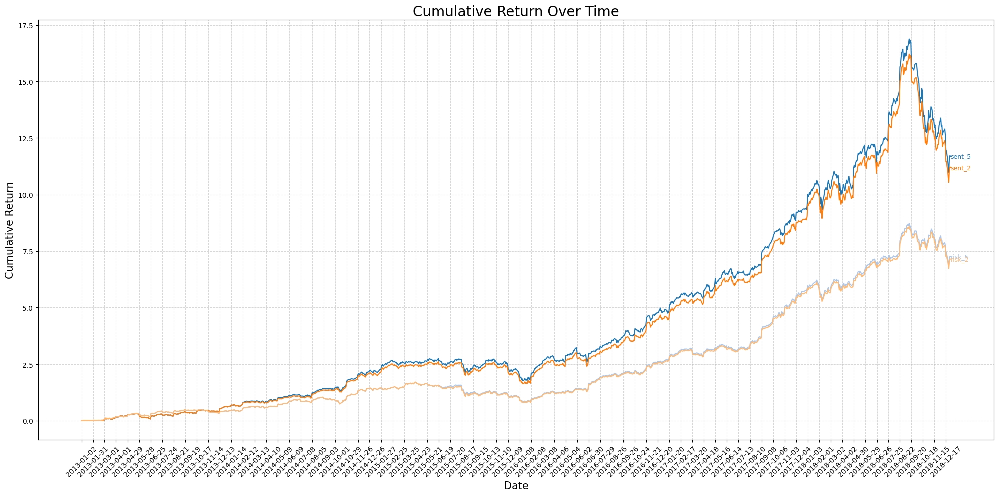

In [170]:
visualize_data(cum_ret_df, "Cumulative Return")

In [64]:
returns

array([[ 0.        ,  0.        ,  0.        ,  0.        ],
       [ 0.00297992, -0.00297106,  0.00297992, -0.00297106],
       [ 0.00311638, -0.0031067 ,  0.00311638, -0.0031067 ],
       ...,
       [ 0.58209157, -0.35500012,  0.49226634, -0.33916218],
       [ 0.56885994, -0.35366675,  0.48918783, -0.33779607],
       [ 0.57787371, -0.35215468,  0.48571207, -0.33624687]])

In [22]:
all_weight_df["risk"]

date
2013-01-02    1.000000e+07
2013-01-03    1.000000e+07
2013-01-04    1.000000e+07
2013-01-07    1.000000e+07
2013-01-08    1.000000e+07
                  ...     
2018-12-24    7.781529e+07
2018-12-26    8.154458e+07
2018-12-27    8.205925e+07
2018-12-28    8.205583e+07
2018-12-31    8.271690e+07
Name: risk, Length: 1510, dtype: float64

In [ ]:
all_weight_df["risk"]

In [194]:
imp_df

,risk
date,
2018-12-17,0.0
2018-12-18,0.0
2018-12-19,0.0
2018-12-20,0.0
2018-12-21,0.0
2018-12-24,0.0
2018-12-26,0.0
2018-12-27,0.0
2018-12-28,0.0


In [ ]:
# n_weight
idx = 0
window_size = 20
n_rewards = [10000000]

before_asset_dict = {tick : 0 for tick in env.real_data.tic.unique()}
n_weight_df = pd.DataFrame()

for day in env.days[::window_size]:
    if idx + window_size <= len(env.days):
        next_day = env.days[idx+window_size-1]
    else:
        next_day = env.real_data.index.unique()[-1]
    print(f"Day: {day} ~ {next_day}")
    idx += window_size
    daily_nweight_money = n_rewards[-1]
    # print("before_cal", daily_nweight_money)
    rebalance_investment_n_weight, n_total_transaction_fee, after_asset_dict = calculate_n_weight_action_return(n_weight, day, next_day, daily_nweight_money, before_asset_dict)
    
    # rebalance_investment_n_weight, n_total_transaction_fee, after_asset_dict = calculate_n_weight_action_return(all_weight, day, next_day, daily_nweight_money, before_asset_dict)

    before_asset_dict = after_asset_dict
    n_weight_df = make_daily_invest_data(n_weight_df,  before_asset_dict, daily_nweight_money, env.real_data, n_total_transaction_fee, day, next_day)
    # print(n_weight_df.head())
    # print("after_cal", n_weight_df.iloc[-1].values[0])
    n_rewards.append(n_weight_df.iloc[-1].values[0])
    
    # print(n_weight_df.iloc[-1].values[0])


In [19]:
# n_weight
idx = 0
window_size = 20
n_rewards = [10000000]

before_asset_dict = {tick : 0 for tick in env.real_data.tic.unique()}
n_weight_df = pd.DataFrame()

for day in env.days[::window_size]:
    if idx + window_size <= len(env.days):
        next_day = env.days[idx+window_size-1]
    else:
        next_day = env.real_data.index.unique()[-1]
    print(f"Day: {day} ~ {next_day}")
    idx += window_size
    daily_nweight_money = n_rewards[-1]
    # print("before_cal", daily_nweight_money)
    rebalance_investment_n_weight, n_total_transaction_fee, after_asset_dict = calculate_n_weight_action_return(n_weight, day, next_day, daily_nweight_money, before_asset_dict)
    
    # rebalance_investment_n_weight, n_total_transaction_fee, after_asset_dict = calculate_n_weight_action_return(all_weight, day, next_day, daily_nweight_money, before_asset_dict)

    before_asset_dict = after_asset_dict
    n_weight_df = make_daily_invest_data(n_weight_df,  before_asset_dict, daily_nweight_money, env.real_data, n_total_transaction_fee, day, next_day)
    # print(n_weight_df.head())
    # print("after_cal", n_weight_df.iloc[-1].values[0])
    n_rewards.append(n_weight_df.iloc[-1].values[0])
    
    # print(n_weight_df.iloc[-1].values[0])


Day: 2013-01-02 ~ 2013-01-30
after_asset_dict {'AAPL': 0, 'ADBE': 0.016666666666666666, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0, 'ALGN': 0, 'AMAT': 0, 'AMD': 0, 'AMGN': 0, 'AMZN': 0, 'ANSS': 0, 'ASML': 0.05, 'AVGO': 0, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0.03333333333333333, 'COST': 0, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0, 'CSX': 0, 'CTAS': 0, 'CTSH': 0.016666666666666666, 'DLTR': 0, 'DXCM': 0, 'EA': 0, 'EBAY': 0.03333333333333333, 'ENPH': 0.016666666666666666, 'EXC': 0, 'FANG': 0, 'FAST': 0, 'FTNT': 0, 'GILD': 0.03333333333333333, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0.03333333333333333, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0.03333333333333333, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0.016666666666666666, 'MNST': 0, 'MRVL': 0, 'MSFT': 0, 'MU': 0, 'NFLX': 0.016666666666666666, 'NVDA': 0.016666666666666666, 'NXPI': 0.05, 'ODFL': 0, 'ON': 0, 'ORLY': 0, 'PANW': 0.016666666666666666, 'PAYX': 0, 'P

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2013-01-31 ~ 2013-02-28
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0.016666666666666666, 'AEP': 0, 'ALGN': 0, 'AMAT': 0, 'AMD': 0, 'AMGN': 0.016666666666666666, 'AMZN': 0, 'ANSS': 0, 'ASML': 0.05, 'AVGO': 0, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0.016666666666666666, 'CMCSA': 0.03333333333333333, 'COST': 0.05, 'CPRT': 0.03333333333333333, 'CSCO': 0, 'CSGP': 0.03333333333333333, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.016666666666666666, 'EA': 0, 'EBAY': 0.03333333333333333, 'ENPH': 0.016666666666666666, 'EXC': 0.03333333333333333, 'FANG': 0, 'FAST': 0.016666666666666666, 'FTNT': 0, 'GILD': 0.06666666666666667, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0.016666666666666666, 'MNST': 0, 'MRVL': 0.016666666666666666, 'MSFT': 0, 'MU': 0.016666666666666666, 'NFLX': 0.016666666666666666, 'N

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2013-03-01 ~ 2013-03-28
after_asset_dict {'AAPL': 0, 'ADBE': 0.016666666666666666, 'ADI': 0, 'ADP': 0.016666666666666666, 'ADSK': 0, 'AEP': 0.016666666666666666, 'ALGN': 0, 'AMAT': 0.03333333333333333, 'AMD': 0, 'AMGN': 0.03333333333333333, 'AMZN': 0.03333333333333333, 'ANSS': 0, 'ASML': 0.03333333333333333, 'AVGO': 0, 'AZN': 0, 'BIIB': 0.016666666666666666, 'BKNG': 0, 'BKR': 0, 'CDNS': 0.016666666666666666, 'CHTR': 0, 'CMCSA': 0.016666666666666666, 'COST': 0, 'CPRT': 0.05, 'CSCO': 0, 'CSGP': 0.05, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0.016666666666666666, 'DXCM': 0, 'EA': 0.016666666666666666, 'EBAY': 0.03333333333333333, 'ENPH': 0.016666666666666666, 'EXC': 0, 'FANG': 0, 'FAST': 0, 'FTNT': 0, 'GILD': 0.08333333333333333, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0.016666666666666666, 'MNST': 0, 'MRVL': 0.016666666666666666, 'MSFT': 0, 'MU

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2013-04-01 ~ 2013-04-26
after_asset_dict {'AAPL': 0, 'ADBE': 0.016666666666666666, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0, 'ALGN': 0, 'AMAT': 0.03333333333333333, 'AMD': 0, 'AMGN': 0.05, 'AMZN': 0, 'ANSS': 0, 'ASML': 0.03333333333333333, 'AVGO': 0, 'AZN': 0, 'BIIB': 0.03333333333333333, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0.03333333333333333, 'CMCSA': 0.03333333333333333, 'COST': 0, 'CPRT': 0.016666666666666666, 'CSCO': 0, 'CSGP': 0.03333333333333333, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0.016666666666666666, 'DXCM': 0.05, 'EA': 0, 'EBAY': 0.016666666666666666, 'ENPH': 0, 'EXC': 0.016666666666666666, 'FANG': 0, 'FAST': 0.016666666666666666, 'FTNT': 0, 'GILD': 0.06666666666666667, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0.016666666666666666, 'MNST': 0.016666666666666666, 'MRVL': 0.016666666666666666, 'MSFT': 0, 'MU': 0.016666666666666

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2013-04-29 ~ 2013-05-24
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0.016666666666666666, 'ALGN': 0, 'AMAT': 0.03333333333333333, 'AMD': 0, 'AMGN': 0.03333333333333333, 'AMZN': 0, 'ANSS': 0, 'ASML': 0.05, 'AVGO': 0, 'AZN': 0, 'BIIB': 0.06666666666666667, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0.03333333333333333, 'CMCSA': 0, 'COST': 0.016666666666666666, 'CPRT': 0.016666666666666666, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0.016666666666666666, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.03333333333333333, 'EA': 0.016666666666666666, 'EBAY': 0, 'ENPH': 0.016666666666666666, 'EXC': 0.016666666666666666, 'FANG': 0, 'FAST': 0, 'FTNT': 0.03333333333333333, 'GILD': 0.05, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0.016666666666666666, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0, 'MNST': 0.016666666666666666, 'MRVL': 0, 'MSFT': 0, 'MU': 0.03333333333333

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2013-05-28 ~ 2013-06-24
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0.03333333333333333, 'ALGN': 0, 'AMAT': 0.016666666666666666, 'AMD': 0.016666666666666666, 'AMGN': 0.03333333333333333, 'AMZN': 0, 'ANSS': 0, 'ASML': 0.05, 'AVGO': 0, 'AZN': 0, 'BIIB': 0.03333333333333333, 'BKNG': 0, 'BKR': 0, 'CDNS': 0.016666666666666666, 'CHTR': 0, 'CMCSA': 0, 'COST': 0.016666666666666666, 'CPRT': 0.016666666666666666, 'CSCO': 0, 'CSGP': 0, 'CSX': 0, 'CTAS': 0, 'CTSH': 0.016666666666666666, 'DLTR': 0, 'DXCM': 0.03333333333333333, 'EA': 0.016666666666666666, 'EBAY': 0, 'ENPH': 0.016666666666666666, 'EXC': 0, 'FANG': 0, 'FAST': 0.016666666666666666, 'FTNT': 0.03333333333333333, 'GILD': 0.03333333333333333, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0.016666666666666666, 'META': 0, 'MNST': 0.03333333333333333, 'MRVL': 0, 'MSFT': 0, 'MU': 0

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2013-06-25 ~ 2013-07-23
after_asset_dict {'AAPL': 0, 'ADBE': 0.016666666666666666, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0.03333333333333333, 'ALGN': 0, 'AMAT': 0.016666666666666666, 'AMD': 0.016666666666666666, 'AMGN': 0.03333333333333333, 'AMZN': 0, 'ANSS': 0, 'ASML': 0.03333333333333333, 'AVGO': 0, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0.016666666666666666, 'CHTR': 0.016666666666666666, 'CMCSA': 0.016666666666666666, 'COST': 0, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0.016666666666666666, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.016666666666666666, 'EA': 0.03333333333333333, 'EBAY': 0, 'ENPH': 0, 'EXC': 0, 'FANG': 0, 'FAST': 0.016666666666666666, 'FTNT': 0.03333333333333333, 'GILD': 0.03333333333333333, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0.05, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0, 'MNST': 0.016666666666666666, 'MRVL': 0, 'MSFT': 0, 'MU': 

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2013-07-24 ~ 2013-08-20
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0.016666666666666666, 'ADP': 0, 'ADSK': 0, 'AEP': 0.03333333333333333, 'ALGN': 0.016666666666666666, 'AMAT': 0.016666666666666666, 'AMD': 0, 'AMGN': 0.016666666666666666, 'AMZN': 0, 'ANSS': 0, 'ASML': 0.05, 'AVGO': 0, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0.016666666666666666, 'CMCSA': 0, 'COST': 0, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0, 'CSX': 0.016666666666666666, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0.016666666666666666, 'DXCM': 0.03333333333333333, 'EA': 0.05, 'EBAY': 0, 'ENPH': 0, 'EXC': 0, 'FANG': 0, 'FAST': 0, 'FTNT': 0.03333333333333333, 'GILD': 0.06666666666666667, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0.05, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0.016666666666666666, 'LRCX': 0, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0, 'MNST': 0, 'MRVL': 0.016666666666666666, 'MSFT': 0, 'MU': 0.03333333333333333, 'NFLX': 0.05, 'NVDA': 0.016666666666666666, 'NX

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2013-08-21 ~ 2013-09-18
after_asset_dict {'AAPL': 0, 'ADBE': 0.016666666666666666, 'ADI': 0.016666666666666666, 'ADP': 0.016666666666666666, 'ADSK': 0, 'AEP': 0.016666666666666666, 'ALGN': 0, 'AMAT': 0.016666666666666666, 'AMD': 0, 'AMGN': 0, 'AMZN': 0, 'ANSS': 0, 'ASML': 0.03333333333333333, 'AVGO': 0, 'AZN': 0, 'BIIB': 0, 'BKNG': 0.016666666666666666, 'BKR': 0, 'CDNS': 0.016666666666666666, 'CHTR': 0.016666666666666666, 'CMCSA': 0, 'COST': 0, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0.03333333333333333, 'CSX': 0.03333333333333333, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0.016666666666666666, 'DXCM': 0.05, 'EA': 0.05, 'EBAY': 0, 'ENPH': 0, 'EXC': 0.016666666666666666, 'FANG': 0, 'FAST': 0, 'FTNT': 0.03333333333333333, 'GILD': 0.05, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0.03333333333333333, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0.016666666666666666, 'META': 0.03333333333333333, 'MNST': 0.016666666666666666, 'MR

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2013-09-19 ~ 2013-10-16
after_asset_dict {'AAPL': 0, 'ADBE': 0.016666666666666666, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0, 'ALGN': 0, 'AMAT': 0.016666666666666666, 'AMD': 0, 'AMGN': 0.016666666666666666, 'AMZN': 0, 'ANSS': 0, 'ASML': 0.03333333333333333, 'AVGO': 0.016666666666666666, 'AZN': 0, 'BIIB': 0.016666666666666666, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0, 'COST': 0.016666666666666666, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0.05, 'CSX': 0.03333333333333333, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.05, 'EA': 0.05, 'EBAY': 0, 'ENPH': 0.016666666666666666, 'EXC': 0.016666666666666666, 'FANG': 0, 'FAST': 0, 'FTNT': 0.03333333333333333, 'GILD': 0.05, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0.016666666666666666, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0.05, 'MNST': 0, 'MRVL': 0.016666666666666666, 'MSFT': 0, 'MU': 0.08333333333333333, 'NFLX': 0.05, 'NVDA': 0.0166666666666666

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2013-10-17 ~ 2013-11-13
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0.016666666666666666, 'ADP': 0, 'ADSK': 0, 'AEP': 0.03333333333333333, 'ALGN': 0.016666666666666666, 'AMAT': 0.03333333333333333, 'AMD': 0, 'AMGN': 0.016666666666666666, 'AMZN': 0, 'ANSS': 0, 'ASML': 0.03333333333333333, 'AVGO': 0.03333333333333333, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0.016666666666666666, 'COST': 0, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0.05, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.05, 'EA': 0, 'EBAY': 0.016666666666666666, 'ENPH': 0.05, 'EXC': 0.016666666666666666, 'FANG': 0.05, 'FAST': 0.016666666666666666, 'FTNT': 0.03333333333333333, 'GILD': 0.03333333333333333, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0.016666666666666666, 'META': 0.05, 'MNST': 0, 'MRVL': 0, 'MSFT': 0, 'MU': 0.05, 'NFLX': 0.05, 'NVDA': 0.016666666666666

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2013-11-14 ~ 2013-12-12
after_asset_dict {'AAPL': 0, 'ADBE': 0.016666666666666666, 'ADI': 0, 'ADP': 0.016666666666666666, 'ADSK': 0, 'AEP': 0.03333333333333333, 'ALGN': 0.03333333333333333, 'AMAT': 0, 'AMD': 0.016666666666666666, 'AMGN': 0.03333333333333333, 'AMZN': 0.016666666666666666, 'ANSS': 0, 'ASML': 0.016666666666666666, 'AVGO': 0.016666666666666666, 'AZN': 0, 'BIIB': 0, 'BKNG': 0.016666666666666666, 'BKR': 0, 'CDNS': 0, 'CHTR': 0.016666666666666666, 'CMCSA': 0, 'COST': 0.016666666666666666, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0.03333333333333333, 'CSX': 0, 'CTAS': 0, 'CTSH': 0.016666666666666666, 'DLTR': 0, 'DXCM': 0.06666666666666667, 'EA': 0.016666666666666666, 'EBAY': 0.016666666666666666, 'ENPH': 0.03333333333333333, 'EXC': 0.016666666666666666, 'FANG': 0.06666666666666667, 'FAST': 0, 'FTNT': 0, 'GILD': 0.016666666666666666, 'GOOG': 0.016666666666666666, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0.016666666666666666, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2013-12-13 ~ 2014-01-13
after_asset_dict {'AAPL': 0, 'ADBE': 0.03333333333333333, 'ADI': 0, 'ADP': 0, 'ADSK': 0.05, 'AEP': 0.016666666666666666, 'ALGN': 0.03333333333333333, 'AMAT': 0.03333333333333333, 'AMD': 0, 'AMGN': 0, 'AMZN': 0, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.016666666666666666, 'AZN': 0, 'BIIB': 0.016666666666666666, 'BKNG': 0.03333333333333333, 'BKR': 0, 'CDNS': 0, 'CHTR': 0.016666666666666666, 'CMCSA': 0, 'COST': 0, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0.03333333333333333, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0.016666666666666666, 'DXCM': 0.06666666666666667, 'EA': 0, 'EBAY': 0, 'ENPH': 0.03333333333333333, 'EXC': 0, 'FANG': 0.03333333333333333, 'FAST': 0.03333333333333333, 'FTNT': 0.016666666666666666, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0.03333333333333333, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0.016666666666666666, 'MNST': 0.016666666666666666, 'MRVL': 0.016

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2014-01-14 ~ 2014-02-11
after_asset_dict {'AAPL': 0, 'ADBE': 0.016666666666666666, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0.016666666666666666, 'ALGN': 0.05, 'AMAT': 0.03333333333333333, 'AMD': 0, 'AMGN': 0.03333333333333333, 'AMZN': 0, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.03333333333333333, 'AZN': 0, 'BIIB': 0.03333333333333333, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0, 'COST': 0, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0.03333333333333333, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.05, 'EA': 0, 'EBAY': 0, 'ENPH': 0.03333333333333333, 'EXC': 0, 'FANG': 0.03333333333333333, 'FAST': 0, 'FTNT': 0.016666666666666666, 'GILD': 0.05, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0.05, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0.016666666666666666, 'MNST': 0, 'MRVL': 0.016666666666666666, 'MSFT': 0, 'MU': 0.06666666666666667, 'NFLX': 0.03333333333333333, 'NVDA': 0.01666666

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2014-02-12 ~ 2014-03-12
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0.03333333333333333, 'ALGN': 0, 'AMAT': 0, 'AMD': 0, 'AMGN': 0, 'AMZN': 0, 'ANSS': 0, 'ASML': 0.016666666666666666, 'AVGO': 0.016666666666666666, 'AZN': 0.016666666666666666, 'BIIB': 0.03333333333333333, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0.016666666666666666, 'COST': 0, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0.016666666666666666, 'DXCM': 0.08333333333333333, 'EA': 0, 'EBAY': 0, 'ENPH': 0, 'EXC': 0, 'FANG': 0.05, 'FAST': 0, 'FTNT': 0, 'GILD': 0.03333333333333333, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0.06666666666666667, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0.05, 'MNST': 0.016666666666666666, 'MRVL': 0, 'MSFT': 0, 'MU': 0.05, 'NFLX': 0.05, 'NVDA': 0.016666666666666666, 'NXPI': 0.016666666666666666, 'ODFL': 0, 

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2014-03-13 ~ 2014-04-09
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0.03333333333333333, 'ADP': 0, 'ADSK': 0.016666666666666666, 'AEP': 0.016666666666666666, 'ALGN': 0, 'AMAT': 0, 'AMD': 0, 'AMGN': 0.016666666666666666, 'AMZN': 0, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.03333333333333333, 'AZN': 0, 'BIIB': 0.03333333333333333, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0, 'COST': 0, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0.03333333333333333, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.08333333333333333, 'EA': 0.016666666666666666, 'EBAY': 0, 'ENPH': 0.016666666666666666, 'EXC': 0.016666666666666666, 'FANG': 0.05, 'FAST': 0, 'FTNT': 0, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0.06666666666666667, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0.016666666666666666, 'LRCX': 0, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0.05, 'MNST': 0.016666666666666666, 'MRVL': 0, 'MSFT': 0, 'MU': 0.03333333333333333, 'NFLX': 0.03333333333333333, 'NVD

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2014-04-10 ~ 2014-05-08
after_asset_dict {'AAPL': 0, 'ADBE': 0.016666666666666666, 'ADI': 0, 'ADP': 0, 'ADSK': 0.016666666666666666, 'AEP': 0.016666666666666666, 'ALGN': 0, 'AMAT': 0, 'AMD': 0, 'AMGN': 0, 'AMZN': 0, 'ANSS': 0.016666666666666666, 'ASML': 0, 'AVGO': 0.05, 'AZN': 0.016666666666666666, 'BIIB': 0, 'BKNG': 0, 'BKR': 0.016666666666666666, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0, 'COST': 0.016666666666666666, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0.03333333333333333, 'CSX': 0, 'CTAS': 0, 'CTSH': 0.016666666666666666, 'DLTR': 0.016666666666666666, 'DXCM': 0.03333333333333333, 'EA': 0, 'EBAY': 0, 'ENPH': 0, 'EXC': 0.03333333333333333, 'FANG': 0.08333333333333333, 'FAST': 0, 'FTNT': 0, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0.05, 'INTC': 0.016666666666666666, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0, 'MAR': 0.016666666666666666, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0.03333333333333333, 'MNST': 0.03333333333333333, 'MRVL': 0, 'MSFT': 0.0166

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2014-05-09 ~ 2014-06-06
after_asset_dict {'AAPL': 0.016666666666666666, 'ADBE': 0.03333333333333333, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0.016666666666666666, 'ALGN': 0, 'AMAT': 0, 'AMD': 0, 'AMGN': 0, 'AMZN': 0, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.06666666666666667, 'AZN': 0.016666666666666666, 'BIIB': 0, 'BKNG': 0.016666666666666666, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0, 'COST': 0.016666666666666666, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0, 'CSX': 0, 'CTAS': 0, 'CTSH': 0.016666666666666666, 'DLTR': 0.016666666666666666, 'DXCM': 0.05, 'EA': 0.03333333333333333, 'EBAY': 0, 'ENPH': 0, 'EXC': 0, 'FANG': 0.05, 'FAST': 0, 'FTNT': 0.016666666666666666, 'GILD': 0.03333333333333333, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0.05, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0.03333333333333333, 'MNST': 0.016666666666666666, 'MRVL': 0.03333333333333333, 'MSFT': 0, 'MU': 0.05, 'NFLX': 0, 'NVDA': 0.01666

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2014-06-09 ~ 2014-07-07
after_asset_dict {'AAPL': 0.016666666666666666, 'ADBE': 0.016666666666666666, 'ADI': 0.016666666666666666, 'ADP': 0, 'ADSK': 0, 'AEP': 0, 'ALGN': 0, 'AMAT': 0.05, 'AMD': 0, 'AMGN': 0.03333333333333333, 'AMZN': 0, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.06666666666666667, 'AZN': 0.016666666666666666, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0, 'COST': 0.016666666666666666, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.05, 'EA': 0.016666666666666666, 'EBAY': 0, 'ENPH': 0, 'EXC': 0.016666666666666666, 'FANG': 0.05, 'FAST': 0, 'FTNT': 0.016666666666666666, 'GILD': 0.016666666666666666, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0.016666666666666666, 'ILMN': 0.05, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0.016666666666666666, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0.03333333333333333, 'MNST': 0, 'MRVL': 0.016666666666666666, 'MSFT': 0, 'MU': 0.06666

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2014-07-08 ~ 2014-08-04
after_asset_dict {'AAPL': 0.016666666666666666, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0.016666666666666666, 'ALGN': 0, 'AMAT': 0, 'AMD': 0, 'AMGN': 0, 'AMZN': 0, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.06666666666666667, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0, 'COST': 0, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.03333333333333333, 'EA': 0.05, 'EBAY': 0, 'ENPH': 0, 'EXC': 0, 'FANG': 0.05, 'FAST': 0.016666666666666666, 'FTNT': 0, 'GILD': 0.03333333333333333, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0.05, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0.016666666666666666, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0.03333333333333333, 'MNST': 0, 'MRVL': 0.016666666666666666, 'MSFT': 0, 'MU': 0.05, 'NFLX': 0.05, 'NVDA': 0.016666666666666666, 'NXPI': 0.05, 'ODFL': 0, 'ON': 0, 'ORLY': 0, 'PANW': 0.05, 'PAYX': 0.033333

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2014-08-05 ~ 2014-09-02
after_asset_dict {'AAPL': 0, 'ADBE': 0.016666666666666666, 'ADI': 0, 'ADP': 0, 'ADSK': 0.016666666666666666, 'AEP': 0.016666666666666666, 'ALGN': 0.016666666666666666, 'AMAT': 0, 'AMD': 0, 'AMGN': 0.016666666666666666, 'AMZN': 0, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.05, 'AZN': 0.016666666666666666, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0.016666666666666666, 'CHTR': 0, 'CMCSA': 0, 'COST': 0, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.08333333333333333, 'EA': 0, 'EBAY': 0, 'ENPH': 0.016666666666666666, 'EXC': 0, 'FANG': 0.05, 'FAST': 0.016666666666666666, 'FTNT': 0.016666666666666666, 'GILD': 0.05, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0.03333333333333333, 'INTC': 0.016666666666666666, 'INTU': 0, 'ISRG': 0.016666666666666666, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0, 'MAR': 0.016666666666666666, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0.05, 'MNST': 0, 'MRVL': 0.03333333333333333, 'MSFT': 0, 'MU': 0.03333

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2014-09-03 ~ 2014-09-30
after_asset_dict {'AAPL': 0, 'ADBE': 0.016666666666666666, 'ADI': 0, 'ADP': 0, 'ADSK': 0.016666666666666666, 'AEP': 0.016666666666666666, 'ALGN': 0, 'AMAT': 0, 'AMD': 0, 'AMGN': 0, 'AMZN': 0, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.06666666666666667, 'AZN': 0.016666666666666666, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0, 'COST': 0, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0.016666666666666666, 'CTAS': 0, 'CTSH': 0.016666666666666666, 'DLTR': 0, 'DXCM': 0.016666666666666666, 'EA': 0, 'EBAY': 0, 'ENPH': 0.03333333333333333, 'EXC': 0, 'FANG': 0.05, 'FAST': 0.016666666666666666, 'FTNT': 0.016666666666666666, 'GILD': 0.03333333333333333, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0.05, 'INTC': 0.03333333333333333, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0, 'MAR': 0.03333333333333333, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0.016666666666666666, 'META': 0.03333333333333333, 'MNST': 0.03333333333333333, 'MRVL':

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2014-10-01 ~ 2014-10-28
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0, 'ALGN': 0.016666666666666666, 'AMAT': 0.016666666666666666, 'AMD': 0, 'AMGN': 0.016666666666666666, 'AMZN': 0, 'ANSS': 0, 'ASML': 0.016666666666666666, 'AVGO': 0.06666666666666667, 'AZN': 0, 'BIIB': 0.016666666666666666, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0, 'COST': 0.016666666666666666, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0, 'CTAS': 0.016666666666666666, 'CTSH': 0, 'DLTR': 0.016666666666666666, 'DXCM': 0, 'EA': 0.016666666666666666, 'EBAY': 0, 'ENPH': 0.06666666666666667, 'EXC': 0.016666666666666666, 'FANG': 0.05, 'FAST': 0, 'FTNT': 0.016666666666666666, 'GILD': 0.05, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0.03333333333333333, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0.016666666666666666, 'LULU': 0, 'MAR': 0.03333333333333333, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0.016666666666666666, 'MNST': 0.06666

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2014-10-29 ~ 2014-11-25
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0, 'ALGN': 0, 'AMAT': 0, 'AMD': 0, 'AMGN': 0.03333333333333333, 'AMZN': 0, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.05, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0, 'COST': 0.016666666666666666, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0.016666666666666666, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.03333333333333333, 'EA': 0.016666666666666666, 'EBAY': 0, 'ENPH': 0.05, 'EXC': 0.03333333333333333, 'FANG': 0, 'FAST': 0.03333333333333333, 'FTNT': 0, 'GILD': 0.03333333333333333, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0.016666666666666666, 'ILMN': 0.05, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0, 'MAR': 0.03333333333333333, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0.016666666666666666, 'MNST': 0.05, 'MRVL': 0.016666666666666666, 'MSFT': 0, 'MU': 0.05, 'NFLX': 0, 'NVDA': 0.016666666666666666, 'NXPI': 0.0333333333

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2014-11-26 ~ 2014-12-24
after_asset_dict {'AAPL': 0.016666666666666666, 'ADBE': 0, 'ADI': 0.03333333333333333, 'ADP': 0, 'ADSK': 0, 'AEP': 0.016666666666666666, 'ALGN': 0, 'AMAT': 0.03333333333333333, 'AMD': 0, 'AMGN': 0, 'AMZN': 0, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.06666666666666667, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0, 'COST': 0, 'CPRT': 0.016666666666666666, 'CSCO': 0, 'CSGP': 0, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0.016666666666666666, 'DXCM': 0.03333333333333333, 'EA': 0.08333333333333333, 'EBAY': 0, 'ENPH': 0.016666666666666666, 'EXC': 0.03333333333333333, 'FANG': 0, 'FAST': 0.03333333333333333, 'FTNT': 0, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0.03333333333333333, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0.016666666666666666, 'META': 0.03333333333333333, 'MNST': 0.08333333333333333, 'MRVL': 0, 'MSFT': 0, 'MU': 0.05, 'NFLX': 0, 'NVDA': 0

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2014-12-26 ~ 2015-01-26
after_asset_dict {'AAPL': 0, 'ADBE': 0.016666666666666666, 'ADI': 0.016666666666666666, 'ADP': 0, 'ADSK': 0, 'AEP': 0.016666666666666666, 'ALGN': 0, 'AMAT': 0.03333333333333333, 'AMD': 0, 'AMGN': 0, 'AMZN': 0, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.06666666666666667, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0, 'COST': 0, 'CPRT': 0.016666666666666666, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.016666666666666666, 'EA': 0.06666666666666667, 'EBAY': 0, 'ENPH': 0.05, 'EXC': 0.03333333333333333, 'FANG': 0, 'FAST': 0.03333333333333333, 'FTNT': 0.05, 'GILD': 0.016666666666666666, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0.03333333333333333, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0.016666666666666666, 'MAR': 0.03333333333333333, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0, 'MNST': 0.05, 'MRVL': 0.03333333333333333, 'MSFT': 0, 'MU': 0.0333333333333

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2015-01-27 ~ 2015-02-24
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0.016666666666666666, 'ALGN': 0, 'AMAT': 0.05, 'AMD': 0, 'AMGN': 0, 'AMZN': 0, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.06666666666666667, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0.016666666666666666, 'CHTR': 0, 'CMCSA': 0, 'COST': 0, 'CPRT': 0.016666666666666666, 'CSCO': 0, 'CSGP': 0, 'CSX': 0, 'CTAS': 0.016666666666666666, 'CTSH': 0.016666666666666666, 'DLTR': 0, 'DXCM': 0.05, 'EA': 0.06666666666666667, 'EBAY': 0.016666666666666666, 'ENPH': 0.03333333333333333, 'EXC': 0.016666666666666666, 'FANG': 0, 'FAST': 0.016666666666666666, 'FTNT': 0.03333333333333333, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0.016666666666666666, 'ILMN': 0, 'INTC': 0.016666666666666666, 'INTU': 0, 'ISRG': 0, 'KDP': 0.03333333333333333, 'KLAC': 0, 'LRCX': 0.03333333333333333, 'LULU': 0.016666666666666666, 'MAR': 0.03333333333333333, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0, 'MNST': 0.06666666

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2015-02-25 ~ 2015-03-24
after_asset_dict {'AAPL': 0.05, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0, 'ALGN': 0, 'AMAT': 0.016666666666666666, 'AMD': 0, 'AMGN': 0.016666666666666666, 'AMZN': 0.016666666666666666, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.06666666666666667, 'AZN': 0, 'BIIB': 0.016666666666666666, 'BKNG': 0, 'BKR': 0, 'CDNS': 0.016666666666666666, 'CHTR': 0, 'CMCSA': 0.016666666666666666, 'COST': 0, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0, 'CSX': 0.016666666666666666, 'CTAS': 0, 'CTSH': 0.016666666666666666, 'DLTR': 0.03333333333333333, 'DXCM': 0, 'EA': 0.08333333333333333, 'EBAY': 0, 'ENPH': 0.05, 'EXC': 0.016666666666666666, 'FANG': 0, 'FAST': 0, 'FTNT': 0.016666666666666666, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0.03333333333333333, 'KLAC': 0, 'LRCX': 0.03333333333333333, 'LULU': 0, 'MAR': 0.03333333333333333, 'MCHP': 0, 'MDLZ': 0.016666666666666666, 'MELI': 0, 'META': 0, 'MNST': 0.03333333333333333, 'MRVL':

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2015-03-25 ~ 2015-04-22
after_asset_dict {'AAPL': 0.03333333333333333, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0.03333333333333333, 'AEP': 0, 'ALGN': 0, 'AMAT': 0, 'AMD': 0, 'AMGN': 0, 'AMZN': 0, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.06666666666666667, 'AZN': 0, 'BIIB': 0.016666666666666666, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0, 'COST': 0.016666666666666666, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0.05, 'DXCM': 0, 'EA': 0.08333333333333333, 'EBAY': 0, 'ENPH': 0.03333333333333333, 'EXC': 0.03333333333333333, 'FANG': 0.016666666666666666, 'FAST': 0, 'FTNT': 0.05, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0.03333333333333333, 'KLAC': 0, 'LRCX': 0, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0, 'MNST': 0.06666666666666667, 'MRVL': 0, 'MSFT': 0, 'MU': 0, 'NFLX': 0, 'NVDA': 0.016666666666666666, 'NXPI': 0.05, 'ODFL': 0.016666666666666666, 'ON': 

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2015-04-23 ~ 2015-05-20
after_asset_dict {'AAPL': 0.03333333333333333, 'ADBE': 0, 'ADI': 0.016666666666666666, 'ADP': 0, 'ADSK': 0.016666666666666666, 'AEP': 0, 'ALGN': 0, 'AMAT': 0.016666666666666666, 'AMD': 0, 'AMGN': 0.016666666666666666, 'AMZN': 0, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.05, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0, 'COST': 0, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0.016666666666666666, 'DXCM': 0.05, 'EA': 0.05, 'EBAY': 0.016666666666666666, 'ENPH': 0.03333333333333333, 'EXC': 0.016666666666666666, 'FANG': 0, 'FAST': 0.016666666666666666, 'FTNT': 0.03333333333333333, 'GILD': 0.016666666666666666, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0.016666666666666666, 'META': 0, 'MNST': 0.06666666666666667, 'MRVL': 0, 'MSFT': 0, 'MU': 0, 'NFLX': 0.016666666666666666, 'NVDA': 0.016666

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2015-05-21 ~ 2015-06-18
after_asset_dict {'AAPL': 0, 'ADBE': 0.016666666666666666, 'ADI': 0.016666666666666666, 'ADP': 0, 'ADSK': 0.016666666666666666, 'AEP': 0.016666666666666666, 'ALGN': 0, 'AMAT': 0.016666666666666666, 'AMD': 0, 'AMGN': 0, 'AMZN': 0.016666666666666666, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.06666666666666667, 'AZN': 0.016666666666666666, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0, 'COST': 0, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.03333333333333333, 'EA': 0.06666666666666667, 'EBAY': 0, 'ENPH': 0, 'EXC': 0.03333333333333333, 'FANG': 0.016666666666666666, 'FAST': 0, 'FTNT': 0.06666666666666667, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0, 'MAR': 0, 'MCHP': 0.016666666666666666, 'MDLZ': 0, 'MELI': 0.05, 'META': 0, 'MNST': 0.05, 'MRVL': 0, 'MSFT': 0, 'MU': 0, 'NFLX': 0.016666666666666666, 'NVDA': 0.0166666666

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2015-06-19 ~ 2015-07-17
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0.016666666666666666, 'ALGN': 0, 'AMAT': 0.016666666666666666, 'AMD': 0, 'AMGN': 0.03333333333333333, 'AMZN': 0, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.06666666666666667, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0, 'COST': 0.016666666666666666, 'CPRT': 0.016666666666666666, 'CSCO': 0, 'CSGP': 0, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.05, 'EA': 0.05, 'EBAY': 0, 'ENPH': 0, 'EXC': 0.016666666666666666, 'FANG': 0.016666666666666666, 'FAST': 0, 'FTNT': 0.06666666666666667, 'GILD': 0.03333333333333333, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0.03333333333333333, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0.016666666666666666, 'MELI': 0.03333333333333333, 'META': 0, 'MNST': 0.05, 'MRVL': 0.016666666666666666, 'MSFT': 0, 'MU': 0, 'NFLX': 0.016666666666666666, 'NVDA': 0.01666666

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2015-07-20 ~ 2015-08-14
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0.03333333333333333, 'ALGN': 0, 'AMAT': 0.03333333333333333, 'AMD': 0, 'AMGN': 0.016666666666666666, 'AMZN': 0.016666666666666666, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.05, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0, 'COST': 0, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0, 'CSX': 0, 'CTAS': 0.016666666666666666, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.05, 'EA': 0.05, 'EBAY': 0.016666666666666666, 'ENPH': 0, 'EXC': 0.03333333333333333, 'FANG': 0, 'FAST': 0, 'FTNT': 0.03333333333333333, 'GILD': 0, 'GOOG': 0.016666666666666666, 'GOOGL': 0.016666666666666666, 'HON': 0, 'IDXX': 0, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0.03333333333333333, 'MAR': 0, 'MCHP': 0.016666666666666666, 'MDLZ': 0.016666666666666666, 'MELI': 0.016666666666666666, 'META': 0.016666666666666666, 'MNST': 0.05, 'MRVL': 0, 'MSFT': 0, 'MU': 0, 'NFLX': 0.033333333333333

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2015-08-17 ~ 2015-09-14
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0.016666666666666666, 'ADSK': 0, 'AEP': 0.03333333333333333, 'ALGN': 0, 'AMAT': 0.016666666666666666, 'AMD': 0, 'AMGN': 0.016666666666666666, 'AMZN': 0.016666666666666666, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.03333333333333333, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0, 'COST': 0, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0, 'CSX': 0, 'CTAS': 0, 'CTSH': 0.03333333333333333, 'DLTR': 0, 'DXCM': 0.08333333333333333, 'EA': 0.05, 'EBAY': 0, 'ENPH': 0, 'EXC': 0.03333333333333333, 'FANG': 0, 'FAST': 0, 'FTNT': 0.05, 'GILD': 0.016666666666666666, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0.016666666666666666, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0.03333333333333333, 'MAR': 0, 'MCHP': 0.016666666666666666, 'MDLZ': 0.016666666666666666, 'MELI': 0, 'META': 0, 'MNST': 0.016666666666666666, 'MRVL': 0, 'MSFT': 0, 'MU': 0, 'NFLX': 0.05, 'NVDA': 0.03333333

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2015-09-15 ~ 2015-10-12
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0.016666666666666666, 'ADSK': 0, 'AEP': 0.016666666666666666, 'ALGN': 0, 'AMAT': 0, 'AMD': 0, 'AMGN': 0.016666666666666666, 'AMZN': 0.05, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.03333333333333333, 'AZN': 0, 'BIIB': 0, 'BKNG': 0.016666666666666666, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0, 'COST': 0, 'CPRT': 0.016666666666666666, 'CSCO': 0, 'CSGP': 0, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.06666666666666667, 'EA': 0.05, 'EBAY': 0, 'ENPH': 0, 'EXC': 0.016666666666666666, 'FANG': 0, 'FAST': 0.03333333333333333, 'FTNT': 0.03333333333333333, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0, 'MAR': 0, 'MCHP': 0.016666666666666666, 'MDLZ': 0, 'MELI': 0, 'META': 0.016666666666666666, 'MNST': 0.03333333333333333, 'MRVL': 0, 'MSFT': 0, 'MU': 0, 'NFLX': 0.03333333333333333, 'NVDA': 0.016666666666666666, 'NXPI': 0,

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2015-10-13 ~ 2015-11-09
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0, 'ALGN': 0, 'AMAT': 0, 'AMD': 0, 'AMGN': 0.016666666666666666, 'AMZN': 0.05, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.03333333333333333, 'AZN': 0, 'BIIB': 0.016666666666666666, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0, 'COST': 0, 'CPRT': 0.016666666666666666, 'CSCO': 0, 'CSGP': 0, 'CSX': 0, 'CTAS': 0.016666666666666666, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.06666666666666667, 'EA': 0.03333333333333333, 'EBAY': 0, 'ENPH': 0, 'EXC': 0.03333333333333333, 'FANG': 0.016666666666666666, 'FAST': 0, 'FTNT': 0.05, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0.016666666666666666, 'KLAC': 0, 'LRCX': 0, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0.016666666666666666, 'MELI': 0, 'META': 0, 'MNST': 0, 'MRVL': 0.016666666666666666, 'MSFT': 0, 'MU': 0, 'NFLX': 0.03333333333333333, 'NVDA': 0.03333333333333333, 'NXPI': 0.03333333333333333, 

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2015-11-10 ~ 2015-12-08
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0.016666666666666666, 'AEP': 0.016666666666666666, 'ALGN': 0.016666666666666666, 'AMAT': 0, 'AMD': 0, 'AMGN': 0, 'AMZN': 0.05, 'ANSS': 0, 'ASML': 0, 'AVGO': 0, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0.03333333333333333, 'CHTR': 0, 'CMCSA': 0, 'COST': 0, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.05, 'EA': 0.03333333333333333, 'EBAY': 0.03333333333333333, 'ENPH': 0, 'EXC': 0.03333333333333333, 'FANG': 0, 'FAST': 0.03333333333333333, 'FTNT': 0.016666666666666666, 'GILD': 0, 'GOOG': 0.016666666666666666, 'GOOGL': 0.016666666666666666, 'HON': 0, 'IDXX': 0, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0.016666666666666666, 'LRCX': 0, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0.016666666666666666, 'META': 0.03333333333333333, 'MNST': 0, 'MRVL': 0.016666666666666666, 'MSFT': 0, 'MU': 0, 'NFLX': 0.03333333333333333, 'NV

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2015-12-09 ~ 2016-01-07
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0.03333333333333333, 'ALGN': 0, 'AMAT': 0.03333333333333333, 'AMD': 0.016666666666666666, 'AMGN': 0, 'AMZN': 0.05, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.05, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0.016666666666666666, 'CMCSA': 0, 'COST': 0, 'CPRT': 0.016666666666666666, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0.03333333333333333, 'DXCM': 0.05, 'EA': 0.03333333333333333, 'EBAY': 0.016666666666666666, 'ENPH': 0, 'EXC': 0, 'FANG': 0, 'FAST': 0.016666666666666666, 'FTNT': 0, 'GILD': 0, 'GOOG': 0.016666666666666666, 'GOOGL': 0.03333333333333333, 'HON': 0, 'IDXX': 0, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0, 'MNST': 0.03333333333333333, 'MRVL': 0, 'MSFT': 0.016666666666666666, 'MU': 0, 'NFLX': 0.05, 'NVDA': 0.06666666666666667, 'NXPI

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2016-01-08 ~ 2016-02-05
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0.03333333333333333, 'ALGN': 0, 'AMAT': 0, 'AMD': 0, 'AMGN': 0, 'AMZN': 0.05, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.016666666666666666, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0.03333333333333333, 'CHTR': 0, 'CMCSA': 0, 'COST': 0.016666666666666666, 'CPRT': 0.016666666666666666, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0.016666666666666666, 'DXCM': 0.06666666666666667, 'EA': 0.03333333333333333, 'EBAY': 0, 'ENPH': 0.016666666666666666, 'EXC': 0, 'FANG': 0, 'FAST': 0, 'FTNT': 0, 'GILD': 0, 'GOOG': 0.03333333333333333, 'GOOGL': 0.03333333333333333, 'HON': 0, 'IDXX': 0, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0.016666666666666666, 'KDP': 0.016666666666666666, 'KLAC': 0.016666666666666666, 'LRCX': 0, 'LULU': 0.016666666666666666, 'MAR': 0.016666666666666666, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0, 'MNST': 0, 'MRVL': 0, 'MSFT': 0, 'MU': 

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2016-02-08 ~ 2016-03-07
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0.03333333333333333, 'ALGN': 0, 'AMAT': 0.016666666666666666, 'AMD': 0, 'AMGN': 0, 'AMZN': 0.03333333333333333, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.016666666666666666, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0.03333333333333333, 'CHTR': 0, 'CMCSA': 0.016666666666666666, 'COST': 0, 'CPRT': 0.016666666666666666, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.03333333333333333, 'EA': 0, 'EBAY': 0, 'ENPH': 0, 'EXC': 0.016666666666666666, 'FANG': 0.016666666666666666, 'FAST': 0.016666666666666666, 'FTNT': 0.016666666666666666, 'GILD': 0.016666666666666666, 'GOOG': 0.03333333333333333, 'GOOGL': 0.03333333333333333, 'HON': 0, 'IDXX': 0, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0.016666666666666666, 'KLAC': 0, 'LRCX': 0, 'LULU': 0.016666666666666666, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0.05, 'MNST': 0, 'MRVL': 0

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2016-03-08 ~ 2016-04-05
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0.016666666666666666, 'ADP': 0.016666666666666666, 'ADSK': 0.03333333333333333, 'AEP': 0.016666666666666666, 'ALGN': 0.03333333333333333, 'AMAT': 0.03333333333333333, 'AMD': 0, 'AMGN': 0, 'AMZN': 0.03333333333333333, 'ANSS': 0, 'ASML': 0, 'AVGO': 0, 'AZN': 0, 'BIIB': 0, 'BKNG': 0.016666666666666666, 'BKR': 0, 'CDNS': 0.016666666666666666, 'CHTR': 0, 'CMCSA': 0, 'COST': 0, 'CPRT': 0.03333333333333333, 'CSCO': 0, 'CSGP': 0, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0.016666666666666666, 'DXCM': 0.016666666666666666, 'EA': 0, 'EBAY': 0.016666666666666666, 'ENPH': 0.016666666666666666, 'EXC': 0, 'FANG': 0, 'FAST': 0, 'FTNT': 0, 'GILD': 0, 'GOOG': 0.016666666666666666, 'GOOGL': 0.03333333333333333, 'HON': 0, 'IDXX': 0, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0.016666666666666666, 'KLAC': 0, 'LRCX': 0, 'LULU': 0.016666666666666666, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0.016666666666666666, 'META': 0.03333

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2016-04-06 ~ 2016-05-03
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0.016666666666666666, 'ADSK': 0, 'AEP': 0, 'ALGN': 0.03333333333333333, 'AMAT': 0.016666666666666666, 'AMD': 0.016666666666666666, 'AMGN': 0, 'AMZN': 0.03333333333333333, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.05, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0, 'COST': 0, 'CPRT': 0.03333333333333333, 'CSCO': 0, 'CSGP': 0, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0.016666666666666666, 'DXCM': 0.016666666666666666, 'EA': 0, 'EBAY': 0, 'ENPH': 0, 'EXC': 0, 'FANG': 0, 'FAST': 0.016666666666666666, 'FTNT': 0.016666666666666666, 'GILD': 0.016666666666666666, 'GOOG': 0.03333333333333333, 'GOOGL': 0.03333333333333333, 'HON': 0, 'IDXX': 0, 'ILMN': 0.016666666666666666, 'INTC': 0, 'INTU': 0, 'ISRG': 0.016666666666666666, 'KDP': 0, 'KLAC': 0.016666666666666666, 'LRCX': 0.016666666666666666, 'LULU': 0, 'MAR': 0.016666666666666666, 'MCHP': 0.016666666666666666, 'MDLZ': 0, 'MELI': 0, 'META': 0.0

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2016-05-04 ~ 2016-06-01
after_asset_dict {'AAPL': 0, 'ADBE': 0.016666666666666666, 'ADI': 0.016666666666666666, 'ADP': 0, 'ADSK': 0.016666666666666666, 'AEP': 0, 'ALGN': 0.016666666666666666, 'AMAT': 0.03333333333333333, 'AMD': 0.03333333333333333, 'AMGN': 0, 'AMZN': 0.05, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.016666666666666666, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0.016666666666666666, 'CMCSA': 0.016666666666666666, 'COST': 0.016666666666666666, 'CPRT': 0.05, 'CSCO': 0, 'CSGP': 0, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0, 'EA': 0, 'EBAY': 0.03333333333333333, 'ENPH': 0, 'EXC': 0.016666666666666666, 'FANG': 0.016666666666666666, 'FAST': 0, 'FTNT': 0.016666666666666666, 'GILD': 0, 'GOOG': 0.03333333333333333, 'GOOGL': 0.03333333333333333, 'HON': 0, 'IDXX': 0.03333333333333333, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0.016666666666666666, 'KDP': 0.016666666666666666, 'KLAC': 0.016666666666666666, 'LRCX': 0, 'LULU': 0, 'MAR': 0, 'MCHP': 0.0166666666666

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2016-06-02 ~ 2016-06-29
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0.016666666666666666, 'ALGN': 0, 'AMAT': 0.016666666666666666, 'AMD': 0.05, 'AMGN': 0.016666666666666666, 'AMZN': 0.05, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.016666666666666666, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0.016666666666666666, 'CHTR': 0.05, 'CMCSA': 0, 'COST': 0.016666666666666666, 'CPRT': 0.06666666666666667, 'CSCO': 0, 'CSGP': 0, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0.016666666666666666, 'DXCM': 0, 'EA': 0.016666666666666666, 'EBAY': 0.016666666666666666, 'ENPH': 0, 'EXC': 0, 'FANG': 0.016666666666666666, 'FAST': 0, 'FTNT': 0.016666666666666666, 'GILD': 0.016666666666666666, 'GOOG': 0.03333333333333333, 'GOOGL': 0.03333333333333333, 'HON': 0, 'IDXX': 0.03333333333333333, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0.016666666666666666, 'KLAC': 0, 'LRCX': 0, 'LULU': 0, 'MAR': 0, 'MCHP': 0.016666666666666666, 'MDLZ': 0, 'MELI': 0, 'META': 0.0333333333333

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2016-06-30 ~ 2016-07-28
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0.016666666666666666, 'ADP': 0, 'ADSK': 0, 'AEP': 0.03333333333333333, 'ALGN': 0, 'AMAT': 0, 'AMD': 0.05, 'AMGN': 0, 'AMZN': 0.03333333333333333, 'ANSS': 0, 'ASML': 0, 'AVGO': 0, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0.016666666666666666, 'CHTR': 0, 'CMCSA': 0.016666666666666666, 'COST': 0, 'CPRT': 0.05, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0.016666666666666666, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.016666666666666666, 'EA': 0, 'EBAY': 0, 'ENPH': 0, 'EXC': 0, 'FANG': 0.016666666666666666, 'FAST': 0.016666666666666666, 'FTNT': 0, 'GILD': 0.016666666666666666, 'GOOG': 0.03333333333333333, 'GOOGL': 0.016666666666666666, 'HON': 0, 'IDXX': 0.05, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0.03333333333333333, 'KDP': 0, 'KLAC': 0.03333333333333333, 'LRCX': 0, 'LULU': 0.016666666666666666, 'MAR': 0, 'MCHP': 0.016666666666666666, 'MDLZ': 0, 'MELI': 0, 'META': 0.016666666666666666, 'MNST': 0.033

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2016-07-29 ~ 2016-08-25
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0, 'ALGN': 0.03333333333333333, 'AMAT': 0.06666666666666667, 'AMD': 0.05, 'AMGN': 0, 'AMZN': 0.03333333333333333, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.03333333333333333, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0.016666666666666666, 'CHTR': 0, 'CMCSA': 0.016666666666666666, 'COST': 0.016666666666666666, 'CPRT': 0.06666666666666667, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.03333333333333333, 'EA': 0, 'EBAY': 0.016666666666666666, 'ENPH': 0, 'EXC': 0, 'FANG': 0.03333333333333333, 'FAST': 0.016666666666666666, 'FTNT': 0, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0.016666666666666666, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0.03333333333333333, 'LRCX': 0, 'LULU': 0, 'MAR': 0, 'MCHP': 0.03333333333333333, 'MDLZ': 0.016666666666666666, 'MELI': 0.016666666666666666, 'META': 0, 'MNST': 0.0166666666666

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2016-08-26 ~ 2016-09-23
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0.03333333333333333, 'AEP': 0.03333333333333333, 'ALGN': 0.03333333333333333, 'AMAT': 0.05, 'AMD': 0.05, 'AMGN': 0, 'AMZN': 0.03333333333333333, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.03333333333333333, 'AZN': 0.016666666666666666, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0.016666666666666666, 'CMCSA': 0, 'COST': 0, 'CPRT': 0.06666666666666667, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0, 'CTAS': 0.016666666666666666, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0, 'EA': 0, 'EBAY': 0, 'ENPH': 0, 'EXC': 0.016666666666666666, 'FANG': 0, 'FAST': 0, 'FTNT': 0, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0.03333333333333333, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0.016666666666666666, 'LRCX': 0.016666666666666666, 'LULU': 0, 'MAR': 0, 'MCHP': 0.05, 'MDLZ': 0, 'MELI': 0.05, 'META': 0.016666666666666666, 'MNST': 0.03333333333333333, 'MRVL': 0.03333333333333333, 'MSFT': 0, 

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2016-09-26 ~ 2016-10-21
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0.03333333333333333, 'AEP': 0, 'ALGN': 0.03333333333333333, 'AMAT': 0.05, 'AMD': 0.05, 'AMGN': 0, 'AMZN': 0.016666666666666666, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.016666666666666666, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0.016666666666666666, 'CMCSA': 0, 'COST': 0.016666666666666666, 'CPRT': 0.05, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0, 'EA': 0, 'EBAY': 0.016666666666666666, 'ENPH': 0.03333333333333333, 'EXC': 0, 'FANG': 0.016666666666666666, 'FAST': 0, 'FTNT': 0.016666666666666666, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0.03333333333333333, 'LULU': 0.016666666666666666, 'MAR': 0, 'MCHP': 0.03333333333333333, 'MDLZ': 0, 'MELI': 0.05, 'META': 0, 'MNST': 0, 'MRVL': 0.03333333333333333, 'MSFT': 0, 'MU': 0.016666666666666666, 'NFLX':

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2016-10-24 ~ 2016-11-18
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0.016666666666666666, 'AEP': 0, 'ALGN': 0.016666666666666666, 'AMAT': 0.06666666666666667, 'AMD': 0.05, 'AMGN': 0, 'AMZN': 0.016666666666666666, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.03333333333333333, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0.03333333333333333, 'CMCSA': 0, 'COST': 0.016666666666666666, 'CPRT': 0.03333333333333333, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0, 'EA': 0, 'EBAY': 0, 'ENPH': 0, 'EXC': 0, 'FANG': 0.016666666666666666, 'FAST': 0, 'FTNT': 0, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0.05, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0.016666666666666666, 'KDP': 0, 'KLAC': 0.016666666666666666, 'LRCX': 0.05, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0.03333333333333333, 'META': 0, 'MNST': 0.016666666666666666, 'MRVL': 0.03333333333333333, 'MSFT': 0, 'MU': 0.05, 'NFLX': 0.0166666666666666

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2016-11-21 ~ 2016-12-19
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0.016666666666666666, 'AEP': 0.016666666666666666, 'ALGN': 0.03333333333333333, 'AMAT': 0.03333333333333333, 'AMD': 0.05, 'AMGN': 0, 'AMZN': 0, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.016666666666666666, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0.016666666666666666, 'CDNS': 0, 'CHTR': 0.03333333333333333, 'CMCSA': 0, 'COST': 0, 'CPRT': 0.03333333333333333, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0.016666666666666666, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0, 'EA': 0, 'EBAY': 0, 'ENPH': 0, 'EXC': 0.03333333333333333, 'FANG': 0, 'FAST': 0, 'FTNT': 0, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0.03333333333333333, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0.016666666666666666, 'LRCX': 0.05, 'LULU': 0, 'MAR': 0.016666666666666666, 'MCHP': 0.016666666666666666, 'MDLZ': 0, 'MELI': 0.016666666666666666, 'META': 0, 'MNST': 0.016666666666666666, 'MRVL': 0.066666666666666

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2016-12-20 ~ 2017-01-19
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0.016666666666666666, 'ADP': 0, 'ADSK': 0.016666666666666666, 'AEP': 0.016666666666666666, 'ALGN': 0.03333333333333333, 'AMAT': 0.03333333333333333, 'AMD': 0.06666666666666667, 'AMGN': 0.016666666666666666, 'AMZN': 0, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.016666666666666666, 'AZN': 0.016666666666666666, 'BIIB': 0, 'BKNG': 0, 'BKR': 0.03333333333333333, 'CDNS': 0, 'CHTR': 0.03333333333333333, 'CMCSA': 0, 'COST': 0.016666666666666666, 'CPRT': 0.05, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0.016666666666666666, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0, 'EA': 0, 'EBAY': 0, 'ENPH': 0, 'EXC': 0, 'FANG': 0.05, 'FAST': 0.016666666666666666, 'FTNT': 0, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0.03333333333333333, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0.016666666666666666, 'LULU': 0.016666666666666666, 'MAR': 0.016666666666666666, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2017-01-20 ~ 2017-02-16
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0.016666666666666666, 'AEP': 0, 'ALGN': 0, 'AMAT': 0.06666666666666667, 'AMD': 0.05, 'AMGN': 0.016666666666666666, 'AMZN': 0, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.016666666666666666, 'AZN': 0.016666666666666666, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0.05, 'CMCSA': 0, 'COST': 0, 'CPRT': 0.03333333333333333, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0.05, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0.016666666666666666, 'DXCM': 0, 'EA': 0, 'EBAY': 0, 'ENPH': 0.016666666666666666, 'EXC': 0.016666666666666666, 'FANG': 0, 'FAST': 0.016666666666666666, 'FTNT': 0, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0.03333333333333333, 'ILMN': 0.016666666666666666, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0.03333333333333333, 'LULU': 0, 'MAR': 0, 'MCHP': 0.016666666666666666, 'MDLZ': 0, 'MELI': 0.03333333333333333, 'META': 0, 'MNST': 0.016666666666666666, 'MRVL': 0.05, 'MSFT':

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2017-02-17 ~ 2017-03-17
after_asset_dict {'AAPL': 0.016666666666666666, 'ADBE': 0.016666666666666666, 'ADI': 0.05, 'ADP': 0, 'ADSK': 0.016666666666666666, 'AEP': 0.016666666666666666, 'ALGN': 0, 'AMAT': 0.03333333333333333, 'AMD': 0.05, 'AMGN': 0, 'AMZN': 0, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.016666666666666666, 'AZN': 0, 'BIIB': 0.016666666666666666, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0.03333333333333333, 'CMCSA': 0, 'COST': 0.016666666666666666, 'CPRT': 0.03333333333333333, 'CSCO': 0, 'CSGP': 0, 'CSX': 0.05, 'CTAS': 0, 'CTSH': 0.016666666666666666, 'DLTR': 0, 'DXCM': 0, 'EA': 0.016666666666666666, 'EBAY': 0, 'ENPH': 0, 'EXC': 0.016666666666666666, 'FANG': 0, 'FAST': 0, 'FTNT': 0.03333333333333333, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0.03333333333333333, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0.03333333333333333, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0.05, 'META': 0, 'MNST': 0, 'MRVL': 0, 'MSFT': 0, 'MU': 0.03333333

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2017-03-20 ~ 2017-04-17
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0.016666666666666666, 'ALGN': 0.03333333333333333, 'AMAT': 0.05, 'AMD': 0.06666666666666667, 'AMGN': 0.016666666666666666, 'AMZN': 0, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.016666666666666666, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0.016666666666666666, 'CMCSA': 0.016666666666666666, 'COST': 0, 'CPRT': 0.016666666666666666, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0.06666666666666667, 'CTAS': 0, 'CTSH': 0.016666666666666666, 'DLTR': 0, 'DXCM': 0, 'EA': 0, 'EBAY': 0.016666666666666666, 'ENPH': 0, 'EXC': 0.016666666666666666, 'FANG': 0.016666666666666666, 'FAST': 0.016666666666666666, 'FTNT': 0, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0.05, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0.016666666666666666, 'LRCX': 0.05, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0.05, 'META': 0, 'MNST': 0, 'MRVL': 0, 'MSFT': 0, 'MU': 0.06666

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2017-04-18 ~ 2017-05-15
after_asset_dict {'AAPL': 0, 'ADBE': 0.03333333333333333, 'ADI': 0, 'ADP': 0.03333333333333333, 'ADSK': 0, 'AEP': 0, 'ALGN': 0.016666666666666666, 'AMAT': 0.05, 'AMD': 0.06666666666666667, 'AMGN': 0.016666666666666666, 'AMZN': 0, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.016666666666666666, 'AZN': 0.016666666666666666, 'BIIB': 0.016666666666666666, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0.03333333333333333, 'CMCSA': 0, 'COST': 0, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0.05, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0, 'EA': 0, 'EBAY': 0, 'ENPH': 0, 'EXC': 0, 'FANG': 0, 'FAST': 0, 'FTNT': 0.05, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0.05, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0.05, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0.05, 'META': 0, 'MNST': 0, 'MRVL': 0.05, 'MSFT': 0, 'MU': 0.05, 'NFLX': 0, 'NVDA': 0.05, 'NXPI': 0, 'ODFL': 0, 'ON': 0, 'ORLY': 0, 'PANW': 0, 'PAYX': 0.03333333333333333, 

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2017-05-16 ~ 2017-06-13
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0.016666666666666666, 'ALGN': 0.03333333333333333, 'AMAT': 0.05, 'AMD': 0.05, 'AMGN': 0, 'AMZN': 0, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.03333333333333333, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0.016666666666666666, 'CMCSA': 0.016666666666666666, 'COST': 0.016666666666666666, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0.03333333333333333, 'CSX': 0.03333333333333333, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.016666666666666666, 'EA': 0.016666666666666666, 'EBAY': 0.016666666666666666, 'ENPH': 0, 'EXC': 0.03333333333333333, 'FANG': 0.016666666666666666, 'FAST': 0, 'FTNT': 0, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0.03333333333333333, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0.05, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0.05, 'META': 0, 'MNST': 0.016666666666666666, 'MRVL': 0.016666666666666666, 'MSFT': 0, 'MU': 0.05, 'NFL

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2017-06-14 ~ 2017-07-12
after_asset_dict {'AAPL': 0, 'ADBE': 0.016666666666666666, 'ADI': 0, 'ADP': 0, 'ADSK': 0.05, 'AEP': 0, 'ALGN': 0.05, 'AMAT': 0.05, 'AMD': 0.05, 'AMGN': 0.016666666666666666, 'AMZN': 0, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.016666666666666666, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0, 'COST': 0, 'CPRT': 0.03333333333333333, 'CSCO': 0, 'CSGP': 0, 'CSX': 0.05, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.03333333333333333, 'EA': 0.016666666666666666, 'EBAY': 0, 'ENPH': 0, 'EXC': 0.03333333333333333, 'FANG': 0, 'FAST': 0.016666666666666666, 'FTNT': 0, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0.03333333333333333, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0.016666666666666666, 'KDP': 0, 'KLAC': 0, 'LRCX': 0.05, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0.03333333333333333, 'META': 0, 'MNST': 0.016666666666666666, 'MRVL': 0.05, 'MSFT': 0, 'MU': 0.05, 'NFLX': 0, 'NVDA': 0.06666666666666667, 'NXPI': 0, 'ODFL': 0, 'ON': 0.

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2017-07-13 ~ 2017-08-09
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0.03333333333333333, 'AEP': 0, 'ALGN': 0.05, 'AMAT': 0.05, 'AMD': 0.06666666666666667, 'AMGN': 0, 'AMZN': 0, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.016666666666666666, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0, 'COST': 0.016666666666666666, 'CPRT': 0.016666666666666666, 'CSCO': 0, 'CSGP': 0.03333333333333333, 'CSX': 0.05, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.03333333333333333, 'EA': 0, 'EBAY': 0, 'ENPH': 0, 'EXC': 0, 'FANG': 0, 'FAST': 0, 'FTNT': 0.016666666666666666, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0.016666666666666666, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0.016666666666666666, 'KDP': 0, 'KLAC': 0, 'LRCX': 0.05, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0.05, 'META': 0, 'MNST': 0.03333333333333333, 'MRVL': 0.016666666666666666, 'MSFT': 0, 'MU': 0.06666666666666667, 'NFLX': 0, 'NVDA': 0.06666666666666667, 'NXPI': 0, 'ODFL': 0,

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2017-08-10 ~ 2017-09-07
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0.03333333333333333, 'AEP': 0, 'ALGN': 0.05, 'AMAT': 0.03333333333333333, 'AMD': 0.03333333333333333, 'AMGN': 0, 'AMZN': 0, 'ANSS': 0, 'ASML': 0.016666666666666666, 'AVGO': 0.016666666666666666, 'AZN': 0, 'BIIB': 0.016666666666666666, 'BKNG': 0, 'BKR': 0, 'CDNS': 0.016666666666666666, 'CHTR': 0.03333333333333333, 'CMCSA': 0, 'COST': 0, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0.03333333333333333, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.03333333333333333, 'EA': 0.016666666666666666, 'EBAY': 0.03333333333333333, 'ENPH': 0, 'EXC': 0, 'FANG': 0, 'FAST': 0.016666666666666666, 'FTNT': 0.016666666666666666, 'GILD': 0.016666666666666666, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0.016666666666666666, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0.03333333333333333, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0.016666666666666666, 'META': 0.0166

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2017-09-08 ~ 2017-10-05
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0.016666666666666666, 'ADP': 0, 'ADSK': 0.06666666666666667, 'AEP': 0, 'ALGN': 0.05, 'AMAT': 0.016666666666666666, 'AMD': 0.03333333333333333, 'AMGN': 0.016666666666666666, 'AMZN': 0, 'ANSS': 0, 'ASML': 0.016666666666666666, 'AVGO': 0, 'AZN': 0, 'BIIB': 0.016666666666666666, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0, 'COST': 0.016666666666666666, 'CPRT': 0.03333333333333333, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0.03333333333333333, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0.016666666666666666, 'DXCM': 0, 'EA': 0, 'EBAY': 0, 'ENPH': 0.016666666666666666, 'EXC': 0, 'FANG': 0, 'FAST': 0.016666666666666666, 'FTNT': 0, 'GILD': 0.016666666666666666, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0.016666666666666666, 'KDP': 0, 'KLAC': 0, 'LRCX': 0.05, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0, 'MNST': 0.016666666666666666, 'MRVL': 0.0166666666666

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2017-10-06 ~ 2017-11-02
after_asset_dict {'AAPL': 0, 'ADBE': 0.016666666666666666, 'ADI': 0, 'ADP': 0, 'ADSK': 0.016666666666666666, 'AEP': 0, 'ALGN': 0.05, 'AMAT': 0.05, 'AMD': 0.05, 'AMGN': 0, 'AMZN': 0, 'ANSS': 0, 'ASML': 0.016666666666666666, 'AVGO': 0, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0, 'COST': 0, 'CPRT': 0.016666666666666666, 'CSCO': 0, 'CSGP': 0.03333333333333333, 'CSX': 0.06666666666666667, 'CTAS': 0.016666666666666666, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0, 'EA': 0, 'EBAY': 0, 'ENPH': 0.016666666666666666, 'EXC': 0, 'FANG': 0, 'FAST': 0.016666666666666666, 'FTNT': 0, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0.05, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0, 'MNST': 0, 'MRVL': 0.03333333333333333, 'MSFT': 0, 'MU': 0.06666666666666667, 'NFLX': 0.05, 'NVDA': 0.06666666666666667, 'NXPI': 0, 'ODFL': 0.016666666666666666, 'ON': 0.01666666

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2017-11-03 ~ 2017-12-01
after_asset_dict {'AAPL': 0, 'ADBE': 0.016666666666666666, 'ADI': 0, 'ADP': 0, 'ADSK': 0.03333333333333333, 'AEP': 0, 'ALGN': 0.05, 'AMAT': 0.06666666666666667, 'AMD': 0.03333333333333333, 'AMGN': 0, 'AMZN': 0, 'ANSS': 0.03333333333333333, 'ASML': 0.016666666666666666, 'AVGO': 0.016666666666666666, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0, 'COST': 0, 'CPRT': 0.016666666666666666, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0.016666666666666666, 'CTAS': 0, 'CTSH': 0.016666666666666666, 'DLTR': 0, 'DXCM': 0.016666666666666666, 'EA': 0, 'EBAY': 0, 'ENPH': 0.016666666666666666, 'EXC': 0.016666666666666666, 'FANG': 0, 'FAST': 0.03333333333333333, 'FTNT': 0.016666666666666666, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0, 'INTC': 0.016666666666666666, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0.05, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0, 'MNST': 0, 'MRVL': 0.01666666666666

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2017-12-04 ~ 2018-01-02
after_asset_dict {'AAPL': 0, 'ADBE': 0.016666666666666666, 'ADI': 0.016666666666666666, 'ADP': 0, 'ADSK': 0, 'AEP': 0, 'ALGN': 0.03333333333333333, 'AMAT': 0.016666666666666666, 'AMD': 0, 'AMGN': 0.016666666666666666, 'AMZN': 0, 'ANSS': 0, 'ASML': 0.03333333333333333, 'AVGO': 0, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0.016666666666666666, 'COST': 0.03333333333333333, 'CPRT': 0.016666666666666666, 'CSCO': 0, 'CSGP': 0, 'CSX': 0.016666666666666666, 'CTAS': 0.016666666666666666, 'CTSH': 0.016666666666666666, 'DLTR': 0.016666666666666666, 'DXCM': 0.03333333333333333, 'EA': 0, 'EBAY': 0.016666666666666666, 'ENPH': 0.03333333333333333, 'EXC': 0, 'FANG': 0, 'FAST': 0.016666666666666666, 'FTNT': 0.016666666666666666, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0.03333333333333333, 'KDP': 0, 'KLAC': 0, 'LRCX': 0.03333333333333333, 'LULU': 0, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2018-01-03 ~ 2018-01-31
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0, 'ALGN': 0.05, 'AMAT': 0.016666666666666666, 'AMD': 0.016666666666666666, 'AMGN': 0, 'AMZN': 0, 'ANSS': 0, 'ASML': 0, 'AVGO': 0, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0.016666666666666666, 'CHTR': 0, 'CMCSA': 0, 'COST': 0, 'CPRT': 0.016666666666666666, 'CSCO': 0.016666666666666666, 'CSGP': 0, 'CSX': 0.016666666666666666, 'CTAS': 0, 'CTSH': 0.016666666666666666, 'DLTR': 0, 'DXCM': 0.03333333333333333, 'EA': 0, 'EBAY': 0, 'ENPH': 0.05, 'EXC': 0.016666666666666666, 'FANG': 0.016666666666666666, 'FAST': 0.03333333333333333, 'FTNT': 0, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0.03333333333333333, 'INTC': 0, 'INTU': 0, 'ISRG': 0.03333333333333333, 'KDP': 0, 'KLAC': 0, 'LRCX': 0.03333333333333333, 'LULU': 0.016666666666666666, 'MAR': 0.016666666666666666, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0.05, 'META': 0, 'MNST': 0.016666666666666666, 'MRVL': 0, 'MSFT': 0,

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2018-02-01 ~ 2018-03-01
after_asset_dict {'AAPL': 0, 'ADBE': 0.016666666666666666, 'ADI': 0, 'ADP': 0, 'ADSK': 0.016666666666666666, 'AEP': 0.016666666666666666, 'ALGN': 0.05, 'AMAT': 0.016666666666666666, 'AMD': 0.016666666666666666, 'AMGN': 0.016666666666666666, 'AMZN': 0.016666666666666666, 'ANSS': 0.016666666666666666, 'ASML': 0, 'AVGO': 0, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0.016666666666666666, 'CHTR': 0, 'CMCSA': 0.03333333333333333, 'COST': 0.016666666666666666, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0, 'EA': 0.016666666666666666, 'EBAY': 0.03333333333333333, 'ENPH': 0.016666666666666666, 'EXC': 0.016666666666666666, 'FANG': 0, 'FAST': 0, 'FTNT': 0.016666666666666666, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0.016666666666666666, 'ILMN': 0, 'INTC': 0.016666666666666666, 'INTU': 0, 'ISRG': 0.03333333333333333, 'KDP': 0.016666666666666666, 'KLAC': 0, 'LRCX': 0.016666666666666666, 'LULU'

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2018-03-02 ~ 2018-03-29
after_asset_dict {'AAPL': 0, 'ADBE': 0.03333333333333333, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0.016666666666666666, 'ALGN': 0.03333333333333333, 'AMAT': 0.016666666666666666, 'AMD': 0.03333333333333333, 'AMGN': 0, 'AMZN': 0.03333333333333333, 'ANSS': 0, 'ASML': 0, 'AVGO': 0, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0, 'COST': 0, 'CPRT': 0.03333333333333333, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0.016666666666666666, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0, 'EA': 0, 'EBAY': 0, 'ENPH': 0.03333333333333333, 'EXC': 0, 'FANG': 0, 'FAST': 0.016666666666666666, 'FTNT': 0.03333333333333333, 'GILD': 0.016666666666666666, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0.016666666666666666, 'KDP': 0, 'KLAC': 0, 'LRCX': 0.03333333333333333, 'LULU': 0, 'MAR': 0.016666666666666666, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0.05, 'META': 0, 'MNST': 0, 'MRVL': 0.016666666666666666, 'MSFT': 0, 'MU': 0.

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2018-04-02 ~ 2018-04-27
after_asset_dict {'AAPL': 0, 'ADBE': 0.03333333333333333, 'ADI': 0, 'ADP': 0, 'ADSK': 0.016666666666666666, 'AEP': 0.016666666666666666, 'ALGN': 0.03333333333333333, 'AMAT': 0, 'AMD': 0, 'AMGN': 0.016666666666666666, 'AMZN': 0.016666666666666666, 'ANSS': 0, 'ASML': 0, 'AVGO': 0, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0, 'COST': 0.016666666666666666, 'CPRT': 0.03333333333333333, 'CSCO': 0, 'CSGP': 0.05, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.016666666666666666, 'EA': 0, 'EBAY': 0, 'ENPH': 0.05, 'EXC': 0.016666666666666666, 'FANG': 0, 'FAST': 0.016666666666666666, 'FTNT': 0.016666666666666666, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0.016666666666666666, 'KDP': 0.016666666666666666, 'KLAC': 0, 'LRCX': 0, 'LULU': 0.03333333333333333, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0.03333333333333333, 'META': 0, 'MNST': 0, 'MRVL': 0.016666666666666666, 'MSFT': 0, 'M

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2018-04-30 ~ 2018-05-25
after_asset_dict {'AAPL': 0, 'ADBE': 0.016666666666666666, 'ADI': 0.016666666666666666, 'ADP': 0, 'ADSK': 0, 'AEP': 0.016666666666666666, 'ALGN': 0.03333333333333333, 'AMAT': 0.016666666666666666, 'AMD': 0, 'AMGN': 0.016666666666666666, 'AMZN': 0.03333333333333333, 'ANSS': 0, 'ASML': 0, 'AVGO': 0, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0.016666666666666666, 'CDNS': 0.03333333333333333, 'CHTR': 0.03333333333333333, 'CMCSA': 0, 'COST': 0, 'CPRT': 0.08333333333333333, 'CSCO': 0.016666666666666666, 'CSGP': 0.016666666666666666, 'CSX': 0.016666666666666666, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0, 'EA': 0, 'EBAY': 0, 'ENPH': 0.05, 'EXC': 0.016666666666666666, 'FANG': 0, 'FAST': 0.016666666666666666, 'FTNT': 0.016666666666666666, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0, 'INTC': 0, 'INTU': 0.016666666666666666, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0.05, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0, 'MNST': 0, 'MRVL

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2018-05-29 ~ 2018-06-25
after_asset_dict {'AAPL': 0, 'ADBE': 0.03333333333333333, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0, 'ALGN': 0.05, 'AMAT': 0.016666666666666666, 'AMD': 0.03333333333333333, 'AMGN': 0.016666666666666666, 'AMZN': 0.016666666666666666, 'ANSS': 0, 'ASML': 0, 'AVGO': 0, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0.016666666666666666, 'CHTR': 0, 'CMCSA': 0, 'COST': 0, 'CPRT': 0.06666666666666667, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.03333333333333333, 'EA': 0, 'EBAY': 0.016666666666666666, 'ENPH': 0.05, 'EXC': 0, 'FANG': 0, 'FAST': 0.016666666666666666, 'FTNT': 0.016666666666666666, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0.05, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0, 'MNST': 0, 'MRVL': 0.016666666666666666, 'MSFT': 0, 'MU': 0.06666666666666667, 'NFLX': 0.05, 'NVDA': 0.05, 'NXPI': 0, 'ODFL': 

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2018-06-26 ~ 2018-07-24
after_asset_dict {'AAPL': 0, 'ADBE': 0.05, 'ADI': 0.016666666666666666, 'ADP': 0, 'ADSK': 0, 'AEP': 0.03333333333333333, 'ALGN': 0.05, 'AMAT': 0, 'AMD': 0.016666666666666666, 'AMGN': 0, 'AMZN': 0.03333333333333333, 'ANSS': 0.016666666666666666, 'ASML': 0, 'AVGO': 0, 'AZN': 0, 'BIIB': 0, 'BKNG': 0.016666666666666666, 'BKR': 0, 'CDNS': 0.016666666666666666, 'CHTR': 0, 'CMCSA': 0, 'COST': 0.016666666666666666, 'CPRT': 0.03333333333333333, 'CSCO': 0, 'CSGP': 0.03333333333333333, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.016666666666666666, 'EA': 0, 'EBAY': 0.016666666666666666, 'ENPH': 0.05, 'EXC': 0, 'FANG': 0, 'FAST': 0, 'FTNT': 0.06666666666666667, 'GILD': 0.03333333333333333, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0, 'INTC': 0.016666666666666666, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0.05, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0, 'MNST': 0.016666666666666666, 'MRVL': 0, 'MSFT': 0, 'MU': 0.05, 'NFL

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2018-07-25 ~ 2018-08-21
after_asset_dict {'AAPL': 0, 'ADBE': 0.03333333333333333, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0.016666666666666666, 'ALGN': 0.05, 'AMAT': 0, 'AMD': 0.016666666666666666, 'AMGN': 0, 'AMZN': 0.03333333333333333, 'ANSS': 0.016666666666666666, 'ASML': 0, 'AVGO': 0, 'AZN': 0, 'BIIB': 0.03333333333333333, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0, 'CMCSA': 0.016666666666666666, 'COST': 0, 'CPRT': 0.06666666666666667, 'CSCO': 0, 'CSGP': 0, 'CSX': 0, 'CTAS': 0.016666666666666666, 'CTSH': 0.016666666666666666, 'DLTR': 0.03333333333333333, 'DXCM': 0.03333333333333333, 'EA': 0, 'EBAY': 0, 'ENPH': 0.05, 'EXC': 0, 'FANG': 0, 'FAST': 0, 'FTNT': 0.016666666666666666, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0.016666666666666666, 'ILMN': 0.05, 'INTC': 0, 'INTU': 0, 'ISRG': 0.03333333333333333, 'KDP': 0.016666666666666666, 'KLAC': 0, 'LRCX': 0, 'LULU': 0.03333333333333333, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0, 'MNST': 0, 'MRVL': 0.01666666666666

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2018-08-22 ~ 2018-09-19
after_asset_dict {'AAPL': 0.016666666666666666, 'ADBE': 0.016666666666666666, 'ADI': 0.016666666666666666, 'ADP': 0, 'ADSK': 0, 'AEP': 0.016666666666666666, 'ALGN': 0.05, 'AMAT': 0, 'AMD': 0.06666666666666667, 'AMGN': 0, 'AMZN': 0.03333333333333333, 'ANSS': 0.016666666666666666, 'ASML': 0, 'AVGO': 0.016666666666666666, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0.016666666666666666, 'CHTR': 0, 'CMCSA': 0.016666666666666666, 'COST': 0.016666666666666666, 'CPRT': 0.05, 'CSCO': 0, 'CSGP': 0, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0.016666666666666666, 'DXCM': 0.03333333333333333, 'EA': 0.016666666666666666, 'EBAY': 0, 'ENPH': 0.03333333333333333, 'EXC': 0.016666666666666666, 'FANG': 0, 'FAST': 0, 'FTNT': 0.06666666666666667, 'GILD': 0.016666666666666666, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0.03333333333333333, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0.016666666666666666, 'KLAC': 0, 'LRCX': 0, 'LULU': 0.05, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2018-09-20 ~ 2018-10-17
after_asset_dict {'AAPL': 0, 'ADBE': 0.03333333333333333, 'ADI': 0, 'ADP': 0, 'ADSK': 0.03333333333333333, 'AEP': 0.016666666666666666, 'ALGN': 0.05, 'AMAT': 0, 'AMD': 0.03333333333333333, 'AMGN': 0.016666666666666666, 'AMZN': 0.03333333333333333, 'ANSS': 0.016666666666666666, 'ASML': 0, 'AVGO': 0, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0.016666666666666666, 'CHTR': 0, 'CMCSA': 0, 'COST': 0.016666666666666666, 'CPRT': 0.016666666666666666, 'CSCO': 0, 'CSGP': 0, 'CSX': 0, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.05, 'EA': 0, 'EBAY': 0, 'ENPH': 0.05, 'EXC': 0.016666666666666666, 'FANG': 0, 'FAST': 0.016666666666666666, 'FTNT': 0.06666666666666667, 'GILD': 0.016666666666666666, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0.05, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0, 'KLAC': 0, 'LRCX': 0, 'LULU': 0.05, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0, 'MNST': 0, 'MRVL': 0.016666666666666666, 'MSFT': 0, 'MU': 0.016666666666666666, 'NF

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2018-10-18 ~ 2018-11-14
after_asset_dict {'AAPL': 0, 'ADBE': 0.016666666666666666, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0.016666666666666666, 'ALGN': 0.03333333333333333, 'AMAT': 0, 'AMD': 0.05, 'AMGN': 0, 'AMZN': 0.03333333333333333, 'ANSS': 0.016666666666666666, 'ASML': 0, 'AVGO': 0, 'AZN': 0, 'BIIB': 0.016666666666666666, 'BKNG': 0, 'BKR': 0, 'CDNS': 0.016666666666666666, 'CHTR': 0, 'CMCSA': 0, 'COST': 0, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0, 'CSX': 0, 'CTAS': 0, 'CTSH': 0.016666666666666666, 'DLTR': 0, 'DXCM': 0.06666666666666667, 'EA': 0, 'EBAY': 0.016666666666666666, 'ENPH': 0.05, 'EXC': 0, 'FANG': 0, 'FAST': 0.03333333333333333, 'FTNT': 0.06666666666666667, 'GILD': 0.016666666666666666, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0.016666666666666666, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0.03333333333333333, 'KLAC': 0, 'LRCX': 0, 'LULU': 0.05, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0, 'MNST': 0.016666666666666666, 'MRVL': 0.03333333333333333, 'MSFT': 0, '

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2018-11-15 ~ 2018-12-14
after_asset_dict {'AAPL': 0, 'ADBE': 0.016666666666666666, 'ADI': 0, 'ADP': 0, 'ADSK': 0, 'AEP': 0.016666666666666666, 'ALGN': 0, 'AMAT': 0, 'AMD': 0.03333333333333333, 'AMGN': 0, 'AMZN': 0.016666666666666666, 'ANSS': 0, 'ASML': 0, 'AVGO': 0, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0.016666666666666666, 'CHTR': 0, 'CMCSA': 0.016666666666666666, 'COST': 0, 'CPRT': 0, 'CSCO': 0, 'CSGP': 0.016666666666666666, 'CSX': 0.016666666666666666, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0.03333333333333333, 'DXCM': 0.08333333333333333, 'EA': 0, 'EBAY': 0, 'ENPH': 0.05, 'EXC': 0.03333333333333333, 'FANG': 0, 'FAST': 0.03333333333333333, 'FTNT': 0.03333333333333333, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0.016666666666666666, 'INTC': 0.016666666666666666, 'INTU': 0, 'ISRG': 0, 'KDP': 0.05, 'KLAC': 0, 'LRCX': 0, 'LULU': 0.03333333333333333, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0.016666666666666666, 'META': 0, 'MNST': 0, 'MRVL': 0, 'MSFT': 0, 'MU'

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


Day: 2018-12-17 ~ 2018-12-31
after_asset_dict {'AAPL': 0, 'ADBE': 0, 'ADI': 0.016666666666666666, 'ADP': 0, 'ADSK': 0.03333333333333333, 'AEP': 0.05, 'ALGN': 0, 'AMAT': 0, 'AMD': 0.06666666666666667, 'AMGN': 0, 'AMZN': 0, 'ANSS': 0, 'ASML': 0, 'AVGO': 0.016666666666666666, 'AZN': 0, 'BIIB': 0, 'BKNG': 0, 'BKR': 0, 'CDNS': 0, 'CHTR': 0.016666666666666666, 'CMCSA': 0, 'COST': 0, 'CPRT': 0.016666666666666666, 'CSCO': 0, 'CSGP': 0.03333333333333333, 'CSX': 0.016666666666666666, 'CTAS': 0, 'CTSH': 0, 'DLTR': 0, 'DXCM': 0.03333333333333333, 'EA': 0, 'EBAY': 0, 'ENPH': 0.06666666666666667, 'EXC': 0.016666666666666666, 'FANG': 0, 'FAST': 0, 'FTNT': 0.06666666666666667, 'GILD': 0, 'GOOG': 0, 'GOOGL': 0, 'HON': 0, 'IDXX': 0, 'ILMN': 0.03333333333333333, 'INTC': 0, 'INTU': 0, 'ISRG': 0, 'KDP': 0.05, 'KLAC': 0, 'LRCX': 0, 'LULU': 0.03333333333333333, 'MAR': 0, 'MCHP': 0, 'MDLZ': 0, 'MELI': 0, 'META': 0, 'MNST': 0, 'MRVL': 0, 'MSFT': 0, 'MU': 0, 'NFLX': 0.03333333333333333, 'NVDA': 0, 'NXPI': 0, 'O

/tmp/ipykernel_3810411/2329968562.py:13: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  save_data = pd.DataFrame(index = daily_data_inx.index.unique(), columns=["invest"]).fillna(0)


<Axes: xlabel='date'>

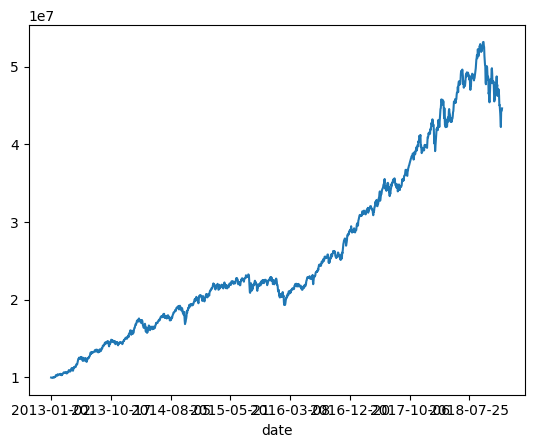

In [20]:
n_weight_df.invest.plot()